# Examples of how to load models, make predictions, and analyze predictions on validation set

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

import torch
from torch.utils.data import DataLoader
from torchsummary import summary
from tqdm import tqdm

from nanopore_dataset import create_sample_map
from nanopore_dataset import create_splits
from nanopore_dataset import load_csv
from nanopore_dataset import NanoporeDataset

from resnet1d import ResNet1D

In [2]:
# Set Device
# device = 'cuda:0' # Use 'cpu' for cpu
device = 'cpu'

In [3]:
# Create resnet model
model = ResNet1D(
            in_channels=1,
            base_filters=128,
            kernel_size=3,
            stride=2,
            groups=1,
            n_block=8,
            n_classes=2,
            downsample_gap=2,
            increasefilter_gap=4,
            use_do=False)

In [4]:
summary(model, (1, 400), device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1             [-1, 128, 400]             512
   MyConv1dPadSame-2             [-1, 128, 400]               0
       BatchNorm1d-3             [-1, 128, 400]             256
              ReLU-4             [-1, 128, 400]               0
            Conv1d-5             [-1, 128, 400]          49,280
   MyConv1dPadSame-6             [-1, 128, 400]               0
       BatchNorm1d-7             [-1, 128, 400]             256
              ReLU-8             [-1, 128, 400]               0
            Conv1d-9             [-1, 128, 400]          49,280
  MyConv1dPadSame-10             [-1, 128, 400]               0
       BasicBlock-11             [-1, 128, 400]               0
      BatchNorm1d-12             [-1, 128, 400]             256
             ReLU-13             [-1, 128, 400]               0
           Conv1d-14             [-1, 1

In [5]:
# Load saved weights

MESMLR_FN = 'best_models/mesmlr_resnet1d.pt'
ADDSEQ_FN = 'best_models/addseq_resnet1d.pt'

In [6]:
weights_path = MESMLR_FN
model.load_state_dict(torch.load(weights_path, map_location='cpu'))
model.to(device)
model.eval() # Put model in inference mode

ResNet1D(
  (first_block_conv): MyConv1dPadSame(
    (conv): Conv1d(1, 128, kernel_size=(3,), stride=(1,))
  )
  (first_block_bn): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (first_block_relu): ReLU()
  (basicblock_list): ModuleList(
    (0): BasicBlock(
      (bn1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu1): ReLU()
      (do1): Dropout(p=0.5, inplace=False)
      (conv1): MyConv1dPadSame(
        (conv): Conv1d(128, 128, kernel_size=(3,), stride=(1,))
      )
      (bn2): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu2): ReLU()
      (do2): Dropout(p=0.5, inplace=False)
      (conv2): MyConv1dPadSame(
        (conv): Conv1d(128, 128, kernel_size=(3,), stride=(1,))
      )
      (max_pool): MyMaxPool1dPadSame(
        (max_pool): MaxPool1d(kernel_size=1, stride=1, padding=0, dilation=1, ceil_mode=False)
      )
    )
    (1): BasicBlock(
      (bn1)

## Make some predictions

In [59]:
# Load a sequence from a csv

# data_fn = 'data/mesmlr/reprocessed-neg.eventalign.signal.csv'
# data_fn = 'data/mesmlr/reprocessed-pos.eventalign.signal.csv'

139366it [00:00, 682715.07it/s]


102648it [00:00, 672113.23it/s]
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:50<00:00, 99.59it/s]


Text(0, 0.5, 'Predicted "Probability"')

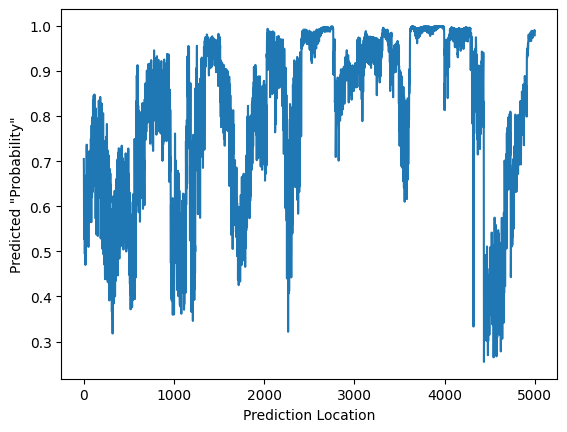

In [7]:
data_fn = 'data/reprocessed-pos.eventalign.signal.csv'
sequence = load_csv(data_fn, min_val=50, max_val=130, max_sequences=1)[0]
sequence_tensor = torch.tensor(sequence)

# Make predictions on subsequences of length 400
predictions = []
input_len = 400
n_predictions = 5000
input_tensor = torch.zeros((1, 1, 400)).to(device)
for i in tqdm(range(n_predictions)):
    # Could also batch these to speed up predictions
    input_tensor[:, :, :] = sequence_tensor[i:i+input_len]
    prediction = model(input_tensor).sigmoid().item()
    predictions.append(prediction)
    
# Plot predictions
plt.plot(predictions)
plt.xlabel('Prediction Location')
plt.ylabel('Predicted "Probability"')

In [8]:
pos_pre = predictions

In [11]:
# Make predictions on subsequences of length 400
data_fn = 'data/reprocessed-neg.eventalign.signal.csv'
sequence = load_csv(data_fn, min_val=50, max_val=130, max_sequences=1)[0]
sequence_tensor = torch.tensor(sequence)

65899it [00:00, 529320.23it/s]


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [01:00<00:00, 82.17it/s]


Text(0, 0.5, 'Predicted "Probability"')

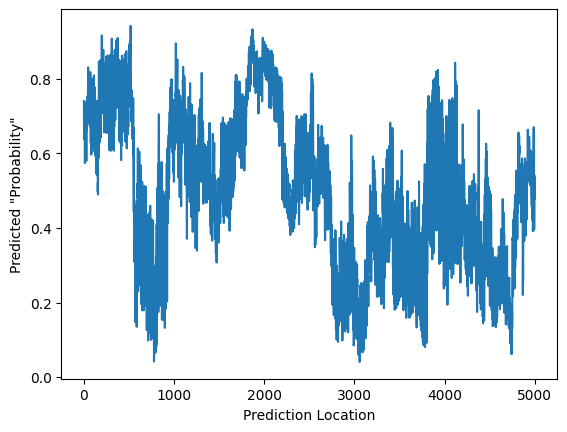

In [15]:
predictions = []
input_len = 400
n_predictions = 5000
input_tensor = torch.zeros((1, 1, 400)).to(device)
for i in tqdm(range(n_predictions)):
    input_tensor[:, :, :] = sequence_tensor[i:i+input_len]
    prediction = model(input_tensor).sigmoid().item()
    predictions.append(prediction)
    
# Plot predictions
plt.plot(predictions)
plt.xlabel('Prediction Location')
plt.ylabel('Predicted "Probability"')

In [13]:
import seaborn as sns

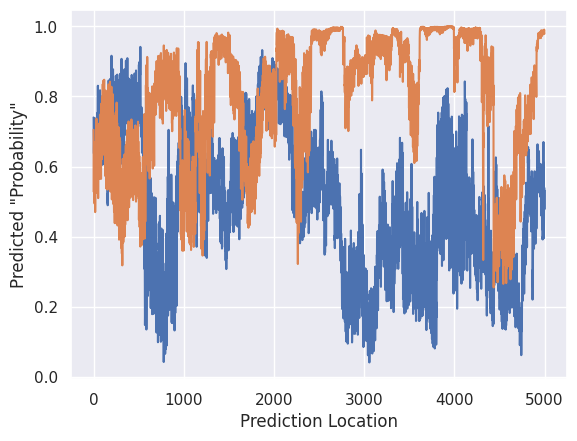

In [16]:
sns.set(style="darkgrid")
fig = sns.lineplot(predictions)
fig = sns.lineplot(pos_pre)
plt.xlabel('Prediction Location')
plt.ylabel('Predicted "Probability"')
# plt.show()
plt.savefig('../../results/figures/memlr_prediction_score.pdf')

In [17]:
import pandas as pd

In [18]:
df = pd.DataFrame(list(zip(predictions, pos_pre)),
               columns =['Neg', 'Pos'])

In [19]:
df = pd.melt(df, value_vars = ['Neg','Pos'], var_name='treatment', value_name='predicted probability')

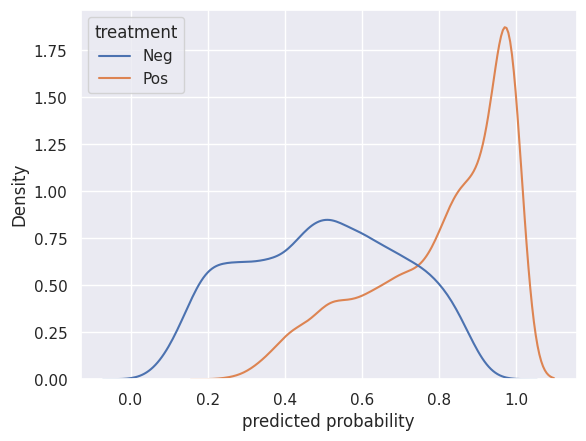

In [20]:
sns.set(style="darkgrid")
fig = sns.kdeplot(df, x = 'predicted probability', hue= 'treatment')
# plt.show()
plt.savefig('../../results/figures/mesmlr_prediction_score_density_4500.pdf')

  0%|▎                                                                                                                                    | 12/5000 [00:00<01:22, 60.71it/s]

tensor([[[ 98.1014,  96.9596,  97.9111,  97.9111,  98.1014,  99.0528,  99.0528,
           97.9111,  96.5790,  95.4372,  94.4857,  95.6275,  94.8663,  94.2954,
           91.8216,  92.7731, 107.0450, 107.0450, 105.1420, 106.6650, 106.0940,
          105.3330, 105.3330, 104.3810, 106.2840, 105.9040, 104.9520, 105.5230,
          104.7620, 101.7170, 100.1950,  98.1014,  96.3887,  95.6275,  98.1014,
           98.6723,  98.1014,  95.6275,  92.9634,  93.5343,  94.2954,  93.3440,
           95.8178,  97.1499, 100.0040,  95.6275,  94.1051,  88.9671,  91.4410,
           91.6313,  91.2507,  89.9186,  92.9634,  95.6275, 102.2880, 100.5750,
          105.3330, 102.0980, 104.0010,  99.6237,  98.8625, 101.3360,  97.3402,
           95.2469,  95.6275,  95.6275,  97.5305,  96.5790,  96.5790,  94.2954,
           96.0081,  95.6275,  95.8178,  96.1984,  99.4334,  96.1984,  98.2917,
           96.7693,  95.4372,  93.1537,  91.4410, 100.0040,  99.8140, 100.5750,
          100.1950, 100.0040,  99.6237, 

  1%|▋                                                                                                                                    | 27/5000 [00:00<01:10, 70.36it/s]

tensor([[[ 94.2954,  91.8216,  92.7731, 107.0450, 107.0450, 105.1420, 106.6650,
          106.0940, 105.3330, 105.3330, 104.3810, 106.2840, 105.9040, 104.9520,
          105.5230, 104.7620, 101.7170, 100.1950,  98.1014,  96.3887,  95.6275,
           98.1014,  98.6723,  98.1014,  95.6275,  92.9634,  93.5343,  94.2954,
           93.3440,  95.8178,  97.1499, 100.0040,  95.6275,  94.1051,  88.9671,
           91.4410,  91.6313,  91.2507,  89.9186,  92.9634,  95.6275, 102.2880,
          100.5750, 105.3330, 102.0980, 104.0010,  99.6237,  98.8625, 101.3360,
           97.3402,  95.2469,  95.6275,  95.6275,  97.5305,  96.5790,  96.5790,
           94.2954,  96.0081,  95.6275,  95.8178,  96.1984,  99.4334,  96.1984,
           98.2917,  96.7693,  95.4372,  93.1537,  91.4410, 100.0040,  99.8140,
          100.5750, 100.1950, 100.0040,  99.6237,  98.6723, 100.1950,  98.1014,
           98.1014, 100.0040,  98.4820,  94.4857,  95.0566,  93.1537,  94.6760,
           94.1051,  94.4857,  97.1499, 

  1%|█▏                                                                                                                                   | 44/5000 [00:00<01:06, 75.05it/s]

tensor([[[101.7170, 100.1950,  98.1014,  96.3887,  95.6275,  98.1014,  98.6723,
           98.1014,  95.6275,  92.9634,  93.5343,  94.2954,  93.3440,  95.8178,
           97.1499, 100.0040,  95.6275,  94.1051,  88.9671,  91.4410,  91.6313,
           91.2507,  89.9186,  92.9634,  95.6275, 102.2880, 100.5750, 105.3330,
          102.0980, 104.0010,  99.6237,  98.8625, 101.3360,  97.3402,  95.2469,
           95.6275,  95.6275,  97.5305,  96.5790,  96.5790,  94.2954,  96.0081,
           95.6275,  95.8178,  96.1984,  99.4334,  96.1984,  98.2917,  96.7693,
           95.4372,  93.1537,  91.4410, 100.0040,  99.8140, 100.5750, 100.1950,
          100.0040,  99.6237,  98.6723, 100.1950,  98.1014,  98.1014, 100.0040,
           98.4820,  94.4857,  95.0566,  93.1537,  94.6760,  94.1051,  94.4857,
           97.1499,  94.4857,  92.7731,  95.2469,  90.8701,  92.7731,  90.8701,
           91.4410,  91.8216,  91.4410,  97.3402,  97.7208,  98.6723,  96.5790,
           97.1499,  97.3402,  96.1984, 

  1%|█▍                                                                                                                                   | 52/5000 [00:00<01:08, 72.42it/s]

tensor([[[ 94.1051,  88.9671,  91.4410,  91.6313,  91.2507,  89.9186,  92.9634,
           95.6275, 102.2880, 100.5750, 105.3330, 102.0980, 104.0010,  99.6237,
           98.8625, 101.3360,  97.3402,  95.2469,  95.6275,  95.6275,  97.5305,
           96.5790,  96.5790,  94.2954,  96.0081,  95.6275,  95.8178,  96.1984,
           99.4334,  96.1984,  98.2917,  96.7693,  95.4372,  93.1537,  91.4410,
          100.0040,  99.8140, 100.5750, 100.1950, 100.0040,  99.6237,  98.6723,
          100.1950,  98.1014,  98.1014, 100.0040,  98.4820,  94.4857,  95.0566,
           93.1537,  94.6760,  94.1051,  94.4857,  97.1499,  94.4857,  92.7731,
           95.2469,  90.8701,  92.7731,  90.8701,  91.4410,  91.8216,  91.4410,
           97.3402,  97.7208,  98.6723,  96.5790,  97.1499,  97.3402,  96.1984,
           97.3402,  98.4820,  96.1984,  92.3925,  91.8216, 106.4740, 102.0980,
          104.0010, 105.3330, 103.0490, 105.3330, 105.9040, 106.0940, 100.3850,
          105.3330, 104.7620, 100.1950, 

  1%|█▊                                                                                                                                   | 68/5000 [00:00<01:09, 70.55it/s]

tensor([[[ 98.8625, 101.3360,  97.3402,  95.2469,  95.6275,  95.6275,  97.5305,
           96.5790,  96.5790,  94.2954,  96.0081,  95.6275,  95.8178,  96.1984,
           99.4334,  96.1984,  98.2917,  96.7693,  95.4372,  93.1537,  91.4410,
          100.0040,  99.8140, 100.5750, 100.1950, 100.0040,  99.6237,  98.6723,
          100.1950,  98.1014,  98.1014, 100.0040,  98.4820,  94.4857,  95.0566,
           93.1537,  94.6760,  94.1051,  94.4857,  97.1499,  94.4857,  92.7731,
           95.2469,  90.8701,  92.7731,  90.8701,  91.4410,  91.8216,  91.4410,
           97.3402,  97.7208,  98.6723,  96.5790,  97.1499,  97.3402,  96.1984,
           97.3402,  98.4820,  96.1984,  92.3925,  91.8216, 106.4740, 102.0980,
          104.0010, 105.3330, 103.0490, 105.3330, 105.9040, 106.0940, 100.3850,
          105.3330, 104.7620, 100.1950,  99.2431,  95.0566,  96.0081,  90.8701,
           97.1499,  92.9634,  92.5828,  91.8216,  95.6275,  92.3925,  91.6313,
           91.6313, 102.4780, 103.4300, 

  2%|██▏                                                                                                                                  | 83/5000 [00:01<01:10, 69.64it/s]

tensor([[[ 99.4334,  96.1984,  98.2917,  96.7693,  95.4372,  93.1537,  91.4410,
          100.0040,  99.8140, 100.5750, 100.1950, 100.0040,  99.6237,  98.6723,
          100.1950,  98.1014,  98.1014, 100.0040,  98.4820,  94.4857,  95.0566,
           93.1537,  94.6760,  94.1051,  94.4857,  97.1499,  94.4857,  92.7731,
           95.2469,  90.8701,  92.7731,  90.8701,  91.4410,  91.8216,  91.4410,
           97.3402,  97.7208,  98.6723,  96.5790,  97.1499,  97.3402,  96.1984,
           97.3402,  98.4820,  96.1984,  92.3925,  91.8216, 106.4740, 102.0980,
          104.0010, 105.3330, 103.0490, 105.3330, 105.9040, 106.0940, 100.3850,
          105.3330, 104.7620, 100.1950,  99.2431,  95.0566,  96.0081,  90.8701,
           97.1499,  92.9634,  92.5828,  91.8216,  95.6275,  92.3925,  91.6313,
           91.6313, 102.4780, 103.4300, 102.6680, 103.8100, 104.7620, 101.9070,
          103.0490, 103.0490, 102.6680, 105.1420, 103.2390, 104.9520, 102.6680,
          101.7170, 100.7660, 102.0980, 

  2%|██▋                                                                                                                                 | 100/5000 [00:01<01:06, 74.00it/s]

tensor([[[ 98.1014,  98.1014, 100.0040,  98.4820,  94.4857,  95.0566,  93.1537,
           94.6760,  94.1051,  94.4857,  97.1499,  94.4857,  92.7731,  95.2469,
           90.8701,  92.7731,  90.8701,  91.4410,  91.8216,  91.4410,  97.3402,
           97.7208,  98.6723,  96.5790,  97.1499,  97.3402,  96.1984,  97.3402,
           98.4820,  96.1984,  92.3925,  91.8216, 106.4740, 102.0980, 104.0010,
          105.3330, 103.0490, 105.3330, 105.9040, 106.0940, 100.3850, 105.3330,
          104.7620, 100.1950,  99.2431,  95.0566,  96.0081,  90.8701,  97.1499,
           92.9634,  92.5828,  91.8216,  95.6275,  92.3925,  91.6313,  91.6313,
          102.4780, 103.4300, 102.6680, 103.8100, 104.7620, 101.9070, 103.0490,
          103.0490, 102.6680, 105.1420, 103.2390, 104.9520, 102.6680, 101.7170,
          100.7660, 102.0980,  99.8140,  96.5790,  97.1499,  96.3887,  96.9596,
           96.7693,  98.1014,  98.8625,  95.6275,  91.4410,  92.5828,  94.4857,
           91.4410,  91.8216,  97.1499, 

  2%|███                                                                                                                                 | 117/5000 [00:01<01:03, 77.09it/s]

tensor([[[ 91.4410,  91.8216,  91.4410,  97.3402,  97.7208,  98.6723,  96.5790,
           97.1499,  97.3402,  96.1984,  97.3402,  98.4820,  96.1984,  92.3925,
           91.8216, 106.4740, 102.0980, 104.0010, 105.3330, 103.0490, 105.3330,
          105.9040, 106.0940, 100.3850, 105.3330, 104.7620, 100.1950,  99.2431,
           95.0566,  96.0081,  90.8701,  97.1499,  92.9634,  92.5828,  91.8216,
           95.6275,  92.3925,  91.6313,  91.6313, 102.4780, 103.4300, 102.6680,
          103.8100, 104.7620, 101.9070, 103.0490, 103.0490, 102.6680, 105.1420,
          103.2390, 104.9520, 102.6680, 101.7170, 100.7660, 102.0980,  99.8140,
           96.5790,  97.1499,  96.3887,  96.9596,  96.7693,  98.1014,  98.8625,
           95.6275,  91.4410,  92.5828,  94.4857,  91.4410,  91.8216,  97.1499,
           95.6275,  97.1499,  96.0081,  96.7693,  94.4857,  92.9634,  91.8216,
           91.6313,  91.2507,  92.5828,  95.2469, 106.2840, 105.7130, 104.3810,
          105.3330, 104.1910, 103.4300, 

  3%|███▌                                                                                                                                | 133/5000 [00:01<01:02, 77.99it/s]

tensor([[[104.0010, 105.3330, 103.0490, 105.3330, 105.9040, 106.0940, 100.3850,
          105.3330, 104.7620, 100.1950,  99.2431,  95.0566,  96.0081,  90.8701,
           97.1499,  92.9634,  92.5828,  91.8216,  95.6275,  92.3925,  91.6313,
           91.6313, 102.4780, 103.4300, 102.6680, 103.8100, 104.7620, 101.9070,
          103.0490, 103.0490, 102.6680, 105.1420, 103.2390, 104.9520, 102.6680,
          101.7170, 100.7660, 102.0980,  99.8140,  96.5790,  97.1499,  96.3887,
           96.9596,  96.7693,  98.1014,  98.8625,  95.6275,  91.4410,  92.5828,
           94.4857,  91.4410,  91.8216,  97.1499,  95.6275,  97.1499,  96.0081,
           96.7693,  94.4857,  92.9634,  91.8216,  91.6313,  91.2507,  92.5828,
           95.2469, 106.2840, 105.7130, 104.3810, 105.3330, 104.1910, 103.4300,
          106.4740,  98.1014,  98.1014,  96.7693,  95.4372,  96.0081,  94.8663,
           96.7693,  97.3402,  98.1014,  96.9596,  97.7208,  96.0081,  98.2917,
           96.9596, 100.0040,  97.7208, 

  3%|███▉                                                                                                                                | 149/5000 [00:02<01:01, 78.35it/s]

tensor([[[ 92.5828,  91.8216,  95.6275,  92.3925,  91.6313,  91.6313, 102.4780,
          103.4300, 102.6680, 103.8100, 104.7620, 101.9070, 103.0490, 103.0490,
          102.6680, 105.1420, 103.2390, 104.9520, 102.6680, 101.7170, 100.7660,
          102.0980,  99.8140,  96.5790,  97.1499,  96.3887,  96.9596,  96.7693,
           98.1014,  98.8625,  95.6275,  91.4410,  92.5828,  94.4857,  91.4410,
           91.8216,  97.1499,  95.6275,  97.1499,  96.0081,  96.7693,  94.4857,
           92.9634,  91.8216,  91.6313,  91.2507,  92.5828,  95.2469, 106.2840,
          105.7130, 104.3810, 105.3330, 104.1910, 103.4300, 106.4740,  98.1014,
           98.1014,  96.7693,  95.4372,  96.0081,  94.8663,  96.7693,  97.3402,
           98.1014,  96.9596,  97.7208,  96.0081,  98.2917,  96.9596, 100.0040,
           97.7208,  96.5790,  98.2917,  95.8178,  95.2469,  95.8178,  96.3887,
           96.3887,  94.1051,  93.3440,  92.7731,  92.0119,  91.6313,  97.1499,
           96.0081,  96.3887,  96.3887, 

  3%|████▎                                                                                                                               | 165/5000 [00:02<01:01, 78.37it/s]

tensor([[[103.2390, 104.9520, 102.6680, 101.7170, 100.7660, 102.0980,  99.8140,
           96.5790,  97.1499,  96.3887,  96.9596,  96.7693,  98.1014,  98.8625,
           95.6275,  91.4410,  92.5828,  94.4857,  91.4410,  91.8216,  97.1499,
           95.6275,  97.1499,  96.0081,  96.7693,  94.4857,  92.9634,  91.8216,
           91.6313,  91.2507,  92.5828,  95.2469, 106.2840, 105.7130, 104.3810,
          105.3330, 104.1910, 103.4300, 106.4740,  98.1014,  98.1014,  96.7693,
           95.4372,  96.0081,  94.8663,  96.7693,  97.3402,  98.1014,  96.9596,
           97.7208,  96.0081,  98.2917,  96.9596, 100.0040,  97.7208,  96.5790,
           98.2917,  95.8178,  95.2469,  95.8178,  96.3887,  96.3887,  94.1051,
           93.3440,  92.7731,  92.0119,  91.6313,  97.1499,  96.0081,  96.3887,
           96.3887,  97.7208,  92.0119,  88.7768,  90.8701,  90.8701,  89.3477,
           89.7283,  90.4895,  91.4410, 102.0980, 102.4780, 102.8590, 102.2880,
          104.0010, 102.0980, 101.7170, 

  4%|████▊                                                                                                                               | 181/5000 [00:02<01:01, 78.58it/s]

tensor([[[ 92.5828,  94.4857,  91.4410,  91.8216,  97.1499,  95.6275,  97.1499,
           96.0081,  96.7693,  94.4857,  92.9634,  91.8216,  91.6313,  91.2507,
           92.5828,  95.2469, 106.2840, 105.7130, 104.3810, 105.3330, 104.1910,
          103.4300, 106.4740,  98.1014,  98.1014,  96.7693,  95.4372,  96.0081,
           94.8663,  96.7693,  97.3402,  98.1014,  96.9596,  97.7208,  96.0081,
           98.2917,  96.9596, 100.0040,  97.7208,  96.5790,  98.2917,  95.8178,
           95.2469,  95.8178,  96.3887,  96.3887,  94.1051,  93.3440,  92.7731,
           92.0119,  91.6313,  97.1499,  96.0081,  96.3887,  96.3887,  97.7208,
           92.0119,  88.7768,  90.8701,  90.8701,  89.3477,  89.7283,  90.4895,
           91.4410, 102.0980, 102.4780, 102.8590, 102.2880, 104.0010, 102.0980,
          101.7170, 103.8100, 103.0490, 101.3360, 102.4780, 102.8590, 100.5750,
          102.4780, 101.1460, 101.3360,  98.2917,  97.3402,  98.4820,  97.3402,
           96.0081,  95.6275,  92.3925, 

  4%|█████▏                                                                                                                              | 197/5000 [00:02<01:01, 78.67it/s]

tensor([[[106.2840, 105.7130, 104.3810, 105.3330, 104.1910, 103.4300, 106.4740,
           98.1014,  98.1014,  96.7693,  95.4372,  96.0081,  94.8663,  96.7693,
           97.3402,  98.1014,  96.9596,  97.7208,  96.0081,  98.2917,  96.9596,
          100.0040,  97.7208,  96.5790,  98.2917,  95.8178,  95.2469,  95.8178,
           96.3887,  96.3887,  94.1051,  93.3440,  92.7731,  92.0119,  91.6313,
           97.1499,  96.0081,  96.3887,  96.3887,  97.7208,  92.0119,  88.7768,
           90.8701,  90.8701,  89.3477,  89.7283,  90.4895,  91.4410, 102.0980,
          102.4780, 102.8590, 102.2880, 104.0010, 102.0980, 101.7170, 103.8100,
          103.0490, 101.3360, 102.4780, 102.8590, 100.5750, 102.4780, 101.1460,
          101.3360,  98.2917,  97.3402,  98.4820,  97.3402,  96.0081,  95.6275,
           92.3925,  95.4372,  93.5343,  92.9634,  95.6275,  98.1014, 100.7660,
           97.1499, 101.1460,  98.6723, 102.8590,  98.6723,  99.2431,  99.6237,
           97.3402,  99.0528,  98.8625, 

  4%|█████▌                                                                                                                              | 213/5000 [00:02<01:01, 78.41it/s]

tensor([[[ 96.9596,  97.7208,  96.0081,  98.2917,  96.9596, 100.0040,  97.7208,
           96.5790,  98.2917,  95.8178,  95.2469,  95.8178,  96.3887,  96.3887,
           94.1051,  93.3440,  92.7731,  92.0119,  91.6313,  97.1499,  96.0081,
           96.3887,  96.3887,  97.7208,  92.0119,  88.7768,  90.8701,  90.8701,
           89.3477,  89.7283,  90.4895,  91.4410, 102.0980, 102.4780, 102.8590,
          102.2880, 104.0010, 102.0980, 101.7170, 103.8100, 103.0490, 101.3360,
          102.4780, 102.8590, 100.5750, 102.4780, 101.1460, 101.3360,  98.2917,
           97.3402,  98.4820,  97.3402,  96.0081,  95.6275,  92.3925,  95.4372,
           93.5343,  92.9634,  95.6275,  98.1014, 100.7660,  97.1499, 101.1460,
           98.6723, 102.8590,  98.6723,  99.2431,  99.6237,  97.3402,  99.0528,
           98.8625,  99.0528,  99.6237,  98.8625, 100.5750, 100.3850, 101.7170,
          101.5270,  97.9111,  99.4334,  98.1014,  99.4334,  98.6723,  99.2431,
           96.1984,  95.4372,  94.4857, 

  5%|██████                                                                                                                              | 230/5000 [00:03<01:00, 78.93it/s]

tensor([[[ 92.7731,  92.0119,  91.6313,  97.1499,  96.0081,  96.3887,  96.3887,
           97.7208,  92.0119,  88.7768,  90.8701,  90.8701,  89.3477,  89.7283,
           90.4895,  91.4410, 102.0980, 102.4780, 102.8590, 102.2880, 104.0010,
          102.0980, 101.7170, 103.8100, 103.0490, 101.3360, 102.4780, 102.8590,
          100.5750, 102.4780, 101.1460, 101.3360,  98.2917,  97.3402,  98.4820,
           97.3402,  96.0081,  95.6275,  92.3925,  95.4372,  93.5343,  92.9634,
           95.6275,  98.1014, 100.7660,  97.1499, 101.1460,  98.6723, 102.8590,
           98.6723,  99.2431,  99.6237,  97.3402,  99.0528,  98.8625,  99.0528,
           99.6237,  98.8625, 100.5750, 100.3850, 101.7170, 101.5270,  97.9111,
           99.4334,  98.1014,  99.4334,  98.6723,  99.2431,  96.1984,  95.4372,
           94.4857,  95.0566,  92.9634,  92.9634,  95.8178,  95.0566,  92.5828,
           92.5828,  95.2469,  94.2954,  93.3440,  94.8663,  93.3440,  95.2469,
           95.2469,  94.8663,  93.7245, 

  5%|██████▍                                                                                                                             | 246/5000 [00:03<01:00, 79.09it/s]

tensor([[[102.4780, 102.8590, 102.2880, 104.0010, 102.0980, 101.7170, 103.8100,
          103.0490, 101.3360, 102.4780, 102.8590, 100.5750, 102.4780, 101.1460,
          101.3360,  98.2917,  97.3402,  98.4820,  97.3402,  96.0081,  95.6275,
           92.3925,  95.4372,  93.5343,  92.9634,  95.6275,  98.1014, 100.7660,
           97.1499, 101.1460,  98.6723, 102.8590,  98.6723,  99.2431,  99.6237,
           97.3402,  99.0528,  98.8625,  99.0528,  99.6237,  98.8625, 100.5750,
          100.3850, 101.7170, 101.5270,  97.9111,  99.4334,  98.1014,  99.4334,
           98.6723,  99.2431,  96.1984,  95.4372,  94.4857,  95.0566,  92.9634,
           92.9634,  95.8178,  95.0566,  92.5828,  92.5828,  95.2469,  94.2954,
           93.3440,  94.8663,  93.3440,  95.2469,  95.2469,  94.8663,  93.7245,
           95.0566,  90.6798,  99.0528,  96.7693,  97.5305,  95.2469,  98.8625,
           96.7693,  92.7731,  90.1089,  91.2507,  89.1574,  90.8701,  93.1537,
           92.5828,  93.1537, 101.5270, 

  5%|██████▉                                                                                                                             | 262/5000 [00:03<01:00, 78.49it/s]

tensor([[[ 98.4820,  97.3402,  96.0081,  95.6275,  92.3925,  95.4372,  93.5343,
           92.9634,  95.6275,  98.1014, 100.7660,  97.1499, 101.1460,  98.6723,
          102.8590,  98.6723,  99.2431,  99.6237,  97.3402,  99.0528,  98.8625,
           99.0528,  99.6237,  98.8625, 100.5750, 100.3850, 101.7170, 101.5270,
           97.9111,  99.4334,  98.1014,  99.4334,  98.6723,  99.2431,  96.1984,
           95.4372,  94.4857,  95.0566,  92.9634,  92.9634,  95.8178,  95.0566,
           92.5828,  92.5828,  95.2469,  94.2954,  93.3440,  94.8663,  93.3440,
           95.2469,  95.2469,  94.8663,  93.7245,  95.0566,  90.6798,  99.0528,
           96.7693,  97.5305,  95.2469,  98.8625,  96.7693,  92.7731,  90.1089,
           91.2507,  89.1574,  90.8701,  93.1537,  92.5828,  93.1537, 101.5270,
          104.0010, 101.9070, 100.7660, 100.1950, 104.5710, 103.2390, 104.1910,
          100.7660, 100.3850, 102.8590, 100.7660,  99.6237, 100.1950,  96.7693,
           96.1984,  95.8178,  97.5305, 

  6%|███████▎                                                                                                                            | 278/5000 [00:03<01:00, 78.62it/s]

tensor([[[ 99.2431,  99.6237,  97.3402,  99.0528,  98.8625,  99.0528,  99.6237,
           98.8625, 100.5750, 100.3850, 101.7170, 101.5270,  97.9111,  99.4334,
           98.1014,  99.4334,  98.6723,  99.2431,  96.1984,  95.4372,  94.4857,
           95.0566,  92.9634,  92.9634,  95.8178,  95.0566,  92.5828,  92.5828,
           95.2469,  94.2954,  93.3440,  94.8663,  93.3440,  95.2469,  95.2469,
           94.8663,  93.7245,  95.0566,  90.6798,  99.0528,  96.7693,  97.5305,
           95.2469,  98.8625,  96.7693,  92.7731,  90.1089,  91.2507,  89.1574,
           90.8701,  93.1537,  92.5828,  93.1537, 101.5270, 104.0010, 101.9070,
          100.7660, 100.1950, 104.5710, 103.2390, 104.1910, 100.7660, 100.3850,
          102.8590, 100.7660,  99.6237, 100.1950,  96.7693,  96.1984,  95.8178,
           97.5305,  95.8178,  97.5305,  98.1014,  97.9111,  98.1014,  96.0081,
           96.9596,  97.3402,  97.5305,  96.5790,  99.2431,  96.3887,  95.2469,
           95.6275,  95.2469,  97.1499, 

  6%|███████▊                                                                                                                            | 294/5000 [00:03<00:59, 78.71it/s]

tensor([[[ 98.6723,  99.2431,  96.1984,  95.4372,  94.4857,  95.0566,  92.9634,
           92.9634,  95.8178,  95.0566,  92.5828,  92.5828,  95.2469,  94.2954,
           93.3440,  94.8663,  93.3440,  95.2469,  95.2469,  94.8663,  93.7245,
           95.0566,  90.6798,  99.0528,  96.7693,  97.5305,  95.2469,  98.8625,
           96.7693,  92.7731,  90.1089,  91.2507,  89.1574,  90.8701,  93.1537,
           92.5828,  93.1537, 101.5270, 104.0010, 101.9070, 100.7660, 100.1950,
          104.5710, 103.2390, 104.1910, 100.7660, 100.3850, 102.8590, 100.7660,
           99.6237, 100.1950,  96.7693,  96.1984,  95.8178,  97.5305,  95.8178,
           97.5305,  98.1014,  97.9111,  98.1014,  96.0081,  96.9596,  97.3402,
           97.5305,  96.5790,  99.2431,  96.3887,  95.2469,  95.6275,  95.2469,
           97.1499,  98.4820,  98.1014,  97.3402, 100.0040,  99.4334,  98.6723,
           97.3402,  95.6275,  95.2469,  92.9634,  90.4895,  90.2992,  97.5305,
           96.9596,  95.6275,  98.1014, 

  6%|████████▏                                                                                                                           | 310/5000 [00:04<00:59, 78.59it/s]

tensor([[[ 93.3440,  95.2469,  95.2469,  94.8663,  93.7245,  95.0566,  90.6798,
           99.0528,  96.7693,  97.5305,  95.2469,  98.8625,  96.7693,  92.7731,
           90.1089,  91.2507,  89.1574,  90.8701,  93.1537,  92.5828,  93.1537,
          101.5270, 104.0010, 101.9070, 100.7660, 100.1950, 104.5710, 103.2390,
          104.1910, 100.7660, 100.3850, 102.8590, 100.7660,  99.6237, 100.1950,
           96.7693,  96.1984,  95.8178,  97.5305,  95.8178,  97.5305,  98.1014,
           97.9111,  98.1014,  96.0081,  96.9596,  97.3402,  97.5305,  96.5790,
           99.2431,  96.3887,  95.2469,  95.6275,  95.2469,  97.1499,  98.4820,
           98.1014,  97.3402, 100.0040,  99.4334,  98.6723,  97.3402,  95.6275,
           95.2469,  92.9634,  90.4895,  90.2992,  97.5305,  96.9596,  95.6275,
           98.1014,  96.9596,  98.8625,  94.6760,  95.8178,  97.5305,  96.0081,
           96.1984,  96.0081,  93.1537,  92.0119,  91.6313,  92.2022,  91.4410,
           91.2507,  93.5343,  90.2992, 

  7%|████████▌                                                                                                                           | 326/5000 [00:04<00:59, 78.72it/s]

tensor([[[ 89.1574,  90.8701,  93.1537,  92.5828,  93.1537, 101.5270, 104.0010,
          101.9070, 100.7660, 100.1950, 104.5710, 103.2390, 104.1910, 100.7660,
          100.3850, 102.8590, 100.7660,  99.6237, 100.1950,  96.7693,  96.1984,
           95.8178,  97.5305,  95.8178,  97.5305,  98.1014,  97.9111,  98.1014,
           96.0081,  96.9596,  97.3402,  97.5305,  96.5790,  99.2431,  96.3887,
           95.2469,  95.6275,  95.2469,  97.1499,  98.4820,  98.1014,  97.3402,
          100.0040,  99.4334,  98.6723,  97.3402,  95.6275,  95.2469,  92.9634,
           90.4895,  90.2992,  97.5305,  96.9596,  95.6275,  98.1014,  96.9596,
           98.8625,  94.6760,  95.8178,  97.5305,  96.0081,  96.1984,  96.0081,
           93.1537,  92.0119,  91.6313,  92.2022,  91.4410,  91.2507,  93.5343,
           90.2992, 100.3850, 104.9520, 104.3810, 103.6200, 103.2390, 101.7170,
          103.2390, 101.9070, 103.4300, 102.0980, 103.6200, 102.2880, 102.2880,
          103.4300, 103.4300, 102.6680, 

  7%|█████████                                                                                                                           | 343/5000 [00:04<00:58, 79.49it/s]

tensor([[[ 99.6237, 100.1950,  96.7693,  96.1984,  95.8178,  97.5305,  95.8178,
           97.5305,  98.1014,  97.9111,  98.1014,  96.0081,  96.9596,  97.3402,
           97.5305,  96.5790,  99.2431,  96.3887,  95.2469,  95.6275,  95.2469,
           97.1499,  98.4820,  98.1014,  97.3402, 100.0040,  99.4334,  98.6723,
           97.3402,  95.6275,  95.2469,  92.9634,  90.4895,  90.2992,  97.5305,
           96.9596,  95.6275,  98.1014,  96.9596,  98.8625,  94.6760,  95.8178,
           97.5305,  96.0081,  96.1984,  96.0081,  93.1537,  92.0119,  91.6313,
           92.2022,  91.4410,  91.2507,  93.5343,  90.2992, 100.3850, 104.9520,
          104.3810, 103.6200, 103.2390, 101.7170, 103.2390, 101.9070, 103.4300,
          102.0980, 103.6200, 102.2880, 102.2880, 103.4300, 103.4300, 102.6680,
          101.9070, 101.7170, 104.1910, 103.2390, 104.3810, 104.0010, 106.0940,
          105.7130, 103.4300,  99.8140, 102.8590,  96.1984,  94.8663,  96.7693,
           97.5305,  95.6275,  92.3925, 

  7%|█████████▍                                                                                                                          | 359/5000 [00:04<00:58, 78.73it/s]

tensor([[[ 96.3887,  95.2469,  95.6275,  95.2469,  97.1499,  98.4820,  98.1014,
           97.3402, 100.0040,  99.4334,  98.6723,  97.3402,  95.6275,  95.2469,
           92.9634,  90.4895,  90.2992,  97.5305,  96.9596,  95.6275,  98.1014,
           96.9596,  98.8625,  94.6760,  95.8178,  97.5305,  96.0081,  96.1984,
           96.0081,  93.1537,  92.0119,  91.6313,  92.2022,  91.4410,  91.2507,
           93.5343,  90.2992, 100.3850, 104.9520, 104.3810, 103.6200, 103.2390,
          101.7170, 103.2390, 101.9070, 103.4300, 102.0980, 103.6200, 102.2880,
          102.2880, 103.4300, 103.4300, 102.6680, 101.9070, 101.7170, 104.1910,
          103.2390, 104.3810, 104.0010, 106.0940, 105.7130, 103.4300,  99.8140,
          102.8590,  96.1984,  94.8663,  96.7693,  97.5305,  95.6275,  92.3925,
           96.0081,  93.5343,  94.4857,  94.1051,  94.8663,  93.9148,  93.5343,
           92.9634,  90.6798,  97.3402,  95.2469,  96.3887,  99.2431,  99.6237,
           98.4820,  96.7693,  95.4372, 

  8%|█████████▉                                                                                                                          | 377/5000 [00:04<00:58, 79.60it/s]

tensor([[[ 97.5305,  96.9596,  95.6275,  98.1014,  96.9596,  98.8625,  94.6760,
           95.8178,  97.5305,  96.0081,  96.1984,  96.0081,  93.1537,  92.0119,
           91.6313,  92.2022,  91.4410,  91.2507,  93.5343,  90.2992, 100.3850,
          104.9520, 104.3810, 103.6200, 103.2390, 101.7170, 103.2390, 101.9070,
          103.4300, 102.0980, 103.6200, 102.2880, 102.2880, 103.4300, 103.4300,
          102.6680, 101.9070, 101.7170, 104.1910, 103.2390, 104.3810, 104.0010,
          106.0940, 105.7130, 103.4300,  99.8140, 102.8590,  96.1984,  94.8663,
           96.7693,  97.5305,  95.6275,  92.3925,  96.0081,  93.5343,  94.4857,
           94.1051,  94.8663,  93.9148,  93.5343,  92.9634,  90.6798,  97.3402,
           95.2469,  96.3887,  99.2431,  99.6237,  98.4820,  96.7693,  95.4372,
           97.1499,  93.3440,  94.1051,  90.1089, 103.4300, 107.0450, 104.7620,
          102.6680, 104.7620, 107.6160, 105.5230, 102.0980,  99.2431,  97.5305,
           96.3887,  98.1014,  97.1499, 

  8%|██████████▍                                                                                                                         | 393/5000 [00:05<00:58, 78.23it/s]

tensor([[[ 91.2507,  93.5343,  90.2992, 100.3850, 104.9520, 104.3810, 103.6200,
          103.2390, 101.7170, 103.2390, 101.9070, 103.4300, 102.0980, 103.6200,
          102.2880, 102.2880, 103.4300, 103.4300, 102.6680, 101.9070, 101.7170,
          104.1910, 103.2390, 104.3810, 104.0010, 106.0940, 105.7130, 103.4300,
           99.8140, 102.8590,  96.1984,  94.8663,  96.7693,  97.5305,  95.6275,
           92.3925,  96.0081,  93.5343,  94.4857,  94.1051,  94.8663,  93.9148,
           93.5343,  92.9634,  90.6798,  97.3402,  95.2469,  96.3887,  99.2431,
           99.6237,  98.4820,  96.7693,  95.4372,  97.1499,  93.3440,  94.1051,
           90.1089, 103.4300, 107.0450, 104.7620, 102.6680, 104.7620, 107.6160,
          105.5230, 102.0980,  99.2431,  97.5305,  96.3887,  98.1014,  97.1499,
           97.1499,  93.9148,  92.0119,  95.6275,  92.2022,  92.5828,  91.6313,
           94.4857,  93.1537,  97.1499, 100.1950,  98.8625, 100.5750, 100.1950,
           98.4820,  99.2431,  97.9111, 

  8%|██████████▊                                                                                                                         | 409/5000 [00:05<01:00, 75.29it/s]

tensor([[[103.4300, 103.4300, 102.6680, 101.9070, 101.7170, 104.1910, 103.2390,
          104.3810, 104.0010, 106.0940, 105.7130, 103.4300,  99.8140, 102.8590,
           96.1984,  94.8663,  96.7693,  97.5305,  95.6275,  92.3925,  96.0081,
           93.5343,  94.4857,  94.1051,  94.8663,  93.9148,  93.5343,  92.9634,
           90.6798,  97.3402,  95.2469,  96.3887,  99.2431,  99.6237,  98.4820,
           96.7693,  95.4372,  97.1499,  93.3440,  94.1051,  90.1089, 103.4300,
          107.0450, 104.7620, 102.6680, 104.7620, 107.6160, 105.5230, 102.0980,
           99.2431,  97.5305,  96.3887,  98.1014,  97.1499,  97.1499,  93.9148,
           92.0119,  95.6275,  92.2022,  92.5828,  91.6313,  94.4857,  93.1537,
           97.1499, 100.1950,  98.8625, 100.5750, 100.1950,  98.4820,  99.2431,
           97.9111, 100.3850,  99.0528,  99.6237, 100.9560,  97.9111,  95.2469,
           92.3925,  91.8216,  98.1014,  93.3440,  98.2917,  97.5305,  94.8663,
           92.3925,  92.2022,  92.7731, 

  9%|███████████▎                                                                                                                        | 427/5000 [00:05<00:58, 78.49it/s]

tensor([[[ 96.7693,  97.5305,  95.6275,  92.3925,  96.0081,  93.5343,  94.4857,
           94.1051,  94.8663,  93.9148,  93.5343,  92.9634,  90.6798,  97.3402,
           95.2469,  96.3887,  99.2431,  99.6237,  98.4820,  96.7693,  95.4372,
           97.1499,  93.3440,  94.1051,  90.1089, 103.4300, 107.0450, 104.7620,
          102.6680, 104.7620, 107.6160, 105.5230, 102.0980,  99.2431,  97.5305,
           96.3887,  98.1014,  97.1499,  97.1499,  93.9148,  92.0119,  95.6275,
           92.2022,  92.5828,  91.6313,  94.4857,  93.1537,  97.1499, 100.1950,
           98.8625, 100.5750, 100.1950,  98.4820,  99.2431,  97.9111, 100.3850,
           99.0528,  99.6237, 100.9560,  97.9111,  95.2469,  92.3925,  91.8216,
           98.1014,  93.3440,  98.2917,  97.5305,  94.8663,  92.3925,  92.2022,
           92.7731,  96.9596,  95.2469,  96.1984,  96.9596,  98.4820,  98.8625,
           96.0081,  93.5343,  95.2469,  92.5828,  91.4410,  94.1051,  91.6313,
           92.0119,  89.5380,  98.2917, 

  9%|███████████▋                                                                                                                        | 443/5000 [00:05<01:00, 74.88it/s]

tensor([[[ 99.6237,  98.4820,  96.7693,  95.4372,  97.1499,  93.3440,  94.1051,
           90.1089, 103.4300, 107.0450, 104.7620, 102.6680, 104.7620, 107.6160,
          105.5230, 102.0980,  99.2431,  97.5305,  96.3887,  98.1014,  97.1499,
           97.1499,  93.9148,  92.0119,  95.6275,  92.2022,  92.5828,  91.6313,
           94.4857,  93.1537,  97.1499, 100.1950,  98.8625, 100.5750, 100.1950,
           98.4820,  99.2431,  97.9111, 100.3850,  99.0528,  99.6237, 100.9560,
           97.9111,  95.2469,  92.3925,  91.8216,  98.1014,  93.3440,  98.2917,
           97.5305,  94.8663,  92.3925,  92.2022,  92.7731,  96.9596,  95.2469,
           96.1984,  96.9596,  98.4820,  98.8625,  96.0081,  93.5343,  95.2469,
           92.5828,  91.4410,  94.1051,  91.6313,  92.0119,  89.5380,  98.2917,
          100.3850,  99.6237,  99.6237,  96.7693,  96.1984,  91.6313,  94.6760,
           99.6237,  98.1014,  97.7208,  94.6760,  97.9111,  98.2917,  94.4857,
           89.9186,  80.7844,  81.7359, 

  9%|████████████                                                                                                                        | 459/5000 [00:06<00:59, 76.28it/s]

tensor([[[102.0980,  99.2431,  97.5305,  96.3887,  98.1014,  97.1499,  97.1499,
           93.9148,  92.0119,  95.6275,  92.2022,  92.5828,  91.6313,  94.4857,
           93.1537,  97.1499, 100.1950,  98.8625, 100.5750, 100.1950,  98.4820,
           99.2431,  97.9111, 100.3850,  99.0528,  99.6237, 100.9560,  97.9111,
           95.2469,  92.3925,  91.8216,  98.1014,  93.3440,  98.2917,  97.5305,
           94.8663,  92.3925,  92.2022,  92.7731,  96.9596,  95.2469,  96.1984,
           96.9596,  98.4820,  98.8625,  96.0081,  93.5343,  95.2469,  92.5828,
           91.4410,  94.1051,  91.6313,  92.0119,  89.5380,  98.2917, 100.3850,
           99.6237,  99.6237,  96.7693,  96.1984,  91.6313,  94.6760,  99.6237,
           98.1014,  97.7208,  94.6760,  97.9111,  98.2917,  94.4857,  89.9186,
           80.7844,  81.7359,  79.8329,  79.0717,  79.8329,  80.0232,  80.9747,
           81.3553,  78.6912,  80.4038,  78.5009,  79.4523,  79.4523,  79.8329,
           79.6426,  98.6723, 119.4150, 

 10%|████████████▌                                                                                                                       | 476/5000 [00:06<00:58, 77.48it/s]

tensor([[[100.1950,  98.8625, 100.5750, 100.1950,  98.4820,  99.2431,  97.9111,
          100.3850,  99.0528,  99.6237, 100.9560,  97.9111,  95.2469,  92.3925,
           91.8216,  98.1014,  93.3440,  98.2917,  97.5305,  94.8663,  92.3925,
           92.2022,  92.7731,  96.9596,  95.2469,  96.1984,  96.9596,  98.4820,
           98.8625,  96.0081,  93.5343,  95.2469,  92.5828,  91.4410,  94.1051,
           91.6313,  92.0119,  89.5380,  98.2917, 100.3850,  99.6237,  99.6237,
           96.7693,  96.1984,  91.6313,  94.6760,  99.6237,  98.1014,  97.7208,
           94.6760,  97.9111,  98.2917,  94.4857,  89.9186,  80.7844,  81.7359,
           79.8329,  79.0717,  79.8329,  80.0232,  80.9747,  81.3553,  78.6912,
           80.4038,  78.5009,  79.4523,  79.4523,  79.8329,  79.6426,  98.6723,
          119.4150, 114.2770, 115.0380, 118.2730, 113.3250, 102.0980, 102.6680,
          103.8100, 101.3360, 103.6200,  99.8140,  98.1014,  98.6723, 103.0490,
           97.7208, 101.3360,  98.8625, 

 10%|█████████████                                                                                                                       | 494/5000 [00:06<00:56, 79.55it/s]

tensor([[[ 98.2917,  97.5305,  94.8663,  92.3925,  92.2022,  92.7731,  96.9596,
           95.2469,  96.1984,  96.9596,  98.4820,  98.8625,  96.0081,  93.5343,
           95.2469,  92.5828,  91.4410,  94.1051,  91.6313,  92.0119,  89.5380,
           98.2917, 100.3850,  99.6237,  99.6237,  96.7693,  96.1984,  91.6313,
           94.6760,  99.6237,  98.1014,  97.7208,  94.6760,  97.9111,  98.2917,
           94.4857,  89.9186,  80.7844,  81.7359,  79.8329,  79.0717,  79.8329,
           80.0232,  80.9747,  81.3553,  78.6912,  80.4038,  78.5009,  79.4523,
           79.4523,  79.8329,  79.6426,  98.6723, 119.4150, 114.2770, 115.0380,
          118.2730, 113.3250, 102.0980, 102.6680, 103.8100, 101.3360, 103.6200,
           99.8140,  98.1014,  98.6723, 103.0490,  97.7208, 101.3360,  98.8625,
           96.0081,  99.4334,  97.3402, 100.3850,  98.8625, 100.5750, 100.1950,
          111.0420, 111.0420, 111.2320, 112.7540, 111.9930, 109.7090, 111.2320,
          111.0420, 109.5190, 110.8510, 

 10%|█████████████▍                                                                                                                      | 510/5000 [00:06<00:57, 78.33it/s]

tensor([[[ 94.1051,  91.6313,  92.0119,  89.5380,  98.2917, 100.3850,  99.6237,
           99.6237,  96.7693,  96.1984,  91.6313,  94.6760,  99.6237,  98.1014,
           97.7208,  94.6760,  97.9111,  98.2917,  94.4857,  89.9186,  80.7844,
           81.7359,  79.8329,  79.0717,  79.8329,  80.0232,  80.9747,  81.3553,
           78.6912,  80.4038,  78.5009,  79.4523,  79.4523,  79.8329,  79.6426,
           98.6723, 119.4150, 114.2770, 115.0380, 118.2730, 113.3250, 102.0980,
          102.6680, 103.8100, 101.3360, 103.6200,  99.8140,  98.1014,  98.6723,
          103.0490,  97.7208, 101.3360,  98.8625,  96.0081,  99.4334,  97.3402,
          100.3850,  98.8625, 100.5750, 100.1950, 111.0420, 111.0420, 111.2320,
          112.7540, 111.9930, 109.7090, 111.2320, 111.0420, 109.5190, 110.8510,
          108.9480, 106.8550,  99.2431,  87.6351,  86.6836,  87.8254,  92.2022,
           85.7321,  85.5418,  84.4000,  84.2097,  90.4895,  88.0157,  87.8254,
           88.3963,  87.6351,  88.7768, 

 11%|█████████████▉                                                                                                                      | 526/5000 [00:06<00:59, 75.33it/s]

tensor([[[ 97.9111,  98.2917,  94.4857,  89.9186,  80.7844,  81.7359,  79.8329,
           79.0717,  79.8329,  80.0232,  80.9747,  81.3553,  78.6912,  80.4038,
           78.5009,  79.4523,  79.4523,  79.8329,  79.6426,  98.6723, 119.4150,
          114.2770, 115.0380, 118.2730, 113.3250, 102.0980, 102.6680, 103.8100,
          101.3360, 103.6200,  99.8140,  98.1014,  98.6723, 103.0490,  97.7208,
          101.3360,  98.8625,  96.0081,  99.4334,  97.3402, 100.3850,  98.8625,
          100.5750, 100.1950, 111.0420, 111.0420, 111.2320, 112.7540, 111.9930,
          109.7090, 111.2320, 111.0420, 109.5190, 110.8510, 108.9480, 106.8550,
           99.2431,  87.6351,  86.6836,  87.8254,  92.2022,  85.7321,  85.5418,
           84.4000,  84.2097,  90.4895,  88.0157,  87.8254,  88.3963,  87.6351,
           88.7768,  88.0157,  86.8739,  88.9671,  89.3477,  90.2992,  88.9671,
           89.5380,  90.2992,  87.4448,  88.9671,  86.6836,  89.1574,  88.3963,
           89.1574,  88.2060,  88.0157, 

 11%|██████████████▎                                                                                                                     | 543/5000 [00:07<00:58, 76.03it/s]

tensor([[[ 79.4523,  79.8329,  79.6426,  98.6723, 119.4150, 114.2770, 115.0380,
          118.2730, 113.3250, 102.0980, 102.6680, 103.8100, 101.3360, 103.6200,
           99.8140,  98.1014,  98.6723, 103.0490,  97.7208, 101.3360,  98.8625,
           96.0081,  99.4334,  97.3402, 100.3850,  98.8625, 100.5750, 100.1950,
          111.0420, 111.0420, 111.2320, 112.7540, 111.9930, 109.7090, 111.2320,
          111.0420, 109.5190, 110.8510, 108.9480, 106.8550,  99.2431,  87.6351,
           86.6836,  87.8254,  92.2022,  85.7321,  85.5418,  84.4000,  84.2097,
           90.4895,  88.0157,  87.8254,  88.3963,  87.6351,  88.7768,  88.0157,
           86.8739,  88.9671,  89.3477,  90.2992,  88.9671,  89.5380,  90.2992,
           87.4448,  88.9671,  86.6836,  89.1574,  88.3963,  89.1574,  88.2060,
           88.0157,  88.5866,  90.6798,  87.8254,  91.4410,  79.2620, 101.7170,
          101.7170,  99.8140, 103.8100,  99.4334, 102.0980, 100.5750, 100.7660,
          102.4780, 101.3360, 102.0980, 

 11%|██████████████▊                                                                                                                     | 560/5000 [00:07<00:56, 78.21it/s]

tensor([[[ 98.6723, 103.0490,  97.7208, 101.3360,  98.8625,  96.0081,  99.4334,
           97.3402, 100.3850,  98.8625, 100.5750, 100.1950, 111.0420, 111.0420,
          111.2320, 112.7540, 111.9930, 109.7090, 111.2320, 111.0420, 109.5190,
          110.8510, 108.9480, 106.8550,  99.2431,  87.6351,  86.6836,  87.8254,
           92.2022,  85.7321,  85.5418,  84.4000,  84.2097,  90.4895,  88.0157,
           87.8254,  88.3963,  87.6351,  88.7768,  88.0157,  86.8739,  88.9671,
           89.3477,  90.2992,  88.9671,  89.5380,  90.2992,  87.4448,  88.9671,
           86.6836,  89.1574,  88.3963,  89.1574,  88.2060,  88.0157,  88.5866,
           90.6798,  87.8254,  91.4410,  79.2620, 101.7170, 101.7170,  99.8140,
          103.8100,  99.4334, 102.0980, 100.5750, 100.7660, 102.4780, 101.3360,
          102.0980, 101.9070,  91.4410,  87.2545,  88.3963,  92.2022,  96.0081,
           95.6275,  96.7693,  96.0081,  93.9148,  98.6723,  96.1984,  96.7693,
           97.7208,  94.8663,  94.2954, 

 12%|███████████████▎                                                                                                                    | 578/5000 [00:07<00:55, 79.76it/s]

tensor([[[109.7090, 111.2320, 111.0420, 109.5190, 110.8510, 108.9480, 106.8550,
           99.2431,  87.6351,  86.6836,  87.8254,  92.2022,  85.7321,  85.5418,
           84.4000,  84.2097,  90.4895,  88.0157,  87.8254,  88.3963,  87.6351,
           88.7768,  88.0157,  86.8739,  88.9671,  89.3477,  90.2992,  88.9671,
           89.5380,  90.2992,  87.4448,  88.9671,  86.6836,  89.1574,  88.3963,
           89.1574,  88.2060,  88.0157,  88.5866,  90.6798,  87.8254,  91.4410,
           79.2620, 101.7170, 101.7170,  99.8140, 103.8100,  99.4334, 102.0980,
          100.5750, 100.7660, 102.4780, 101.3360, 102.0980, 101.9070,  91.4410,
           87.2545,  88.3963,  92.2022,  96.0081,  95.6275,  96.7693,  96.0081,
           93.9148,  98.6723,  96.1984,  96.7693,  97.7208,  94.8663,  94.2954,
           97.9111,  95.6275,  88.5866,  94.4857,  96.9596,  96.5790,  96.1984,
           98.2917,  97.9111,  96.9596,  96.1984, 105.3330, 107.8060, 107.6160,
          107.4260, 105.1420, 107.0450, 

 12%|███████████████▋                                                                                                                    | 596/5000 [00:07<00:54, 80.67it/s]

tensor([[[ 88.0157,  87.8254,  88.3963,  87.6351,  88.7768,  88.0157,  86.8739,
           88.9671,  89.3477,  90.2992,  88.9671,  89.5380,  90.2992,  87.4448,
           88.9671,  86.6836,  89.1574,  88.3963,  89.1574,  88.2060,  88.0157,
           88.5866,  90.6798,  87.8254,  91.4410,  79.2620, 101.7170, 101.7170,
           99.8140, 103.8100,  99.4334, 102.0980, 100.5750, 100.7660, 102.4780,
          101.3360, 102.0980, 101.9070,  91.4410,  87.2545,  88.3963,  92.2022,
           96.0081,  95.6275,  96.7693,  96.0081,  93.9148,  98.6723,  96.1984,
           96.7693,  97.7208,  94.8663,  94.2954,  97.9111,  95.6275,  88.5866,
           94.4857,  96.9596,  96.5790,  96.1984,  98.2917,  97.9111,  96.9596,
           96.1984, 105.3330, 107.8060, 107.6160, 107.4260, 105.1420, 107.0450,
          106.6650,  92.9634,  91.2507,  94.8663,  88.9671,  91.0604,  90.8701,
           92.5828,  89.5380,  92.5828,  90.6798,  90.6798,  93.9148,  90.6798,
           91.2507,  90.2992,  91.2507, 

 12%|████████████████▏                                                                                                                   | 614/5000 [00:07<00:53, 81.27it/s]

tensor([[[ 88.3963,  89.1574,  88.2060,  88.0157,  88.5866,  90.6798,  87.8254,
           91.4410,  79.2620, 101.7170, 101.7170,  99.8140, 103.8100,  99.4334,
          102.0980, 100.5750, 100.7660, 102.4780, 101.3360, 102.0980, 101.9070,
           91.4410,  87.2545,  88.3963,  92.2022,  96.0081,  95.6275,  96.7693,
           96.0081,  93.9148,  98.6723,  96.1984,  96.7693,  97.7208,  94.8663,
           94.2954,  97.9111,  95.6275,  88.5866,  94.4857,  96.9596,  96.5790,
           96.1984,  98.2917,  97.9111,  96.9596,  96.1984, 105.3330, 107.8060,
          107.6160, 107.4260, 105.1420, 107.0450, 106.6650,  92.9634,  91.2507,
           94.8663,  88.9671,  91.0604,  90.8701,  92.5828,  89.5380,  92.5828,
           90.6798,  90.6798,  93.9148,  90.6798,  91.2507,  90.2992,  91.2507,
           95.2469, 101.5270, 102.8590, 103.0490, 103.2390, 102.2880, 103.0490,
          104.0010, 101.7170, 102.2880,  98.1014,  99.2431,  97.7208,  97.5305,
           96.0081,  97.1499,  97.9111, 

 12%|████████████████▍                                                                                                                   | 623/5000 [00:08<00:53, 81.36it/s]

tensor([[[102.4780, 101.3360, 102.0980, 101.9070,  91.4410,  87.2545,  88.3963,
           92.2022,  96.0081,  95.6275,  96.7693,  96.0081,  93.9148,  98.6723,
           96.1984,  96.7693,  97.7208,  94.8663,  94.2954,  97.9111,  95.6275,
           88.5866,  94.4857,  96.9596,  96.5790,  96.1984,  98.2917,  97.9111,
           96.9596,  96.1984, 105.3330, 107.8060, 107.6160, 107.4260, 105.1420,
          107.0450, 106.6650,  92.9634,  91.2507,  94.8663,  88.9671,  91.0604,
           90.8701,  92.5828,  89.5380,  92.5828,  90.6798,  90.6798,  93.9148,
           90.6798,  91.2507,  90.2992,  91.2507,  95.2469, 101.5270, 102.8590,
          103.0490, 103.2390, 102.2880, 103.0490, 104.0010, 101.7170, 102.2880,
           98.1014,  99.2431,  97.7208,  97.5305,  96.0081,  97.1499,  97.9111,
           99.6237,  99.8140,  99.2431,  99.2431,  98.8625,  99.8140, 113.1350,
          112.3740, 111.2320, 114.8470, 113.7060, 108.7580,  90.8701,  89.9186,
           88.9671,  88.5866,  88.0157, 

 13%|████████████████▉                                                                                                                   | 641/5000 [00:08<00:53, 81.70it/s]

tensor([[[ 94.8663,  94.2954,  97.9111,  95.6275,  88.5866,  94.4857,  96.9596,
           96.5790,  96.1984,  98.2917,  97.9111,  96.9596,  96.1984, 105.3330,
          107.8060, 107.6160, 107.4260, 105.1420, 107.0450, 106.6650,  92.9634,
           91.2507,  94.8663,  88.9671,  91.0604,  90.8701,  92.5828,  89.5380,
           92.5828,  90.6798,  90.6798,  93.9148,  90.6798,  91.2507,  90.2992,
           91.2507,  95.2469, 101.5270, 102.8590, 103.0490, 103.2390, 102.2880,
          103.0490, 104.0010, 101.7170, 102.2880,  98.1014,  99.2431,  97.7208,
           97.5305,  96.0081,  97.1499,  97.9111,  99.6237,  99.8140,  99.2431,
           99.2431,  98.8625,  99.8140, 113.1350, 112.3740, 111.2320, 114.8470,
          113.7060, 108.7580,  90.8701,  89.9186,  88.9671,  88.5866,  88.0157,
           89.3477,  88.5866,  88.9671,  89.3477,  88.0157,  90.6798,  89.5380,
           89.3477,  90.2992,  90.1089,  88.9671,  90.4895,  89.3477,  89.7283,
           90.6798,  87.6351,  87.4448, 

 13%|█████████████████▍                                                                                                                  | 659/5000 [00:08<00:52, 82.01it/s]

tensor([[[105.1420, 107.0450, 106.6650,  92.9634,  91.2507,  94.8663,  88.9671,
           91.0604,  90.8701,  92.5828,  89.5380,  92.5828,  90.6798,  90.6798,
           93.9148,  90.6798,  91.2507,  90.2992,  91.2507,  95.2469, 101.5270,
          102.8590, 103.0490, 103.2390, 102.2880, 103.0490, 104.0010, 101.7170,
          102.2880,  98.1014,  99.2431,  97.7208,  97.5305,  96.0081,  97.1499,
           97.9111,  99.6237,  99.8140,  99.2431,  99.2431,  98.8625,  99.8140,
          113.1350, 112.3740, 111.2320, 114.8470, 113.7060, 108.7580,  90.8701,
           89.9186,  88.9671,  88.5866,  88.0157,  89.3477,  88.5866,  88.9671,
           89.3477,  88.0157,  90.6798,  89.5380,  89.3477,  90.2992,  90.1089,
           88.9671,  90.4895,  89.3477,  89.7283,  90.6798,  87.6351,  87.4448,
           91.0604,  89.1574,  88.3963,  90.4895, 101.7170, 100.0040, 101.5270,
          100.5750,  99.0528, 100.1950, 101.1460, 101.9070,  98.6723, 100.1950,
          100.3850, 100.0040, 100.1950, 

 14%|█████████████████▊                                                                                                                  | 677/5000 [00:08<00:52, 82.39it/s]

tensor([[[ 90.2992,  91.2507,  95.2469, 101.5270, 102.8590, 103.0490, 103.2390,
          102.2880, 103.0490, 104.0010, 101.7170, 102.2880,  98.1014,  99.2431,
           97.7208,  97.5305,  96.0081,  97.1499,  97.9111,  99.6237,  99.8140,
           99.2431,  99.2431,  98.8625,  99.8140, 113.1350, 112.3740, 111.2320,
          114.8470, 113.7060, 108.7580,  90.8701,  89.9186,  88.9671,  88.5866,
           88.0157,  89.3477,  88.5866,  88.9671,  89.3477,  88.0157,  90.6798,
           89.5380,  89.3477,  90.2992,  90.1089,  88.9671,  90.4895,  89.3477,
           89.7283,  90.6798,  87.6351,  87.4448,  91.0604,  89.1574,  88.3963,
           90.4895, 101.7170, 100.0040, 101.5270, 100.5750,  99.0528, 100.1950,
          101.1460, 101.9070,  98.6723, 100.1950, 100.3850, 100.0040, 100.1950,
          101.3360,  99.8140, 101.5270,  94.6760,  93.9148,  93.7245,  94.2954,
           94.8663,  95.4372,  94.8663,  95.0566,  94.6760, 100.1950,  98.4820,
          100.7660,  88.3963,  89.3477, 

 14%|██████████████████▎                                                                                                                 | 695/5000 [00:08<00:52, 82.45it/s]

tensor([[[ 97.1499,  97.9111,  99.6237,  99.8140,  99.2431,  99.2431,  98.8625,
           99.8140, 113.1350, 112.3740, 111.2320, 114.8470, 113.7060, 108.7580,
           90.8701,  89.9186,  88.9671,  88.5866,  88.0157,  89.3477,  88.5866,
           88.9671,  89.3477,  88.0157,  90.6798,  89.5380,  89.3477,  90.2992,
           90.1089,  88.9671,  90.4895,  89.3477,  89.7283,  90.6798,  87.6351,
           87.4448,  91.0604,  89.1574,  88.3963,  90.4895, 101.7170, 100.0040,
          101.5270, 100.5750,  99.0528, 100.1950, 101.1460, 101.9070,  98.6723,
          100.1950, 100.3850, 100.0040, 100.1950, 101.3360,  99.8140, 101.5270,
           94.6760,  93.9148,  93.7245,  94.2954,  94.8663,  95.4372,  94.8663,
           95.0566,  94.6760, 100.1950,  98.4820, 100.7660,  88.3963,  89.3477,
           96.5790,  87.0642,  84.4000,  90.2992,  90.8701,  82.8777,  95.0566,
           93.5343,  94.2954,  93.1537,  84.7806,  86.3030,  87.8254,  89.5380,
           91.8216,  93.1537,  96.3887, 

 14%|██████████████████▊                                                                                                                 | 713/5000 [00:09<00:52, 81.27it/s]

tensor([[[ 88.5866,  88.0157,  89.3477,  88.5866,  88.9671,  89.3477,  88.0157,
           90.6798,  89.5380,  89.3477,  90.2992,  90.1089,  88.9671,  90.4895,
           89.3477,  89.7283,  90.6798,  87.6351,  87.4448,  91.0604,  89.1574,
           88.3963,  90.4895, 101.7170, 100.0040, 101.5270, 100.5750,  99.0528,
          100.1950, 101.1460, 101.9070,  98.6723, 100.1950, 100.3850, 100.0040,
          100.1950, 101.3360,  99.8140, 101.5270,  94.6760,  93.9148,  93.7245,
           94.2954,  94.8663,  95.4372,  94.8663,  95.0566,  94.6760, 100.1950,
           98.4820, 100.7660,  88.3963,  89.3477,  96.5790,  87.0642,  84.4000,
           90.2992,  90.8701,  82.8777,  95.0566,  93.5343,  94.2954,  93.1537,
           84.7806,  86.3030,  87.8254,  89.5380,  91.8216,  93.1537,  96.3887,
           93.1537,  95.4372,  95.6275,  98.1014,  99.2431,  97.1499,  87.2545,
           92.3925,  97.7208,  92.0119,  85.7321,  86.1127,  92.9634,  88.3963,
           78.5009,  82.3068,  78.6912, 

 15%|███████████████████▎                                                                                                                | 731/5000 [00:09<00:52, 82.04it/s]

tensor([[[ 87.6351,  87.4448,  91.0604,  89.1574,  88.3963,  90.4895, 101.7170,
          100.0040, 101.5270, 100.5750,  99.0528, 100.1950, 101.1460, 101.9070,
           98.6723, 100.1950, 100.3850, 100.0040, 100.1950, 101.3360,  99.8140,
          101.5270,  94.6760,  93.9148,  93.7245,  94.2954,  94.8663,  95.4372,
           94.8663,  95.0566,  94.6760, 100.1950,  98.4820, 100.7660,  88.3963,
           89.3477,  96.5790,  87.0642,  84.4000,  90.2992,  90.8701,  82.8777,
           95.0566,  93.5343,  94.2954,  93.1537,  84.7806,  86.3030,  87.8254,
           89.5380,  91.8216,  93.1537,  96.3887,  93.1537,  95.4372,  95.6275,
           98.1014,  99.2431,  97.1499,  87.2545,  92.3925,  97.7208,  92.0119,
           85.7321,  86.1127,  92.9634,  88.3963,  78.5009,  82.3068,  78.6912,
           80.4038,  81.1650,  80.4038,  81.3553, 101.9070, 101.7170, 103.8100,
          102.0980, 106.8550, 103.4300, 102.8590, 104.0010,  97.7208, 100.5750,
           96.3887,  99.6237,  98.1014, 

 15%|███████████████████▊                                                                                                                | 749/5000 [00:09<00:51, 82.28it/s]

tensor([[[100.0040, 100.1950, 101.3360,  99.8140, 101.5270,  94.6760,  93.9148,
           93.7245,  94.2954,  94.8663,  95.4372,  94.8663,  95.0566,  94.6760,
          100.1950,  98.4820, 100.7660,  88.3963,  89.3477,  96.5790,  87.0642,
           84.4000,  90.2992,  90.8701,  82.8777,  95.0566,  93.5343,  94.2954,
           93.1537,  84.7806,  86.3030,  87.8254,  89.5380,  91.8216,  93.1537,
           96.3887,  93.1537,  95.4372,  95.6275,  98.1014,  99.2431,  97.1499,
           87.2545,  92.3925,  97.7208,  92.0119,  85.7321,  86.1127,  92.9634,
           88.3963,  78.5009,  82.3068,  78.6912,  80.4038,  81.1650,  80.4038,
           81.3553, 101.9070, 101.7170, 103.8100, 102.0980, 106.8550, 103.4300,
          102.8590, 104.0010,  97.7208, 100.5750,  96.3887,  99.6237,  98.1014,
          101.1460, 101.1460, 115.6090, 102.4780, 100.0040, 111.6120, 111.8030,
          110.6610, 111.9930, 111.9930, 112.5640, 118.4630, 111.9930,  91.4410,
           86.8739,  90.1089,  88.3963, 

 15%|████████████████████▏                                                                                                               | 767/5000 [00:09<00:51, 82.57it/s]

tensor([[[ 88.3963,  89.3477,  96.5790,  87.0642,  84.4000,  90.2992,  90.8701,
           82.8777,  95.0566,  93.5343,  94.2954,  93.1537,  84.7806,  86.3030,
           87.8254,  89.5380,  91.8216,  93.1537,  96.3887,  93.1537,  95.4372,
           95.6275,  98.1014,  99.2431,  97.1499,  87.2545,  92.3925,  97.7208,
           92.0119,  85.7321,  86.1127,  92.9634,  88.3963,  78.5009,  82.3068,
           78.6912,  80.4038,  81.1650,  80.4038,  81.3553, 101.9070, 101.7170,
          103.8100, 102.0980, 106.8550, 103.4300, 102.8590, 104.0010,  97.7208,
          100.5750,  96.3887,  99.6237,  98.1014, 101.1460, 101.1460, 115.6090,
          102.4780, 100.0040, 111.6120, 111.8030, 110.6610, 111.9930, 111.9930,
          112.5640, 118.4630, 111.9930,  91.4410,  86.8739,  90.1089,  88.3963,
           83.0680,  88.3963,  87.4448,  86.1127,  88.7768,  89.7283,  82.4971,
           81.1650,  79.6426,  82.4971,  82.3068,  80.0232,  77.1688,  76.7882,
           75.6464,  75.2658,  73.9337, 

 16%|████████████████████▋                                                                                                               | 785/5000 [00:10<00:50, 82.79it/s]

tensor([[[ 93.1537,  96.3887,  93.1537,  95.4372,  95.6275,  98.1014,  99.2431,
           97.1499,  87.2545,  92.3925,  97.7208,  92.0119,  85.7321,  86.1127,
           92.9634,  88.3963,  78.5009,  82.3068,  78.6912,  80.4038,  81.1650,
           80.4038,  81.3553, 101.9070, 101.7170, 103.8100, 102.0980, 106.8550,
          103.4300, 102.8590, 104.0010,  97.7208, 100.5750,  96.3887,  99.6237,
           98.1014, 101.1460, 101.1460, 115.6090, 102.4780, 100.0040, 111.6120,
          111.8030, 110.6610, 111.9930, 111.9930, 112.5640, 118.4630, 111.9930,
           91.4410,  86.8739,  90.1089,  88.3963,  83.0680,  88.3963,  87.4448,
           86.1127,  88.7768,  89.7283,  82.4971,  81.1650,  79.6426,  82.4971,
           82.3068,  80.0232,  77.1688,  76.7882,  75.6464,  75.2658,  73.9337,
           75.6464,  76.0270,  75.4561,  75.2658,  75.4561,  75.6464,  74.1240,
           73.5532,  74.1240,  75.6464,  74.8852,  74.6949,  76.0270,  75.2658,
           75.6464,  74.6949,  76.0270, 

 16%|████████████████████▉                                                                                                               | 794/5000 [00:10<00:50, 82.58it/s]

tensor([[[ 82.3068,  78.6912,  80.4038,  81.1650,  80.4038,  81.3553, 101.9070,
          101.7170, 103.8100, 102.0980, 106.8550, 103.4300, 102.8590, 104.0010,
           97.7208, 100.5750,  96.3887,  99.6237,  98.1014, 101.1460, 101.1460,
          115.6090, 102.4780, 100.0040, 111.6120, 111.8030, 110.6610, 111.9930,
          111.9930, 112.5640, 118.4630, 111.9930,  91.4410,  86.8739,  90.1089,
           88.3963,  83.0680,  88.3963,  87.4448,  86.1127,  88.7768,  89.7283,
           82.4971,  81.1650,  79.6426,  82.4971,  82.3068,  80.0232,  77.1688,
           76.7882,  75.6464,  75.2658,  73.9337,  75.6464,  76.0270,  75.4561,
           75.2658,  75.4561,  75.6464,  74.1240,  73.5532,  74.1240,  75.6464,
           74.8852,  74.6949,  76.0270,  75.2658,  75.6464,  74.6949,  76.0270,
           87.2545, 116.1800, 116.9410, 114.4670, 116.9410, 116.7500, 114.8470,
          119.4150, 115.2280, 116.1800, 113.3250, 116.1800, 113.3250, 115.2280,
           90.6798,  86.8739,  87.6351, 

 16%|█████████████████████▍                                                                                                              | 812/5000 [00:10<00:50, 82.58it/s]

tensor([[[ 99.6237,  98.1014, 101.1460, 101.1460, 115.6090, 102.4780, 100.0040,
          111.6120, 111.8030, 110.6610, 111.9930, 111.9930, 112.5640, 118.4630,
          111.9930,  91.4410,  86.8739,  90.1089,  88.3963,  83.0680,  88.3963,
           87.4448,  86.1127,  88.7768,  89.7283,  82.4971,  81.1650,  79.6426,
           82.4971,  82.3068,  80.0232,  77.1688,  76.7882,  75.6464,  75.2658,
           73.9337,  75.6464,  76.0270,  75.4561,  75.2658,  75.4561,  75.6464,
           74.1240,  73.5532,  74.1240,  75.6464,  74.8852,  74.6949,  76.0270,
           75.2658,  75.6464,  74.6949,  76.0270,  87.2545, 116.1800, 116.9410,
          114.4670, 116.9410, 116.7500, 114.8470, 119.4150, 115.2280, 116.1800,
          113.3250, 116.1800, 113.3250, 115.2280,  90.6798,  86.8739,  87.6351,
           92.2022,  84.0194,  87.4448,  87.4448,  87.4448,  88.3963,  86.8739,
           88.3963,  87.6351,  76.9785,  80.2135,  76.0270,  78.1203,  78.6912,
           80.7844,  79.8329,  79.8329, 

 17%|█████████████████████▉                                                                                                              | 830/5000 [00:10<00:50, 82.72it/s]

tensor([[[ 90.1089,  88.3963,  83.0680,  88.3963,  87.4448,  86.1127,  88.7768,
           89.7283,  82.4971,  81.1650,  79.6426,  82.4971,  82.3068,  80.0232,
           77.1688,  76.7882,  75.6464,  75.2658,  73.9337,  75.6464,  76.0270,
           75.4561,  75.2658,  75.4561,  75.6464,  74.1240,  73.5532,  74.1240,
           75.6464,  74.8852,  74.6949,  76.0270,  75.2658,  75.6464,  74.6949,
           76.0270,  87.2545, 116.1800, 116.9410, 114.4670, 116.9410, 116.7500,
          114.8470, 119.4150, 115.2280, 116.1800, 113.3250, 116.1800, 113.3250,
          115.2280,  90.6798,  86.8739,  87.6351,  92.2022,  84.0194,  87.4448,
           87.4448,  87.4448,  88.3963,  86.8739,  88.3963,  87.6351,  76.9785,
           80.2135,  76.0270,  78.1203,  78.6912,  80.7844,  79.8329,  79.8329,
           79.4523,  90.2992, 100.5750, 101.3360, 101.9070, 100.3850, 100.5750,
          101.7170,  98.8625, 100.0040,  95.2469,  97.1499,  95.2469,  95.8178,
           98.1014,  96.3887, 103.0490, 

 17%|██████████████████████▍                                                                                                             | 848/5000 [00:10<00:50, 82.49it/s]

tensor([[[ 75.2658,  73.9337,  75.6464,  76.0270,  75.4561,  75.2658,  75.4561,
           75.6464,  74.1240,  73.5532,  74.1240,  75.6464,  74.8852,  74.6949,
           76.0270,  75.2658,  75.6464,  74.6949,  76.0270,  87.2545, 116.1800,
          116.9410, 114.4670, 116.9410, 116.7500, 114.8470, 119.4150, 115.2280,
          116.1800, 113.3250, 116.1800, 113.3250, 115.2280,  90.6798,  86.8739,
           87.6351,  92.2022,  84.0194,  87.4448,  87.4448,  87.4448,  88.3963,
           86.8739,  88.3963,  87.6351,  76.9785,  80.2135,  76.0270,  78.1203,
           78.6912,  80.7844,  79.8329,  79.8329,  79.4523,  90.2992, 100.5750,
          101.3360, 101.9070, 100.3850, 100.5750, 101.7170,  98.8625, 100.0040,
           95.2469,  97.1499,  95.2469,  95.8178,  98.1014,  96.3887, 103.0490,
          109.1390, 107.2360, 108.7580, 115.9890, 107.0450, 102.0980,  87.4448,
           86.8739,  91.0604,  83.8291,  80.7844,  80.4038,  82.6874,  77.9300,
           70.3181,  80.4038,  79.0717, 

 17%|██████████████████████▊                                                                                                             | 866/5000 [00:11<00:50, 82.45it/s]

tensor([[[ 74.6949,  76.0270,  87.2545, 116.1800, 116.9410, 114.4670, 116.9410,
          116.7500, 114.8470, 119.4150, 115.2280, 116.1800, 113.3250, 116.1800,
          113.3250, 115.2280,  90.6798,  86.8739,  87.6351,  92.2022,  84.0194,
           87.4448,  87.4448,  87.4448,  88.3963,  86.8739,  88.3963,  87.6351,
           76.9785,  80.2135,  76.0270,  78.1203,  78.6912,  80.7844,  79.8329,
           79.8329,  79.4523,  90.2992, 100.5750, 101.3360, 101.9070, 100.3850,
          100.5750, 101.7170,  98.8625, 100.0040,  95.2469,  97.1499,  95.2469,
           95.8178,  98.1014,  96.3887, 103.0490, 109.1390, 107.2360, 108.7580,
          115.9890, 107.0450, 102.0980,  87.4448,  86.8739,  91.0604,  83.8291,
           80.7844,  80.4038,  82.6874,  77.9300,  70.3181,  80.4038,  79.0717,
           79.2620,  80.4038, 100.1950, 106.0940, 100.3850, 103.0490,  99.2431,
          102.0980, 100.1950,  96.1984,  83.2583,  82.6874,  81.9262,  79.6426,
           85.1612,  87.0642,  85.7321, 

 18%|███████████████████████▎                                                                                                            | 884/5000 [00:11<00:49, 82.49it/s]

tensor([[[ 86.8739,  87.6351,  92.2022,  84.0194,  87.4448,  87.4448,  87.4448,
           88.3963,  86.8739,  88.3963,  87.6351,  76.9785,  80.2135,  76.0270,
           78.1203,  78.6912,  80.7844,  79.8329,  79.8329,  79.4523,  90.2992,
          100.5750, 101.3360, 101.9070, 100.3850, 100.5750, 101.7170,  98.8625,
          100.0040,  95.2469,  97.1499,  95.2469,  95.8178,  98.1014,  96.3887,
          103.0490, 109.1390, 107.2360, 108.7580, 115.9890, 107.0450, 102.0980,
           87.4448,  86.8739,  91.0604,  83.8291,  80.7844,  80.4038,  82.6874,
           77.9300,  70.3181,  80.4038,  79.0717,  79.2620,  80.4038, 100.1950,
          106.0940, 100.3850, 103.0490,  99.2431, 102.0980, 100.1950,  96.1984,
           83.2583,  82.6874,  81.9262,  79.6426,  85.1612,  87.0642,  85.7321,
           84.2097,  95.6275, 102.6680, 101.5270, 103.4300, 102.0980, 102.8590,
          102.4780, 102.6680, 102.2880, 101.7170,  97.5305,  94.2954,  95.8178,
           95.6275,  93.5343,  93.3440, 

 18%|███████████████████████▊                                                                                                            | 902/5000 [00:11<00:49, 82.40it/s]

tensor([[[ 79.8329,  79.8329,  79.4523,  90.2992, 100.5750, 101.3360, 101.9070,
          100.3850, 100.5750, 101.7170,  98.8625, 100.0040,  95.2469,  97.1499,
           95.2469,  95.8178,  98.1014,  96.3887, 103.0490, 109.1390, 107.2360,
          108.7580, 115.9890, 107.0450, 102.0980,  87.4448,  86.8739,  91.0604,
           83.8291,  80.7844,  80.4038,  82.6874,  77.9300,  70.3181,  80.4038,
           79.0717,  79.2620,  80.4038, 100.1950, 106.0940, 100.3850, 103.0490,
           99.2431, 102.0980, 100.1950,  96.1984,  83.2583,  82.6874,  81.9262,
           79.6426,  85.1612,  87.0642,  85.7321,  84.2097,  95.6275, 102.6680,
          101.5270, 103.4300, 102.0980, 102.8590, 102.4780, 102.6680, 102.2880,
          101.7170,  97.5305,  94.2954,  95.8178,  95.6275,  93.5343,  93.3440,
           93.7245,  92.5828,  96.0081,  94.8663, 100.3850, 106.6650, 106.6650,
          106.8550, 108.5680, 109.3290, 106.6650, 107.4260, 104.7620, 104.9520,
          108.7580, 106.8550, 107.6160, 

 18%|████████████████████████▎                                                                                                           | 920/5000 [00:11<00:49, 82.35it/s]

tensor([[[ 96.3887, 103.0490, 109.1390, 107.2360, 108.7580, 115.9890, 107.0450,
          102.0980,  87.4448,  86.8739,  91.0604,  83.8291,  80.7844,  80.4038,
           82.6874,  77.9300,  70.3181,  80.4038,  79.0717,  79.2620,  80.4038,
          100.1950, 106.0940, 100.3850, 103.0490,  99.2431, 102.0980, 100.1950,
           96.1984,  83.2583,  82.6874,  81.9262,  79.6426,  85.1612,  87.0642,
           85.7321,  84.2097,  95.6275, 102.6680, 101.5270, 103.4300, 102.0980,
          102.8590, 102.4780, 102.6680, 102.2880, 101.7170,  97.5305,  94.2954,
           95.8178,  95.6275,  93.5343,  93.3440,  93.7245,  92.5828,  96.0081,
           94.8663, 100.3850, 106.6650, 106.6650, 106.8550, 108.5680, 109.3290,
          106.6650, 107.4260, 104.7620, 104.9520, 108.7580, 106.8550, 107.6160,
          106.0940, 108.5680, 108.1870, 105.3330, 106.4740, 103.6200, 108.7580,
          108.9480, 105.5230, 105.9040, 106.2840,  85.5418,  89.7283, 113.8960,
          111.9930, 115.0380, 114.8470, 

 19%|████████████████████████▌                                                                                                           | 929/5000 [00:11<00:49, 82.05it/s]

tensor([[[ 80.4038,  79.0717,  79.2620,  80.4038, 100.1950, 106.0940, 100.3850,
          103.0490,  99.2431, 102.0980, 100.1950,  96.1984,  83.2583,  82.6874,
           81.9262,  79.6426,  85.1612,  87.0642,  85.7321,  84.2097,  95.6275,
          102.6680, 101.5270, 103.4300, 102.0980, 102.8590, 102.4780, 102.6680,
          102.2880, 101.7170,  97.5305,  94.2954,  95.8178,  95.6275,  93.5343,
           93.3440,  93.7245,  92.5828,  96.0081,  94.8663, 100.3850, 106.6650,
          106.6650, 106.8550, 108.5680, 109.3290, 106.6650, 107.4260, 104.7620,
          104.9520, 108.7580, 106.8550, 107.6160, 106.0940, 108.5680, 108.1870,
          105.3330, 106.4740, 103.6200, 108.7580, 108.9480, 105.5230, 105.9040,
          106.2840,  85.5418,  89.7283, 113.8960, 111.9930, 115.0380, 114.8470,
          114.6570, 114.4670, 115.4180, 115.2280, 115.4180, 113.7060, 114.2770,
          112.9440, 110.2800,  97.9111,  94.4857,  91.8216,  94.6760,  91.0604,
           90.4895,  92.0119,  88.5866, 

 19%|█████████████████████████                                                                                                           | 947/5000 [00:12<00:49, 82.31it/s]

tensor([[[ 87.0642,  85.7321,  84.2097,  95.6275, 102.6680, 101.5270, 103.4300,
          102.0980, 102.8590, 102.4780, 102.6680, 102.2880, 101.7170,  97.5305,
           94.2954,  95.8178,  95.6275,  93.5343,  93.3440,  93.7245,  92.5828,
           96.0081,  94.8663, 100.3850, 106.6650, 106.6650, 106.8550, 108.5680,
          109.3290, 106.6650, 107.4260, 104.7620, 104.9520, 108.7580, 106.8550,
          107.6160, 106.0940, 108.5680, 108.1870, 105.3330, 106.4740, 103.6200,
          108.7580, 108.9480, 105.5230, 105.9040, 106.2840,  85.5418,  89.7283,
          113.8960, 111.9930, 115.0380, 114.8470, 114.6570, 114.4670, 115.4180,
          115.2280, 115.4180, 113.7060, 114.2770, 112.9440, 110.2800,  97.9111,
           94.4857,  91.8216,  94.6760,  91.0604,  90.4895,  92.0119,  88.5866,
          100.7660, 113.1350, 114.0860, 113.7060, 113.5150, 112.9440, 111.8030,
          114.8470, 111.2320, 112.1830, 111.9930, 109.5190, 109.5190, 111.0420,
           90.8701,  88.9671,  90.4895, 

 19%|█████████████████████████▍                                                                                                          | 965/5000 [00:12<00:49, 82.26it/s]

tensor([[[ 93.5343,  93.3440,  93.7245,  92.5828,  96.0081,  94.8663, 100.3850,
          106.6650, 106.6650, 106.8550, 108.5680, 109.3290, 106.6650, 107.4260,
          104.7620, 104.9520, 108.7580, 106.8550, 107.6160, 106.0940, 108.5680,
          108.1870, 105.3330, 106.4740, 103.6200, 108.7580, 108.9480, 105.5230,
          105.9040, 106.2840,  85.5418,  89.7283, 113.8960, 111.9930, 115.0380,
          114.8470, 114.6570, 114.4670, 115.4180, 115.2280, 115.4180, 113.7060,
          114.2770, 112.9440, 110.2800,  97.9111,  94.4857,  91.8216,  94.6760,
           91.0604,  90.4895,  92.0119,  88.5866, 100.7660, 113.1350, 114.0860,
          113.7060, 113.5150, 112.9440, 111.8030, 114.8470, 111.2320, 112.1830,
          111.9930, 109.5190, 109.5190, 111.0420,  90.8701,  88.9671,  90.4895,
          109.3290, 117.1310, 103.0490, 102.0980, 102.6680,  90.6798,  82.8777,
           84.9709,  86.6836,  85.5418,  85.5418,  83.4486,  86.8739,  82.8777,
           81.7359,  83.2583,  83.2583, 

 20%|█████████████████████████▉                                                                                                          | 983/5000 [00:12<00:48, 82.46it/s]

tensor([[[106.8550, 107.6160, 106.0940, 108.5680, 108.1870, 105.3330, 106.4740,
          103.6200, 108.7580, 108.9480, 105.5230, 105.9040, 106.2840,  85.5418,
           89.7283, 113.8960, 111.9930, 115.0380, 114.8470, 114.6570, 114.4670,
          115.4180, 115.2280, 115.4180, 113.7060, 114.2770, 112.9440, 110.2800,
           97.9111,  94.4857,  91.8216,  94.6760,  91.0604,  90.4895,  92.0119,
           88.5866, 100.7660, 113.1350, 114.0860, 113.7060, 113.5150, 112.9440,
          111.8030, 114.8470, 111.2320, 112.1830, 111.9930, 109.5190, 109.5190,
          111.0420,  90.8701,  88.9671,  90.4895, 109.3290, 117.1310, 103.0490,
          102.0980, 102.6680,  90.6798,  82.8777,  84.9709,  86.6836,  85.5418,
           85.5418,  83.4486,  86.8739,  82.8777,  81.7359,  83.2583,  83.2583,
           84.5903,  82.1165,  82.4971,  80.9747,  83.2583,  84.0194,  82.6874,
           83.2583,  81.7359,  84.4000,  83.2583,  85.1612,  89.3477,  88.3963,
           90.1089,  87.6351,  91.2507, 

 20%|██████████████████████████▏                                                                                                        | 1001/5000 [00:12<00:48, 82.58it/s]

tensor([[[115.0380, 114.8470, 114.6570, 114.4670, 115.4180, 115.2280, 115.4180,
          113.7060, 114.2770, 112.9440, 110.2800,  97.9111,  94.4857,  91.8216,
           94.6760,  91.0604,  90.4895,  92.0119,  88.5866, 100.7660, 113.1350,
          114.0860, 113.7060, 113.5150, 112.9440, 111.8030, 114.8470, 111.2320,
          112.1830, 111.9930, 109.5190, 109.5190, 111.0420,  90.8701,  88.9671,
           90.4895, 109.3290, 117.1310, 103.0490, 102.0980, 102.6680,  90.6798,
           82.8777,  84.9709,  86.6836,  85.5418,  85.5418,  83.4486,  86.8739,
           82.8777,  81.7359,  83.2583,  83.2583,  84.5903,  82.1165,  82.4971,
           80.9747,  83.2583,  84.0194,  82.6874,  83.2583,  81.7359,  84.4000,
           83.2583,  85.1612,  89.3477,  88.3963,  90.1089,  87.6351,  91.2507,
           92.0119,  88.5866,  98.6723,  97.7208,  99.2431, 100.5750,  98.1014,
           98.1014,  99.6237, 101.3360,  99.0528,  98.8625,  98.1014, 101.9070,
          100.0040, 101.5270, 100.3850, 

 20%|██████████████████████████▋                                                                                                        | 1019/5000 [00:12<00:48, 82.71it/s]

tensor([[[ 92.0119,  88.5866, 100.7660, 113.1350, 114.0860, 113.7060, 113.5150,
          112.9440, 111.8030, 114.8470, 111.2320, 112.1830, 111.9930, 109.5190,
          109.5190, 111.0420,  90.8701,  88.9671,  90.4895, 109.3290, 117.1310,
          103.0490, 102.0980, 102.6680,  90.6798,  82.8777,  84.9709,  86.6836,
           85.5418,  85.5418,  83.4486,  86.8739,  82.8777,  81.7359,  83.2583,
           83.2583,  84.5903,  82.1165,  82.4971,  80.9747,  83.2583,  84.0194,
           82.6874,  83.2583,  81.7359,  84.4000,  83.2583,  85.1612,  89.3477,
           88.3963,  90.1089,  87.6351,  91.2507,  92.0119,  88.5866,  98.6723,
           97.7208,  99.2431, 100.5750,  98.1014,  98.1014,  99.6237, 101.3360,
           99.0528,  98.8625,  98.1014, 101.9070, 100.0040, 101.5270, 100.3850,
           97.3402,  99.8140,  98.6723,  99.0528,  99.6237,  92.7731,  91.2507,
           92.2022,  89.9186,  92.0119,  92.3925,  91.8216,  90.6798,  91.0604,
           90.1089,  92.3925,  88.7768, 

 21%|███████████████████████████▏                                                                                                       | 1037/5000 [00:13<00:47, 83.17it/s]

tensor([[[ 88.9671,  90.4895, 109.3290, 117.1310, 103.0490, 102.0980, 102.6680,
           90.6798,  82.8777,  84.9709,  86.6836,  85.5418,  85.5418,  83.4486,
           86.8739,  82.8777,  81.7359,  83.2583,  83.2583,  84.5903,  82.1165,
           82.4971,  80.9747,  83.2583,  84.0194,  82.6874,  83.2583,  81.7359,
           84.4000,  83.2583,  85.1612,  89.3477,  88.3963,  90.1089,  87.6351,
           91.2507,  92.0119,  88.5866,  98.6723,  97.7208,  99.2431, 100.5750,
           98.1014,  98.1014,  99.6237, 101.3360,  99.0528,  98.8625,  98.1014,
          101.9070, 100.0040, 101.5270, 100.3850,  97.3402,  99.8140,  98.6723,
           99.0528,  99.6237,  92.7731,  91.2507,  92.2022,  89.9186,  92.0119,
           92.3925,  91.8216,  90.6798,  91.0604,  90.1089,  92.3925,  88.7768,
           90.6798, 102.4780, 102.4780, 101.7170,  99.6237, 104.9520, 102.0980,
          100.9560, 101.1460, 101.9070,  99.4334, 101.7170, 100.7660, 100.1950,
           97.1499,  96.1984,  97.9111, 

 21%|███████████████████████████▋                                                                                                       | 1055/5000 [00:13<00:47, 83.30it/s]

tensor([[[ 83.2583,  83.2583,  84.5903,  82.1165,  82.4971,  80.9747,  83.2583,
           84.0194,  82.6874,  83.2583,  81.7359,  84.4000,  83.2583,  85.1612,
           89.3477,  88.3963,  90.1089,  87.6351,  91.2507,  92.0119,  88.5866,
           98.6723,  97.7208,  99.2431, 100.5750,  98.1014,  98.1014,  99.6237,
          101.3360,  99.0528,  98.8625,  98.1014, 101.9070, 100.0040, 101.5270,
          100.3850,  97.3402,  99.8140,  98.6723,  99.0528,  99.6237,  92.7731,
           91.2507,  92.2022,  89.9186,  92.0119,  92.3925,  91.8216,  90.6798,
           91.0604,  90.1089,  92.3925,  88.7768,  90.6798, 102.4780, 102.4780,
          101.7170,  99.6237, 104.9520, 102.0980, 100.9560, 101.1460, 101.9070,
           99.4334, 101.7170, 100.7660, 100.1950,  97.1499,  96.1984,  97.9111,
           96.7693,  97.5305,  95.2469,  89.5380,  89.9186,  87.8254,  90.1089,
           88.2060,  90.4895,  88.2060,  88.3963,  92.0119, 120.3660, 120.3660,
          121.3170, 118.0820, 107.9970, 

 21%|████████████████████████████                                                                                                       | 1073/5000 [00:13<00:47, 83.14it/s]

tensor([[[ 87.6351,  91.2507,  92.0119,  88.5866,  98.6723,  97.7208,  99.2431,
          100.5750,  98.1014,  98.1014,  99.6237, 101.3360,  99.0528,  98.8625,
           98.1014, 101.9070, 100.0040, 101.5270, 100.3850,  97.3402,  99.8140,
           98.6723,  99.0528,  99.6237,  92.7731,  91.2507,  92.2022,  89.9186,
           92.0119,  92.3925,  91.8216,  90.6798,  91.0604,  90.1089,  92.3925,
           88.7768,  90.6798, 102.4780, 102.4780, 101.7170,  99.6237, 104.9520,
          102.0980, 100.9560, 101.1460, 101.9070,  99.4334, 101.7170, 100.7660,
          100.1950,  97.1499,  96.1984,  97.9111,  96.7693,  97.5305,  95.2469,
           89.5380,  89.9186,  87.8254,  90.1089,  88.2060,  90.4895,  88.2060,
           88.3963,  92.0119, 120.3660, 120.3660, 121.3170, 118.0820, 107.9970,
          104.0010, 103.8100,  95.0566,  95.6275,  94.6760,  95.0566,  96.3887,
           94.8663,  95.4372,  97.5305,  95.2469,  96.5790,  96.1984,  96.1984,
           94.6760,  97.7208,  93.9148, 

 22%|████████████████████████████▌                                                                                                      | 1091/5000 [00:13<00:46, 83.25it/s]

tensor([[[101.5270, 100.3850,  97.3402,  99.8140,  98.6723,  99.0528,  99.6237,
           92.7731,  91.2507,  92.2022,  89.9186,  92.0119,  92.3925,  91.8216,
           90.6798,  91.0604,  90.1089,  92.3925,  88.7768,  90.6798, 102.4780,
          102.4780, 101.7170,  99.6237, 104.9520, 102.0980, 100.9560, 101.1460,
          101.9070,  99.4334, 101.7170, 100.7660, 100.1950,  97.1499,  96.1984,
           97.9111,  96.7693,  97.5305,  95.2469,  89.5380,  89.9186,  87.8254,
           90.1089,  88.2060,  90.4895,  88.2060,  88.3963,  92.0119, 120.3660,
          120.3660, 121.3170, 118.0820, 107.9970, 104.0010, 103.8100,  95.0566,
           95.6275,  94.6760,  95.0566,  96.3887,  94.8663,  95.4372,  97.5305,
           95.2469,  96.5790,  96.1984,  96.1984,  94.6760,  97.7208,  93.9148,
           95.4372,  96.9596,  94.6760,  95.8178,  87.8254,  77.3591,  76.9785,
           73.9337,  77.1688,  74.1240,  76.7882,  75.0755,  81.1650, 100.3850,
          100.1950, 100.7660, 104.5710, 

 22%|████████████████████████████▊                                                                                                      | 1100/5000 [00:13<00:46, 83.09it/s]

tensor([[[ 92.3925,  88.7768,  90.6798, 102.4780, 102.4780, 101.7170,  99.6237,
          104.9520, 102.0980, 100.9560, 101.1460, 101.9070,  99.4334, 101.7170,
          100.7660, 100.1950,  97.1499,  96.1984,  97.9111,  96.7693,  97.5305,
           95.2469,  89.5380,  89.9186,  87.8254,  90.1089,  88.2060,  90.4895,
           88.2060,  88.3963,  92.0119, 120.3660, 120.3660, 121.3170, 118.0820,
          107.9970, 104.0010, 103.8100,  95.0566,  95.6275,  94.6760,  95.0566,
           96.3887,  94.8663,  95.4372,  97.5305,  95.2469,  96.5790,  96.1984,
           96.1984,  94.6760,  97.7208,  93.9148,  95.4372,  96.9596,  94.6760,
           95.8178,  87.8254,  77.3591,  76.9785,  73.9337,  77.1688,  74.1240,
           76.7882,  75.0755,  81.1650, 100.3850, 100.1950, 100.7660, 104.5710,
          101.3360,  97.5305,  91.4410,  92.2022,  92.7731,  90.2992,  92.0119,
           90.4895,  97.5305, 103.0490, 102.6680, 102.0980,  99.6237,  99.0528,
           98.1014,  97.9111,  93.1537, 

 22%|█████████████████████████████▎                                                                                                     | 1118/5000 [00:14<00:46, 83.38it/s]

tensor([[[ 96.1984,  97.9111,  96.7693,  97.5305,  95.2469,  89.5380,  89.9186,
           87.8254,  90.1089,  88.2060,  90.4895,  88.2060,  88.3963,  92.0119,
          120.3660, 120.3660, 121.3170, 118.0820, 107.9970, 104.0010, 103.8100,
           95.0566,  95.6275,  94.6760,  95.0566,  96.3887,  94.8663,  95.4372,
           97.5305,  95.2469,  96.5790,  96.1984,  96.1984,  94.6760,  97.7208,
           93.9148,  95.4372,  96.9596,  94.6760,  95.8178,  87.8254,  77.3591,
           76.9785,  73.9337,  77.1688,  74.1240,  76.7882,  75.0755,  81.1650,
          100.3850, 100.1950, 100.7660, 104.5710, 101.3360,  97.5305,  91.4410,
           92.2022,  92.7731,  90.2992,  92.0119,  90.4895,  97.5305, 103.0490,
          102.6680, 102.0980,  99.6237,  99.0528,  98.1014,  97.9111,  93.1537,
           91.2507,  92.3925,  92.7731,  93.3440,  93.7245,  95.2469,  90.2992,
           92.7731, 101.5270, 107.9970, 107.0450, 110.8510, 109.5190, 108.3770,
          103.2390, 107.8060, 107.4260, 

 23%|█████████████████████████████▊                                                                                                     | 1136/5000 [00:14<00:46, 83.48it/s]

tensor([[[118.0820, 107.9970, 104.0010, 103.8100,  95.0566,  95.6275,  94.6760,
           95.0566,  96.3887,  94.8663,  95.4372,  97.5305,  95.2469,  96.5790,
           96.1984,  96.1984,  94.6760,  97.7208,  93.9148,  95.4372,  96.9596,
           94.6760,  95.8178,  87.8254,  77.3591,  76.9785,  73.9337,  77.1688,
           74.1240,  76.7882,  75.0755,  81.1650, 100.3850, 100.1950, 100.7660,
          104.5710, 101.3360,  97.5305,  91.4410,  92.2022,  92.7731,  90.2992,
           92.0119,  90.4895,  97.5305, 103.0490, 102.6680, 102.0980,  99.6237,
           99.0528,  98.1014,  97.9111,  93.1537,  91.2507,  92.3925,  92.7731,
           93.3440,  93.7245,  95.2469,  90.2992,  92.7731, 101.5270, 107.9970,
          107.0450, 110.8510, 109.5190, 108.3770, 103.2390, 107.8060, 107.4260,
          103.8100, 104.3810, 104.7620, 105.1420,  99.2431,  90.2992,  93.3440,
           91.0604,  90.6798,  91.6313,  94.8663,  99.0528,  99.2431,  99.0528,
           98.1014,  98.6723,  95.2469, 

 23%|██████████████████████████████▏                                                                                                    | 1154/5000 [00:14<00:45, 83.75it/s]

tensor([[[ 97.7208,  93.9148,  95.4372,  96.9596,  94.6760,  95.8178,  87.8254,
           77.3591,  76.9785,  73.9337,  77.1688,  74.1240,  76.7882,  75.0755,
           81.1650, 100.3850, 100.1950, 100.7660, 104.5710, 101.3360,  97.5305,
           91.4410,  92.2022,  92.7731,  90.2992,  92.0119,  90.4895,  97.5305,
          103.0490, 102.6680, 102.0980,  99.6237,  99.0528,  98.1014,  97.9111,
           93.1537,  91.2507,  92.3925,  92.7731,  93.3440,  93.7245,  95.2469,
           90.2992,  92.7731, 101.5270, 107.9970, 107.0450, 110.8510, 109.5190,
          108.3770, 103.2390, 107.8060, 107.4260, 103.8100, 104.3810, 104.7620,
          105.1420,  99.2431,  90.2992,  93.3440,  91.0604,  90.6798,  91.6313,
           94.8663,  99.0528,  99.2431,  99.0528,  98.1014,  98.6723,  95.2469,
           88.7768,  89.1574,  89.9186,  91.6313, 118.2730, 116.1800, 119.4150,
          114.8470, 115.2280, 116.5600, 113.8960, 106.4740, 100.9560, 100.7660,
          102.6680,  99.6237, 100.0040, 

 23%|██████████████████████████████▋                                                                                                    | 1172/5000 [00:14<00:45, 83.73it/s]

tensor([[[100.7660, 104.5710, 101.3360,  97.5305,  91.4410,  92.2022,  92.7731,
           90.2992,  92.0119,  90.4895,  97.5305, 103.0490, 102.6680, 102.0980,
           99.6237,  99.0528,  98.1014,  97.9111,  93.1537,  91.2507,  92.3925,
           92.7731,  93.3440,  93.7245,  95.2469,  90.2992,  92.7731, 101.5270,
          107.9970, 107.0450, 110.8510, 109.5190, 108.3770, 103.2390, 107.8060,
          107.4260, 103.8100, 104.3810, 104.7620, 105.1420,  99.2431,  90.2992,
           93.3440,  91.0604,  90.6798,  91.6313,  94.8663,  99.0528,  99.2431,
           99.0528,  98.1014,  98.6723,  95.2469,  88.7768,  89.1574,  89.9186,
           91.6313, 118.2730, 116.1800, 119.4150, 114.8470, 115.2280, 116.5600,
          113.8960, 106.4740, 100.9560, 100.7660, 102.6680,  99.6237, 100.0040,
          101.3360, 102.6680, 101.7170, 100.7660,  99.8140,  98.2917,  96.3887,
           98.2917,  90.6798,  91.2507,  90.1089,  89.1574,  87.6351,  91.6313,
           91.2507, 100.3850, 116.9410, 

 24%|███████████████████████████████▏                                                                                                   | 1190/5000 [00:14<00:45, 83.37it/s]

tensor([[[ 97.9111,  93.1537,  91.2507,  92.3925,  92.7731,  93.3440,  93.7245,
           95.2469,  90.2992,  92.7731, 101.5270, 107.9970, 107.0450, 110.8510,
          109.5190, 108.3770, 103.2390, 107.8060, 107.4260, 103.8100, 104.3810,
          104.7620, 105.1420,  99.2431,  90.2992,  93.3440,  91.0604,  90.6798,
           91.6313,  94.8663,  99.0528,  99.2431,  99.0528,  98.1014,  98.6723,
           95.2469,  88.7768,  89.1574,  89.9186,  91.6313, 118.2730, 116.1800,
          119.4150, 114.8470, 115.2280, 116.5600, 113.8960, 106.4740, 100.9560,
          100.7660, 102.6680,  99.6237, 100.0040, 101.3360, 102.6680, 101.7170,
          100.7660,  99.8140,  98.2917,  96.3887,  98.2917,  90.6798,  91.2507,
           90.1089,  89.1574,  87.6351,  91.6313,  91.2507, 100.3850, 116.9410,
          114.0860, 114.8470, 105.7130,  95.2469,  91.8216,  92.0119,  74.5046,
           68.6055,  70.1278,  71.0793,  70.6987,  69.7472,  69.5569,  70.1278,
           68.7957,  69.9375,  70.3181, 

 24%|███████████████████████████████▋                                                                                                   | 1208/5000 [00:15<00:45, 83.03it/s]

tensor([[[107.8060, 107.4260, 103.8100, 104.3810, 104.7620, 105.1420,  99.2431,
           90.2992,  93.3440,  91.0604,  90.6798,  91.6313,  94.8663,  99.0528,
           99.2431,  99.0528,  98.1014,  98.6723,  95.2469,  88.7768,  89.1574,
           89.9186,  91.6313, 118.2730, 116.1800, 119.4150, 114.8470, 115.2280,
          116.5600, 113.8960, 106.4740, 100.9560, 100.7660, 102.6680,  99.6237,
          100.0040, 101.3360, 102.6680, 101.7170, 100.7660,  99.8140,  98.2917,
           96.3887,  98.2917,  90.6798,  91.2507,  90.1089,  89.1574,  87.6351,
           91.6313,  91.2507, 100.3850, 116.9410, 114.0860, 114.8470, 105.7130,
           95.2469,  91.8216,  92.0119,  74.5046,  68.6055,  70.1278,  71.0793,
           70.6987,  69.7472,  69.5569,  70.1278,  68.7957,  69.9375,  70.3181,
           69.7472,  71.4599,  69.9375,  71.4599,  67.0831,  68.6055,  68.9860,
           71.6502,  69.3666,  69.7472,  70.3181,  78.6912,  97.7208, 100.9560,
           99.2431,  99.4334, 100.0040, 

 25%|████████████████████████████████                                                                                                   | 1226/5000 [00:15<00:46, 80.60it/s]

tensor([[[ 98.6723,  95.2469,  88.7768,  89.1574,  89.9186,  91.6313, 118.2730,
          116.1800, 119.4150, 114.8470, 115.2280, 116.5600, 113.8960, 106.4740,
          100.9560, 100.7660, 102.6680,  99.6237, 100.0040, 101.3360, 102.6680,
          101.7170, 100.7660,  99.8140,  98.2917,  96.3887,  98.2917,  90.6798,
           91.2507,  90.1089,  89.1574,  87.6351,  91.6313,  91.2507, 100.3850,
          116.9410, 114.0860, 114.8470, 105.7130,  95.2469,  91.8216,  92.0119,
           74.5046,  68.6055,  70.1278,  71.0793,  70.6987,  69.7472,  69.5569,
           70.1278,  68.7957,  69.9375,  70.3181,  69.7472,  71.4599,  69.9375,
           71.4599,  67.0831,  68.6055,  68.9860,  71.6502,  69.3666,  69.7472,
           70.3181,  78.6912,  97.7208, 100.9560,  99.2431,  99.4334, 100.0040,
           99.0528, 102.6680, 101.3360,  98.2917,  95.4372,  91.8216,  91.2507,
           91.2507,  90.1089,  90.4895,  89.3477,  89.7283,  88.2060,  89.1574,
           89.9186,  89.3477,  95.8178, 

 25%|████████████████████████████████▎                                                                                                  | 1235/5000 [00:15<00:46, 80.89it/s]

tensor([[[ 99.6237, 100.0040, 101.3360, 102.6680, 101.7170, 100.7660,  99.8140,
           98.2917,  96.3887,  98.2917,  90.6798,  91.2507,  90.1089,  89.1574,
           87.6351,  91.6313,  91.2507, 100.3850, 116.9410, 114.0860, 114.8470,
          105.7130,  95.2469,  91.8216,  92.0119,  74.5046,  68.6055,  70.1278,
           71.0793,  70.6987,  69.7472,  69.5569,  70.1278,  68.7957,  69.9375,
           70.3181,  69.7472,  71.4599,  69.9375,  71.4599,  67.0831,  68.6055,
           68.9860,  71.6502,  69.3666,  69.7472,  70.3181,  78.6912,  97.7208,
          100.9560,  99.2431,  99.4334, 100.0040,  99.0528, 102.6680, 101.3360,
           98.2917,  95.4372,  91.8216,  91.2507,  91.2507,  90.1089,  90.4895,
           89.3477,  89.7283,  88.2060,  89.1574,  89.9186,  89.3477,  95.8178,
           95.6275, 100.3850,  99.8140, 101.3360, 100.7660,  98.1014,  98.1014,
           96.1984,  98.1014,  99.4334,  97.9111,  97.5305,  97.5305,  98.4820,
           98.1014,  95.8178,  96.7693, 

 25%|████████████████████████████████▊                                                                                                  | 1253/5000 [00:15<00:45, 81.70it/s]

tensor([[[100.3850, 116.9410, 114.0860, 114.8470, 105.7130,  95.2469,  91.8216,
           92.0119,  74.5046,  68.6055,  70.1278,  71.0793,  70.6987,  69.7472,
           69.5569,  70.1278,  68.7957,  69.9375,  70.3181,  69.7472,  71.4599,
           69.9375,  71.4599,  67.0831,  68.6055,  68.9860,  71.6502,  69.3666,
           69.7472,  70.3181,  78.6912,  97.7208, 100.9560,  99.2431,  99.4334,
          100.0040,  99.0528, 102.6680, 101.3360,  98.2917,  95.4372,  91.8216,
           91.2507,  91.2507,  90.1089,  90.4895,  89.3477,  89.7283,  88.2060,
           89.1574,  89.9186,  89.3477,  95.8178,  95.6275, 100.3850,  99.8140,
          101.3360, 100.7660,  98.1014,  98.1014,  96.1984,  98.1014,  99.4334,
           97.9111,  97.5305,  97.5305,  98.4820,  98.1014,  95.8178,  96.7693,
           96.9596,  96.1984,  95.4372,  93.1537,  94.2954, 106.2840, 108.5680,
          107.8060, 107.2360, 101.5270, 104.3810, 105.7130, 104.1910, 102.4780,
          109.3290, 107.2360, 106.6650, 

 25%|█████████████████████████████████▎                                                                                                 | 1271/5000 [00:15<00:45, 82.24it/s]

tensor([[[ 69.9375,  70.3181,  69.7472,  71.4599,  69.9375,  71.4599,  67.0831,
           68.6055,  68.9860,  71.6502,  69.3666,  69.7472,  70.3181,  78.6912,
           97.7208, 100.9560,  99.2431,  99.4334, 100.0040,  99.0528, 102.6680,
          101.3360,  98.2917,  95.4372,  91.8216,  91.2507,  91.2507,  90.1089,
           90.4895,  89.3477,  89.7283,  88.2060,  89.1574,  89.9186,  89.3477,
           95.8178,  95.6275, 100.3850,  99.8140, 101.3360, 100.7660,  98.1014,
           98.1014,  96.1984,  98.1014,  99.4334,  97.9111,  97.5305,  97.5305,
           98.4820,  98.1014,  95.8178,  96.7693,  96.9596,  96.1984,  95.4372,
           93.1537,  94.2954, 106.2840, 108.5680, 107.8060, 107.2360, 101.5270,
          104.3810, 105.7130, 104.1910, 102.4780, 109.3290, 107.2360, 106.6650,
          104.9520, 104.1910,  83.6389,  83.2583,  79.6426,  80.9747,  81.7359,
           78.8814,  99.8140, 114.4670, 111.0420, 114.4670, 112.3740, 115.6090,
          113.7060, 113.7060, 113.1350, 

 26%|█████████████████████████████████▊                                                                                                 | 1289/5000 [00:16<00:44, 82.48it/s]

tensor([[[ 99.4334, 100.0040,  99.0528, 102.6680, 101.3360,  98.2917,  95.4372,
           91.8216,  91.2507,  91.2507,  90.1089,  90.4895,  89.3477,  89.7283,
           88.2060,  89.1574,  89.9186,  89.3477,  95.8178,  95.6275, 100.3850,
           99.8140, 101.3360, 100.7660,  98.1014,  98.1014,  96.1984,  98.1014,
           99.4334,  97.9111,  97.5305,  97.5305,  98.4820,  98.1014,  95.8178,
           96.7693,  96.9596,  96.1984,  95.4372,  93.1537,  94.2954, 106.2840,
          108.5680, 107.8060, 107.2360, 101.5270, 104.3810, 105.7130, 104.1910,
          102.4780, 109.3290, 107.2360, 106.6650, 104.9520, 104.1910,  83.6389,
           83.2583,  79.6426,  80.9747,  81.7359,  78.8814,  99.8140, 114.4670,
          111.0420, 114.4670, 112.3740, 115.6090, 113.7060, 113.7060, 113.1350,
          111.4220, 110.2800, 114.6570, 113.8960, 112.3740, 110.4710, 113.3250,
          110.4710,  99.4334,  98.2917,  96.7693,  98.6723,  94.6760,  96.3887,
           99.4334,  99.8140,  99.2431, 

 26%|██████████████████████████████████▏                                                                                                | 1307/5000 [00:16<00:44, 82.95it/s]

tensor([[[ 89.3477,  95.8178,  95.6275, 100.3850,  99.8140, 101.3360, 100.7660,
           98.1014,  98.1014,  96.1984,  98.1014,  99.4334,  97.9111,  97.5305,
           97.5305,  98.4820,  98.1014,  95.8178,  96.7693,  96.9596,  96.1984,
           95.4372,  93.1537,  94.2954, 106.2840, 108.5680, 107.8060, 107.2360,
          101.5270, 104.3810, 105.7130, 104.1910, 102.4780, 109.3290, 107.2360,
          106.6650, 104.9520, 104.1910,  83.6389,  83.2583,  79.6426,  80.9747,
           81.7359,  78.8814,  99.8140, 114.4670, 111.0420, 114.4670, 112.3740,
          115.6090, 113.7060, 113.7060, 113.1350, 111.4220, 110.2800, 114.6570,
          113.8960, 112.3740, 110.4710, 113.3250, 110.4710,  99.4334,  98.2917,
           96.7693,  98.6723,  94.6760,  96.3887,  99.4334,  99.8140,  99.2431,
           98.4820,  99.6237,  99.8140, 100.1950,  97.9111, 100.9560,  96.9596,
           96.5790,  98.6723,  94.6760,  97.1499,  99.2431,  98.4820,  97.9111,
           98.6723,  97.7208, 100.9560, 

 26%|██████████████████████████████████▋                                                                                                | 1325/5000 [00:16<00:44, 83.19it/s]

tensor([[[ 95.8178,  96.7693,  96.9596,  96.1984,  95.4372,  93.1537,  94.2954,
          106.2840, 108.5680, 107.8060, 107.2360, 101.5270, 104.3810, 105.7130,
          104.1910, 102.4780, 109.3290, 107.2360, 106.6650, 104.9520, 104.1910,
           83.6389,  83.2583,  79.6426,  80.9747,  81.7359,  78.8814,  99.8140,
          114.4670, 111.0420, 114.4670, 112.3740, 115.6090, 113.7060, 113.7060,
          113.1350, 111.4220, 110.2800, 114.6570, 113.8960, 112.3740, 110.4710,
          113.3250, 110.4710,  99.4334,  98.2917,  96.7693,  98.6723,  94.6760,
           96.3887,  99.4334,  99.8140,  99.2431,  98.4820,  99.6237,  99.8140,
          100.1950,  97.9111, 100.9560,  96.9596,  96.5790,  98.6723,  94.6760,
           97.1499,  99.2431,  98.4820,  97.9111,  98.6723,  97.7208, 100.9560,
          100.3850,  99.2431,  96.9596,  93.5343,  92.2022,  94.4857,  94.1051,
           94.2954,  90.2992,  92.7731,  93.3440,  91.8216,  94.1051,  95.0566,
           92.7731,  88.2060,  68.7957, 

 27%|███████████████████████████████████▏                                                                                               | 1343/5000 [00:16<00:43, 83.25it/s]

tensor([[[107.2360, 106.6650, 104.9520, 104.1910,  83.6389,  83.2583,  79.6426,
           80.9747,  81.7359,  78.8814,  99.8140, 114.4670, 111.0420, 114.4670,
          112.3740, 115.6090, 113.7060, 113.7060, 113.1350, 111.4220, 110.2800,
          114.6570, 113.8960, 112.3740, 110.4710, 113.3250, 110.4710,  99.4334,
           98.2917,  96.7693,  98.6723,  94.6760,  96.3887,  99.4334,  99.8140,
           99.2431,  98.4820,  99.6237,  99.8140, 100.1950,  97.9111, 100.9560,
           96.9596,  96.5790,  98.6723,  94.6760,  97.1499,  99.2431,  98.4820,
           97.9111,  98.6723,  97.7208, 100.9560, 100.3850,  99.2431,  96.9596,
           93.5343,  92.2022,  94.4857,  94.1051,  94.2954,  90.2992,  92.7731,
           93.3440,  91.8216,  94.1051,  95.0566,  92.7731,  88.2060,  68.7957,
           70.3181,  72.7920,  68.7957,  92.9634,  97.7208,  96.9596, 107.9970,
          113.3250, 112.3740, 111.9930, 111.9930, 110.6610, 111.9930, 112.9440,
          113.5150, 112.5640, 111.6120, 

 27%|███████████████████████████████████▋                                                                                               | 1361/5000 [00:17<00:43, 83.18it/s]

tensor([[[113.7060, 113.1350, 111.4220, 110.2800, 114.6570, 113.8960, 112.3740,
          110.4710, 113.3250, 110.4710,  99.4334,  98.2917,  96.7693,  98.6723,
           94.6760,  96.3887,  99.4334,  99.8140,  99.2431,  98.4820,  99.6237,
           99.8140, 100.1950,  97.9111, 100.9560,  96.9596,  96.5790,  98.6723,
           94.6760,  97.1499,  99.2431,  98.4820,  97.9111,  98.6723,  97.7208,
          100.9560, 100.3850,  99.2431,  96.9596,  93.5343,  92.2022,  94.4857,
           94.1051,  94.2954,  90.2992,  92.7731,  93.3440,  91.8216,  94.1051,
           95.0566,  92.7731,  88.2060,  68.7957,  70.3181,  72.7920,  68.7957,
           92.9634,  97.7208,  96.9596, 107.9970, 113.3250, 112.3740, 111.9930,
          111.9930, 110.6610, 111.9930, 112.9440, 113.5150, 112.5640, 111.6120,
          112.1830, 111.8030, 111.9930, 106.0940, 102.4780, 102.2880, 100.7660,
          102.8590,  99.8140, 101.3360, 102.4780, 102.4780, 102.0980,  98.4820,
          100.0040,  99.6237,  83.6389, 

 28%|████████████████████████████████████▏                                                                                              | 1379/5000 [00:17<00:44, 80.96it/s]

tensor([[[ 99.8140,  99.2431,  98.4820,  99.6237,  99.8140, 100.1950,  97.9111,
          100.9560,  96.9596,  96.5790,  98.6723,  94.6760,  97.1499,  99.2431,
           98.4820,  97.9111,  98.6723,  97.7208, 100.9560, 100.3850,  99.2431,
           96.9596,  93.5343,  92.2022,  94.4857,  94.1051,  94.2954,  90.2992,
           92.7731,  93.3440,  91.8216,  94.1051,  95.0566,  92.7731,  88.2060,
           68.7957,  70.3181,  72.7920,  68.7957,  92.9634,  97.7208,  96.9596,
          107.9970, 113.3250, 112.3740, 111.9930, 111.9930, 110.6610, 111.9930,
          112.9440, 113.5150, 112.5640, 111.6120, 112.1830, 111.8030, 111.9930,
          106.0940, 102.4780, 102.2880, 100.7660, 102.8590,  99.8140, 101.3360,
          102.4780, 102.4780, 102.0980,  98.4820, 100.0040,  99.6237,  83.6389,
           82.1165,  86.3030,  86.1127,  88.2060,  86.8739, 100.7660, 102.4780,
          100.7660, 102.8590, 102.0980, 102.6680, 104.7620, 101.9070, 101.5270,
          101.1460,  89.7283,  88.0157, 

 28%|████████████████████████████████████▎                                                                                              | 1388/5000 [00:17<00:44, 81.19it/s]

tensor([[[ 98.6723,  97.7208, 100.9560, 100.3850,  99.2431,  96.9596,  93.5343,
           92.2022,  94.4857,  94.1051,  94.2954,  90.2992,  92.7731,  93.3440,
           91.8216,  94.1051,  95.0566,  92.7731,  88.2060,  68.7957,  70.3181,
           72.7920,  68.7957,  92.9634,  97.7208,  96.9596, 107.9970, 113.3250,
          112.3740, 111.9930, 111.9930, 110.6610, 111.9930, 112.9440, 113.5150,
          112.5640, 111.6120, 112.1830, 111.8030, 111.9930, 106.0940, 102.4780,
          102.2880, 100.7660, 102.8590,  99.8140, 101.3360, 102.4780, 102.4780,
          102.0980,  98.4820, 100.0040,  99.6237,  83.6389,  82.1165,  86.3030,
           86.1127,  88.2060,  86.8739, 100.7660, 102.4780, 100.7660, 102.8590,
          102.0980, 102.6680, 104.7620, 101.9070, 101.5270, 101.1460,  89.7283,
           88.0157,  89.1574,  86.8739,  85.5418,  85.3515,  84.5903,  85.7321,
           86.8739,  80.2135,  79.4523,  80.7844,  78.6912,  77.1688,  75.6464,
           73.7435,  72.9823,  73.5532, 

 28%|████████████████████████████████████▊                                                                                              | 1406/5000 [00:17<00:43, 82.30it/s]

tensor([[[ 92.7731,  88.2060,  68.7957,  70.3181,  72.7920,  68.7957,  92.9634,
           97.7208,  96.9596, 107.9970, 113.3250, 112.3740, 111.9930, 111.9930,
          110.6610, 111.9930, 112.9440, 113.5150, 112.5640, 111.6120, 112.1830,
          111.8030, 111.9930, 106.0940, 102.4780, 102.2880, 100.7660, 102.8590,
           99.8140, 101.3360, 102.4780, 102.4780, 102.0980,  98.4820, 100.0040,
           99.6237,  83.6389,  82.1165,  86.3030,  86.1127,  88.2060,  86.8739,
          100.7660, 102.4780, 100.7660, 102.8590, 102.0980, 102.6680, 104.7620,
          101.9070, 101.5270, 101.1460,  89.7283,  88.0157,  89.1574,  86.8739,
           85.5418,  85.3515,  84.5903,  85.7321,  86.8739,  80.2135,  79.4523,
           80.7844,  78.6912,  77.1688,  75.6464,  73.7435,  72.9823,  73.5532,
           77.3591,  75.0755,  72.2211, 105.1420,  99.4334, 104.7620, 106.4740,
          111.6120,  93.3440,  92.5828,  92.3925,  91.0604,  90.8701,  89.9186,
           92.9634,  90.8701,  92.0119, 

 28%|█████████████████████████████████████▎                                                                                             | 1424/5000 [00:17<00:44, 80.18it/s]

tensor([[[113.5150, 112.5640, 111.6120, 112.1830, 111.8030, 111.9930, 106.0940,
          102.4780, 102.2880, 100.7660, 102.8590,  99.8140, 101.3360, 102.4780,
          102.4780, 102.0980,  98.4820, 100.0040,  99.6237,  83.6389,  82.1165,
           86.3030,  86.1127,  88.2060,  86.8739, 100.7660, 102.4780, 100.7660,
          102.8590, 102.0980, 102.6680, 104.7620, 101.9070, 101.5270, 101.1460,
           89.7283,  88.0157,  89.1574,  86.8739,  85.5418,  85.3515,  84.5903,
           85.7321,  86.8739,  80.2135,  79.4523,  80.7844,  78.6912,  77.1688,
           75.6464,  73.7435,  72.9823,  73.5532,  77.3591,  75.0755,  72.2211,
          105.1420,  99.4334, 104.7620, 106.4740, 111.6120,  93.3440,  92.5828,
           92.3925,  91.0604,  90.8701,  89.9186,  92.9634,  90.8701,  92.0119,
           91.0604,  89.3477,  88.7768,  88.9671,  96.3887,  97.9111,  94.2954,
           96.9596,  97.3402,  96.5790,  96.0081,  95.4372,  94.2954,  92.5828,
           94.8663,  92.0119,  90.1089, 

 29%|█████████████████████████████████████▊                                                                                             | 1442/5000 [00:18<00:43, 81.13it/s]

tensor([[[100.0040,  99.6237,  83.6389,  82.1165,  86.3030,  86.1127,  88.2060,
           86.8739, 100.7660, 102.4780, 100.7660, 102.8590, 102.0980, 102.6680,
          104.7620, 101.9070, 101.5270, 101.1460,  89.7283,  88.0157,  89.1574,
           86.8739,  85.5418,  85.3515,  84.5903,  85.7321,  86.8739,  80.2135,
           79.4523,  80.7844,  78.6912,  77.1688,  75.6464,  73.7435,  72.9823,
           73.5532,  77.3591,  75.0755,  72.2211, 105.1420,  99.4334, 104.7620,
          106.4740, 111.6120,  93.3440,  92.5828,  92.3925,  91.0604,  90.8701,
           89.9186,  92.9634,  90.8701,  92.0119,  91.0604,  89.3477,  88.7768,
           88.9671,  96.3887,  97.9111,  94.2954,  96.9596,  97.3402,  96.5790,
           96.0081,  95.4372,  94.2954,  92.5828,  94.8663,  92.0119,  90.1089,
           94.1051,  90.2992,  89.9186,  86.6836,  86.8739,  86.6836,  88.0157,
           86.8739,  90.1089,  88.3963,  88.7768,  89.9186,  91.4410,  88.0157,
           90.6798,  90.4895,  88.3963, 

 29%|██████████████████████████████████████▎                                                                                            | 1460/5000 [00:18<00:43, 81.48it/s]

tensor([[[101.1460,  89.7283,  88.0157,  89.1574,  86.8739,  85.5418,  85.3515,
           84.5903,  85.7321,  86.8739,  80.2135,  79.4523,  80.7844,  78.6912,
           77.1688,  75.6464,  73.7435,  72.9823,  73.5532,  77.3591,  75.0755,
           72.2211, 105.1420,  99.4334, 104.7620, 106.4740, 111.6120,  93.3440,
           92.5828,  92.3925,  91.0604,  90.8701,  89.9186,  92.9634,  90.8701,
           92.0119,  91.0604,  89.3477,  88.7768,  88.9671,  96.3887,  97.9111,
           94.2954,  96.9596,  97.3402,  96.5790,  96.0081,  95.4372,  94.2954,
           92.5828,  94.8663,  92.0119,  90.1089,  94.1051,  90.2992,  89.9186,
           86.6836,  86.8739,  86.6836,  88.0157,  86.8739,  90.1089,  88.3963,
           88.7768,  89.9186,  91.4410,  88.0157,  90.6798,  90.4895,  88.3963,
           88.2060, 116.5600, 120.3660, 116.1800, 117.5120, 114.0860, 107.2360,
          103.0490, 101.1460, 102.8590, 102.0980, 101.7170, 100.0040, 101.9070,
          100.9560, 100.1950,  98.4820, 

 30%|██████████████████████████████████████▋                                                                                            | 1478/5000 [00:18<00:43, 81.87it/s]

tensor([[[ 72.9823,  73.5532,  77.3591,  75.0755,  72.2211, 105.1420,  99.4334,
          104.7620, 106.4740, 111.6120,  93.3440,  92.5828,  92.3925,  91.0604,
           90.8701,  89.9186,  92.9634,  90.8701,  92.0119,  91.0604,  89.3477,
           88.7768,  88.9671,  96.3887,  97.9111,  94.2954,  96.9596,  97.3402,
           96.5790,  96.0081,  95.4372,  94.2954,  92.5828,  94.8663,  92.0119,
           90.1089,  94.1051,  90.2992,  89.9186,  86.6836,  86.8739,  86.6836,
           88.0157,  86.8739,  90.1089,  88.3963,  88.7768,  89.9186,  91.4410,
           88.0157,  90.6798,  90.4895,  88.3963,  88.2060, 116.5600, 120.3660,
          116.1800, 117.5120, 114.0860, 107.2360, 103.0490, 101.1460, 102.8590,
          102.0980, 101.7170, 100.0040, 101.9070, 100.9560, 100.1950,  98.4820,
          100.3850,  98.4820, 100.1950,  98.6723, 100.0040,  97.3402,  97.3402,
           97.7208,  82.8777,  81.3553,  83.6389,  79.4523,  80.0232,  78.1203,
           67.0831,  64.9898,  73.7435, 

 30%|███████████████████████████████████████▏                                                                                           | 1496/5000 [00:18<00:42, 82.01it/s]

tensor([[[ 90.8701,  92.0119,  91.0604,  89.3477,  88.7768,  88.9671,  96.3887,
           97.9111,  94.2954,  96.9596,  97.3402,  96.5790,  96.0081,  95.4372,
           94.2954,  92.5828,  94.8663,  92.0119,  90.1089,  94.1051,  90.2992,
           89.9186,  86.6836,  86.8739,  86.6836,  88.0157,  86.8739,  90.1089,
           88.3963,  88.7768,  89.9186,  91.4410,  88.0157,  90.6798,  90.4895,
           88.3963,  88.2060, 116.5600, 120.3660, 116.1800, 117.5120, 114.0860,
          107.2360, 103.0490, 101.1460, 102.8590, 102.0980, 101.7170, 100.0040,
          101.9070, 100.9560, 100.1950,  98.4820, 100.3850,  98.4820, 100.1950,
           98.6723, 100.0040,  97.3402,  97.3402,  97.7208,  82.8777,  81.3553,
           83.6389,  79.4523,  80.0232,  78.1203,  67.0831,  64.9898,  73.7435,
           82.8777,  82.8777,  82.1165,  83.8291, 105.3330, 103.6200, 103.4300,
          102.4780, 104.1910,  93.7245,  92.0119,  93.7245,  96.0081,  94.1051,
           95.4372,  92.9634,  94.1051, 

 30%|███████████████████████████████████████▋                                                                                           | 1514/5000 [00:18<00:42, 82.27it/s]

tensor([[[ 92.0119,  90.1089,  94.1051,  90.2992,  89.9186,  86.6836,  86.8739,
           86.6836,  88.0157,  86.8739,  90.1089,  88.3963,  88.7768,  89.9186,
           91.4410,  88.0157,  90.6798,  90.4895,  88.3963,  88.2060, 116.5600,
          120.3660, 116.1800, 117.5120, 114.0860, 107.2360, 103.0490, 101.1460,
          102.8590, 102.0980, 101.7170, 100.0040, 101.9070, 100.9560, 100.1950,
           98.4820, 100.3850,  98.4820, 100.1950,  98.6723, 100.0040,  97.3402,
           97.3402,  97.7208,  82.8777,  81.3553,  83.6389,  79.4523,  80.0232,
           78.1203,  67.0831,  64.9898,  73.7435,  82.8777,  82.8777,  82.1165,
           83.8291, 105.3330, 103.6200, 103.4300, 102.4780, 104.1910,  93.7245,
           92.0119,  93.7245,  96.0081,  94.1051,  95.4372,  92.9634,  94.1051,
           94.6760,  92.3925,  93.1537,  91.8216,  90.8701, 101.1460, 105.1420,
          103.8100, 103.8100,  94.8663,  93.3440,  96.5790,  95.0566,  93.9148,
           96.0081,  94.4857,  95.2469, 

 30%|███████████████████████████████████████▉                                                                                           | 1523/5000 [00:19<00:42, 81.98it/s]

tensor([[[ 90.4895,  88.3963,  88.2060, 116.5600, 120.3660, 116.1800, 117.5120,
          114.0860, 107.2360, 103.0490, 101.1460, 102.8590, 102.0980, 101.7170,
          100.0040, 101.9070, 100.9560, 100.1950,  98.4820, 100.3850,  98.4820,
          100.1950,  98.6723, 100.0040,  97.3402,  97.3402,  97.7208,  82.8777,
           81.3553,  83.6389,  79.4523,  80.0232,  78.1203,  67.0831,  64.9898,
           73.7435,  82.8777,  82.8777,  82.1165,  83.8291, 105.3330, 103.6200,
          103.4300, 102.4780, 104.1910,  93.7245,  92.0119,  93.7245,  96.0081,
           94.1051,  95.4372,  92.9634,  94.1051,  94.6760,  92.3925,  93.1537,
           91.8216,  90.8701, 101.1460, 105.1420, 103.8100, 103.8100,  94.8663,
           93.3440,  96.5790,  95.0566,  93.9148,  96.0081,  94.4857,  95.2469,
           96.0081,  96.1984,  97.7208,  95.6275,  82.8777,  81.7359, 115.2280,
          117.3210, 120.5560, 119.0340, 118.4630, 119.2240, 106.6650, 103.8100,
          104.7620, 103.0490, 103.6200, 

 31%|████████████████████████████████████████▎                                                                                          | 1541/5000 [00:19<00:42, 82.16it/s]

tensor([[[100.1950,  98.4820, 100.3850,  98.4820, 100.1950,  98.6723, 100.0040,
           97.3402,  97.3402,  97.7208,  82.8777,  81.3553,  83.6389,  79.4523,
           80.0232,  78.1203,  67.0831,  64.9898,  73.7435,  82.8777,  82.8777,
           82.1165,  83.8291, 105.3330, 103.6200, 103.4300, 102.4780, 104.1910,
           93.7245,  92.0119,  93.7245,  96.0081,  94.1051,  95.4372,  92.9634,
           94.1051,  94.6760,  92.3925,  93.1537,  91.8216,  90.8701, 101.1460,
          105.1420, 103.8100, 103.8100,  94.8663,  93.3440,  96.5790,  95.0566,
           93.9148,  96.0081,  94.4857,  95.2469,  96.0081,  96.1984,  97.7208,
           95.6275,  82.8777,  81.7359, 115.2280, 117.3210, 120.5560, 119.0340,
          118.4630, 119.2240, 106.6650, 103.8100, 104.7620, 103.0490, 103.6200,
          103.4300, 104.0010, 105.1420, 102.2880, 104.7620, 106.6650, 104.0010,
          101.9070,  91.6313,  93.5343,  92.5828,  95.2469,  95.0566,  92.9634,
           83.2583,  77.3591,  78.1203, 

 31%|████████████████████████████████████████▊                                                                                          | 1559/5000 [00:19<00:41, 82.24it/s]

tensor([[[ 64.9898,  73.7435,  82.8777,  82.8777,  82.1165,  83.8291, 105.3330,
          103.6200, 103.4300, 102.4780, 104.1910,  93.7245,  92.0119,  93.7245,
           96.0081,  94.1051,  95.4372,  92.9634,  94.1051,  94.6760,  92.3925,
           93.1537,  91.8216,  90.8701, 101.1460, 105.1420, 103.8100, 103.8100,
           94.8663,  93.3440,  96.5790,  95.0566,  93.9148,  96.0081,  94.4857,
           95.2469,  96.0081,  96.1984,  97.7208,  95.6275,  82.8777,  81.7359,
          115.2280, 117.3210, 120.5560, 119.0340, 118.4630, 119.2240, 106.6650,
          103.8100, 104.7620, 103.0490, 103.6200, 103.4300, 104.0010, 105.1420,
          102.2880, 104.7620, 106.6650, 104.0010, 101.9070,  91.6313,  93.5343,
           92.5828,  95.2469,  95.0566,  92.9634,  83.2583,  77.3591,  78.1203,
           77.9300,  79.8329,  77.5494,  82.8777, 116.7500, 114.2770, 112.9440,
          113.5150, 114.2770, 113.7060, 115.0380,  99.2431, 102.0980, 102.8590,
          100.0040, 102.6680, 100.1950, 

 32%|█████████████████████████████████████████▎                                                                                         | 1577/5000 [00:19<00:41, 82.52it/s]

tensor([[[ 92.9634,  94.1051,  94.6760,  92.3925,  93.1537,  91.8216,  90.8701,
          101.1460, 105.1420, 103.8100, 103.8100,  94.8663,  93.3440,  96.5790,
           95.0566,  93.9148,  96.0081,  94.4857,  95.2469,  96.0081,  96.1984,
           97.7208,  95.6275,  82.8777,  81.7359, 115.2280, 117.3210, 120.5560,
          119.0340, 118.4630, 119.2240, 106.6650, 103.8100, 104.7620, 103.0490,
          103.6200, 103.4300, 104.0010, 105.1420, 102.2880, 104.7620, 106.6650,
          104.0010, 101.9070,  91.6313,  93.5343,  92.5828,  95.2469,  95.0566,
           92.9634,  83.2583,  77.3591,  78.1203,  77.9300,  79.8329,  77.5494,
           82.8777, 116.7500, 114.2770, 112.9440, 113.5150, 114.2770, 113.7060,
          115.0380,  99.2431, 102.0980, 102.8590, 100.0040, 102.6680, 100.1950,
          103.4300, 102.6680, 102.2880, 103.0490, 101.7170, 103.2390, 100.9560,
          102.0980, 102.0980,  98.8625,  97.9111,  99.4334,  97.5305,  97.1499,
           96.5790,  96.3887,  94.8663, 

 32%|█████████████████████████████████████████▊                                                                                         | 1595/5000 [00:19<00:41, 82.50it/s]

tensor([[[ 94.4857,  95.2469,  96.0081,  96.1984,  97.7208,  95.6275,  82.8777,
           81.7359, 115.2280, 117.3210, 120.5560, 119.0340, 118.4630, 119.2240,
          106.6650, 103.8100, 104.7620, 103.0490, 103.6200, 103.4300, 104.0010,
          105.1420, 102.2880, 104.7620, 106.6650, 104.0010, 101.9070,  91.6313,
           93.5343,  92.5828,  95.2469,  95.0566,  92.9634,  83.2583,  77.3591,
           78.1203,  77.9300,  79.8329,  77.5494,  82.8777, 116.7500, 114.2770,
          112.9440, 113.5150, 114.2770, 113.7060, 115.0380,  99.2431, 102.0980,
          102.8590, 100.0040, 102.6680, 100.1950, 103.4300, 102.6680, 102.2880,
          103.0490, 101.7170, 103.2390, 100.9560, 102.0980, 102.0980,  98.8625,
           97.9111,  99.4334,  97.5305,  97.1499,  96.5790,  96.3887,  94.8663,
           94.6760,  95.8178,  94.2954,  91.4410,  91.8216,  93.3440,  91.0604,
           95.4372, 117.1310, 118.8440, 119.6050, 118.0820, 121.8880, 118.2730,
          117.1310, 121.1270, 116.9410, 

 32%|██████████████████████████████████████████▎                                                                                        | 1613/5000 [00:20<00:41, 82.39it/s]

tensor([[[103.0490, 103.6200, 103.4300, 104.0010, 105.1420, 102.2880, 104.7620,
          106.6650, 104.0010, 101.9070,  91.6313,  93.5343,  92.5828,  95.2469,
           95.0566,  92.9634,  83.2583,  77.3591,  78.1203,  77.9300,  79.8329,
           77.5494,  82.8777, 116.7500, 114.2770, 112.9440, 113.5150, 114.2770,
          113.7060, 115.0380,  99.2431, 102.0980, 102.8590, 100.0040, 102.6680,
          100.1950, 103.4300, 102.6680, 102.2880, 103.0490, 101.7170, 103.2390,
          100.9560, 102.0980, 102.0980,  98.8625,  97.9111,  99.4334,  97.5305,
           97.1499,  96.5790,  96.3887,  94.8663,  94.6760,  95.8178,  94.2954,
           91.4410,  91.8216,  93.3440,  91.0604,  95.4372, 117.1310, 118.8440,
          119.6050, 118.0820, 121.8880, 118.2730, 117.1310, 121.1270, 116.9410,
          121.3170, 119.6050, 115.2280,  96.5790,  95.6275,  98.6723,  98.2917,
           98.6723, 107.0450, 106.2840, 108.9480, 109.7090, 106.0940, 108.7580,
          109.7090, 107.0450, 104.9520, 

 33%|██████████████████████████████████████████▋                                                                                        | 1631/5000 [00:20<00:41, 81.51it/s]

tensor([[[ 77.3591,  78.1203,  77.9300,  79.8329,  77.5494,  82.8777, 116.7500,
          114.2770, 112.9440, 113.5150, 114.2770, 113.7060, 115.0380,  99.2431,
          102.0980, 102.8590, 100.0040, 102.6680, 100.1950, 103.4300, 102.6680,
          102.2880, 103.0490, 101.7170, 103.2390, 100.9560, 102.0980, 102.0980,
           98.8625,  97.9111,  99.4334,  97.5305,  97.1499,  96.5790,  96.3887,
           94.8663,  94.6760,  95.8178,  94.2954,  91.4410,  91.8216,  93.3440,
           91.0604,  95.4372, 117.1310, 118.8440, 119.6050, 118.0820, 121.8880,
          118.2730, 117.1310, 121.1270, 116.9410, 121.3170, 119.6050, 115.2280,
           96.5790,  95.6275,  98.6723,  98.2917,  98.6723, 107.0450, 106.2840,
          108.9480, 109.7090, 106.0940, 108.7580, 109.7090, 107.0450, 104.9520,
          102.4780,  96.9596,  90.4895,  91.8216,  91.8216,  96.1984,  89.1574,
           89.5380,  89.7283,  88.2060,  97.1499, 100.7660,  97.9111, 100.0040,
           96.5790, 101.9070,  99.6237, 

 33%|███████████████████████████████████████████▏                                                                                       | 1649/5000 [00:20<00:40, 82.27it/s]

tensor([[[102.6680, 100.1950, 103.4300, 102.6680, 102.2880, 103.0490, 101.7170,
          103.2390, 100.9560, 102.0980, 102.0980,  98.8625,  97.9111,  99.4334,
           97.5305,  97.1499,  96.5790,  96.3887,  94.8663,  94.6760,  95.8178,
           94.2954,  91.4410,  91.8216,  93.3440,  91.0604,  95.4372, 117.1310,
          118.8440, 119.6050, 118.0820, 121.8880, 118.2730, 117.1310, 121.1270,
          116.9410, 121.3170, 119.6050, 115.2280,  96.5790,  95.6275,  98.6723,
           98.2917,  98.6723, 107.0450, 106.2840, 108.9480, 109.7090, 106.0940,
          108.7580, 109.7090, 107.0450, 104.9520, 102.4780,  96.9596,  90.4895,
           91.8216,  91.8216,  96.1984,  89.1574,  89.5380,  89.7283,  88.2060,
           97.1499, 100.7660,  97.9111, 100.0040,  96.5790, 101.9070,  99.6237,
           99.2431,  99.6237, 100.1950,  98.4820,  99.2431,  99.6237,  92.5828,
           94.8663,  90.6798,  89.3477,  92.5828,  91.0604,  91.4410,  90.4895,
           92.9634,  92.5828,  92.3925, 

 33%|███████████████████████████████████████████▋                                                                                       | 1667/5000 [00:20<00:40, 82.31it/s]

tensor([[[ 96.3887,  94.8663,  94.6760,  95.8178,  94.2954,  91.4410,  91.8216,
           93.3440,  91.0604,  95.4372, 117.1310, 118.8440, 119.6050, 118.0820,
          121.8880, 118.2730, 117.1310, 121.1270, 116.9410, 121.3170, 119.6050,
          115.2280,  96.5790,  95.6275,  98.6723,  98.2917,  98.6723, 107.0450,
          106.2840, 108.9480, 109.7090, 106.0940, 108.7580, 109.7090, 107.0450,
          104.9520, 102.4780,  96.9596,  90.4895,  91.8216,  91.8216,  96.1984,
           89.1574,  89.5380,  89.7283,  88.2060,  97.1499, 100.7660,  97.9111,
          100.0040,  96.5790, 101.9070,  99.6237,  99.2431,  99.6237, 100.1950,
           98.4820,  99.2431,  99.6237,  92.5828,  94.8663,  90.6798,  89.3477,
           92.5828,  91.0604,  91.4410,  90.4895,  92.9634,  92.5828,  92.3925,
           92.0119,  92.2022,  93.1537,  91.4410,  94.6760,  92.7731,  91.4410,
           92.2022,  97.1499,  97.1499,  96.3887,  95.6275, 100.1950, 107.4260,
          104.5710, 103.6200, 106.8550, 

 34%|███████████████████████████████████████████▉                                                                                       | 1676/5000 [00:20<00:40, 82.31it/s]

tensor([[[121.1270, 116.9410, 121.3170, 119.6050, 115.2280,  96.5790,  95.6275,
           98.6723,  98.2917,  98.6723, 107.0450, 106.2840, 108.9480, 109.7090,
          106.0940, 108.7580, 109.7090, 107.0450, 104.9520, 102.4780,  96.9596,
           90.4895,  91.8216,  91.8216,  96.1984,  89.1574,  89.5380,  89.7283,
           88.2060,  97.1499, 100.7660,  97.9111, 100.0040,  96.5790, 101.9070,
           99.6237,  99.2431,  99.6237, 100.1950,  98.4820,  99.2431,  99.6237,
           92.5828,  94.8663,  90.6798,  89.3477,  92.5828,  91.0604,  91.4410,
           90.4895,  92.9634,  92.5828,  92.3925,  92.0119,  92.2022,  93.1537,
           91.4410,  94.6760,  92.7731,  91.4410,  92.2022,  97.1499,  97.1499,
           96.3887,  95.6275, 100.1950, 107.4260, 104.5710, 103.6200, 106.8550,
          105.3330, 104.9520, 107.0450, 102.6680, 100.3850, 100.7660,  98.1014,
           92.5828,  92.7731,  93.3440,  92.7731,  91.8216,  91.8216,  91.0604,
           90.8701, 100.1950, 103.0490, 

 34%|████████████████████████████████████████████▍                                                                                      | 1694/5000 [00:21<00:41, 79.30it/s]

tensor([[[107.0450, 104.9520, 102.4780,  96.9596,  90.4895,  91.8216,  91.8216,
           96.1984,  89.1574,  89.5380,  89.7283,  88.2060,  97.1499, 100.7660,
           97.9111, 100.0040,  96.5790, 101.9070,  99.6237,  99.2431,  99.6237,
          100.1950,  98.4820,  99.2431,  99.6237,  92.5828,  94.8663,  90.6798,
           89.3477,  92.5828,  91.0604,  91.4410,  90.4895,  92.9634,  92.5828,
           92.3925,  92.0119,  92.2022,  93.1537,  91.4410,  94.6760,  92.7731,
           91.4410,  92.2022,  97.1499,  97.1499,  96.3887,  95.6275, 100.1950,
          107.4260, 104.5710, 103.6200, 106.8550, 105.3330, 104.9520, 107.0450,
          102.6680, 100.3850, 100.7660,  98.1014,  92.5828,  92.7731,  93.3440,
           92.7731,  91.8216,  91.8216,  91.0604,  90.8701, 100.1950, 103.0490,
          103.8100, 106.8550, 101.5270, 103.8100,  99.0528,  99.4334,  92.9634,
           96.0081,  93.3440,  88.3963,  89.1574,  89.1574,  89.3477,  90.4895,
           87.2545,  89.1574,  88.2060, 

 34%|████████████████████████████████████████████▊                                                                                      | 1712/5000 [00:21<00:40, 80.79it/s]

tensor([[[ 96.5790, 101.9070,  99.6237,  99.2431,  99.6237, 100.1950,  98.4820,
           99.2431,  99.6237,  92.5828,  94.8663,  90.6798,  89.3477,  92.5828,
           91.0604,  91.4410,  90.4895,  92.9634,  92.5828,  92.3925,  92.0119,
           92.2022,  93.1537,  91.4410,  94.6760,  92.7731,  91.4410,  92.2022,
           97.1499,  97.1499,  96.3887,  95.6275, 100.1950, 107.4260, 104.5710,
          103.6200, 106.8550, 105.3330, 104.9520, 107.0450, 102.6680, 100.3850,
          100.7660,  98.1014,  92.5828,  92.7731,  93.3440,  92.7731,  91.8216,
           91.8216,  91.0604,  90.8701, 100.1950, 103.0490, 103.8100, 106.8550,
          101.5270, 103.8100,  99.0528,  99.4334,  92.9634,  96.0081,  93.3440,
           88.3963,  89.1574,  89.1574,  89.3477,  90.4895,  87.2545,  89.1574,
           88.2060,  89.3477,  90.4895,  90.6798,  87.8254,  88.3963,  86.3030,
           88.0157,  85.7321,  89.1574,  88.0157,  87.8254,  88.9671,  86.4933,
           89.9186,  89.3477,  90.2992, 

 35%|█████████████████████████████████████████████▎                                                                                     | 1730/5000 [00:21<00:39, 81.88it/s]

tensor([[[ 92.9634,  92.5828,  92.3925,  92.0119,  92.2022,  93.1537,  91.4410,
           94.6760,  92.7731,  91.4410,  92.2022,  97.1499,  97.1499,  96.3887,
           95.6275, 100.1950, 107.4260, 104.5710, 103.6200, 106.8550, 105.3330,
          104.9520, 107.0450, 102.6680, 100.3850, 100.7660,  98.1014,  92.5828,
           92.7731,  93.3440,  92.7731,  91.8216,  91.8216,  91.0604,  90.8701,
          100.1950, 103.0490, 103.8100, 106.8550, 101.5270, 103.8100,  99.0528,
           99.4334,  92.9634,  96.0081,  93.3440,  88.3963,  89.1574,  89.1574,
           89.3477,  90.4895,  87.2545,  89.1574,  88.2060,  89.3477,  90.4895,
           90.6798,  87.8254,  88.3963,  86.3030,  88.0157,  85.7321,  89.1574,
           88.0157,  87.8254,  88.9671,  86.4933,  89.9186,  89.3477,  90.2992,
           88.7768,  90.2992,  87.6351,  88.2060,  88.0157,  87.4448,  90.2992,
           87.8254,  88.0157,  88.2060,  87.0642,  88.3963,  88.2060,  88.3963,
           89.3477,  88.9671,  89.9186, 

 35%|█████████████████████████████████████████████▊                                                                                     | 1748/5000 [00:21<00:39, 81.91it/s]

tensor([[[104.5710, 103.6200, 106.8550, 105.3330, 104.9520, 107.0450, 102.6680,
          100.3850, 100.7660,  98.1014,  92.5828,  92.7731,  93.3440,  92.7731,
           91.8216,  91.8216,  91.0604,  90.8701, 100.1950, 103.0490, 103.8100,
          106.8550, 101.5270, 103.8100,  99.0528,  99.4334,  92.9634,  96.0081,
           93.3440,  88.3963,  89.1574,  89.1574,  89.3477,  90.4895,  87.2545,
           89.1574,  88.2060,  89.3477,  90.4895,  90.6798,  87.8254,  88.3963,
           86.3030,  88.0157,  85.7321,  89.1574,  88.0157,  87.8254,  88.9671,
           86.4933,  89.9186,  89.3477,  90.2992,  88.7768,  90.2992,  87.6351,
           88.2060,  88.0157,  87.4448,  90.2992,  87.8254,  88.0157,  88.2060,
           87.0642,  88.3963,  88.2060,  88.3963,  89.3477,  88.9671,  89.9186,
           87.2545,  88.3963,  89.1574,  87.0642,  87.4448,  87.8254,  87.2545,
           88.7768,  87.2545,  90.4895,  89.1574,  88.0157,  87.8254,  88.0157,
           86.8739,  88.7768,  86.4933, 

 35%|██████████████████████████████████████████████▎                                                                                    | 1766/5000 [00:21<00:39, 81.96it/s]

tensor([[[ 90.8701, 100.1950, 103.0490, 103.8100, 106.8550, 101.5270, 103.8100,
           99.0528,  99.4334,  92.9634,  96.0081,  93.3440,  88.3963,  89.1574,
           89.1574,  89.3477,  90.4895,  87.2545,  89.1574,  88.2060,  89.3477,
           90.4895,  90.6798,  87.8254,  88.3963,  86.3030,  88.0157,  85.7321,
           89.1574,  88.0157,  87.8254,  88.9671,  86.4933,  89.9186,  89.3477,
           90.2992,  88.7768,  90.2992,  87.6351,  88.2060,  88.0157,  87.4448,
           90.2992,  87.8254,  88.0157,  88.2060,  87.0642,  88.3963,  88.2060,
           88.3963,  89.3477,  88.9671,  89.9186,  87.2545,  88.3963,  89.1574,
           87.0642,  87.4448,  87.8254,  87.2545,  88.7768,  87.2545,  90.4895,
           89.1574,  88.0157,  87.8254,  88.0157,  86.8739,  88.7768,  86.4933,
           89.9186,  86.8739,  87.6351,  87.6351,  89.3477,  90.2992,  91.0604,
           93.5343,  92.3925,  92.3925,  92.2022,  91.8216,  89.7283,  91.6313,
           90.8701,  91.0604,  90.6798, 

 36%|██████████████████████████████████████████████▋                                                                                    | 1784/5000 [00:22<00:39, 81.69it/s]

tensor([[[ 87.2545,  89.1574,  88.2060,  89.3477,  90.4895,  90.6798,  87.8254,
           88.3963,  86.3030,  88.0157,  85.7321,  89.1574,  88.0157,  87.8254,
           88.9671,  86.4933,  89.9186,  89.3477,  90.2992,  88.7768,  90.2992,
           87.6351,  88.2060,  88.0157,  87.4448,  90.2992,  87.8254,  88.0157,
           88.2060,  87.0642,  88.3963,  88.2060,  88.3963,  89.3477,  88.9671,
           89.9186,  87.2545,  88.3963,  89.1574,  87.0642,  87.4448,  87.8254,
           87.2545,  88.7768,  87.2545,  90.4895,  89.1574,  88.0157,  87.8254,
           88.0157,  86.8739,  88.7768,  86.4933,  89.9186,  86.8739,  87.6351,
           87.6351,  89.3477,  90.2992,  91.0604,  93.5343,  92.3925,  92.3925,
           92.2022,  91.8216,  89.7283,  91.6313,  90.8701,  91.0604,  90.6798,
           89.9186,  89.3477,  92.0119,  92.3925,  90.6798,  91.4410,  91.2507,
           89.1574,  91.4410,  91.6313,  88.2060,  91.0604,  92.5828,  89.1574,
           91.2507,  88.9671,  89.5380, 

 36%|███████████████████████████████████████████████▏                                                                                   | 1802/5000 [00:22<00:38, 82.01it/s]

tensor([[[ 89.3477,  90.2992,  88.7768,  90.2992,  87.6351,  88.2060,  88.0157,
           87.4448,  90.2992,  87.8254,  88.0157,  88.2060,  87.0642,  88.3963,
           88.2060,  88.3963,  89.3477,  88.9671,  89.9186,  87.2545,  88.3963,
           89.1574,  87.0642,  87.4448,  87.8254,  87.2545,  88.7768,  87.2545,
           90.4895,  89.1574,  88.0157,  87.8254,  88.0157,  86.8739,  88.7768,
           86.4933,  89.9186,  86.8739,  87.6351,  87.6351,  89.3477,  90.2992,
           91.0604,  93.5343,  92.3925,  92.3925,  92.2022,  91.8216,  89.7283,
           91.6313,  90.8701,  91.0604,  90.6798,  89.9186,  89.3477,  92.0119,
           92.3925,  90.6798,  91.4410,  91.2507,  89.1574,  91.4410,  91.6313,
           88.2060,  91.0604,  92.5828,  89.1574,  91.2507,  88.9671,  89.5380,
           92.0119,  86.1127,  89.7283,  92.3925,  90.8701,  91.4410,  90.2992,
           91.8216,  92.7731,  90.2992,  90.2992,  92.9634,  93.3440,  91.0604,
           91.4410,  89.5380,  89.3477, 

 36%|███████████████████████████████████████████████▍                                                                                   | 1811/5000 [00:22<00:38, 81.95it/s]

tensor([[[ 88.9671,  89.9186,  87.2545,  88.3963,  89.1574,  87.0642,  87.4448,
           87.8254,  87.2545,  88.7768,  87.2545,  90.4895,  89.1574,  88.0157,
           87.8254,  88.0157,  86.8739,  88.7768,  86.4933,  89.9186,  86.8739,
           87.6351,  87.6351,  89.3477,  90.2992,  91.0604,  93.5343,  92.3925,
           92.3925,  92.2022,  91.8216,  89.7283,  91.6313,  90.8701,  91.0604,
           90.6798,  89.9186,  89.3477,  92.0119,  92.3925,  90.6798,  91.4410,
           91.2507,  89.1574,  91.4410,  91.6313,  88.2060,  91.0604,  92.5828,
           89.1574,  91.2507,  88.9671,  89.5380,  92.0119,  86.1127,  89.7283,
           92.3925,  90.8701,  91.4410,  90.2992,  91.8216,  92.7731,  90.2992,
           90.2992,  92.9634,  93.3440,  91.0604,  91.4410,  89.5380,  89.3477,
           91.8216,  95.8178, 101.5270, 108.7580, 115.2280, 116.3700, 114.4670,
          114.4670, 116.3700, 112.5640, 115.2280, 114.4670, 100.5750,  94.1051,
           92.9634,  93.9148,  93.5343, 

 37%|███████████████████████████████████████████████▉                                                                                   | 1829/5000 [00:22<00:39, 81.30it/s]

tensor([[[ 88.7768,  86.4933,  89.9186,  86.8739,  87.6351,  87.6351,  89.3477,
           90.2992,  91.0604,  93.5343,  92.3925,  92.3925,  92.2022,  91.8216,
           89.7283,  91.6313,  90.8701,  91.0604,  90.6798,  89.9186,  89.3477,
           92.0119,  92.3925,  90.6798,  91.4410,  91.2507,  89.1574,  91.4410,
           91.6313,  88.2060,  91.0604,  92.5828,  89.1574,  91.2507,  88.9671,
           89.5380,  92.0119,  86.1127,  89.7283,  92.3925,  90.8701,  91.4410,
           90.2992,  91.8216,  92.7731,  90.2992,  90.2992,  92.9634,  93.3440,
           91.0604,  91.4410,  89.5380,  89.3477,  91.8216,  95.8178, 101.5270,
          108.7580, 115.2280, 116.3700, 114.4670, 114.4670, 116.3700, 112.5640,
          115.2280, 114.4670, 100.5750,  94.1051,  92.9634,  93.9148,  93.5343,
           95.6275,  93.9148,  95.0566,  96.9596,  96.5790,  93.7245,  94.4857,
           91.6313,  92.5828,  93.7245,  92.2022,  90.8701,  92.5828,  90.6798,
           90.4895,  89.9186,  89.5380, 

 37%|████████████████████████████████████████████████▍                                                                                  | 1847/5000 [00:22<00:38, 81.07it/s]

tensor([[[ 91.0604,  90.6798,  89.9186,  89.3477,  92.0119,  92.3925,  90.6798,
           91.4410,  91.2507,  89.1574,  91.4410,  91.6313,  88.2060,  91.0604,
           92.5828,  89.1574,  91.2507,  88.9671,  89.5380,  92.0119,  86.1127,
           89.7283,  92.3925,  90.8701,  91.4410,  90.2992,  91.8216,  92.7731,
           90.2992,  90.2992,  92.9634,  93.3440,  91.0604,  91.4410,  89.5380,
           89.3477,  91.8216,  95.8178, 101.5270, 108.7580, 115.2280, 116.3700,
          114.4670, 114.4670, 116.3700, 112.5640, 115.2280, 114.4670, 100.5750,
           94.1051,  92.9634,  93.9148,  93.5343,  95.6275,  93.9148,  95.0566,
           96.9596,  96.5790,  93.7245,  94.4857,  91.6313,  92.5828,  93.7245,
           92.2022,  90.8701,  92.5828,  90.6798,  90.4895,  89.9186,  89.5380,
           89.1574,  99.6237, 100.5750, 100.0040,  99.0528,  99.0528,  98.2917,
           96.5790,  93.9148,  94.4857,  93.7245,  97.3402,  94.2954,  95.8178,
           93.7245,  95.2469,  94.6760, 

 37%|████████████████████████████████████████████████▊                                                                                  | 1865/5000 [00:23<00:38, 81.74it/s]

tensor([[[ 88.9671,  89.5380,  92.0119,  86.1127,  89.7283,  92.3925,  90.8701,
           91.4410,  90.2992,  91.8216,  92.7731,  90.2992,  90.2992,  92.9634,
           93.3440,  91.0604,  91.4410,  89.5380,  89.3477,  91.8216,  95.8178,
          101.5270, 108.7580, 115.2280, 116.3700, 114.4670, 114.4670, 116.3700,
          112.5640, 115.2280, 114.4670, 100.5750,  94.1051,  92.9634,  93.9148,
           93.5343,  95.6275,  93.9148,  95.0566,  96.9596,  96.5790,  93.7245,
           94.4857,  91.6313,  92.5828,  93.7245,  92.2022,  90.8701,  92.5828,
           90.6798,  90.4895,  89.9186,  89.5380,  89.1574,  99.6237, 100.5750,
          100.0040,  99.0528,  99.0528,  98.2917,  96.5790,  93.9148,  94.4857,
           93.7245,  97.3402,  94.2954,  95.8178,  93.7245,  95.2469,  94.6760,
           94.4857,  96.5790,  99.4334, 100.0040,  97.9111,  94.2954,  92.7731,
           96.3887,  99.6237,  98.2917,  98.4820,  97.1499,  92.0119,  84.9709,
           77.1688,  76.4076,  76.7882, 

 38%|█████████████████████████████████████████████████▎                                                                                 | 1883/5000 [00:23<00:39, 79.08it/s]

tensor([[[ 89.5380,  89.3477,  91.8216,  95.8178, 101.5270, 108.7580, 115.2280,
          116.3700, 114.4670, 114.4670, 116.3700, 112.5640, 115.2280, 114.4670,
          100.5750,  94.1051,  92.9634,  93.9148,  93.5343,  95.6275,  93.9148,
           95.0566,  96.9596,  96.5790,  93.7245,  94.4857,  91.6313,  92.5828,
           93.7245,  92.2022,  90.8701,  92.5828,  90.6798,  90.4895,  89.9186,
           89.5380,  89.1574,  99.6237, 100.5750, 100.0040,  99.0528,  99.0528,
           98.2917,  96.5790,  93.9148,  94.4857,  93.7245,  97.3402,  94.2954,
           95.8178,  93.7245,  95.2469,  94.6760,  94.4857,  96.5790,  99.4334,
          100.0040,  97.9111,  94.2954,  92.7731,  96.3887,  99.6237,  98.2917,
           98.4820,  97.1499,  92.0119,  84.9709,  77.1688,  76.4076,  76.7882,
           77.1688,  76.9785,  62.3257,  64.0383,  65.7510,  58.7100,  62.1354,
           61.7548,  63.0869,  69.1763,  67.8443,  63.0869,  83.2583, 102.0980,
          106.2840, 101.5270, 100.0040, 

 38%|█████████████████████████████████████████████████▊                                                                                 | 1901/5000 [00:23<00:38, 80.49it/s]

tensor([[[ 92.9634,  93.9148,  93.5343,  95.6275,  93.9148,  95.0566,  96.9596,
           96.5790,  93.7245,  94.4857,  91.6313,  92.5828,  93.7245,  92.2022,
           90.8701,  92.5828,  90.6798,  90.4895,  89.9186,  89.5380,  89.1574,
           99.6237, 100.5750, 100.0040,  99.0528,  99.0528,  98.2917,  96.5790,
           93.9148,  94.4857,  93.7245,  97.3402,  94.2954,  95.8178,  93.7245,
           95.2469,  94.6760,  94.4857,  96.5790,  99.4334, 100.0040,  97.9111,
           94.2954,  92.7731,  96.3887,  99.6237,  98.2917,  98.4820,  97.1499,
           92.0119,  84.9709,  77.1688,  76.4076,  76.7882,  77.1688,  76.9785,
           62.3257,  64.0383,  65.7510,  58.7100,  62.1354,  61.7548,  63.0869,
           69.1763,  67.8443,  63.0869,  83.2583, 102.0980, 106.2840, 101.5270,
          100.0040,  94.6760, 105.1420,  98.8625,  97.7208, 101.1460,  98.8625,
           96.5790,  98.1014,  99.2431,  96.5790,  94.2954,  96.5790,  97.5305,
           94.4857,  94.8663,  94.6760, 

 38%|██████████████████████████████████████████████████▎                                                                                | 1919/5000 [00:23<00:37, 81.50it/s]

tensor([[[ 90.4895,  89.9186,  89.5380,  89.1574,  99.6237, 100.5750, 100.0040,
           99.0528,  99.0528,  98.2917,  96.5790,  93.9148,  94.4857,  93.7245,
           97.3402,  94.2954,  95.8178,  93.7245,  95.2469,  94.6760,  94.4857,
           96.5790,  99.4334, 100.0040,  97.9111,  94.2954,  92.7731,  96.3887,
           99.6237,  98.2917,  98.4820,  97.1499,  92.0119,  84.9709,  77.1688,
           76.4076,  76.7882,  77.1688,  76.9785,  62.3257,  64.0383,  65.7510,
           58.7100,  62.1354,  61.7548,  63.0869,  69.1763,  67.8443,  63.0869,
           83.2583, 102.0980, 106.2840, 101.5270, 100.0040,  94.6760, 105.1420,
           98.8625,  97.7208, 101.1460,  98.8625,  96.5790,  98.1014,  99.2431,
           96.5790,  94.2954,  96.5790,  97.5305,  94.4857,  94.8663,  94.6760,
           89.9186,  83.4486,  84.4000,  84.0194,  85.1612,  93.9148,  96.1984,
           97.7208,  95.2469,  96.1984,  94.2954,  99.8140,  96.5790,  93.5343,
           92.2022,  87.0642,  87.0642, 

 39%|██████████████████████████████████████████████████▌                                                                                | 1928/5000 [00:23<00:37, 81.59it/s]

tensor([[[ 93.7245,  95.2469,  94.6760,  94.4857,  96.5790,  99.4334, 100.0040,
           97.9111,  94.2954,  92.7731,  96.3887,  99.6237,  98.2917,  98.4820,
           97.1499,  92.0119,  84.9709,  77.1688,  76.4076,  76.7882,  77.1688,
           76.9785,  62.3257,  64.0383,  65.7510,  58.7100,  62.1354,  61.7548,
           63.0869,  69.1763,  67.8443,  63.0869,  83.2583, 102.0980, 106.2840,
          101.5270, 100.0040,  94.6760, 105.1420,  98.8625,  97.7208, 101.1460,
           98.8625,  96.5790,  98.1014,  99.2431,  96.5790,  94.2954,  96.5790,
           97.5305,  94.4857,  94.8663,  94.6760,  89.9186,  83.4486,  84.4000,
           84.0194,  85.1612,  93.9148,  96.1984,  97.7208,  95.2469,  96.1984,
           94.2954,  99.8140,  96.5790,  93.5343,  92.2022,  87.0642,  87.0642,
           85.3515,  87.6351,  88.7768,  88.5866,  90.1089, 117.8920, 119.6050,
          119.7950, 115.7990, 107.9970, 102.6680, 104.7620, 102.6680, 104.3810,
          105.7130, 105.7130, 104.5710, 

 39%|██████████████████████████████████████████████████▉                                                                                | 1945/5000 [00:24<00:39, 76.65it/s]

tensor([[[ 84.9709,  77.1688,  76.4076,  76.7882,  77.1688,  76.9785,  62.3257,
           64.0383,  65.7510,  58.7100,  62.1354,  61.7548,  63.0869,  69.1763,
           67.8443,  63.0869,  83.2583, 102.0980, 106.2840, 101.5270, 100.0040,
           94.6760, 105.1420,  98.8625,  97.7208, 101.1460,  98.8625,  96.5790,
           98.1014,  99.2431,  96.5790,  94.2954,  96.5790,  97.5305,  94.4857,
           94.8663,  94.6760,  89.9186,  83.4486,  84.4000,  84.0194,  85.1612,
           93.9148,  96.1984,  97.7208,  95.2469,  96.1984,  94.2954,  99.8140,
           96.5790,  93.5343,  92.2022,  87.0642,  87.0642,  85.3515,  87.6351,
           88.7768,  88.5866,  90.1089, 117.8920, 119.6050, 119.7950, 115.7990,
          107.9970, 102.6680, 104.7620, 102.6680, 104.3810, 105.7130, 105.7130,
          104.5710, 101.9070, 101.9070, 101.3360, 103.6200, 100.1950, 103.4300,
          104.5710, 103.4300, 103.6200,  95.0566,  80.4038,  77.7397,  78.1203,
           80.5941,  82.6874,  83.6389, 

 39%|███████████████████████████████████████████████████▍                                                                               | 1963/5000 [00:24<00:38, 79.81it/s]

tensor([[[ 83.2583, 102.0980, 106.2840, 101.5270, 100.0040,  94.6760, 105.1420,
           98.8625,  97.7208, 101.1460,  98.8625,  96.5790,  98.1014,  99.2431,
           96.5790,  94.2954,  96.5790,  97.5305,  94.4857,  94.8663,  94.6760,
           89.9186,  83.4486,  84.4000,  84.0194,  85.1612,  93.9148,  96.1984,
           97.7208,  95.2469,  96.1984,  94.2954,  99.8140,  96.5790,  93.5343,
           92.2022,  87.0642,  87.0642,  85.3515,  87.6351,  88.7768,  88.5866,
           90.1089, 117.8920, 119.6050, 119.7950, 115.7990, 107.9970, 102.6680,
          104.7620, 102.6680, 104.3810, 105.7130, 105.7130, 104.5710, 101.9070,
          101.9070, 101.3360, 103.6200, 100.1950, 103.4300, 104.5710, 103.4300,
          103.6200,  95.0566,  80.4038,  77.7397,  78.1203,  80.5941,  82.6874,
           83.6389,  79.2620,  81.3553,  78.8814,  75.2658,  69.3666,  68.7957,
           68.9860,  73.5532,  68.6055,  70.1278,  66.5122,  75.6464, 102.6680,
          103.8100, 100.9560, 101.9070, 

 40%|███████████████████████████████████████████████████▉                                                                               | 1981/5000 [00:24<00:37, 81.50it/s]

tensor([[[ 97.5305,  94.4857,  94.8663,  94.6760,  89.9186,  83.4486,  84.4000,
           84.0194,  85.1612,  93.9148,  96.1984,  97.7208,  95.2469,  96.1984,
           94.2954,  99.8140,  96.5790,  93.5343,  92.2022,  87.0642,  87.0642,
           85.3515,  87.6351,  88.7768,  88.5866,  90.1089, 117.8920, 119.6050,
          119.7950, 115.7990, 107.9970, 102.6680, 104.7620, 102.6680, 104.3810,
          105.7130, 105.7130, 104.5710, 101.9070, 101.9070, 101.3360, 103.6200,
          100.1950, 103.4300, 104.5710, 103.4300, 103.6200,  95.0566,  80.4038,
           77.7397,  78.1203,  80.5941,  82.6874,  83.6389,  79.2620,  81.3553,
           78.8814,  75.2658,  69.3666,  68.7957,  68.9860,  73.5532,  68.6055,
           70.1278,  66.5122,  75.6464, 102.6680, 103.8100, 100.9560, 101.9070,
           97.9111, 103.2390, 105.9040, 103.2390, 105.1420, 103.2390, 101.7170,
           94.2954,  87.6351,  89.9186,  89.1574,  92.5828, 102.2880,  99.6237,
           99.4334,  96.7693, 100.0040, 

 40%|████████████████████████████████████████████████████▎                                                                              | 1999/5000 [00:24<00:36, 82.63it/s]

tensor([[[ 93.5343,  92.2022,  87.0642,  87.0642,  85.3515,  87.6351,  88.7768,
           88.5866,  90.1089, 117.8920, 119.6050, 119.7950, 115.7990, 107.9970,
          102.6680, 104.7620, 102.6680, 104.3810, 105.7130, 105.7130, 104.5710,
          101.9070, 101.9070, 101.3360, 103.6200, 100.1950, 103.4300, 104.5710,
          103.4300, 103.6200,  95.0566,  80.4038,  77.7397,  78.1203,  80.5941,
           82.6874,  83.6389,  79.2620,  81.3553,  78.8814,  75.2658,  69.3666,
           68.7957,  68.9860,  73.5532,  68.6055,  70.1278,  66.5122,  75.6464,
          102.6680, 103.8100, 100.9560, 101.9070,  97.9111, 103.2390, 105.9040,
          103.2390, 105.1420, 103.2390, 101.7170,  94.2954,  87.6351,  89.9186,
           89.1574,  92.5828, 102.2880,  99.6237,  99.4334,  96.7693, 100.0040,
          101.1460, 101.9070,  98.4820, 102.2880,  97.5305,  97.5305,  94.2954,
           94.1051,  96.0081,  95.6275,  97.1499,  91.0604,  88.9671,  88.7768,
           90.1089,  86.8739,  90.1089, 

 40%|████████████████████████████████████████████████████▊                                                                              | 2017/5000 [00:25<00:35, 83.04it/s]

tensor([[[104.3810, 105.7130, 105.7130, 104.5710, 101.9070, 101.9070, 101.3360,
          103.6200, 100.1950, 103.4300, 104.5710, 103.4300, 103.6200,  95.0566,
           80.4038,  77.7397,  78.1203,  80.5941,  82.6874,  83.6389,  79.2620,
           81.3553,  78.8814,  75.2658,  69.3666,  68.7957,  68.9860,  73.5532,
           68.6055,  70.1278,  66.5122,  75.6464, 102.6680, 103.8100, 100.9560,
          101.9070,  97.9111, 103.2390, 105.9040, 103.2390, 105.1420, 103.2390,
          101.7170,  94.2954,  87.6351,  89.9186,  89.1574,  92.5828, 102.2880,
           99.6237,  99.4334,  96.7693, 100.0040, 101.1460, 101.9070,  98.4820,
          102.2880,  97.5305,  97.5305,  94.2954,  94.1051,  96.0081,  95.6275,
           97.1499,  91.0604,  88.9671,  88.7768,  90.1089,  86.8739,  90.1089,
           89.3477,  88.2060,  91.0604,  91.0604,  89.7283,  88.3963,  87.8254,
           89.5380,  89.9186,  89.3477,  90.2992,  90.1089,  90.4895,  87.8254,
           90.4895,  87.8254,  87.6351, 

 41%|█████████████████████████████████████████████████████▎                                                                             | 2035/5000 [00:25<00:35, 83.39it/s]

tensor([[[ 80.5941,  82.6874,  83.6389,  79.2620,  81.3553,  78.8814,  75.2658,
           69.3666,  68.7957,  68.9860,  73.5532,  68.6055,  70.1278,  66.5122,
           75.6464, 102.6680, 103.8100, 100.9560, 101.9070,  97.9111, 103.2390,
          105.9040, 103.2390, 105.1420, 103.2390, 101.7170,  94.2954,  87.6351,
           89.9186,  89.1574,  92.5828, 102.2880,  99.6237,  99.4334,  96.7693,
          100.0040, 101.1460, 101.9070,  98.4820, 102.2880,  97.5305,  97.5305,
           94.2954,  94.1051,  96.0081,  95.6275,  97.1499,  91.0604,  88.9671,
           88.7768,  90.1089,  86.8739,  90.1089,  89.3477,  88.2060,  91.0604,
           91.0604,  89.7283,  88.3963,  87.8254,  89.5380,  89.9186,  89.3477,
           90.2992,  90.1089,  90.4895,  87.8254,  90.4895,  87.8254,  87.6351,
           89.9186,  87.0642,  94.4857, 105.3330, 104.1910, 104.3810,  93.9148,
           82.3068,  84.0194,  82.8777,  79.6426, 120.9370, 119.0340, 119.6050,
          118.2730, 120.1760, 121.8880, 

 41%|█████████████████████████████████████████████████████▊                                                                             | 2053/5000 [00:25<00:35, 82.44it/s]

tensor([[[101.9070,  97.9111, 103.2390, 105.9040, 103.2390, 105.1420, 103.2390,
          101.7170,  94.2954,  87.6351,  89.9186,  89.1574,  92.5828, 102.2880,
           99.6237,  99.4334,  96.7693, 100.0040, 101.1460, 101.9070,  98.4820,
          102.2880,  97.5305,  97.5305,  94.2954,  94.1051,  96.0081,  95.6275,
           97.1499,  91.0604,  88.9671,  88.7768,  90.1089,  86.8739,  90.1089,
           89.3477,  88.2060,  91.0604,  91.0604,  89.7283,  88.3963,  87.8254,
           89.5380,  89.9186,  89.3477,  90.2992,  90.1089,  90.4895,  87.8254,
           90.4895,  87.8254,  87.6351,  89.9186,  87.0642,  94.4857, 105.3330,
          104.1910, 104.3810,  93.9148,  82.3068,  84.0194,  82.8777,  79.6426,
          120.9370, 119.0340, 119.6050, 118.2730, 120.1760, 121.8880, 113.5150,
          105.1420, 105.5230, 105.1420, 111.2320, 118.6530, 122.0790, 117.7020,
          106.6650, 104.0010, 103.2390, 101.5270,  99.0528,  99.4334,  98.1014,
          101.3360, 100.1950, 100.0040, 

 41%|██████████████████████████████████████████████████████▎                                                                            | 2071/5000 [00:25<00:35, 82.74it/s]

tensor([[[100.0040, 101.1460, 101.9070,  98.4820, 102.2880,  97.5305,  97.5305,
           94.2954,  94.1051,  96.0081,  95.6275,  97.1499,  91.0604,  88.9671,
           88.7768,  90.1089,  86.8739,  90.1089,  89.3477,  88.2060,  91.0604,
           91.0604,  89.7283,  88.3963,  87.8254,  89.5380,  89.9186,  89.3477,
           90.2992,  90.1089,  90.4895,  87.8254,  90.4895,  87.8254,  87.6351,
           89.9186,  87.0642,  94.4857, 105.3330, 104.1910, 104.3810,  93.9148,
           82.3068,  84.0194,  82.8777,  79.6426, 120.9370, 119.0340, 119.6050,
          118.2730, 120.1760, 121.8880, 113.5150, 105.1420, 105.5230, 105.1420,
          111.2320, 118.6530, 122.0790, 117.7020, 106.6650, 104.0010, 103.2390,
          101.5270,  99.0528,  99.4334,  98.1014, 101.3360, 100.1950, 100.0040,
           99.8140,  98.2917,  99.8140,  99.2431, 101.5270, 100.7660, 101.7170,
           99.0528,  99.2431,  96.9596,  90.2992,  82.1165,  83.4486,  81.9262,
           83.0680,  83.2583,  83.6389, 

 42%|██████████████████████████████████████████████████████▋                                                                            | 2089/5000 [00:25<00:34, 83.22it/s]

tensor([[[ 90.1089,  89.3477,  88.2060,  91.0604,  91.0604,  89.7283,  88.3963,
           87.8254,  89.5380,  89.9186,  89.3477,  90.2992,  90.1089,  90.4895,
           87.8254,  90.4895,  87.8254,  87.6351,  89.9186,  87.0642,  94.4857,
          105.3330, 104.1910, 104.3810,  93.9148,  82.3068,  84.0194,  82.8777,
           79.6426, 120.9370, 119.0340, 119.6050, 118.2730, 120.1760, 121.8880,
          113.5150, 105.1420, 105.5230, 105.1420, 111.2320, 118.6530, 122.0790,
          117.7020, 106.6650, 104.0010, 103.2390, 101.5270,  99.0528,  99.4334,
           98.1014, 101.3360, 100.1950, 100.0040,  99.8140,  98.2917,  99.8140,
           99.2431, 101.5270, 100.7660, 101.7170,  99.0528,  99.2431,  96.9596,
           90.2992,  82.1165,  83.4486,  81.9262,  83.0680,  83.2583,  83.6389,
           82.3068,  83.6389,  81.9262,  83.8291,  83.0680,  83.4486,  81.9262,
           83.4486,  85.1612,  85.5418, 103.8100, 103.8100, 104.9520, 103.2390,
          104.0010, 104.7620, 101.3360, 

 42%|██████████████████████████████████████████████████████▉                                                                            | 2098/5000 [00:26<00:36, 80.60it/s]

tensor([[[ 87.6351,  89.9186,  87.0642,  94.4857, 105.3330, 104.1910, 104.3810,
           93.9148,  82.3068,  84.0194,  82.8777,  79.6426, 120.9370, 119.0340,
          119.6050, 118.2730, 120.1760, 121.8880, 113.5150, 105.1420, 105.5230,
          105.1420, 111.2320, 118.6530, 122.0790, 117.7020, 106.6650, 104.0010,
          103.2390, 101.5270,  99.0528,  99.4334,  98.1014, 101.3360, 100.1950,
          100.0040,  99.8140,  98.2917,  99.8140,  99.2431, 101.5270, 100.7660,
          101.7170,  99.0528,  99.2431,  96.9596,  90.2992,  82.1165,  83.4486,
           81.9262,  83.0680,  83.2583,  83.6389,  82.3068,  83.6389,  81.9262,
           83.8291,  83.0680,  83.4486,  81.9262,  83.4486,  85.1612,  85.5418,
          103.8100, 103.8100, 104.9520, 103.2390, 104.0010, 104.7620, 101.3360,
          100.3850, 102.2880, 102.0980, 103.0490, 100.3850,  99.4334, 101.7170,
          102.4780, 100.9560, 101.1460, 100.3850, 104.5710, 100.7660, 101.5270,
          100.1950, 100.5750,  99.4334, 

 42%|███████████████████████████████████████████████████████▍                                                                           | 2116/5000 [00:26<00:35, 82.16it/s]

tensor([[[120.1760, 121.8880, 113.5150, 105.1420, 105.5230, 105.1420, 111.2320,
          118.6530, 122.0790, 117.7020, 106.6650, 104.0010, 103.2390, 101.5270,
           99.0528,  99.4334,  98.1014, 101.3360, 100.1950, 100.0040,  99.8140,
           98.2917,  99.8140,  99.2431, 101.5270, 100.7660, 101.7170,  99.0528,
           99.2431,  96.9596,  90.2992,  82.1165,  83.4486,  81.9262,  83.0680,
           83.2583,  83.6389,  82.3068,  83.6389,  81.9262,  83.8291,  83.0680,
           83.4486,  81.9262,  83.4486,  85.1612,  85.5418, 103.8100, 103.8100,
          104.9520, 103.2390, 104.0010, 104.7620, 101.3360, 100.3850, 102.2880,
          102.0980, 103.0490, 100.3850,  99.4334, 101.7170, 102.4780, 100.9560,
          101.1460, 100.3850, 104.5710, 100.7660, 101.5270, 100.1950, 100.5750,
           99.4334, 101.3360,  96.0081,  97.3402,  97.3402,  96.7693,  97.3402,
           96.0081,  97.1499,  98.8625,  98.2917,  95.4372,  97.3402,  98.2917,
           98.2917,  97.1499,  96.9596, 

 43%|███████████████████████████████████████████████████████▉                                                                           | 2134/5000 [00:26<00:34, 82.75it/s]

tensor([[[101.3360, 100.1950, 100.0040,  99.8140,  98.2917,  99.8140,  99.2431,
          101.5270, 100.7660, 101.7170,  99.0528,  99.2431,  96.9596,  90.2992,
           82.1165,  83.4486,  81.9262,  83.0680,  83.2583,  83.6389,  82.3068,
           83.6389,  81.9262,  83.8291,  83.0680,  83.4486,  81.9262,  83.4486,
           85.1612,  85.5418, 103.8100, 103.8100, 104.9520, 103.2390, 104.0010,
          104.7620, 101.3360, 100.3850, 102.2880, 102.0980, 103.0490, 100.3850,
           99.4334, 101.7170, 102.4780, 100.9560, 101.1460, 100.3850, 104.5710,
          100.7660, 101.5270, 100.1950, 100.5750,  99.4334, 101.3360,  96.0081,
           97.3402,  97.3402,  96.7693,  97.3402,  96.0081,  97.1499,  98.8625,
           98.2917,  95.4372,  97.3402,  98.2917,  98.2917,  97.1499,  96.9596,
           92.2022,  91.6313,  89.7283,  88.3963,  90.4895,  92.9634,  91.6313,
           93.3440,  89.9186,  92.2022,  92.9634,  91.0604,  92.0119,  95.0566,
           93.3440,  93.1537,  92.0119, 

 43%|████████████████████████████████████████████████████████▍                                                                          | 2152/5000 [00:26<00:34, 82.81it/s]

tensor([[[ 83.0680,  83.2583,  83.6389,  82.3068,  83.6389,  81.9262,  83.8291,
           83.0680,  83.4486,  81.9262,  83.4486,  85.1612,  85.5418, 103.8100,
          103.8100, 104.9520, 103.2390, 104.0010, 104.7620, 101.3360, 100.3850,
          102.2880, 102.0980, 103.0490, 100.3850,  99.4334, 101.7170, 102.4780,
          100.9560, 101.1460, 100.3850, 104.5710, 100.7660, 101.5270, 100.1950,
          100.5750,  99.4334, 101.3360,  96.0081,  97.3402,  97.3402,  96.7693,
           97.3402,  96.0081,  97.1499,  98.8625,  98.2917,  95.4372,  97.3402,
           98.2917,  98.2917,  97.1499,  96.9596,  92.2022,  91.6313,  89.7283,
           88.3963,  90.4895,  92.9634,  91.6313,  93.3440,  89.9186,  92.2022,
           92.9634,  91.0604,  92.0119,  95.0566,  93.3440,  93.1537,  92.0119,
           92.2022, 102.6680, 101.9070, 105.5230, 104.5710, 103.8100, 102.4780,
          105.7130, 102.0980, 102.2880,  94.2954,  89.3477,  88.9671,  91.0604,
           91.2507,  88.3963,  89.1574, 

 43%|████████████████████████████████████████████████████████▊                                                                          | 2170/5000 [00:26<00:34, 83.02it/s]

tensor([[[104.0010, 104.7620, 101.3360, 100.3850, 102.2880, 102.0980, 103.0490,
          100.3850,  99.4334, 101.7170, 102.4780, 100.9560, 101.1460, 100.3850,
          104.5710, 100.7660, 101.5270, 100.1950, 100.5750,  99.4334, 101.3360,
           96.0081,  97.3402,  97.3402,  96.7693,  97.3402,  96.0081,  97.1499,
           98.8625,  98.2917,  95.4372,  97.3402,  98.2917,  98.2917,  97.1499,
           96.9596,  92.2022,  91.6313,  89.7283,  88.3963,  90.4895,  92.9634,
           91.6313,  93.3440,  89.9186,  92.2022,  92.9634,  91.0604,  92.0119,
           95.0566,  93.3440,  93.1537,  92.0119,  92.2022, 102.6680, 101.9070,
          105.5230, 104.5710, 103.8100, 102.4780, 105.7130, 102.0980, 102.2880,
           94.2954,  89.3477,  88.9671,  91.0604,  91.2507,  88.3963,  89.1574,
           98.2917,  99.2431, 101.5270, 103.0490, 102.2880, 104.1910, 100.9560,
          102.6680, 103.8100, 100.5750,  98.1014,  95.0566,  95.6275,  95.0566,
           95.0566,  94.6760,  93.7245, 

 44%|█████████████████████████████████████████████████████████▎                                                                         | 2188/5000 [00:27<00:33, 83.00it/s]

tensor([[[100.1950, 100.5750,  99.4334, 101.3360,  96.0081,  97.3402,  97.3402,
           96.7693,  97.3402,  96.0081,  97.1499,  98.8625,  98.2917,  95.4372,
           97.3402,  98.2917,  98.2917,  97.1499,  96.9596,  92.2022,  91.6313,
           89.7283,  88.3963,  90.4895,  92.9634,  91.6313,  93.3440,  89.9186,
           92.2022,  92.9634,  91.0604,  92.0119,  95.0566,  93.3440,  93.1537,
           92.0119,  92.2022, 102.6680, 101.9070, 105.5230, 104.5710, 103.8100,
          102.4780, 105.7130, 102.0980, 102.2880,  94.2954,  89.3477,  88.9671,
           91.0604,  91.2507,  88.3963,  89.1574,  98.2917,  99.2431, 101.5270,
          103.0490, 102.2880, 104.1910, 100.9560, 102.6680, 103.8100, 100.5750,
           98.1014,  95.0566,  95.6275,  95.0566,  95.0566,  94.6760,  93.7245,
           93.3440,  90.6798,  91.0604,  87.2545,  85.9224,  88.5866,  85.5418,
           88.2060,  87.6351,  85.1612,  91.6313,  99.6237, 101.7170, 101.5270,
          100.3850,  98.6723,  99.0528, 

 44%|█████████████████████████████████████████████████████████▊                                                                         | 2206/5000 [00:27<00:33, 82.51it/s]

tensor([[[ 97.1499,  96.9596,  92.2022,  91.6313,  89.7283,  88.3963,  90.4895,
           92.9634,  91.6313,  93.3440,  89.9186,  92.2022,  92.9634,  91.0604,
           92.0119,  95.0566,  93.3440,  93.1537,  92.0119,  92.2022, 102.6680,
          101.9070, 105.5230, 104.5710, 103.8100, 102.4780, 105.7130, 102.0980,
          102.2880,  94.2954,  89.3477,  88.9671,  91.0604,  91.2507,  88.3963,
           89.1574,  98.2917,  99.2431, 101.5270, 103.0490, 102.2880, 104.1910,
          100.9560, 102.6680, 103.8100, 100.5750,  98.1014,  95.0566,  95.6275,
           95.0566,  95.0566,  94.6760,  93.7245,  93.3440,  90.6798,  91.0604,
           87.2545,  85.9224,  88.5866,  85.5418,  88.2060,  87.6351,  85.1612,
           91.6313,  99.6237, 101.7170, 101.5270, 100.3850,  98.6723,  99.0528,
           98.8625,  92.7731,  89.7283,  92.0119,  89.9186,  88.9671,  94.2954,
           94.1051, 101.9070, 100.0040, 102.2880, 102.0980, 101.7170, 100.3850,
           96.1984,  96.3887,  96.7693, 

 44%|██████████████████████████████████████████████████████████▎                                                                        | 2224/5000 [00:27<00:33, 82.58it/s]

tensor([[[ 93.1537,  92.0119,  92.2022, 102.6680, 101.9070, 105.5230, 104.5710,
          103.8100, 102.4780, 105.7130, 102.0980, 102.2880,  94.2954,  89.3477,
           88.9671,  91.0604,  91.2507,  88.3963,  89.1574,  98.2917,  99.2431,
          101.5270, 103.0490, 102.2880, 104.1910, 100.9560, 102.6680, 103.8100,
          100.5750,  98.1014,  95.0566,  95.6275,  95.0566,  95.0566,  94.6760,
           93.7245,  93.3440,  90.6798,  91.0604,  87.2545,  85.9224,  88.5866,
           85.5418,  88.2060,  87.6351,  85.1612,  91.6313,  99.6237, 101.7170,
          101.5270, 100.3850,  98.6723,  99.0528,  98.8625,  92.7731,  89.7283,
           92.0119,  89.9186,  88.9671,  94.2954,  94.1051, 101.9070, 100.0040,
          102.2880, 102.0980, 101.7170, 100.3850,  96.1984,  96.3887,  96.7693,
           97.3402,  97.7208,  97.7208,  97.3402,  96.9596,  97.5305, 100.0040,
           97.1499,  98.2917,  97.9111,  97.1499,  97.9111,  94.1051,  94.8663,
          109.3290, 109.1390, 104.9520, 

 45%|██████████████████████████████████████████████████████████▌                                                                        | 2233/5000 [00:27<00:33, 82.22it/s]

tensor([[[ 88.3963,  89.1574,  98.2917,  99.2431, 101.5270, 103.0490, 102.2880,
          104.1910, 100.9560, 102.6680, 103.8100, 100.5750,  98.1014,  95.0566,
           95.6275,  95.0566,  95.0566,  94.6760,  93.7245,  93.3440,  90.6798,
           91.0604,  87.2545,  85.9224,  88.5866,  85.5418,  88.2060,  87.6351,
           85.1612,  91.6313,  99.6237, 101.7170, 101.5270, 100.3850,  98.6723,
           99.0528,  98.8625,  92.7731,  89.7283,  92.0119,  89.9186,  88.9671,
           94.2954,  94.1051, 101.9070, 100.0040, 102.2880, 102.0980, 101.7170,
          100.3850,  96.1984,  96.3887,  96.7693,  97.3402,  97.7208,  97.7208,
           97.3402,  96.9596,  97.5305, 100.0040,  97.1499,  98.2917,  97.9111,
           97.1499,  97.9111,  94.1051,  94.8663, 109.3290, 109.1390, 104.9520,
          107.6160, 106.0940,  99.0528,  96.0081,  94.2954,  94.1051,  93.7245,
          104.7620, 105.9040, 107.4260, 107.2360, 106.4740, 105.3330, 101.7170,
           98.4820,  94.8663,  96.3887, 

 45%|██████████████████████████████████████████████████████████▉                                                                        | 2251/5000 [00:27<00:33, 82.04it/s]

tensor([[[ 94.6760,  93.7245,  93.3440,  90.6798,  91.0604,  87.2545,  85.9224,
           88.5866,  85.5418,  88.2060,  87.6351,  85.1612,  91.6313,  99.6237,
          101.7170, 101.5270, 100.3850,  98.6723,  99.0528,  98.8625,  92.7731,
           89.7283,  92.0119,  89.9186,  88.9671,  94.2954,  94.1051, 101.9070,
          100.0040, 102.2880, 102.0980, 101.7170, 100.3850,  96.1984,  96.3887,
           96.7693,  97.3402,  97.7208,  97.7208,  97.3402,  96.9596,  97.5305,
          100.0040,  97.1499,  98.2917,  97.9111,  97.1499,  97.9111,  94.1051,
           94.8663, 109.3290, 109.1390, 104.9520, 107.6160, 106.0940,  99.0528,
           96.0081,  94.2954,  94.1051,  93.7245, 104.7620, 105.9040, 107.4260,
          107.2360, 106.4740, 105.3330, 101.7170,  98.4820,  94.8663,  96.3887,
           96.9596,  97.5305,  98.8625,  94.1051,  95.2469,  96.1984,  94.4857,
           96.5790,  94.6760,  96.7693,  96.9596,  94.8663,  94.6760,  91.0604,
           91.2507,  85.1612,  75.8367, 

 45%|███████████████████████████████████████████████████████████▍                                                                       | 2269/5000 [00:28<00:33, 82.52it/s]

tensor([[[ 98.6723,  99.0528,  98.8625,  92.7731,  89.7283,  92.0119,  89.9186,
           88.9671,  94.2954,  94.1051, 101.9070, 100.0040, 102.2880, 102.0980,
          101.7170, 100.3850,  96.1984,  96.3887,  96.7693,  97.3402,  97.7208,
           97.7208,  97.3402,  96.9596,  97.5305, 100.0040,  97.1499,  98.2917,
           97.9111,  97.1499,  97.9111,  94.1051,  94.8663, 109.3290, 109.1390,
          104.9520, 107.6160, 106.0940,  99.0528,  96.0081,  94.2954,  94.1051,
           93.7245, 104.7620, 105.9040, 107.4260, 107.2360, 106.4740, 105.3330,
          101.7170,  98.4820,  94.8663,  96.3887,  96.9596,  97.5305,  98.8625,
           94.1051,  95.2469,  96.1984,  94.4857,  96.5790,  94.6760,  96.7693,
           96.9596,  94.8663,  94.6760,  91.0604,  91.2507,  85.1612,  75.8367,
           76.7882,  76.4076,  79.4523,  96.3887,  99.8140,  97.5305,  99.4334,
          102.2880, 101.1460, 102.6680,  98.6723, 102.4780, 101.9070, 100.5750,
           99.8140, 100.0040, 103.6200, 

 46%|███████████████████████████████████████████████████████████▉                                                                       | 2287/5000 [00:28<00:32, 82.66it/s]

tensor([[[ 96.3887,  96.7693,  97.3402,  97.7208,  97.7208,  97.3402,  96.9596,
           97.5305, 100.0040,  97.1499,  98.2917,  97.9111,  97.1499,  97.9111,
           94.1051,  94.8663, 109.3290, 109.1390, 104.9520, 107.6160, 106.0940,
           99.0528,  96.0081,  94.2954,  94.1051,  93.7245, 104.7620, 105.9040,
          107.4260, 107.2360, 106.4740, 105.3330, 101.7170,  98.4820,  94.8663,
           96.3887,  96.9596,  97.5305,  98.8625,  94.1051,  95.2469,  96.1984,
           94.4857,  96.5790,  94.6760,  96.7693,  96.9596,  94.8663,  94.6760,
           91.0604,  91.2507,  85.1612,  75.8367,  76.7882,  76.4076,  79.4523,
           96.3887,  99.8140,  97.5305,  99.4334, 102.2880, 101.1460, 102.6680,
           98.6723, 102.4780, 101.9070, 100.5750,  99.8140, 100.0040, 103.6200,
          100.9560, 102.0980, 100.5750,  99.6237, 101.1460, 102.2880, 101.7170,
          100.5750,  99.8140,  99.8140,  93.1537,  90.8701,  92.7731,  93.3440,
          102.8590, 101.5270, 102.6680, 

 46%|████████████████████████████████████████████████████████████▍                                                                      | 2305/5000 [00:28<00:32, 82.44it/s]

tensor([[[109.1390, 104.9520, 107.6160, 106.0940,  99.0528,  96.0081,  94.2954,
           94.1051,  93.7245, 104.7620, 105.9040, 107.4260, 107.2360, 106.4740,
          105.3330, 101.7170,  98.4820,  94.8663,  96.3887,  96.9596,  97.5305,
           98.8625,  94.1051,  95.2469,  96.1984,  94.4857,  96.5790,  94.6760,
           96.7693,  96.9596,  94.8663,  94.6760,  91.0604,  91.2507,  85.1612,
           75.8367,  76.7882,  76.4076,  79.4523,  96.3887,  99.8140,  97.5305,
           99.4334, 102.2880, 101.1460, 102.6680,  98.6723, 102.4780, 101.9070,
          100.5750,  99.8140, 100.0040, 103.6200, 100.9560, 102.0980, 100.5750,
           99.6237, 101.1460, 102.2880, 101.7170, 100.5750,  99.8140,  99.8140,
           93.1537,  90.8701,  92.7731,  93.3440, 102.8590, 101.5270, 102.6680,
          101.7170, 101.5270, 100.1950, 100.7660, 100.7660, 100.5750, 101.5270,
          102.0980, 101.9070, 100.9560,  97.3402,  97.3402,  97.5305,  96.0081,
           96.1984,  96.1984,  94.4857, 

 46%|████████████████████████████████████████████████████████████▊                                                                      | 2323/5000 [00:28<00:32, 82.89it/s]

tensor([[[ 94.8663,  96.3887,  96.9596,  97.5305,  98.8625,  94.1051,  95.2469,
           96.1984,  94.4857,  96.5790,  94.6760,  96.7693,  96.9596,  94.8663,
           94.6760,  91.0604,  91.2507,  85.1612,  75.8367,  76.7882,  76.4076,
           79.4523,  96.3887,  99.8140,  97.5305,  99.4334, 102.2880, 101.1460,
          102.6680,  98.6723, 102.4780, 101.9070, 100.5750,  99.8140, 100.0040,
          103.6200, 100.9560, 102.0980, 100.5750,  99.6237, 101.1460, 102.2880,
          101.7170, 100.5750,  99.8140,  99.8140,  93.1537,  90.8701,  92.7731,
           93.3440, 102.8590, 101.5270, 102.6680, 101.7170, 101.5270, 100.1950,
          100.7660, 100.7660, 100.5750, 101.5270, 102.0980, 101.9070, 100.9560,
           97.3402,  97.3402,  97.5305,  96.0081,  96.1984,  96.1984,  94.4857,
           93.7245,  94.6760,  97.9111,  94.4857, 103.6200, 112.3740, 108.7580,
          109.7090, 104.7620, 104.9520,  93.3440,  94.1051,  92.5828,  94.1051,
           93.7245,  94.1051,  94.6760, 

 47%|█████████████████████████████████████████████████████████████▎                                                                     | 2341/5000 [00:29<00:31, 83.26it/s]

tensor([[[ 85.1612,  75.8367,  76.7882,  76.4076,  79.4523,  96.3887,  99.8140,
           97.5305,  99.4334, 102.2880, 101.1460, 102.6680,  98.6723, 102.4780,
          101.9070, 100.5750,  99.8140, 100.0040, 103.6200, 100.9560, 102.0980,
          100.5750,  99.6237, 101.1460, 102.2880, 101.7170, 100.5750,  99.8140,
           99.8140,  93.1537,  90.8701,  92.7731,  93.3440, 102.8590, 101.5270,
          102.6680, 101.7170, 101.5270, 100.1950, 100.7660, 100.7660, 100.5750,
          101.5270, 102.0980, 101.9070, 100.9560,  97.3402,  97.3402,  97.5305,
           96.0081,  96.1984,  96.1984,  94.4857,  93.7245,  94.6760,  97.9111,
           94.4857, 103.6200, 112.3740, 108.7580, 109.7090, 104.7620, 104.9520,
           93.3440,  94.1051,  92.5828,  94.1051,  93.7245,  94.1051,  94.6760,
           92.3925,  94.4857,  93.3440,  92.5828,  91.4410,  93.9148, 105.7130,
          106.0940, 105.3330, 105.3330, 105.7130, 106.8550, 103.4300, 104.9520,
          105.7130,  99.6237,  92.9634, 

 47%|█████████████████████████████████████████████████████████████▊                                                                     | 2359/5000 [00:29<00:32, 81.27it/s]

tensor([[[100.0040, 103.6200, 100.9560, 102.0980, 100.5750,  99.6237, 101.1460,
          102.2880, 101.7170, 100.5750,  99.8140,  99.8140,  93.1537,  90.8701,
           92.7731,  93.3440, 102.8590, 101.5270, 102.6680, 101.7170, 101.5270,
          100.1950, 100.7660, 100.7660, 100.5750, 101.5270, 102.0980, 101.9070,
          100.9560,  97.3402,  97.3402,  97.5305,  96.0081,  96.1984,  96.1984,
           94.4857,  93.7245,  94.6760,  97.9111,  94.4857, 103.6200, 112.3740,
          108.7580, 109.7090, 104.7620, 104.9520,  93.3440,  94.1051,  92.5828,
           94.1051,  93.7245,  94.1051,  94.6760,  92.3925,  94.4857,  93.3440,
           92.5828,  91.4410,  93.9148, 105.7130, 106.0940, 105.3330, 105.3330,
          105.7130, 106.8550, 103.4300, 104.9520, 105.7130,  99.6237,  92.9634,
           92.3925,  92.5828,  92.0119,  92.3925,  93.1537,  94.4857,  90.2992,
           93.9148,  94.6760,  94.2954,  95.8178,  91.8216,  89.5380,  93.3440,
           91.6313,  90.8701,  92.9634, 

 48%|██████████████████████████████████████████████████████████████▎                                                                    | 2377/5000 [00:29<00:31, 82.59it/s]

tensor([[[102.8590, 101.5270, 102.6680, 101.7170, 101.5270, 100.1950, 100.7660,
          100.7660, 100.5750, 101.5270, 102.0980, 101.9070, 100.9560,  97.3402,
           97.3402,  97.5305,  96.0081,  96.1984,  96.1984,  94.4857,  93.7245,
           94.6760,  97.9111,  94.4857, 103.6200, 112.3740, 108.7580, 109.7090,
          104.7620, 104.9520,  93.3440,  94.1051,  92.5828,  94.1051,  93.7245,
           94.1051,  94.6760,  92.3925,  94.4857,  93.3440,  92.5828,  91.4410,
           93.9148, 105.7130, 106.0940, 105.3330, 105.3330, 105.7130, 106.8550,
          103.4300, 104.9520, 105.7130,  99.6237,  92.9634,  92.3925,  92.5828,
           92.0119,  92.3925,  93.1537,  94.4857,  90.2992,  93.9148,  94.6760,
           94.2954,  95.8178,  91.8216,  89.5380,  93.3440,  91.6313,  90.8701,
           92.9634,  91.6313,  91.8216,  91.8216,  90.8701,  89.9186,  92.0119,
           93.5343,  90.6798,  91.4410,  91.2507,  88.5866,  90.2992,  91.2507,
           90.2992,  91.2507,  92.9634, 

 48%|██████████████████████████████████████████████████████████████▋                                                                    | 2395/5000 [00:29<00:31, 83.29it/s]

tensor([[[ 96.1984,  94.4857,  93.7245,  94.6760,  97.9111,  94.4857, 103.6200,
          112.3740, 108.7580, 109.7090, 104.7620, 104.9520,  93.3440,  94.1051,
           92.5828,  94.1051,  93.7245,  94.1051,  94.6760,  92.3925,  94.4857,
           93.3440,  92.5828,  91.4410,  93.9148, 105.7130, 106.0940, 105.3330,
          105.3330, 105.7130, 106.8550, 103.4300, 104.9520, 105.7130,  99.6237,
           92.9634,  92.3925,  92.5828,  92.0119,  92.3925,  93.1537,  94.4857,
           90.2992,  93.9148,  94.6760,  94.2954,  95.8178,  91.8216,  89.5380,
           93.3440,  91.6313,  90.8701,  92.9634,  91.6313,  91.8216,  91.8216,
           90.8701,  89.9186,  92.0119,  93.5343,  90.6798,  91.4410,  91.2507,
           88.5866,  90.2992,  91.2507,  90.2992,  91.2507,  92.9634,  81.5456,
           81.1650,  80.5941,  79.8329,  77.9300,  81.7359, 113.8960, 114.8470,
          113.5150, 116.7500, 117.1310, 116.7500, 117.8920, 114.4670, 117.1310,
          118.4630,  98.1014, 101.5270, 

 48%|██████████████████████████████████████████████████████████████▉                                                                    | 2404/5000 [00:29<00:31, 83.32it/s]

tensor([[[ 94.1051,  94.6760,  92.3925,  94.4857,  93.3440,  92.5828,  91.4410,
           93.9148, 105.7130, 106.0940, 105.3330, 105.3330, 105.7130, 106.8550,
          103.4300, 104.9520, 105.7130,  99.6237,  92.9634,  92.3925,  92.5828,
           92.0119,  92.3925,  93.1537,  94.4857,  90.2992,  93.9148,  94.6760,
           94.2954,  95.8178,  91.8216,  89.5380,  93.3440,  91.6313,  90.8701,
           92.9634,  91.6313,  91.8216,  91.8216,  90.8701,  89.9186,  92.0119,
           93.5343,  90.6798,  91.4410,  91.2507,  88.5866,  90.2992,  91.2507,
           90.2992,  91.2507,  92.9634,  81.5456,  81.1650,  80.5941,  79.8329,
           77.9300,  81.7359, 113.8960, 114.8470, 113.5150, 116.7500, 117.1310,
          116.7500, 117.8920, 114.4670, 117.1310, 118.4630,  98.1014, 101.5270,
           99.8140, 103.0490,  99.8140, 101.5270, 102.2880, 101.1460, 100.9560,
          100.1950,  94.8663,  92.5828,  94.1051,  95.2469,  93.5343,  94.1051,
           93.7245,  92.9634,  91.4410, 

 48%|███████████████████████████████████████████████████████████████▍                                                                   | 2422/5000 [00:29<00:30, 83.74it/s]

tensor([[[ 92.9634,  92.3925,  92.5828,  92.0119,  92.3925,  93.1537,  94.4857,
           90.2992,  93.9148,  94.6760,  94.2954,  95.8178,  91.8216,  89.5380,
           93.3440,  91.6313,  90.8701,  92.9634,  91.6313,  91.8216,  91.8216,
           90.8701,  89.9186,  92.0119,  93.5343,  90.6798,  91.4410,  91.2507,
           88.5866,  90.2992,  91.2507,  90.2992,  91.2507,  92.9634,  81.5456,
           81.1650,  80.5941,  79.8329,  77.9300,  81.7359, 113.8960, 114.8470,
          113.5150, 116.7500, 117.1310, 116.7500, 117.8920, 114.4670, 117.1310,
          118.4630,  98.1014, 101.5270,  99.8140, 103.0490,  99.8140, 101.5270,
          102.2880, 101.1460, 100.9560, 100.1950,  94.8663,  92.5828,  94.1051,
           95.2469,  93.5343,  94.1051,  93.7245,  92.9634,  91.4410,  94.8663,
           92.5828,  92.9634,  92.0119,  92.0119,  96.0081, 103.6200, 101.9070,
          103.2390, 103.4300,  93.5343,  93.1537,  94.6760,  94.4857,  92.7731,
           89.7283,  91.4410,  84.5903, 

 49%|███████████████████████████████████████████████████████████████▉                                                                   | 2440/5000 [00:30<00:30, 83.90it/s]

tensor([[[ 91.6313,  91.8216,  91.8216,  90.8701,  89.9186,  92.0119,  93.5343,
           90.6798,  91.4410,  91.2507,  88.5866,  90.2992,  91.2507,  90.2992,
           91.2507,  92.9634,  81.5456,  81.1650,  80.5941,  79.8329,  77.9300,
           81.7359, 113.8960, 114.8470, 113.5150, 116.7500, 117.1310, 116.7500,
          117.8920, 114.4670, 117.1310, 118.4630,  98.1014, 101.5270,  99.8140,
          103.0490,  99.8140, 101.5270, 102.2880, 101.1460, 100.9560, 100.1950,
           94.8663,  92.5828,  94.1051,  95.2469,  93.5343,  94.1051,  93.7245,
           92.9634,  91.4410,  94.8663,  92.5828,  92.9634,  92.0119,  92.0119,
           96.0081, 103.6200, 101.9070, 103.2390, 103.4300,  93.5343,  93.1537,
           94.6760,  94.4857,  92.7731,  89.7283,  91.4410,  84.5903,  85.5418,
           86.3030,  92.3925,  98.1014, 103.4300, 101.7170,  89.1574,  77.7397,
           78.3106,  78.8814,  78.6912,  75.4561,  73.7435,  75.6464,  78.3106,
           74.6949,  77.5494,  77.3591, 

 49%|████████████████████████████████████████████████████████████████▍                                                                  | 2458/5000 [00:30<00:30, 84.04it/s]

tensor([[[ 80.5941,  79.8329,  77.9300,  81.7359, 113.8960, 114.8470, 113.5150,
          116.7500, 117.1310, 116.7500, 117.8920, 114.4670, 117.1310, 118.4630,
           98.1014, 101.5270,  99.8140, 103.0490,  99.8140, 101.5270, 102.2880,
          101.1460, 100.9560, 100.1950,  94.8663,  92.5828,  94.1051,  95.2469,
           93.5343,  94.1051,  93.7245,  92.9634,  91.4410,  94.8663,  92.5828,
           92.9634,  92.0119,  92.0119,  96.0081, 103.6200, 101.9070, 103.2390,
          103.4300,  93.5343,  93.1537,  94.6760,  94.4857,  92.7731,  89.7283,
           91.4410,  84.5903,  85.5418,  86.3030,  92.3925,  98.1014, 103.4300,
          101.7170,  89.1574,  77.7397,  78.3106,  78.8814,  78.6912,  75.4561,
           73.7435,  75.6464,  78.3106,  74.6949,  77.5494,  77.3591,  78.5009,
           76.2173,  78.8814,  77.7397,  81.5456,  81.9262, 101.3360, 102.8590,
          102.8590, 100.1950,  99.8140,  99.0528,  96.0081,  94.6760,  89.9186,
           94.1051,  93.7245,  93.1537, 

 50%|████████████████████████████████████████████████████████████████▊                                                                  | 2476/5000 [00:30<00:30, 83.79it/s]

tensor([[[ 99.8140, 101.5270, 102.2880, 101.1460, 100.9560, 100.1950,  94.8663,
           92.5828,  94.1051,  95.2469,  93.5343,  94.1051,  93.7245,  92.9634,
           91.4410,  94.8663,  92.5828,  92.9634,  92.0119,  92.0119,  96.0081,
          103.6200, 101.9070, 103.2390, 103.4300,  93.5343,  93.1537,  94.6760,
           94.4857,  92.7731,  89.7283,  91.4410,  84.5903,  85.5418,  86.3030,
           92.3925,  98.1014, 103.4300, 101.7170,  89.1574,  77.7397,  78.3106,
           78.8814,  78.6912,  75.4561,  73.7435,  75.6464,  78.3106,  74.6949,
           77.5494,  77.3591,  78.5009,  76.2173,  78.8814,  77.7397,  81.5456,
           81.9262, 101.3360, 102.8590, 102.8590, 100.1950,  99.8140,  99.0528,
           96.0081,  94.6760,  89.9186,  94.1051,  93.7245,  93.1537,  92.9634,
           92.3925,  93.1537,  93.3440,  92.9634,  94.4857,  99.8140, 105.9040,
          104.0010,  91.6313,  94.2954, 101.9070, 105.1420, 108.7580, 104.5710,
          101.9070, 103.2390, 103.0490, 

 50%|█████████████████████████████████████████████████████████████████▎                                                                 | 2494/5000 [00:30<00:29, 83.85it/s]

tensor([[[ 92.0119,  92.0119,  96.0081, 103.6200, 101.9070, 103.2390, 103.4300,
           93.5343,  93.1537,  94.6760,  94.4857,  92.7731,  89.7283,  91.4410,
           84.5903,  85.5418,  86.3030,  92.3925,  98.1014, 103.4300, 101.7170,
           89.1574,  77.7397,  78.3106,  78.8814,  78.6912,  75.4561,  73.7435,
           75.6464,  78.3106,  74.6949,  77.5494,  77.3591,  78.5009,  76.2173,
           78.8814,  77.7397,  81.5456,  81.9262, 101.3360, 102.8590, 102.8590,
          100.1950,  99.8140,  99.0528,  96.0081,  94.6760,  89.9186,  94.1051,
           93.7245,  93.1537,  92.9634,  92.3925,  93.1537,  93.3440,  92.9634,
           94.4857,  99.8140, 105.9040, 104.0010,  91.6313,  94.2954, 101.9070,
          105.1420, 108.7580, 104.5710, 101.9070, 103.2390, 103.0490,  99.6237,
          104.3810, 104.3810, 101.9070,  92.9634,  90.2992,  93.5343,  90.6798,
           91.4410,  90.4895,  91.6313,  89.7283,  88.3963,  89.5380,  88.7768,
           90.2992,  91.4410,  91.8216, 

 50%|█████████████████████████████████████████████████████████████████▊                                                                 | 2512/5000 [00:31<00:29, 83.91it/s]

tensor([[[ 98.1014, 103.4300, 101.7170,  89.1574,  77.7397,  78.3106,  78.8814,
           78.6912,  75.4561,  73.7435,  75.6464,  78.3106,  74.6949,  77.5494,
           77.3591,  78.5009,  76.2173,  78.8814,  77.7397,  81.5456,  81.9262,
          101.3360, 102.8590, 102.8590, 100.1950,  99.8140,  99.0528,  96.0081,
           94.6760,  89.9186,  94.1051,  93.7245,  93.1537,  92.9634,  92.3925,
           93.1537,  93.3440,  92.9634,  94.4857,  99.8140, 105.9040, 104.0010,
           91.6313,  94.2954, 101.9070, 105.1420, 108.7580, 104.5710, 101.9070,
          103.2390, 103.0490,  99.6237, 104.3810, 104.3810, 101.9070,  92.9634,
           90.2992,  93.5343,  90.6798,  91.4410,  90.4895,  91.6313,  89.7283,
           88.3963,  89.5380,  88.7768,  90.2992,  91.4410,  91.8216,  93.1537,
           92.7731,  93.1537,  93.3440,  93.3440,  95.2469, 115.4180, 115.2280,
          113.5150, 112.7540, 115.9890, 117.1310, 104.5710,  99.2431, 100.5750,
           97.5305,  98.6723,  94.1051, 

 51%|██████████████████████████████████████████████████████████████████▎                                                                | 2530/5000 [00:31<00:29, 83.70it/s]

tensor([[[ 78.8814,  77.7397,  81.5456,  81.9262, 101.3360, 102.8590, 102.8590,
          100.1950,  99.8140,  99.0528,  96.0081,  94.6760,  89.9186,  94.1051,
           93.7245,  93.1537,  92.9634,  92.3925,  93.1537,  93.3440,  92.9634,
           94.4857,  99.8140, 105.9040, 104.0010,  91.6313,  94.2954, 101.9070,
          105.1420, 108.7580, 104.5710, 101.9070, 103.2390, 103.0490,  99.6237,
          104.3810, 104.3810, 101.9070,  92.9634,  90.2992,  93.5343,  90.6798,
           91.4410,  90.4895,  91.6313,  89.7283,  88.3963,  89.5380,  88.7768,
           90.2992,  91.4410,  91.8216,  93.1537,  92.7731,  93.1537,  93.3440,
           93.3440,  95.2469, 115.4180, 115.2280, 113.5150, 112.7540, 115.9890,
          117.1310, 104.5710,  99.2431, 100.5750,  97.5305,  98.6723,  94.1051,
           95.8178,  92.3925,  88.7768,  91.0604,  92.0119,  90.4895,  89.9186,
           89.9186, 101.1460, 100.9560,  94.4857,  93.7245,  92.2022,  94.2954,
           92.0119,  89.7283,  94.1051, 

 51%|██████████████████████████████████████████████████████████████████▊                                                                | 2548/5000 [00:31<00:30, 81.66it/s]

tensor([[[ 92.3925,  93.1537,  93.3440,  92.9634,  94.4857,  99.8140, 105.9040,
          104.0010,  91.6313,  94.2954, 101.9070, 105.1420, 108.7580, 104.5710,
          101.9070, 103.2390, 103.0490,  99.6237, 104.3810, 104.3810, 101.9070,
           92.9634,  90.2992,  93.5343,  90.6798,  91.4410,  90.4895,  91.6313,
           89.7283,  88.3963,  89.5380,  88.7768,  90.2992,  91.4410,  91.8216,
           93.1537,  92.7731,  93.1537,  93.3440,  93.3440,  95.2469, 115.4180,
          115.2280, 113.5150, 112.7540, 115.9890, 117.1310, 104.5710,  99.2431,
          100.5750,  97.5305,  98.6723,  94.1051,  95.8178,  92.3925,  88.7768,
           91.0604,  92.0119,  90.4895,  89.9186,  89.9186, 101.1460, 100.9560,
           94.4857,  93.7245,  92.2022,  94.2954,  92.0119,  89.7283,  94.1051,
           90.4895,  91.4410,  91.2507,  83.8291,  85.1612,  87.4448,  84.7806,
           81.5456,  80.4038,  80.2135,  79.2620,  84.2097,  90.8701,  90.8701,
           86.3030,  87.0642,  86.6836, 

 51%|███████████████████████████████████████████████████████████████████▏                                                               | 2566/5000 [00:31<00:29, 82.46it/s]

tensor([[[ 99.6237, 104.3810, 104.3810, 101.9070,  92.9634,  90.2992,  93.5343,
           90.6798,  91.4410,  90.4895,  91.6313,  89.7283,  88.3963,  89.5380,
           88.7768,  90.2992,  91.4410,  91.8216,  93.1537,  92.7731,  93.1537,
           93.3440,  93.3440,  95.2469, 115.4180, 115.2280, 113.5150, 112.7540,
          115.9890, 117.1310, 104.5710,  99.2431, 100.5750,  97.5305,  98.6723,
           94.1051,  95.8178,  92.3925,  88.7768,  91.0604,  92.0119,  90.4895,
           89.9186,  89.9186, 101.1460, 100.9560,  94.4857,  93.7245,  92.2022,
           94.2954,  92.0119,  89.7283,  94.1051,  90.4895,  91.4410,  91.2507,
           83.8291,  85.1612,  87.4448,  84.7806,  81.5456,  80.4038,  80.2135,
           79.2620,  84.2097,  90.8701,  90.8701,  86.3030,  87.0642,  86.6836,
           88.3963,  86.1127,  87.8254,  85.3515,  86.4933,  87.0642,  85.1612,
           87.0642,  87.8254,  88.2060,  88.9671,  89.1574,  87.4448,  98.6723,
          104.9520, 107.0450, 104.0010, 

 52%|███████████████████████████████████████████████████████████████████▋                                                               | 2584/5000 [00:31<00:29, 82.26it/s]

tensor([[[ 91.8216,  93.1537,  92.7731,  93.1537,  93.3440,  93.3440,  95.2469,
          115.4180, 115.2280, 113.5150, 112.7540, 115.9890, 117.1310, 104.5710,
           99.2431, 100.5750,  97.5305,  98.6723,  94.1051,  95.8178,  92.3925,
           88.7768,  91.0604,  92.0119,  90.4895,  89.9186,  89.9186, 101.1460,
          100.9560,  94.4857,  93.7245,  92.2022,  94.2954,  92.0119,  89.7283,
           94.1051,  90.4895,  91.4410,  91.2507,  83.8291,  85.1612,  87.4448,
           84.7806,  81.5456,  80.4038,  80.2135,  79.2620,  84.2097,  90.8701,
           90.8701,  86.3030,  87.0642,  86.6836,  88.3963,  86.1127,  87.8254,
           85.3515,  86.4933,  87.0642,  85.1612,  87.0642,  87.8254,  88.2060,
           88.9671,  89.1574,  87.4448,  98.6723, 104.9520, 107.0450, 104.0010,
          105.5230, 107.2360, 103.4300, 103.0490, 100.7660, 105.7130, 102.0980,
          103.2390, 105.5230, 104.7620, 104.1910, 101.3360,  71.0793,  71.0793,
           67.0831,  72.6017,  70.6987, 

 52%|████████████████████████████████████████████████████████████████████▏                                                              | 2602/5000 [00:32<00:29, 82.58it/s]

tensor([[[ 98.6723,  94.1051,  95.8178,  92.3925,  88.7768,  91.0604,  92.0119,
           90.4895,  89.9186,  89.9186, 101.1460, 100.9560,  94.4857,  93.7245,
           92.2022,  94.2954,  92.0119,  89.7283,  94.1051,  90.4895,  91.4410,
           91.2507,  83.8291,  85.1612,  87.4448,  84.7806,  81.5456,  80.4038,
           80.2135,  79.2620,  84.2097,  90.8701,  90.8701,  86.3030,  87.0642,
           86.6836,  88.3963,  86.1127,  87.8254,  85.3515,  86.4933,  87.0642,
           85.1612,  87.0642,  87.8254,  88.2060,  88.9671,  89.1574,  87.4448,
           98.6723, 104.9520, 107.0450, 104.0010, 105.5230, 107.2360, 103.4300,
          103.0490, 100.7660, 105.7130, 102.0980, 103.2390, 105.5230, 104.7620,
          104.1910, 101.3360,  71.0793,  71.0793,  67.0831,  72.6017,  70.6987,
           70.1278,  71.4599,  70.8890,  71.2696,  69.3666,  68.6055,  69.5569,
           87.6351,  90.8701,  93.1537,  93.9148,  93.3440,  94.4857,  96.1984,
          104.7620, 109.5190, 107.0450, 

 52%|████████████████████████████████████████████████████████████████████▋                                                              | 2620/5000 [00:32<00:28, 82.76it/s]

tensor([[[ 89.7283,  94.1051,  90.4895,  91.4410,  91.2507,  83.8291,  85.1612,
           87.4448,  84.7806,  81.5456,  80.4038,  80.2135,  79.2620,  84.2097,
           90.8701,  90.8701,  86.3030,  87.0642,  86.6836,  88.3963,  86.1127,
           87.8254,  85.3515,  86.4933,  87.0642,  85.1612,  87.0642,  87.8254,
           88.2060,  88.9671,  89.1574,  87.4448,  98.6723, 104.9520, 107.0450,
          104.0010, 105.5230, 107.2360, 103.4300, 103.0490, 100.7660, 105.7130,
          102.0980, 103.2390, 105.5230, 104.7620, 104.1910, 101.3360,  71.0793,
           71.0793,  67.0831,  72.6017,  70.6987,  70.1278,  71.4599,  70.8890,
           71.2696,  69.3666,  68.6055,  69.5569,  87.6351,  90.8701,  93.1537,
           93.9148,  93.3440,  94.4857,  96.1984, 104.7620, 109.5190, 107.0450,
          107.0450, 106.8550, 106.6650, 108.7580, 108.7580, 106.8550, 108.5680,
          107.9970, 107.6160, 107.9970, 108.3770,  97.3402,  84.7806,  83.4486,
           86.1127,  84.2097,  83.6389, 

 53%|█████████████████████████████████████████████████████████████████████                                                              | 2638/5000 [00:32<00:28, 83.28it/s]

tensor([[[ 87.0642,  86.6836,  88.3963,  86.1127,  87.8254,  85.3515,  86.4933,
           87.0642,  85.1612,  87.0642,  87.8254,  88.2060,  88.9671,  89.1574,
           87.4448,  98.6723, 104.9520, 107.0450, 104.0010, 105.5230, 107.2360,
          103.4300, 103.0490, 100.7660, 105.7130, 102.0980, 103.2390, 105.5230,
          104.7620, 104.1910, 101.3360,  71.0793,  71.0793,  67.0831,  72.6017,
           70.6987,  70.1278,  71.4599,  70.8890,  71.2696,  69.3666,  68.6055,
           69.5569,  87.6351,  90.8701,  93.1537,  93.9148,  93.3440,  94.4857,
           96.1984, 104.7620, 109.5190, 107.0450, 107.0450, 106.8550, 106.6650,
          108.7580, 108.7580, 106.8550, 108.5680, 107.9970, 107.6160, 107.9970,
          108.3770,  97.3402,  84.7806,  83.4486,  86.1127,  84.2097,  83.6389,
           84.4000,  85.1612,  84.9709,  85.1612,  82.3068,  79.2620,  82.6874,
           92.9634,  98.1014,  96.7693,  99.0528,  95.4372,  99.0528,  95.6275,
           98.6723,  96.9596,  97.9111, 

 53%|█████████████████████████████████████████████████████████████████████▌                                                             | 2656/5000 [00:32<00:28, 83.62it/s]

tensor([[[104.0010, 105.5230, 107.2360, 103.4300, 103.0490, 100.7660, 105.7130,
          102.0980, 103.2390, 105.5230, 104.7620, 104.1910, 101.3360,  71.0793,
           71.0793,  67.0831,  72.6017,  70.6987,  70.1278,  71.4599,  70.8890,
           71.2696,  69.3666,  68.6055,  69.5569,  87.6351,  90.8701,  93.1537,
           93.9148,  93.3440,  94.4857,  96.1984, 104.7620, 109.5190, 107.0450,
          107.0450, 106.8550, 106.6650, 108.7580, 108.7580, 106.8550, 108.5680,
          107.9970, 107.6160, 107.9970, 108.3770,  97.3402,  84.7806,  83.4486,
           86.1127,  84.2097,  83.6389,  84.4000,  85.1612,  84.9709,  85.1612,
           82.3068,  79.2620,  82.6874,  92.9634,  98.1014,  96.7693,  99.0528,
           95.4372,  99.0528,  95.6275,  98.6723,  96.9596,  97.9111, 100.1950,
           97.7208,  96.1984,  95.6275,  95.0566,  95.0566,  92.0119, 103.4300,
          105.5230, 106.2840, 106.8550, 106.4740, 106.0940, 105.1420, 105.3330,
          108.9480,  99.8140,  96.1984, 

 53%|██████████████████████████████████████████████████████████████████████                                                             | 2674/5000 [00:33<00:27, 83.67it/s]

tensor([[[ 70.1278,  71.4599,  70.8890,  71.2696,  69.3666,  68.6055,  69.5569,
           87.6351,  90.8701,  93.1537,  93.9148,  93.3440,  94.4857,  96.1984,
          104.7620, 109.5190, 107.0450, 107.0450, 106.8550, 106.6650, 108.7580,
          108.7580, 106.8550, 108.5680, 107.9970, 107.6160, 107.9970, 108.3770,
           97.3402,  84.7806,  83.4486,  86.1127,  84.2097,  83.6389,  84.4000,
           85.1612,  84.9709,  85.1612,  82.3068,  79.2620,  82.6874,  92.9634,
           98.1014,  96.7693,  99.0528,  95.4372,  99.0528,  95.6275,  98.6723,
           96.9596,  97.9111, 100.1950,  97.7208,  96.1984,  95.6275,  95.0566,
           95.0566,  92.0119, 103.4300, 105.5230, 106.2840, 106.8550, 106.4740,
          106.0940, 105.1420, 105.3330, 108.9480,  99.8140,  96.1984,  96.5790,
           93.9148,  92.2022,  94.1051,  91.2507, 109.7090, 106.0940, 104.5710,
          105.7130, 104.3810, 101.7170,  91.4410,  91.2507,  93.9148, 101.5270,
          104.9520, 102.4780, 104.1910, 

 54%|██████████████████████████████████████████████████████████████████████▌                                                            | 2692/5000 [00:33<00:27, 83.61it/s]

tensor([[[107.0450, 106.8550, 106.6650, 108.7580, 108.7580, 106.8550, 108.5680,
          107.9970, 107.6160, 107.9970, 108.3770,  97.3402,  84.7806,  83.4486,
           86.1127,  84.2097,  83.6389,  84.4000,  85.1612,  84.9709,  85.1612,
           82.3068,  79.2620,  82.6874,  92.9634,  98.1014,  96.7693,  99.0528,
           95.4372,  99.0528,  95.6275,  98.6723,  96.9596,  97.9111, 100.1950,
           97.7208,  96.1984,  95.6275,  95.0566,  95.0566,  92.0119, 103.4300,
          105.5230, 106.2840, 106.8550, 106.4740, 106.0940, 105.1420, 105.3330,
          108.9480,  99.8140,  96.1984,  96.5790,  93.9148,  92.2022,  94.1051,
           91.2507, 109.7090, 106.0940, 104.5710, 105.7130, 104.3810, 101.7170,
           91.4410,  91.2507,  93.9148, 101.5270, 104.9520, 102.4780, 104.1910,
          100.3850, 102.6680, 102.8590, 102.4780, 102.8590, 100.9560, 102.2880,
           98.1014, 100.3850,  98.1014,  97.5305,  96.0081,  93.7245,  95.8178,
           95.0566,  93.7245,  92.2022, 

 54%|██████████████████████████████████████████████████████████████████████▊                                                            | 2701/5000 [00:33<00:27, 83.46it/s]

tensor([[[ 84.4000,  85.1612,  84.9709,  85.1612,  82.3068,  79.2620,  82.6874,
           92.9634,  98.1014,  96.7693,  99.0528,  95.4372,  99.0528,  95.6275,
           98.6723,  96.9596,  97.9111, 100.1950,  97.7208,  96.1984,  95.6275,
           95.0566,  95.0566,  92.0119, 103.4300, 105.5230, 106.2840, 106.8550,
          106.4740, 106.0940, 105.1420, 105.3330, 108.9480,  99.8140,  96.1984,
           96.5790,  93.9148,  92.2022,  94.1051,  91.2507, 109.7090, 106.0940,
          104.5710, 105.7130, 104.3810, 101.7170,  91.4410,  91.2507,  93.9148,
          101.5270, 104.9520, 102.4780, 104.1910, 100.3850, 102.6680, 102.8590,
          102.4780, 102.8590, 100.9560, 102.2880,  98.1014, 100.3850,  98.1014,
           97.5305,  96.0081,  93.7245,  95.8178,  95.0566,  93.7245,  92.2022,
           92.7731,  91.6313,  92.5828,  91.2507,  94.6760,  93.1537,  92.9634,
           91.2507,  92.5828,  90.2992,  93.7245,  94.6760,  94.2954,  92.7731,
           94.2954,  93.1537,  94.6760, 

 54%|███████████████████████████████████████████████████████████████████████▏                                                           | 2719/5000 [00:33<00:27, 83.55it/s]

tensor([[[100.1950,  97.7208,  96.1984,  95.6275,  95.0566,  95.0566,  92.0119,
          103.4300, 105.5230, 106.2840, 106.8550, 106.4740, 106.0940, 105.1420,
          105.3330, 108.9480,  99.8140,  96.1984,  96.5790,  93.9148,  92.2022,
           94.1051,  91.2507, 109.7090, 106.0940, 104.5710, 105.7130, 104.3810,
          101.7170,  91.4410,  91.2507,  93.9148, 101.5270, 104.9520, 102.4780,
          104.1910, 100.3850, 102.6680, 102.8590, 102.4780, 102.8590, 100.9560,
          102.2880,  98.1014, 100.3850,  98.1014,  97.5305,  96.0081,  93.7245,
           95.8178,  95.0566,  93.7245,  92.2022,  92.7731,  91.6313,  92.5828,
           91.2507,  94.6760,  93.1537,  92.9634,  91.2507,  92.5828,  90.2992,
           93.7245,  94.6760,  94.2954,  92.7731,  94.2954,  93.1537,  94.6760,
           94.1051,  91.2507,  95.6275, 106.4740, 105.9040,  99.2431,  95.2469,
           97.3402,  97.7208,  94.4857,  86.6836,  84.0194,  83.6389,  87.0642,
           85.3515,  85.5418,  85.5418, 

 55%|███████████████████████████████████████████████████████████████████████▋                                                           | 2737/5000 [00:33<00:27, 83.46it/s]

tensor([[[ 96.1984,  96.5790,  93.9148,  92.2022,  94.1051,  91.2507, 109.7090,
          106.0940, 104.5710, 105.7130, 104.3810, 101.7170,  91.4410,  91.2507,
           93.9148, 101.5270, 104.9520, 102.4780, 104.1910, 100.3850, 102.6680,
          102.8590, 102.4780, 102.8590, 100.9560, 102.2880,  98.1014, 100.3850,
           98.1014,  97.5305,  96.0081,  93.7245,  95.8178,  95.0566,  93.7245,
           92.2022,  92.7731,  91.6313,  92.5828,  91.2507,  94.6760,  93.1537,
           92.9634,  91.2507,  92.5828,  90.2992,  93.7245,  94.6760,  94.2954,
           92.7731,  94.2954,  93.1537,  94.6760,  94.1051,  91.2507,  95.6275,
          106.4740, 105.9040,  99.2431,  95.2469,  97.3402,  97.7208,  94.4857,
           86.6836,  84.0194,  83.6389,  87.0642,  85.3515,  85.5418,  85.5418,
           85.5418,  87.8254,  86.6836,  87.4448,  87.0642,  83.6389,  86.6836,
           86.6836,  86.3030,  87.0642,  86.6836,  86.1127,  88.2060,  83.6389,
           85.9224,  85.9224,  85.5418, 

 55%|████████████████████████████████████████████████████████████████████████▏                                                          | 2755/5000 [00:33<00:26, 83.71it/s]

tensor([[[102.4780, 104.1910, 100.3850, 102.6680, 102.8590, 102.4780, 102.8590,
          100.9560, 102.2880,  98.1014, 100.3850,  98.1014,  97.5305,  96.0081,
           93.7245,  95.8178,  95.0566,  93.7245,  92.2022,  92.7731,  91.6313,
           92.5828,  91.2507,  94.6760,  93.1537,  92.9634,  91.2507,  92.5828,
           90.2992,  93.7245,  94.6760,  94.2954,  92.7731,  94.2954,  93.1537,
           94.6760,  94.1051,  91.2507,  95.6275, 106.4740, 105.9040,  99.2431,
           95.2469,  97.3402,  97.7208,  94.4857,  86.6836,  84.0194,  83.6389,
           87.0642,  85.3515,  85.5418,  85.5418,  85.5418,  87.8254,  86.6836,
           87.4448,  87.0642,  83.6389,  86.6836,  86.6836,  86.3030,  87.0642,
           86.6836,  86.1127,  88.2060,  83.6389,  85.9224,  85.9224,  85.5418,
           86.4933,  85.9224,  86.6836,  88.5866,  86.6836,  85.3515,  84.5903,
           87.0642,  84.5903, 102.6680, 109.3290, 107.9970, 107.6160, 111.4220,
          107.4260, 105.7130, 107.9970, 

 55%|████████████████████████████████████████████████████████████████████████▋                                                          | 2773/5000 [00:34<00:26, 83.88it/s]

tensor([[[ 93.7245,  92.2022,  92.7731,  91.6313,  92.5828,  91.2507,  94.6760,
           93.1537,  92.9634,  91.2507,  92.5828,  90.2992,  93.7245,  94.6760,
           94.2954,  92.7731,  94.2954,  93.1537,  94.6760,  94.1051,  91.2507,
           95.6275, 106.4740, 105.9040,  99.2431,  95.2469,  97.3402,  97.7208,
           94.4857,  86.6836,  84.0194,  83.6389,  87.0642,  85.3515,  85.5418,
           85.5418,  85.5418,  87.8254,  86.6836,  87.4448,  87.0642,  83.6389,
           86.6836,  86.6836,  86.3030,  87.0642,  86.6836,  86.1127,  88.2060,
           83.6389,  85.9224,  85.9224,  85.5418,  86.4933,  85.9224,  86.6836,
           88.5866,  86.6836,  85.3515,  84.5903,  87.0642,  84.5903, 102.6680,
          109.3290, 107.9970, 107.6160, 111.4220, 107.4260, 105.7130, 107.9970,
          106.2840, 102.8590, 107.9970, 104.0010,  84.7806,  75.6464,  77.5494,
           76.9785,  76.7882,  77.7397,  75.0755,  74.8852,  75.2658,  79.6426,
           75.4561,  98.2917, 102.6680, 

 56%|█████████████████████████████████████████████████████████████████████████                                                          | 2791/5000 [00:34<00:26, 83.77it/s]

tensor([[[ 94.6760,  94.1051,  91.2507,  95.6275, 106.4740, 105.9040,  99.2431,
           95.2469,  97.3402,  97.7208,  94.4857,  86.6836,  84.0194,  83.6389,
           87.0642,  85.3515,  85.5418,  85.5418,  85.5418,  87.8254,  86.6836,
           87.4448,  87.0642,  83.6389,  86.6836,  86.6836,  86.3030,  87.0642,
           86.6836,  86.1127,  88.2060,  83.6389,  85.9224,  85.9224,  85.5418,
           86.4933,  85.9224,  86.6836,  88.5866,  86.6836,  85.3515,  84.5903,
           87.0642,  84.5903, 102.6680, 109.3290, 107.9970, 107.6160, 111.4220,
          107.4260, 105.7130, 107.9970, 106.2840, 102.8590, 107.9970, 104.0010,
           84.7806,  75.6464,  77.5494,  76.9785,  76.7882,  77.7397,  75.0755,
           74.8852,  75.2658,  79.6426,  75.4561,  98.2917, 102.6680, 102.6680,
          104.3810, 102.4780, 103.2390, 105.9040, 103.8100, 103.0490, 101.7170,
          104.0010, 105.3330, 101.7170, 103.8100, 100.7660,  95.2469,  89.7283,
           87.2545,  88.0157,  85.9224, 

 56%|█████████████████████████████████████████████████████████████████████████▌                                                         | 2809/5000 [00:34<00:26, 83.76it/s]

tensor([[[ 85.5418,  85.5418,  87.8254,  86.6836,  87.4448,  87.0642,  83.6389,
           86.6836,  86.6836,  86.3030,  87.0642,  86.6836,  86.1127,  88.2060,
           83.6389,  85.9224,  85.9224,  85.5418,  86.4933,  85.9224,  86.6836,
           88.5866,  86.6836,  85.3515,  84.5903,  87.0642,  84.5903, 102.6680,
          109.3290, 107.9970, 107.6160, 111.4220, 107.4260, 105.7130, 107.9970,
          106.2840, 102.8590, 107.9970, 104.0010,  84.7806,  75.6464,  77.5494,
           76.9785,  76.7882,  77.7397,  75.0755,  74.8852,  75.2658,  79.6426,
           75.4561,  98.2917, 102.6680, 102.6680, 104.3810, 102.4780, 103.2390,
          105.9040, 103.8100, 103.0490, 101.7170, 104.0010, 105.3330, 101.7170,
          103.8100, 100.7660,  95.2469,  89.7283,  87.2545,  88.0157,  85.9224,
           83.8291,  82.3068,  74.5046,  74.1240,  75.2658,  78.8814,  74.6949,
           74.6949,  73.7435,  73.9337,  73.9337,  74.1240,  72.7920,  77.9300,
           72.7920,  74.3143,  73.3629, 

 57%|██████████████████████████████████████████████████████████████████████████                                                         | 2827/5000 [00:34<00:26, 83.52it/s]

tensor([[[ 85.5418,  86.4933,  85.9224,  86.6836,  88.5866,  86.6836,  85.3515,
           84.5903,  87.0642,  84.5903, 102.6680, 109.3290, 107.9970, 107.6160,
          111.4220, 107.4260, 105.7130, 107.9970, 106.2840, 102.8590, 107.9970,
          104.0010,  84.7806,  75.6464,  77.5494,  76.9785,  76.7882,  77.7397,
           75.0755,  74.8852,  75.2658,  79.6426,  75.4561,  98.2917, 102.6680,
          102.6680, 104.3810, 102.4780, 103.2390, 105.9040, 103.8100, 103.0490,
          101.7170, 104.0010, 105.3330, 101.7170, 103.8100, 100.7660,  95.2469,
           89.7283,  87.2545,  88.0157,  85.9224,  83.8291,  82.3068,  74.5046,
           74.1240,  75.2658,  78.8814,  74.6949,  74.6949,  73.7435,  73.9337,
           73.9337,  74.1240,  72.7920,  77.9300,  72.7920,  74.3143,  73.3629,
           75.6464,  75.0755,  76.5979,  71.0793,  78.3106,  75.4561,  75.6464,
           73.9337,  75.6464,  76.5979,  77.1688,  73.1726,  73.1726,  75.2658,
           76.4076,  75.2658,  76.0270, 

 57%|██████████████████████████████████████████████████████████████████████████▌                                                        | 2845/5000 [00:35<00:25, 83.47it/s]

tensor([[[107.9970, 106.2840, 102.8590, 107.9970, 104.0010,  84.7806,  75.6464,
           77.5494,  76.9785,  76.7882,  77.7397,  75.0755,  74.8852,  75.2658,
           79.6426,  75.4561,  98.2917, 102.6680, 102.6680, 104.3810, 102.4780,
          103.2390, 105.9040, 103.8100, 103.0490, 101.7170, 104.0010, 105.3330,
          101.7170, 103.8100, 100.7660,  95.2469,  89.7283,  87.2545,  88.0157,
           85.9224,  83.8291,  82.3068,  74.5046,  74.1240,  75.2658,  78.8814,
           74.6949,  74.6949,  73.7435,  73.9337,  73.9337,  74.1240,  72.7920,
           77.9300,  72.7920,  74.3143,  73.3629,  75.6464,  75.0755,  76.5979,
           71.0793,  78.3106,  75.4561,  75.6464,  73.9337,  75.6464,  76.5979,
           77.1688,  73.1726,  73.1726,  75.2658,  76.4076,  75.2658,  76.0270,
           76.4076,  71.8405,  73.1726,  85.1612,  86.1127,  87.0642,  86.1127,
           87.6351,  84.4000,  82.4971,  87.4448,  85.5418,  83.4486,  86.4933,
           86.8739,  84.7806,  83.8291, 

 57%|██████████████████████████████████████████████████████████████████████████▊                                                        | 2854/5000 [00:35<00:25, 83.04it/s]

tensor([[[102.6680, 102.6680, 104.3810, 102.4780, 103.2390, 105.9040, 103.8100,
          103.0490, 101.7170, 104.0010, 105.3330, 101.7170, 103.8100, 100.7660,
           95.2469,  89.7283,  87.2545,  88.0157,  85.9224,  83.8291,  82.3068,
           74.5046,  74.1240,  75.2658,  78.8814,  74.6949,  74.6949,  73.7435,
           73.9337,  73.9337,  74.1240,  72.7920,  77.9300,  72.7920,  74.3143,
           73.3629,  75.6464,  75.0755,  76.5979,  71.0793,  78.3106,  75.4561,
           75.6464,  73.9337,  75.6464,  76.5979,  77.1688,  73.1726,  73.1726,
           75.2658,  76.4076,  75.2658,  76.0270,  76.4076,  71.8405,  73.1726,
           85.1612,  86.1127,  87.0642,  86.1127,  87.6351,  84.4000,  82.4971,
           87.4448,  85.5418,  83.4486,  86.4933,  86.8739,  84.7806,  83.8291,
           85.1612,  84.4000,  85.7321,  91.4410, 102.2880,  99.4334, 102.4780,
          100.3850, 101.7170, 101.5270, 102.6680,  99.2431, 101.5270, 102.2880,
           99.4334, 103.2390, 103.2390, 

 57%|███████████████████████████████████████████████████████████████████████████▏                                                       | 2872/5000 [00:35<00:25, 82.94it/s]

tensor([[[ 88.0157,  85.9224,  83.8291,  82.3068,  74.5046,  74.1240,  75.2658,
           78.8814,  74.6949,  74.6949,  73.7435,  73.9337,  73.9337,  74.1240,
           72.7920,  77.9300,  72.7920,  74.3143,  73.3629,  75.6464,  75.0755,
           76.5979,  71.0793,  78.3106,  75.4561,  75.6464,  73.9337,  75.6464,
           76.5979,  77.1688,  73.1726,  73.1726,  75.2658,  76.4076,  75.2658,
           76.0270,  76.4076,  71.8405,  73.1726,  85.1612,  86.1127,  87.0642,
           86.1127,  87.6351,  84.4000,  82.4971,  87.4448,  85.5418,  83.4486,
           86.4933,  86.8739,  84.7806,  83.8291,  85.1612,  84.4000,  85.7321,
           91.4410, 102.2880,  99.4334, 102.4780, 100.3850, 101.7170, 101.5270,
          102.6680,  99.2431, 101.5270, 102.2880,  99.4334, 103.2390, 103.2390,
          101.1460, 101.5270, 100.3850, 100.5750, 100.7660, 100.0040, 102.2880,
          101.7170,  96.1984, 100.3850,  99.2431,  95.0566,  94.1051,  86.8739,
           82.8777,  85.1612,  85.5418, 

 58%|███████████████████████████████████████████████████████████████████████████▋                                                       | 2890/5000 [00:35<00:25, 82.81it/s]

tensor([[[ 74.3143,  73.3629,  75.6464,  75.0755,  76.5979,  71.0793,  78.3106,
           75.4561,  75.6464,  73.9337,  75.6464,  76.5979,  77.1688,  73.1726,
           73.1726,  75.2658,  76.4076,  75.2658,  76.0270,  76.4076,  71.8405,
           73.1726,  85.1612,  86.1127,  87.0642,  86.1127,  87.6351,  84.4000,
           82.4971,  87.4448,  85.5418,  83.4486,  86.4933,  86.8739,  84.7806,
           83.8291,  85.1612,  84.4000,  85.7321,  91.4410, 102.2880,  99.4334,
          102.4780, 100.3850, 101.7170, 101.5270, 102.6680,  99.2431, 101.5270,
          102.2880,  99.4334, 103.2390, 103.2390, 101.1460, 101.5270, 100.3850,
          100.5750, 100.7660, 100.0040, 102.2880, 101.7170,  96.1984, 100.3850,
           99.2431,  95.0566,  94.1051,  86.8739,  82.8777,  85.1612,  85.5418,
           84.7806, 102.0980, 101.7170, 101.7170, 101.7170, 102.4780, 103.8100,
          102.4780, 102.0980, 103.0490, 104.7620, 101.5270, 100.9560, 100.0040,
          102.8590, 102.2880, 101.5270, 

 58%|████████████████████████████████████████████████████████████████████████████▏                                                      | 2908/5000 [00:35<00:25, 82.89it/s]

tensor([[[ 75.2658,  76.0270,  76.4076,  71.8405,  73.1726,  85.1612,  86.1127,
           87.0642,  86.1127,  87.6351,  84.4000,  82.4971,  87.4448,  85.5418,
           83.4486,  86.4933,  86.8739,  84.7806,  83.8291,  85.1612,  84.4000,
           85.7321,  91.4410, 102.2880,  99.4334, 102.4780, 100.3850, 101.7170,
          101.5270, 102.6680,  99.2431, 101.5270, 102.2880,  99.4334, 103.2390,
          103.2390, 101.1460, 101.5270, 100.3850, 100.5750, 100.7660, 100.0040,
          102.2880, 101.7170,  96.1984, 100.3850,  99.2431,  95.0566,  94.1051,
           86.8739,  82.8777,  85.1612,  85.5418,  84.7806, 102.0980, 101.7170,
          101.7170, 101.7170, 102.4780, 103.8100, 102.4780, 102.0980, 103.0490,
          104.7620, 101.5270, 100.9560, 100.0040, 102.8590, 102.2880, 101.5270,
          100.9560, 101.7170, 107.9970, 105.1420, 106.2840, 107.4260, 104.1910,
          107.0450, 105.9040, 107.0450, 102.8590, 104.7620, 102.0980, 103.0490,
          105.7130,  83.2583,  86.8739, 

 59%|████████████████████████████████████████████████████████████████████████████▋                                                      | 2926/5000 [00:36<00:25, 81.85it/s]

tensor([[[ 84.7806,  83.8291,  85.1612,  84.4000,  85.7321,  91.4410, 102.2880,
           99.4334, 102.4780, 100.3850, 101.7170, 101.5270, 102.6680,  99.2431,
          101.5270, 102.2880,  99.4334, 103.2390, 103.2390, 101.1460, 101.5270,
          100.3850, 100.5750, 100.7660, 100.0040, 102.2880, 101.7170,  96.1984,
          100.3850,  99.2431,  95.0566,  94.1051,  86.8739,  82.8777,  85.1612,
           85.5418,  84.7806, 102.0980, 101.7170, 101.7170, 101.7170, 102.4780,
          103.8100, 102.4780, 102.0980, 103.0490, 104.7620, 101.5270, 100.9560,
          100.0040, 102.8590, 102.2880, 101.5270, 100.9560, 101.7170, 107.9970,
          105.1420, 106.2840, 107.4260, 104.1910, 107.0450, 105.9040, 107.0450,
          102.8590, 104.7620, 102.0980, 103.0490, 105.7130,  83.2583,  86.8739,
           84.5903,  82.6874,  83.2583,  83.4486,  79.2620,  81.7359,  81.3553,
           86.3030,  90.4895,  90.6798,  91.0604,  90.6798,  90.8701,  88.7768,
           92.2022,  88.5866,  88.7768, 

 59%|█████████████████████████████████████████████████████████████████████████████▏                                                     | 2944/5000 [00:36<00:25, 81.89it/s]

tensor([[[103.2390, 103.2390, 101.1460, 101.5270, 100.3850, 100.5750, 100.7660,
          100.0040, 102.2880, 101.7170,  96.1984, 100.3850,  99.2431,  95.0566,
           94.1051,  86.8739,  82.8777,  85.1612,  85.5418,  84.7806, 102.0980,
          101.7170, 101.7170, 101.7170, 102.4780, 103.8100, 102.4780, 102.0980,
          103.0490, 104.7620, 101.5270, 100.9560, 100.0040, 102.8590, 102.2880,
          101.5270, 100.9560, 101.7170, 107.9970, 105.1420, 106.2840, 107.4260,
          104.1910, 107.0450, 105.9040, 107.0450, 102.8590, 104.7620, 102.0980,
          103.0490, 105.7130,  83.2583,  86.8739,  84.5903,  82.6874,  83.2583,
           83.4486,  79.2620,  81.7359,  81.3553,  86.3030,  90.4895,  90.6798,
           91.0604,  90.6798,  90.8701,  88.7768,  92.2022,  88.5866,  88.7768,
           91.2507,  88.5866,  89.3477,  91.4410,  91.2507,  91.6313,  91.2507,
           91.0604,  96.0081, 107.9970, 109.3290, 111.2320, 107.9970,  99.2431,
           88.3963,  87.2545,  89.1574, 

 59%|█████████████████████████████████████████████████████████████████████████████▌                                                     | 2962/5000 [00:36<00:24, 82.21it/s]

tensor([[[ 85.1612,  85.5418,  84.7806, 102.0980, 101.7170, 101.7170, 101.7170,
          102.4780, 103.8100, 102.4780, 102.0980, 103.0490, 104.7620, 101.5270,
          100.9560, 100.0040, 102.8590, 102.2880, 101.5270, 100.9560, 101.7170,
          107.9970, 105.1420, 106.2840, 107.4260, 104.1910, 107.0450, 105.9040,
          107.0450, 102.8590, 104.7620, 102.0980, 103.0490, 105.7130,  83.2583,
           86.8739,  84.5903,  82.6874,  83.2583,  83.4486,  79.2620,  81.7359,
           81.3553,  86.3030,  90.4895,  90.6798,  91.0604,  90.6798,  90.8701,
           88.7768,  92.2022,  88.5866,  88.7768,  91.2507,  88.5866,  89.3477,
           91.4410,  91.2507,  91.6313,  91.2507,  91.0604,  96.0081, 107.9970,
          109.3290, 111.2320, 107.9970,  99.2431,  88.3963,  87.2545,  89.1574,
           90.1089,  90.2992,  80.0232,  74.6949,  73.9337,  74.1240,  73.3629,
           75.2658,  72.2211,  73.1726,  76.2173,  73.3629,  74.3143,  77.3591,
           78.8814,  78.5009,  78.8814, 

 60%|██████████████████████████████████████████████████████████████████████████████                                                     | 2980/5000 [00:36<00:24, 83.06it/s]

tensor([[[102.2880, 101.5270, 100.9560, 101.7170, 107.9970, 105.1420, 106.2840,
          107.4260, 104.1910, 107.0450, 105.9040, 107.0450, 102.8590, 104.7620,
          102.0980, 103.0490, 105.7130,  83.2583,  86.8739,  84.5903,  82.6874,
           83.2583,  83.4486,  79.2620,  81.7359,  81.3553,  86.3030,  90.4895,
           90.6798,  91.0604,  90.6798,  90.8701,  88.7768,  92.2022,  88.5866,
           88.7768,  91.2507,  88.5866,  89.3477,  91.4410,  91.2507,  91.6313,
           91.2507,  91.0604,  96.0081, 107.9970, 109.3290, 111.2320, 107.9970,
           99.2431,  88.3963,  87.2545,  89.1574,  90.1089,  90.2992,  80.0232,
           74.6949,  73.9337,  74.1240,  73.3629,  75.2658,  72.2211,  73.1726,
           76.2173,  73.3629,  74.3143,  77.3591,  78.8814,  78.5009,  78.8814,
           79.4523,  79.2620,  78.1203,  80.4038,  84.9709, 105.5230,  81.5456,
           75.0755,  72.0308,  73.1726,  74.5046,  66.7025,  66.8928,  69.3666,
           70.5084,  70.6987,  69.3666, 

 60%|██████████████████████████████████████████████████████████████████████████████▌                                                    | 2998/5000 [00:36<00:23, 83.44it/s]

tensor([[[ 83.2583,  86.8739,  84.5903,  82.6874,  83.2583,  83.4486,  79.2620,
           81.7359,  81.3553,  86.3030,  90.4895,  90.6798,  91.0604,  90.6798,
           90.8701,  88.7768,  92.2022,  88.5866,  88.7768,  91.2507,  88.5866,
           89.3477,  91.4410,  91.2507,  91.6313,  91.2507,  91.0604,  96.0081,
          107.9970, 109.3290, 111.2320, 107.9970,  99.2431,  88.3963,  87.2545,
           89.1574,  90.1089,  90.2992,  80.0232,  74.6949,  73.9337,  74.1240,
           73.3629,  75.2658,  72.2211,  73.1726,  76.2173,  73.3629,  74.3143,
           77.3591,  78.8814,  78.5009,  78.8814,  79.4523,  79.2620,  78.1203,
           80.4038,  84.9709, 105.5230,  81.5456,  75.0755,  72.0308,  73.1726,
           74.5046,  66.7025,  66.8928,  69.3666,  70.5084,  70.6987,  69.3666,
           69.1763, 102.0980, 119.2240, 115.6090,  94.1051,  92.9634,  95.2469,
           92.5828,  90.8701,  90.1089,  79.4523,  82.3068,  79.6426, 101.1460,
          108.9480, 104.5710, 102.6680, 

 60%|███████████████████████████████████████████████████████████████████████████████                                                    | 3016/5000 [00:37<00:24, 81.01it/s]

tensor([[[ 88.7768,  91.2507,  88.5866,  89.3477,  91.4410,  91.2507,  91.6313,
           91.2507,  91.0604,  96.0081, 107.9970, 109.3290, 111.2320, 107.9970,
           99.2431,  88.3963,  87.2545,  89.1574,  90.1089,  90.2992,  80.0232,
           74.6949,  73.9337,  74.1240,  73.3629,  75.2658,  72.2211,  73.1726,
           76.2173,  73.3629,  74.3143,  77.3591,  78.8814,  78.5009,  78.8814,
           79.4523,  79.2620,  78.1203,  80.4038,  84.9709, 105.5230,  81.5456,
           75.0755,  72.0308,  73.1726,  74.5046,  66.7025,  66.8928,  69.3666,
           70.5084,  70.6987,  69.3666,  69.1763, 102.0980, 119.2240, 115.6090,
           94.1051,  92.9634,  95.2469,  92.5828,  90.8701,  90.1089,  79.4523,
           82.3068,  79.6426, 101.1460, 108.9480, 104.5710, 102.6680, 107.6160,
          103.4300, 103.2390,  95.6275,  93.5343,  89.7283,  93.5343,  90.1089,
           92.9634,  89.3477,  87.2545,  88.0157,  91.2507,  89.1574,  89.9186,
           89.3477,  85.5418,  75.8367, 

 60%|███████████████████████████████████████████████████████████████████████████████▎                                                   | 3025/5000 [00:37<00:24, 81.72it/s]

tensor([[[ 87.2545,  89.1574,  90.1089,  90.2992,  80.0232,  74.6949,  73.9337,
           74.1240,  73.3629,  75.2658,  72.2211,  73.1726,  76.2173,  73.3629,
           74.3143,  77.3591,  78.8814,  78.5009,  78.8814,  79.4523,  79.2620,
           78.1203,  80.4038,  84.9709, 105.5230,  81.5456,  75.0755,  72.0308,
           73.1726,  74.5046,  66.7025,  66.8928,  69.3666,  70.5084,  70.6987,
           69.3666,  69.1763, 102.0980, 119.2240, 115.6090,  94.1051,  92.9634,
           95.2469,  92.5828,  90.8701,  90.1089,  79.4523,  82.3068,  79.6426,
          101.1460, 108.9480, 104.5710, 102.6680, 107.6160, 103.4300, 103.2390,
           95.6275,  93.5343,  89.7283,  93.5343,  90.1089,  92.9634,  89.3477,
           87.2545,  88.0157,  91.2507,  89.1574,  89.9186,  89.3477,  85.5418,
           75.8367,  73.9337,  77.1688,  78.8814,  77.9300,  76.0270,  76.7882,
           77.9300,  77.3591,  74.6949,  77.5494,  77.1688,  79.0717,  79.8329,
           79.6426,  81.9262,  82.3068, 

 61%|███████████████████████████████████████████████████████████████████████████████▋                                                   | 3043/5000 [00:37<00:23, 82.57it/s]

tensor([[[ 78.8814,  79.4523,  79.2620,  78.1203,  80.4038,  84.9709, 105.5230,
           81.5456,  75.0755,  72.0308,  73.1726,  74.5046,  66.7025,  66.8928,
           69.3666,  70.5084,  70.6987,  69.3666,  69.1763, 102.0980, 119.2240,
          115.6090,  94.1051,  92.9634,  95.2469,  92.5828,  90.8701,  90.1089,
           79.4523,  82.3068,  79.6426, 101.1460, 108.9480, 104.5710, 102.6680,
          107.6160, 103.4300, 103.2390,  95.6275,  93.5343,  89.7283,  93.5343,
           90.1089,  92.9634,  89.3477,  87.2545,  88.0157,  91.2507,  89.1574,
           89.9186,  89.3477,  85.5418,  75.8367,  73.9337,  77.1688,  78.8814,
           77.9300,  76.0270,  76.7882,  77.9300,  77.3591,  74.6949,  77.5494,
           77.1688,  79.0717,  79.8329,  79.6426,  81.9262,  82.3068,  81.3553,
           84.7806,  84.0194,  83.6389,  81.9262,  81.3553,  82.6874,  83.6389,
           83.0680,  84.0194,  81.3553,  83.8291,  83.2583,  80.9747,  82.1165,
           82.1165,  84.0194,  83.2583, 

 61%|████████████████████████████████████████████████████████████████████████████████▏                                                  | 3061/5000 [00:37<00:23, 82.78it/s]

tensor([[[ 69.3666,  69.1763, 102.0980, 119.2240, 115.6090,  94.1051,  92.9634,
           95.2469,  92.5828,  90.8701,  90.1089,  79.4523,  82.3068,  79.6426,
          101.1460, 108.9480, 104.5710, 102.6680, 107.6160, 103.4300, 103.2390,
           95.6275,  93.5343,  89.7283,  93.5343,  90.1089,  92.9634,  89.3477,
           87.2545,  88.0157,  91.2507,  89.1574,  89.9186,  89.3477,  85.5418,
           75.8367,  73.9337,  77.1688,  78.8814,  77.9300,  76.0270,  76.7882,
           77.9300,  77.3591,  74.6949,  77.5494,  77.1688,  79.0717,  79.8329,
           79.6426,  81.9262,  82.3068,  81.3553,  84.7806,  84.0194,  83.6389,
           81.9262,  81.3553,  82.6874,  83.6389,  83.0680,  84.0194,  81.3553,
           83.8291,  83.2583,  80.9747,  82.1165,  82.1165,  84.0194,  83.2583,
           83.4486,  81.9262,  83.8291,  85.1612,  84.0194,  81.5456, 107.9970,
          113.1350, 113.3250, 109.3290,  93.1537,  89.3477,  89.3477,  89.7283,
           89.7283,  88.9671,  86.1127, 

 62%|████████████████████████████████████████████████████████████████████████████████▋                                                  | 3079/5000 [00:37<00:23, 83.19it/s]

tensor([[[102.6680, 107.6160, 103.4300, 103.2390,  95.6275,  93.5343,  89.7283,
           93.5343,  90.1089,  92.9634,  89.3477,  87.2545,  88.0157,  91.2507,
           89.1574,  89.9186,  89.3477,  85.5418,  75.8367,  73.9337,  77.1688,
           78.8814,  77.9300,  76.0270,  76.7882,  77.9300,  77.3591,  74.6949,
           77.5494,  77.1688,  79.0717,  79.8329,  79.6426,  81.9262,  82.3068,
           81.3553,  84.7806,  84.0194,  83.6389,  81.9262,  81.3553,  82.6874,
           83.6389,  83.0680,  84.0194,  81.3553,  83.8291,  83.2583,  80.9747,
           82.1165,  82.1165,  84.0194,  83.2583,  83.4486,  81.9262,  83.8291,
           85.1612,  84.0194,  81.5456, 107.9970, 113.1350, 113.3250, 109.3290,
           93.1537,  89.3477,  89.3477,  89.7283,  89.7283,  88.9671,  86.1127,
           87.2545,  86.4933,  86.8739,  84.9709,  87.4448,  91.4410,  87.4448,
           90.2992,  87.8254,  88.5866,  90.8701,  88.7768,  99.4334, 102.6680,
           99.2431,  99.4334, 102.4780, 

 62%|█████████████████████████████████████████████████████████████████████████████████▏                                                 | 3097/5000 [00:38<00:22, 83.35it/s]

tensor([[[ 85.5418,  75.8367,  73.9337,  77.1688,  78.8814,  77.9300,  76.0270,
           76.7882,  77.9300,  77.3591,  74.6949,  77.5494,  77.1688,  79.0717,
           79.8329,  79.6426,  81.9262,  82.3068,  81.3553,  84.7806,  84.0194,
           83.6389,  81.9262,  81.3553,  82.6874,  83.6389,  83.0680,  84.0194,
           81.3553,  83.8291,  83.2583,  80.9747,  82.1165,  82.1165,  84.0194,
           83.2583,  83.4486,  81.9262,  83.8291,  85.1612,  84.0194,  81.5456,
          107.9970, 113.1350, 113.3250, 109.3290,  93.1537,  89.3477,  89.3477,
           89.7283,  89.7283,  88.9671,  86.1127,  87.2545,  86.4933,  86.8739,
           84.9709,  87.4448,  91.4410,  87.4448,  90.2992,  87.8254,  88.5866,
           90.8701,  88.7768,  99.4334, 102.6680,  99.2431,  99.4334, 102.4780,
          100.1950,  98.6723, 100.5750, 101.1460, 101.7170,  97.3402, 100.9560,
          100.3850, 100.0040, 102.2880,  99.0528, 100.7660, 100.1950, 101.7170,
           99.4334, 100.5750, 101.9070, 

 62%|█████████████████████████████████████████████████████████████████████████████████▌                                                 | 3115/5000 [00:38<00:22, 83.52it/s]

tensor([[[ 82.3068,  81.3553,  84.7806,  84.0194,  83.6389,  81.9262,  81.3553,
           82.6874,  83.6389,  83.0680,  84.0194,  81.3553,  83.8291,  83.2583,
           80.9747,  82.1165,  82.1165,  84.0194,  83.2583,  83.4486,  81.9262,
           83.8291,  85.1612,  84.0194,  81.5456, 107.9970, 113.1350, 113.3250,
          109.3290,  93.1537,  89.3477,  89.3477,  89.7283,  89.7283,  88.9671,
           86.1127,  87.2545,  86.4933,  86.8739,  84.9709,  87.4448,  91.4410,
           87.4448,  90.2992,  87.8254,  88.5866,  90.8701,  88.7768,  99.4334,
          102.6680,  99.2431,  99.4334, 102.4780, 100.1950,  98.6723, 100.5750,
          101.1460, 101.7170,  97.3402, 100.9560, 100.3850, 100.0040, 102.2880,
           99.0528, 100.7660, 100.1950, 101.7170,  99.4334, 100.5750, 101.9070,
          102.4780,  98.8625, 100.9560, 101.1460, 100.7660, 100.9560, 100.9560,
          100.3850, 101.5270, 100.7660, 100.5750, 100.0040,  92.2022,  91.0604,
           91.6313,  92.5828,  92.0119, 

 63%|██████████████████████████████████████████████████████████████████████████████████                                                 | 3133/5000 [00:38<00:22, 83.31it/s]

tensor([[[ 84.0194,  83.2583,  83.4486,  81.9262,  83.8291,  85.1612,  84.0194,
           81.5456, 107.9970, 113.1350, 113.3250, 109.3290,  93.1537,  89.3477,
           89.3477,  89.7283,  89.7283,  88.9671,  86.1127,  87.2545,  86.4933,
           86.8739,  84.9709,  87.4448,  91.4410,  87.4448,  90.2992,  87.8254,
           88.5866,  90.8701,  88.7768,  99.4334, 102.6680,  99.2431,  99.4334,
          102.4780, 100.1950,  98.6723, 100.5750, 101.1460, 101.7170,  97.3402,
          100.9560, 100.3850, 100.0040, 102.2880,  99.0528, 100.7660, 100.1950,
          101.7170,  99.4334, 100.5750, 101.9070, 102.4780,  98.8625, 100.9560,
          101.1460, 100.7660, 100.9560, 100.9560, 100.3850, 101.5270, 100.7660,
          100.5750, 100.0040,  92.2022,  91.0604,  91.6313,  92.5828,  92.0119,
           92.5828,  92.2022,  93.7245,  92.3925,  92.5828, 101.3360,  97.1499,
           99.2431,  96.3887,  92.5828,  87.4448,  91.6313,  92.2022,  91.6313,
           92.7731,  90.4895,  91.6313, 

 63%|██████████████████████████████████████████████████████████████████████████████████▌                                                | 3151/5000 [00:38<00:22, 83.04it/s]

tensor([[[ 88.9671,  86.1127,  87.2545,  86.4933,  86.8739,  84.9709,  87.4448,
           91.4410,  87.4448,  90.2992,  87.8254,  88.5866,  90.8701,  88.7768,
           99.4334, 102.6680,  99.2431,  99.4334, 102.4780, 100.1950,  98.6723,
          100.5750, 101.1460, 101.7170,  97.3402, 100.9560, 100.3850, 100.0040,
          102.2880,  99.0528, 100.7660, 100.1950, 101.7170,  99.4334, 100.5750,
          101.9070, 102.4780,  98.8625, 100.9560, 101.1460, 100.7660, 100.9560,
          100.9560, 100.3850, 101.5270, 100.7660, 100.5750, 100.0040,  92.2022,
           91.0604,  91.6313,  92.5828,  92.0119,  92.5828,  92.2022,  93.7245,
           92.3925,  92.5828, 101.3360,  97.1499,  99.2431,  96.3887,  92.5828,
           87.4448,  91.6313,  92.2022,  91.6313,  92.7731,  90.4895,  91.6313,
           92.3925,  97.3402,  98.8625,  98.4820,  97.1499,  98.2917,  93.5343,
           93.9148,  92.7731,  88.2060,  90.1089,  96.7693,  95.4372,  95.0566,
           87.0642,  75.0755,  72.9823, 

 63%|███████████████████████████████████████████████████████████████████████████████████                                                | 3169/5000 [00:38<00:22, 83.09it/s]

tensor([[[ 99.4334, 102.4780, 100.1950,  98.6723, 100.5750, 101.1460, 101.7170,
           97.3402, 100.9560, 100.3850, 100.0040, 102.2880,  99.0528, 100.7660,
          100.1950, 101.7170,  99.4334, 100.5750, 101.9070, 102.4780,  98.8625,
          100.9560, 101.1460, 100.7660, 100.9560, 100.9560, 100.3850, 101.5270,
          100.7660, 100.5750, 100.0040,  92.2022,  91.0604,  91.6313,  92.5828,
           92.0119,  92.5828,  92.2022,  93.7245,  92.3925,  92.5828, 101.3360,
           97.1499,  99.2431,  96.3887,  92.5828,  87.4448,  91.6313,  92.2022,
           91.6313,  92.7731,  90.4895,  91.6313,  92.3925,  97.3402,  98.8625,
           98.4820,  97.1499,  98.2917,  93.5343,  93.9148,  92.7731,  88.2060,
           90.1089,  96.7693,  95.4372,  95.0566,  87.0642,  75.0755,  72.9823,
           72.2211,  84.9709, 100.0040, 104.7620,  94.1051,  86.1127,  88.7768,
           89.7283,  87.2545,  84.7806,  87.2545,  86.6836,  85.3515,  85.9224,
           86.1127,  85.7321,  85.7321, 

 64%|███████████████████████████████████████████████████████████████████████████████████▍                                               | 3187/5000 [00:39<00:21, 83.20it/s]

tensor([[[100.5750, 101.9070, 102.4780,  98.8625, 100.9560, 101.1460, 100.7660,
          100.9560, 100.9560, 100.3850, 101.5270, 100.7660, 100.5750, 100.0040,
           92.2022,  91.0604,  91.6313,  92.5828,  92.0119,  92.5828,  92.2022,
           93.7245,  92.3925,  92.5828, 101.3360,  97.1499,  99.2431,  96.3887,
           92.5828,  87.4448,  91.6313,  92.2022,  91.6313,  92.7731,  90.4895,
           91.6313,  92.3925,  97.3402,  98.8625,  98.4820,  97.1499,  98.2917,
           93.5343,  93.9148,  92.7731,  88.2060,  90.1089,  96.7693,  95.4372,
           95.0566,  87.0642,  75.0755,  72.9823,  72.2211,  84.9709, 100.0040,
          104.7620,  94.1051,  86.1127,  88.7768,  89.7283,  87.2545,  84.7806,
           87.2545,  86.6836,  85.3515,  85.9224,  86.1127,  85.7321,  85.7321,
           90.2992, 100.0040,  98.4820,  95.4372,  99.6237,  96.7693,  98.6723,
           98.2917,  97.5305,  96.7693, 100.5750,  97.9111,  96.5790,  90.8701,
           91.0604,  89.1574,  88.2060, 

 64%|███████████████████████████████████████████████████████████████████████████████████▋                                               | 3196/5000 [00:39<00:21, 82.87it/s]

tensor([[[ 92.5828,  92.0119,  92.5828,  92.2022,  93.7245,  92.3925,  92.5828,
          101.3360,  97.1499,  99.2431,  96.3887,  92.5828,  87.4448,  91.6313,
           92.2022,  91.6313,  92.7731,  90.4895,  91.6313,  92.3925,  97.3402,
           98.8625,  98.4820,  97.1499,  98.2917,  93.5343,  93.9148,  92.7731,
           88.2060,  90.1089,  96.7693,  95.4372,  95.0566,  87.0642,  75.0755,
           72.9823,  72.2211,  84.9709, 100.0040, 104.7620,  94.1051,  86.1127,
           88.7768,  89.7283,  87.2545,  84.7806,  87.2545,  86.6836,  85.3515,
           85.9224,  86.1127,  85.7321,  85.7321,  90.2992, 100.0040,  98.4820,
           95.4372,  99.6237,  96.7693,  98.6723,  98.2917,  97.5305,  96.7693,
          100.5750,  97.9111,  96.5790,  90.8701,  91.0604,  89.1574,  88.2060,
           87.4448,  91.4410,  88.5866,  89.9186,  90.1089,  91.8216,  91.0604,
           90.2992,  88.7768,  90.2992,  90.1089,  90.1089,  90.4895,  91.8216,
           89.3477,  94.6760,  89.1574, 

 64%|████████████████████████████████████████████████████████████████████████████████████▏                                              | 3214/5000 [00:39<00:21, 82.96it/s]

tensor([[[ 90.4895,  91.6313,  92.3925,  97.3402,  98.8625,  98.4820,  97.1499,
           98.2917,  93.5343,  93.9148,  92.7731,  88.2060,  90.1089,  96.7693,
           95.4372,  95.0566,  87.0642,  75.0755,  72.9823,  72.2211,  84.9709,
          100.0040, 104.7620,  94.1051,  86.1127,  88.7768,  89.7283,  87.2545,
           84.7806,  87.2545,  86.6836,  85.3515,  85.9224,  86.1127,  85.7321,
           85.7321,  90.2992, 100.0040,  98.4820,  95.4372,  99.6237,  96.7693,
           98.6723,  98.2917,  97.5305,  96.7693, 100.5750,  97.9111,  96.5790,
           90.8701,  91.0604,  89.1574,  88.2060,  87.4448,  91.4410,  88.5866,
           89.9186,  90.1089,  91.8216,  91.0604,  90.2992,  88.7768,  90.2992,
           90.1089,  90.1089,  90.4895,  91.8216,  89.3477,  94.6760,  89.1574,
           90.4895,  90.2992,  90.1089,  90.4895,  89.1574,  91.0604,  90.1089,
           92.0119,  89.9186,  91.4410,  94.1051, 103.6200, 104.0010, 102.0980,
          102.8590, 102.6680, 101.7170, 

 65%|████████████████████████████████████████████████████████████████████████████████████▋                                              | 3232/5000 [00:39<00:21, 82.68it/s]

tensor([[[ 75.0755,  72.9823,  72.2211,  84.9709, 100.0040, 104.7620,  94.1051,
           86.1127,  88.7768,  89.7283,  87.2545,  84.7806,  87.2545,  86.6836,
           85.3515,  85.9224,  86.1127,  85.7321,  85.7321,  90.2992, 100.0040,
           98.4820,  95.4372,  99.6237,  96.7693,  98.6723,  98.2917,  97.5305,
           96.7693, 100.5750,  97.9111,  96.5790,  90.8701,  91.0604,  89.1574,
           88.2060,  87.4448,  91.4410,  88.5866,  89.9186,  90.1089,  91.8216,
           91.0604,  90.2992,  88.7768,  90.2992,  90.1089,  90.1089,  90.4895,
           91.8216,  89.3477,  94.6760,  89.1574,  90.4895,  90.2992,  90.1089,
           90.4895,  89.1574,  91.0604,  90.1089,  92.0119,  89.9186,  91.4410,
           94.1051, 103.6200, 104.0010, 102.0980, 102.8590, 102.6680, 101.7170,
          102.4780, 103.2390, 102.6680, 102.2880, 103.4300, 102.0980, 103.4300,
          100.3850, 103.4300,  98.8625,  96.9596,  98.8625, 103.2390,  98.4820,
          103.0490, 100.9560, 103.2390, 

 65%|█████████████████████████████████████████████████████████████████████████████████████▏                                             | 3250/5000 [00:39<00:21, 82.51it/s]

tensor([[[ 85.7321,  85.7321,  90.2992, 100.0040,  98.4820,  95.4372,  99.6237,
           96.7693,  98.6723,  98.2917,  97.5305,  96.7693, 100.5750,  97.9111,
           96.5790,  90.8701,  91.0604,  89.1574,  88.2060,  87.4448,  91.4410,
           88.5866,  89.9186,  90.1089,  91.8216,  91.0604,  90.2992,  88.7768,
           90.2992,  90.1089,  90.1089,  90.4895,  91.8216,  89.3477,  94.6760,
           89.1574,  90.4895,  90.2992,  90.1089,  90.4895,  89.1574,  91.0604,
           90.1089,  92.0119,  89.9186,  91.4410,  94.1051, 103.6200, 104.0010,
          102.0980, 102.8590, 102.6680, 101.7170, 102.4780, 103.2390, 102.6680,
          102.2880, 103.4300, 102.0980, 103.4300, 100.3850, 103.4300,  98.8625,
           96.9596,  98.8625, 103.2390,  98.4820, 103.0490, 100.9560, 103.2390,
          102.0980, 102.8590, 104.1910, 102.8590, 102.6680,  98.8625,  98.6723,
           97.5305,  99.8140, 103.2390, 104.0010, 102.6680, 100.7660, 101.1460,
          102.4780, 101.9070,  96.7693, 

 65%|█████████████████████████████████████████████████████████████████████████████████████▌                                             | 3268/5000 [00:40<00:21, 82.45it/s]

tensor([[[ 89.1574,  88.2060,  87.4448,  91.4410,  88.5866,  89.9186,  90.1089,
           91.8216,  91.0604,  90.2992,  88.7768,  90.2992,  90.1089,  90.1089,
           90.4895,  91.8216,  89.3477,  94.6760,  89.1574,  90.4895,  90.2992,
           90.1089,  90.4895,  89.1574,  91.0604,  90.1089,  92.0119,  89.9186,
           91.4410,  94.1051, 103.6200, 104.0010, 102.0980, 102.8590, 102.6680,
          101.7170, 102.4780, 103.2390, 102.6680, 102.2880, 103.4300, 102.0980,
          103.4300, 100.3850, 103.4300,  98.8625,  96.9596,  98.8625, 103.2390,
           98.4820, 103.0490, 100.9560, 103.2390, 102.0980, 102.8590, 104.1910,
          102.8590, 102.6680,  98.8625,  98.6723,  97.5305,  99.8140, 103.2390,
          104.0010, 102.6680, 100.7660, 101.1460, 102.4780, 101.9070,  96.7693,
           95.6275,  93.9148,  96.7693,  94.6760,  96.7693,  94.6760,  94.4857,
           94.1051,  92.9634,  94.2954,  93.9148,  97.5305,  99.0528,  98.8625,
           98.6723,  98.6723,  93.9148, 

 66%|██████████████████████████████████████████████████████████████████████████████████████                                             | 3286/5000 [00:40<00:20, 82.47it/s]

tensor([[[ 94.6760,  89.1574,  90.4895,  90.2992,  90.1089,  90.4895,  89.1574,
           91.0604,  90.1089,  92.0119,  89.9186,  91.4410,  94.1051, 103.6200,
          104.0010, 102.0980, 102.8590, 102.6680, 101.7170, 102.4780, 103.2390,
          102.6680, 102.2880, 103.4300, 102.0980, 103.4300, 100.3850, 103.4300,
           98.8625,  96.9596,  98.8625, 103.2390,  98.4820, 103.0490, 100.9560,
          103.2390, 102.0980, 102.8590, 104.1910, 102.8590, 102.6680,  98.8625,
           98.6723,  97.5305,  99.8140, 103.2390, 104.0010, 102.6680, 100.7660,
          101.1460, 102.4780, 101.9070,  96.7693,  95.6275,  93.9148,  96.7693,
           94.6760,  96.7693,  94.6760,  94.4857,  94.1051,  92.9634,  94.2954,
           93.9148,  97.5305,  99.0528,  98.8625,  98.6723,  98.6723,  93.9148,
           95.0566,  92.3925,  93.7245,  95.0566,  95.6275,  92.0119,  94.6760,
           93.7245,  93.9148,  94.1051,  93.7245,  94.6760,  91.6313,  94.2954,
           95.2469,  96.7693,  97.5305, 

 66%|██████████████████████████████████████████████████████████████████████████████████████▌                                            | 3304/5000 [00:40<00:20, 83.05it/s]

tensor([[[102.6680, 101.7170, 102.4780, 103.2390, 102.6680, 102.2880, 103.4300,
          102.0980, 103.4300, 100.3850, 103.4300,  98.8625,  96.9596,  98.8625,
          103.2390,  98.4820, 103.0490, 100.9560, 103.2390, 102.0980, 102.8590,
          104.1910, 102.8590, 102.6680,  98.8625,  98.6723,  97.5305,  99.8140,
          103.2390, 104.0010, 102.6680, 100.7660, 101.1460, 102.4780, 101.9070,
           96.7693,  95.6275,  93.9148,  96.7693,  94.6760,  96.7693,  94.6760,
           94.4857,  94.1051,  92.9634,  94.2954,  93.9148,  97.5305,  99.0528,
           98.8625,  98.6723,  98.6723,  93.9148,  95.0566,  92.3925,  93.7245,
           95.0566,  95.6275,  92.0119,  94.6760,  93.7245,  93.9148,  94.1051,
           93.7245,  94.6760,  91.6313,  94.2954,  95.2469,  96.7693,  97.5305,
           94.4857,  92.3925,  95.8178,  94.4857,  94.8663,  96.1984,  97.1499,
           94.8663,  94.4857,  94.6760,  97.1499,  96.5790,  96.3887,  96.7693,
           92.9634,  93.1537,  94.2954, 

 66%|███████████████████████████████████████████████████████████████████████████████████████                                            | 3322/5000 [00:40<00:20, 83.38it/s]

tensor([[[100.9560, 103.2390, 102.0980, 102.8590, 104.1910, 102.8590, 102.6680,
           98.8625,  98.6723,  97.5305,  99.8140, 103.2390, 104.0010, 102.6680,
          100.7660, 101.1460, 102.4780, 101.9070,  96.7693,  95.6275,  93.9148,
           96.7693,  94.6760,  96.7693,  94.6760,  94.4857,  94.1051,  92.9634,
           94.2954,  93.9148,  97.5305,  99.0528,  98.8625,  98.6723,  98.6723,
           93.9148,  95.0566,  92.3925,  93.7245,  95.0566,  95.6275,  92.0119,
           94.6760,  93.7245,  93.9148,  94.1051,  93.7245,  94.6760,  91.6313,
           94.2954,  95.2469,  96.7693,  97.5305,  94.4857,  92.3925,  95.8178,
           94.4857,  94.8663,  96.1984,  97.1499,  94.8663,  94.4857,  94.6760,
           97.1499,  96.5790,  96.3887,  96.7693,  92.9634,  93.1537,  94.2954,
           95.2469,  96.3887,  93.9148,  94.4857,  96.9596,  93.5343,  92.7731,
           94.1051,  93.1537, 102.8590, 106.8550, 107.6160, 107.6160, 101.9070,
           93.9148,  92.9634,  95.4372, 

 67%|███████████████████████████████████████████████████████████████████████████████████████▎                                           | 3331/5000 [00:40<00:21, 78.44it/s]

tensor([[[101.9070,  96.7693,  95.6275,  93.9148,  96.7693,  94.6760,  96.7693,
           94.6760,  94.4857,  94.1051,  92.9634,  94.2954,  93.9148,  97.5305,
           99.0528,  98.8625,  98.6723,  98.6723,  93.9148,  95.0566,  92.3925,
           93.7245,  95.0566,  95.6275,  92.0119,  94.6760,  93.7245,  93.9148,
           94.1051,  93.7245,  94.6760,  91.6313,  94.2954,  95.2469,  96.7693,
           97.5305,  94.4857,  92.3925,  95.8178,  94.4857,  94.8663,  96.1984,
           97.1499,  94.8663,  94.4857,  94.6760,  97.1499,  96.5790,  96.3887,
           96.7693,  92.9634,  93.1537,  94.2954,  95.2469,  96.3887,  93.9148,
           94.4857,  96.9596,  93.5343,  92.7731,  94.1051,  93.1537, 102.8590,
          106.8550, 107.6160, 107.6160, 101.9070,  93.9148,  92.9634,  95.4372,
          103.4300, 103.4300, 104.7620, 105.1420,  96.7693,  98.1014,  87.6351,
           90.1089,  88.0157,  88.0157,  89.1574,  84.2097,  79.2620,  83.8291,
           82.3068,  82.1165,  80.7844, 

 67%|███████████████████████████████████████████████████████████████████████████████████████▋                                           | 3348/5000 [00:41<00:20, 79.09it/s]

tensor([[[ 98.6723,  98.6723,  93.9148,  95.0566,  92.3925,  93.7245,  95.0566,
           95.6275,  92.0119,  94.6760,  93.7245,  93.9148,  94.1051,  93.7245,
           94.6760,  91.6313,  94.2954,  95.2469,  96.7693,  97.5305,  94.4857,
           92.3925,  95.8178,  94.4857,  94.8663,  96.1984,  97.1499,  94.8663,
           94.4857,  94.6760,  97.1499,  96.5790,  96.3887,  96.7693,  92.9634,
           93.1537,  94.2954,  95.2469,  96.3887,  93.9148,  94.4857,  96.9596,
           93.5343,  92.7731,  94.1051,  93.1537, 102.8590, 106.8550, 107.6160,
          107.6160, 101.9070,  93.9148,  92.9634,  95.4372, 103.4300, 103.4300,
          104.7620, 105.1420,  96.7693,  98.1014,  87.6351,  90.1089,  88.0157,
           88.0157,  89.1574,  84.2097,  79.2620,  83.8291,  82.3068,  82.1165,
           80.7844,  83.2583,  83.8291,  82.6874,  82.8777,  89.1574,  84.2097,
           81.9262,  87.2545,  84.9709,  86.4933,  85.7321,  87.0642,  85.1612,
           84.5903,  90.4895,  87.4448, 

 67%|████████████████████████████████████████████████████████████████████████████████████████▏                                          | 3366/5000 [00:41<00:20, 80.27it/s]

tensor([[[ 95.2469,  96.7693,  97.5305,  94.4857,  92.3925,  95.8178,  94.4857,
           94.8663,  96.1984,  97.1499,  94.8663,  94.4857,  94.6760,  97.1499,
           96.5790,  96.3887,  96.7693,  92.9634,  93.1537,  94.2954,  95.2469,
           96.3887,  93.9148,  94.4857,  96.9596,  93.5343,  92.7731,  94.1051,
           93.1537, 102.8590, 106.8550, 107.6160, 107.6160, 101.9070,  93.9148,
           92.9634,  95.4372, 103.4300, 103.4300, 104.7620, 105.1420,  96.7693,
           98.1014,  87.6351,  90.1089,  88.0157,  88.0157,  89.1574,  84.2097,
           79.2620,  83.8291,  82.3068,  82.1165,  80.7844,  83.2583,  83.8291,
           82.6874,  82.8777,  89.1574,  84.2097,  81.9262,  87.2545,  84.9709,
           86.4933,  85.7321,  87.0642,  85.1612,  84.5903,  90.4895,  87.4448,
           87.8254,  88.7768,  87.4448,  81.3553,  87.8254,  80.5941,  83.4486,
           81.9262,  81.7359,  81.1650,  80.4038,  81.3553,  80.7844,  80.9747,
           80.9747,  80.7844,  87.2545, 

 68%|████████████████████████████████████████████████████████████████████████████████████████▋                                          | 3384/5000 [00:41<00:20, 80.42it/s]

tensor([[[ 92.9634,  93.1537,  94.2954,  95.2469,  96.3887,  93.9148,  94.4857,
           96.9596,  93.5343,  92.7731,  94.1051,  93.1537, 102.8590, 106.8550,
          107.6160, 107.6160, 101.9070,  93.9148,  92.9634,  95.4372, 103.4300,
          103.4300, 104.7620, 105.1420,  96.7693,  98.1014,  87.6351,  90.1089,
           88.0157,  88.0157,  89.1574,  84.2097,  79.2620,  83.8291,  82.3068,
           82.1165,  80.7844,  83.2583,  83.8291,  82.6874,  82.8777,  89.1574,
           84.2097,  81.9262,  87.2545,  84.9709,  86.4933,  85.7321,  87.0642,
           85.1612,  84.5903,  90.4895,  87.4448,  87.8254,  88.7768,  87.4448,
           81.3553,  87.8254,  80.5941,  83.4486,  81.9262,  81.7359,  81.1650,
           80.4038,  81.3553,  80.7844,  80.9747,  80.9747,  80.7844,  87.2545,
           88.3963,  88.2060,  90.8701,  90.8701,  89.1574,  88.7768,  91.6313,
           90.4895,  89.1574,  88.5866,  89.3477,  88.7768,  88.5866,  91.4410,
           90.2992,  89.9186,  89.3477, 

 68%|█████████████████████████████████████████████████████████████████████████████████████████▏                                         | 3402/5000 [00:41<00:19, 81.22it/s]

tensor([[[ 93.9148,  92.9634,  95.4372, 103.4300, 103.4300, 104.7620, 105.1420,
           96.7693,  98.1014,  87.6351,  90.1089,  88.0157,  88.0157,  89.1574,
           84.2097,  79.2620,  83.8291,  82.3068,  82.1165,  80.7844,  83.2583,
           83.8291,  82.6874,  82.8777,  89.1574,  84.2097,  81.9262,  87.2545,
           84.9709,  86.4933,  85.7321,  87.0642,  85.1612,  84.5903,  90.4895,
           87.4448,  87.8254,  88.7768,  87.4448,  81.3553,  87.8254,  80.5941,
           83.4486,  81.9262,  81.7359,  81.1650,  80.4038,  81.3553,  80.7844,
           80.9747,  80.9747,  80.7844,  87.2545,  88.3963,  88.2060,  90.8701,
           90.8701,  89.1574,  88.7768,  91.6313,  90.4895,  89.1574,  88.5866,
           89.3477,  88.7768,  88.5866,  91.4410,  90.2992,  89.9186,  89.3477,
           92.3925,  88.3963, 101.3360, 102.2880, 102.2880, 103.6200, 102.6680,
          100.5750, 101.5270,  99.8140, 100.5750, 102.0980, 101.3360, 100.1950,
          100.7660, 102.6680,  99.6237, 

 68%|█████████████████████████████████████████████████████████████████████████████████████████▌                                         | 3420/5000 [00:42<00:19, 79.51it/s]

tensor([[[ 83.8291,  82.3068,  82.1165,  80.7844,  83.2583,  83.8291,  82.6874,
           82.8777,  89.1574,  84.2097,  81.9262,  87.2545,  84.9709,  86.4933,
           85.7321,  87.0642,  85.1612,  84.5903,  90.4895,  87.4448,  87.8254,
           88.7768,  87.4448,  81.3553,  87.8254,  80.5941,  83.4486,  81.9262,
           81.7359,  81.1650,  80.4038,  81.3553,  80.7844,  80.9747,  80.9747,
           80.7844,  87.2545,  88.3963,  88.2060,  90.8701,  90.8701,  89.1574,
           88.7768,  91.6313,  90.4895,  89.1574,  88.5866,  89.3477,  88.7768,
           88.5866,  91.4410,  90.2992,  89.9186,  89.3477,  92.3925,  88.3963,
          101.3360, 102.2880, 102.2880, 103.6200, 102.6680, 100.5750, 101.5270,
           99.8140, 100.5750, 102.0980, 101.3360, 100.1950, 100.7660, 102.6680,
           99.6237,  97.9111,  95.8178,  94.1051,  93.7245,  92.9634,  94.8663,
           93.1537,  91.4410,  92.0119,  92.5828,  91.4410,  92.7731,  90.8701,
           93.3440,  91.8216,  92.3925, 

 69%|██████████████████████████████████████████████████████████████████████████████████████████                                         | 3438/5000 [00:42<00:19, 80.66it/s]

tensor([[[ 84.5903,  90.4895,  87.4448,  87.8254,  88.7768,  87.4448,  81.3553,
           87.8254,  80.5941,  83.4486,  81.9262,  81.7359,  81.1650,  80.4038,
           81.3553,  80.7844,  80.9747,  80.9747,  80.7844,  87.2545,  88.3963,
           88.2060,  90.8701,  90.8701,  89.1574,  88.7768,  91.6313,  90.4895,
           89.1574,  88.5866,  89.3477,  88.7768,  88.5866,  91.4410,  90.2992,
           89.9186,  89.3477,  92.3925,  88.3963, 101.3360, 102.2880, 102.2880,
          103.6200, 102.6680, 100.5750, 101.5270,  99.8140, 100.5750, 102.0980,
          101.3360, 100.1950, 100.7660, 102.6680,  99.6237,  97.9111,  95.8178,
           94.1051,  93.7245,  92.9634,  94.8663,  93.1537,  91.4410,  92.0119,
           92.5828,  91.4410,  92.7731,  90.8701,  93.3440,  91.8216,  92.3925,
           95.8178,  92.9634, 100.7660, 106.0940, 106.6650, 103.6200, 106.2840,
          105.3330, 107.0450, 104.7620,  96.5790,  95.2469,  93.1537,  94.1051,
           94.6760,  93.7245,  95.6275, 

 69%|██████████████████████████████████████████████████████████████████████████████████████████▌                                        | 3456/5000 [00:42<00:19, 81.03it/s]

tensor([[[ 80.9747,  80.7844,  87.2545,  88.3963,  88.2060,  90.8701,  90.8701,
           89.1574,  88.7768,  91.6313,  90.4895,  89.1574,  88.5866,  89.3477,
           88.7768,  88.5866,  91.4410,  90.2992,  89.9186,  89.3477,  92.3925,
           88.3963, 101.3360, 102.2880, 102.2880, 103.6200, 102.6680, 100.5750,
          101.5270,  99.8140, 100.5750, 102.0980, 101.3360, 100.1950, 100.7660,
          102.6680,  99.6237,  97.9111,  95.8178,  94.1051,  93.7245,  92.9634,
           94.8663,  93.1537,  91.4410,  92.0119,  92.5828,  91.4410,  92.7731,
           90.8701,  93.3440,  91.8216,  92.3925,  95.8178,  92.9634, 100.7660,
          106.0940, 106.6650, 103.6200, 106.2840, 105.3330, 107.0450, 104.7620,
           96.5790,  95.2469,  93.1537,  94.1051,  94.6760,  93.7245,  95.6275,
           93.5343,  93.1537,  94.1051,  92.0119,  91.4410,  95.4372, 101.9070,
          105.3330,  97.7208,  96.1984,  96.7693,  98.8625,  98.4820,  97.9111,
           96.0081,  94.8663,  98.1014, 

 69%|██████████████████████████████████████████████████████████████████████████████████████████▊                                        | 3465/5000 [00:42<00:18, 81.06it/s]

tensor([[[ 90.2992,  89.9186,  89.3477,  92.3925,  88.3963, 101.3360, 102.2880,
          102.2880, 103.6200, 102.6680, 100.5750, 101.5270,  99.8140, 100.5750,
          102.0980, 101.3360, 100.1950, 100.7660, 102.6680,  99.6237,  97.9111,
           95.8178,  94.1051,  93.7245,  92.9634,  94.8663,  93.1537,  91.4410,
           92.0119,  92.5828,  91.4410,  92.7731,  90.8701,  93.3440,  91.8216,
           92.3925,  95.8178,  92.9634, 100.7660, 106.0940, 106.6650, 103.6200,
          106.2840, 105.3330, 107.0450, 104.7620,  96.5790,  95.2469,  93.1537,
           94.1051,  94.6760,  93.7245,  95.6275,  93.5343,  93.1537,  94.1051,
           92.0119,  91.4410,  95.4372, 101.9070, 105.3330,  97.7208,  96.1984,
           96.7693,  98.8625,  98.4820,  97.9111,  96.0081,  94.8663,  98.1014,
           96.0081,  94.2954,  95.8178,  96.3887,  93.9148,  94.2954,  92.2022,
           91.2507,  96.1984,  99.6237,  95.8178,  95.2469,  97.1499,  98.4820,
           96.1984, 100.0040, 111.8030, 

 70%|███████████████████████████████████████████████████████████████████████████████████████████▎                                       | 3483/5000 [00:42<00:18, 81.40it/s]

tensor([[[100.7660, 102.6680,  99.6237,  97.9111,  95.8178,  94.1051,  93.7245,
           92.9634,  94.8663,  93.1537,  91.4410,  92.0119,  92.5828,  91.4410,
           92.7731,  90.8701,  93.3440,  91.8216,  92.3925,  95.8178,  92.9634,
          100.7660, 106.0940, 106.6650, 103.6200, 106.2840, 105.3330, 107.0450,
          104.7620,  96.5790,  95.2469,  93.1537,  94.1051,  94.6760,  93.7245,
           95.6275,  93.5343,  93.1537,  94.1051,  92.0119,  91.4410,  95.4372,
          101.9070, 105.3330,  97.7208,  96.1984,  96.7693,  98.8625,  98.4820,
           97.9111,  96.0081,  94.8663,  98.1014,  96.0081,  94.2954,  95.8178,
           96.3887,  93.9148,  94.2954,  92.2022,  91.2507,  96.1984,  99.6237,
           95.8178,  95.2469,  97.1499,  98.4820,  96.1984, 100.0040, 111.8030,
           98.4820,  94.8663,  97.3402,  85.9224,  85.5418,  84.0194,  82.4971,
           84.0194,  82.8777,  82.4971,  80.7844,  79.2620,  82.3068,  83.2583,
           83.8291,  84.9709,  84.7806, 

 70%|███████████████████████████████████████████████████████████████████████████████████████████▋                                       | 3501/5000 [00:43<00:18, 81.29it/s]

tensor([[[ 91.8216,  92.3925,  95.8178,  92.9634, 100.7660, 106.0940, 106.6650,
          103.6200, 106.2840, 105.3330, 107.0450, 104.7620,  96.5790,  95.2469,
           93.1537,  94.1051,  94.6760,  93.7245,  95.6275,  93.5343,  93.1537,
           94.1051,  92.0119,  91.4410,  95.4372, 101.9070, 105.3330,  97.7208,
           96.1984,  96.7693,  98.8625,  98.4820,  97.9111,  96.0081,  94.8663,
           98.1014,  96.0081,  94.2954,  95.8178,  96.3887,  93.9148,  94.2954,
           92.2022,  91.2507,  96.1984,  99.6237,  95.8178,  95.2469,  97.1499,
           98.4820,  96.1984, 100.0040, 111.8030,  98.4820,  94.8663,  97.3402,
           85.9224,  85.5418,  84.0194,  82.4971,  84.0194,  82.8777,  82.4971,
           80.7844,  79.2620,  82.3068,  83.2583,  83.8291,  84.9709,  84.7806,
           86.1127,  84.2097,  86.1127,  84.0194,  85.5418,  84.9709,  84.0194,
           84.4000,  85.5418,  87.0642,  84.2097,  83.4486,  85.5418,  85.9224,
           81.9262,  81.7359,  80.9747, 

 70%|████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 3519/5000 [00:43<00:18, 81.28it/s]

tensor([[[ 93.7245,  95.6275,  93.5343,  93.1537,  94.1051,  92.0119,  91.4410,
           95.4372, 101.9070, 105.3330,  97.7208,  96.1984,  96.7693,  98.8625,
           98.4820,  97.9111,  96.0081,  94.8663,  98.1014,  96.0081,  94.2954,
           95.8178,  96.3887,  93.9148,  94.2954,  92.2022,  91.2507,  96.1984,
           99.6237,  95.8178,  95.2469,  97.1499,  98.4820,  96.1984, 100.0040,
          111.8030,  98.4820,  94.8663,  97.3402,  85.9224,  85.5418,  84.0194,
           82.4971,  84.0194,  82.8777,  82.4971,  80.7844,  79.2620,  82.3068,
           83.2583,  83.8291,  84.9709,  84.7806,  86.1127,  84.2097,  86.1127,
           84.0194,  85.5418,  84.9709,  84.0194,  84.4000,  85.5418,  87.0642,
           84.2097,  83.4486,  85.5418,  85.9224,  81.9262,  81.7359,  80.9747,
           87.2545, 101.9070,  97.5305,  81.5456,  81.9262,  78.6912,  82.3068,
          105.9040, 102.6680, 101.7170, 102.0980, 100.5750, 105.9040, 104.3810,
          100.1950, 101.7170,  97.1499, 

 71%|████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 3537/5000 [00:43<00:18, 81.01it/s]

tensor([[[ 94.8663,  98.1014,  96.0081,  94.2954,  95.8178,  96.3887,  93.9148,
           94.2954,  92.2022,  91.2507,  96.1984,  99.6237,  95.8178,  95.2469,
           97.1499,  98.4820,  96.1984, 100.0040, 111.8030,  98.4820,  94.8663,
           97.3402,  85.9224,  85.5418,  84.0194,  82.4971,  84.0194,  82.8777,
           82.4971,  80.7844,  79.2620,  82.3068,  83.2583,  83.8291,  84.9709,
           84.7806,  86.1127,  84.2097,  86.1127,  84.0194,  85.5418,  84.9709,
           84.0194,  84.4000,  85.5418,  87.0642,  84.2097,  83.4486,  85.5418,
           85.9224,  81.9262,  81.7359,  80.9747,  87.2545, 101.9070,  97.5305,
           81.5456,  81.9262,  78.6912,  82.3068, 105.9040, 102.6680, 101.7170,
          102.0980, 100.5750, 105.9040, 104.3810, 100.1950, 101.7170,  97.1499,
           91.8216,  89.1574,  90.8701,  88.5866,  91.4410,  89.1574,  90.8701,
           90.6798,  90.8701,  91.0604,  89.7283,  91.8216,  90.4895,  90.6798,
           91.4410,  92.2022,  90.8701, 

 71%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 3555/5000 [00:43<00:17, 81.18it/s]

tensor([[[100.0040, 111.8030,  98.4820,  94.8663,  97.3402,  85.9224,  85.5418,
           84.0194,  82.4971,  84.0194,  82.8777,  82.4971,  80.7844,  79.2620,
           82.3068,  83.2583,  83.8291,  84.9709,  84.7806,  86.1127,  84.2097,
           86.1127,  84.0194,  85.5418,  84.9709,  84.0194,  84.4000,  85.5418,
           87.0642,  84.2097,  83.4486,  85.5418,  85.9224,  81.9262,  81.7359,
           80.9747,  87.2545, 101.9070,  97.5305,  81.5456,  81.9262,  78.6912,
           82.3068, 105.9040, 102.6680, 101.7170, 102.0980, 100.5750, 105.9040,
          104.3810, 100.1950, 101.7170,  97.1499,  91.8216,  89.1574,  90.8701,
           88.5866,  91.4410,  89.1574,  90.8701,  90.6798,  90.8701,  91.0604,
           89.7283,  91.8216,  90.4895,  90.6798,  91.4410,  92.2022,  90.8701,
           90.2992,  91.0604,  92.2022,  90.6798,  90.1089,  88.3963,  90.6798,
           91.2507,  90.1089,  92.9634,  92.9634, 103.6200, 103.2390,  96.5790,
          101.1460, 103.4300, 100.1950, 

 71%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 3573/5000 [00:43<00:17, 81.43it/s]

tensor([[[ 84.9709,  84.7806,  86.1127,  84.2097,  86.1127,  84.0194,  85.5418,
           84.9709,  84.0194,  84.4000,  85.5418,  87.0642,  84.2097,  83.4486,
           85.5418,  85.9224,  81.9262,  81.7359,  80.9747,  87.2545, 101.9070,
           97.5305,  81.5456,  81.9262,  78.6912,  82.3068, 105.9040, 102.6680,
          101.7170, 102.0980, 100.5750, 105.9040, 104.3810, 100.1950, 101.7170,
           97.1499,  91.8216,  89.1574,  90.8701,  88.5866,  91.4410,  89.1574,
           90.8701,  90.6798,  90.8701,  91.0604,  89.7283,  91.8216,  90.4895,
           90.6798,  91.4410,  92.2022,  90.8701,  90.2992,  91.0604,  92.2022,
           90.6798,  90.1089,  88.3963,  90.6798,  91.2507,  90.1089,  92.9634,
           92.9634, 103.6200, 103.2390,  96.5790, 101.1460, 103.4300, 100.1950,
           93.3440,  94.6760,  93.5343,  93.7245,  92.5828,  96.0081,  90.6798,
           90.2992,  87.4448,  85.3515,  83.4486,  87.2545, 108.5680, 105.1420,
          102.0980, 100.9560,  91.6313, 

 72%|██████████████████████████████████████████████████████████████████████████████████████████████                                     | 3591/5000 [00:44<00:17, 81.44it/s]

tensor([[[ 81.7359,  80.9747,  87.2545, 101.9070,  97.5305,  81.5456,  81.9262,
           78.6912,  82.3068, 105.9040, 102.6680, 101.7170, 102.0980, 100.5750,
          105.9040, 104.3810, 100.1950, 101.7170,  97.1499,  91.8216,  89.1574,
           90.8701,  88.5866,  91.4410,  89.1574,  90.8701,  90.6798,  90.8701,
           91.0604,  89.7283,  91.8216,  90.4895,  90.6798,  91.4410,  92.2022,
           90.8701,  90.2992,  91.0604,  92.2022,  90.6798,  90.1089,  88.3963,
           90.6798,  91.2507,  90.1089,  92.9634,  92.9634, 103.6200, 103.2390,
           96.5790, 101.1460, 103.4300, 100.1950,  93.3440,  94.6760,  93.5343,
           93.7245,  92.5828,  96.0081,  90.6798,  90.2992,  87.4448,  85.3515,
           83.4486,  87.2545, 108.5680, 105.1420, 102.0980, 100.9560,  91.6313,
           88.7768,  93.5343,  90.8701,  89.9186,  89.9186,  90.8701,  91.2507,
           91.6313,  87.4448,  88.3963,  91.8216,  91.8216,  91.4410,  92.7731,
           93.3440,  94.1051,  92.7731, 

 72%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 3609/5000 [00:44<00:17, 81.49it/s]

tensor([[[101.7170,  97.1499,  91.8216,  89.1574,  90.8701,  88.5866,  91.4410,
           89.1574,  90.8701,  90.6798,  90.8701,  91.0604,  89.7283,  91.8216,
           90.4895,  90.6798,  91.4410,  92.2022,  90.8701,  90.2992,  91.0604,
           92.2022,  90.6798,  90.1089,  88.3963,  90.6798,  91.2507,  90.1089,
           92.9634,  92.9634, 103.6200, 103.2390,  96.5790, 101.1460, 103.4300,
          100.1950,  93.3440,  94.6760,  93.5343,  93.7245,  92.5828,  96.0081,
           90.6798,  90.2992,  87.4448,  85.3515,  83.4486,  87.2545, 108.5680,
          105.1420, 102.0980, 100.9560,  91.6313,  88.7768,  93.5343,  90.8701,
           89.9186,  89.9186,  90.8701,  91.2507,  91.6313,  87.4448,  88.3963,
           91.8216,  91.8216,  91.4410,  92.7731,  93.3440,  94.1051,  92.7731,
           91.2507,  92.0119,  93.1537,  92.3925, 111.4220, 112.5640, 114.0860,
          114.4670, 112.7540, 114.6570, 103.8100,  97.5305,  92.0119,  91.0604,
           90.8701,  91.4410,  93.5343, 

 72%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 3618/5000 [00:44<00:16, 81.44it/s]

tensor([[[ 92.2022,  90.8701,  90.2992,  91.0604,  92.2022,  90.6798,  90.1089,
           88.3963,  90.6798,  91.2507,  90.1089,  92.9634,  92.9634, 103.6200,
          103.2390,  96.5790, 101.1460, 103.4300, 100.1950,  93.3440,  94.6760,
           93.5343,  93.7245,  92.5828,  96.0081,  90.6798,  90.2992,  87.4448,
           85.3515,  83.4486,  87.2545, 108.5680, 105.1420, 102.0980, 100.9560,
           91.6313,  88.7768,  93.5343,  90.8701,  89.9186,  89.9186,  90.8701,
           91.2507,  91.6313,  87.4448,  88.3963,  91.8216,  91.8216,  91.4410,
           92.7731,  93.3440,  94.1051,  92.7731,  91.2507,  92.0119,  93.1537,
           92.3925, 111.4220, 112.5640, 114.0860, 114.4670, 112.7540, 114.6570,
          103.8100,  97.5305,  92.0119,  91.0604,  90.8701,  91.4410,  93.5343,
           90.4895,  89.9186,  92.0119,  90.6798,  90.4895,  88.5866,  89.7283,
           90.8701,  90.2992,  89.3477,  89.1574,  90.1089,  95.8178, 102.2880,
          101.5270, 100.0040, 100.5750, 

 73%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 3636/5000 [00:44<00:16, 81.60it/s]

tensor([[[103.4300, 100.1950,  93.3440,  94.6760,  93.5343,  93.7245,  92.5828,
           96.0081,  90.6798,  90.2992,  87.4448,  85.3515,  83.4486,  87.2545,
          108.5680, 105.1420, 102.0980, 100.9560,  91.6313,  88.7768,  93.5343,
           90.8701,  89.9186,  89.9186,  90.8701,  91.2507,  91.6313,  87.4448,
           88.3963,  91.8216,  91.8216,  91.4410,  92.7731,  93.3440,  94.1051,
           92.7731,  91.2507,  92.0119,  93.1537,  92.3925, 111.4220, 112.5640,
          114.0860, 114.4670, 112.7540, 114.6570, 103.8100,  97.5305,  92.0119,
           91.0604,  90.8701,  91.4410,  93.5343,  90.4895,  89.9186,  92.0119,
           90.6798,  90.4895,  88.5866,  89.7283,  90.8701,  90.2992,  89.3477,
           89.1574,  90.1089,  95.8178, 102.2880, 101.5270, 100.0040, 100.5750,
           95.8178,  97.7208,  96.3887,  96.5790,  92.5828,  89.5380,  90.2992,
           89.9186,  94.2954,  89.9186,  90.2992,  91.4410,  92.0119,  99.2431,
          117.5120, 118.4630, 120.1760, 

 73%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 3654/5000 [00:44<00:16, 81.79it/s]

tensor([[[100.9560,  91.6313,  88.7768,  93.5343,  90.8701,  89.9186,  89.9186,
           90.8701,  91.2507,  91.6313,  87.4448,  88.3963,  91.8216,  91.8216,
           91.4410,  92.7731,  93.3440,  94.1051,  92.7731,  91.2507,  92.0119,
           93.1537,  92.3925, 111.4220, 112.5640, 114.0860, 114.4670, 112.7540,
          114.6570, 103.8100,  97.5305,  92.0119,  91.0604,  90.8701,  91.4410,
           93.5343,  90.4895,  89.9186,  92.0119,  90.6798,  90.4895,  88.5866,
           89.7283,  90.8701,  90.2992,  89.3477,  89.1574,  90.1089,  95.8178,
          102.2880, 101.5270, 100.0040, 100.5750,  95.8178,  97.7208,  96.3887,
           96.5790,  92.5828,  89.5380,  90.2992,  89.9186,  94.2954,  89.9186,
           90.2992,  91.4410,  92.0119,  99.2431, 117.5120, 118.4630, 120.1760,
          116.9410, 118.0820, 119.6050, 118.2730, 116.5600, 118.0820, 116.7500,
          118.8440, 119.6050, 118.8440, 118.8440, 116.9410, 118.6530, 115.9890,
          115.7990, 118.2730, 115.7990, 

 73%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 3672/5000 [00:45<00:16, 81.67it/s]

tensor([[[ 94.1051,  92.7731,  91.2507,  92.0119,  93.1537,  92.3925, 111.4220,
          112.5640, 114.0860, 114.4670, 112.7540, 114.6570, 103.8100,  97.5305,
           92.0119,  91.0604,  90.8701,  91.4410,  93.5343,  90.4895,  89.9186,
           92.0119,  90.6798,  90.4895,  88.5866,  89.7283,  90.8701,  90.2992,
           89.3477,  89.1574,  90.1089,  95.8178, 102.2880, 101.5270, 100.0040,
          100.5750,  95.8178,  97.7208,  96.3887,  96.5790,  92.5828,  89.5380,
           90.2992,  89.9186,  94.2954,  89.9186,  90.2992,  91.4410,  92.0119,
           99.2431, 117.5120, 118.4630, 120.1760, 116.9410, 118.0820, 119.6050,
          118.2730, 116.5600, 118.0820, 116.7500, 118.8440, 119.6050, 118.8440,
          118.8440, 116.9410, 118.6530, 115.9890, 115.7990, 118.2730, 115.7990,
          111.8030, 101.9070, 101.9070, 100.9560,  98.4820, 100.3850,  91.8216,
           91.0604,  88.9671,  89.3477,  87.0642,  90.6798,  85.1612,  82.1165,
           83.8291,  84.7806,  85.9224, 

 74%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 3690/5000 [00:45<00:16, 81.56it/s]

tensor([[[ 91.4410,  93.5343,  90.4895,  89.9186,  92.0119,  90.6798,  90.4895,
           88.5866,  89.7283,  90.8701,  90.2992,  89.3477,  89.1574,  90.1089,
           95.8178, 102.2880, 101.5270, 100.0040, 100.5750,  95.8178,  97.7208,
           96.3887,  96.5790,  92.5828,  89.5380,  90.2992,  89.9186,  94.2954,
           89.9186,  90.2992,  91.4410,  92.0119,  99.2431, 117.5120, 118.4630,
          120.1760, 116.9410, 118.0820, 119.6050, 118.2730, 116.5600, 118.0820,
          116.7500, 118.8440, 119.6050, 118.8440, 118.8440, 116.9410, 118.6530,
          115.9890, 115.7990, 118.2730, 115.7990, 111.8030, 101.9070, 101.9070,
          100.9560,  98.4820, 100.3850,  91.8216,  91.0604,  88.9671,  89.3477,
           87.0642,  90.6798,  85.1612,  82.1165,  83.8291,  84.7806,  85.9224,
           84.9709,  84.9709,  83.0680,  85.1612,  88.5866,  98.6723,  99.4334,
           97.7208,  99.6237, 100.0040, 100.7660, 100.0040, 101.7170,  98.4820,
           96.1984,  98.8625,  97.1499, 

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 3708/5000 [00:45<00:15, 81.68it/s]

tensor([[[100.0040, 100.5750,  95.8178,  97.7208,  96.3887,  96.5790,  92.5828,
           89.5380,  90.2992,  89.9186,  94.2954,  89.9186,  90.2992,  91.4410,
           92.0119,  99.2431, 117.5120, 118.4630, 120.1760, 116.9410, 118.0820,
          119.6050, 118.2730, 116.5600, 118.0820, 116.7500, 118.8440, 119.6050,
          118.8440, 118.8440, 116.9410, 118.6530, 115.9890, 115.7990, 118.2730,
          115.7990, 111.8030, 101.9070, 101.9070, 100.9560,  98.4820, 100.3850,
           91.8216,  91.0604,  88.9671,  89.3477,  87.0642,  90.6798,  85.1612,
           82.1165,  83.8291,  84.7806,  85.9224,  84.9709,  84.9709,  83.0680,
           85.1612,  88.5866,  98.6723,  99.4334,  97.7208,  99.6237, 100.0040,
          100.7660, 100.0040, 101.7170,  98.4820,  96.1984,  98.8625,  97.1499,
          100.5750,  96.5790,  96.1984,  96.1984, 101.3360, 101.3360,  96.3887,
           98.6723,  97.1499,  85.1612,  80.7844,  84.9709,  81.3553,  82.8777,
           83.8291,  81.5456,  79.8329, 

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 3726/5000 [00:45<00:15, 81.75it/s]

tensor([[[118.4630, 120.1760, 116.9410, 118.0820, 119.6050, 118.2730, 116.5600,
          118.0820, 116.7500, 118.8440, 119.6050, 118.8440, 118.8440, 116.9410,
          118.6530, 115.9890, 115.7990, 118.2730, 115.7990, 111.8030, 101.9070,
          101.9070, 100.9560,  98.4820, 100.3850,  91.8216,  91.0604,  88.9671,
           89.3477,  87.0642,  90.6798,  85.1612,  82.1165,  83.8291,  84.7806,
           85.9224,  84.9709,  84.9709,  83.0680,  85.1612,  88.5866,  98.6723,
           99.4334,  97.7208,  99.6237, 100.0040, 100.7660, 100.0040, 101.7170,
           98.4820,  96.1984,  98.8625,  97.1499, 100.5750,  96.5790,  96.1984,
           96.1984, 101.3360, 101.3360,  96.3887,  98.6723,  97.1499,  85.1612,
           80.7844,  84.9709,  81.3553,  82.8777,  83.8291,  81.5456,  79.8329,
           87.4448, 100.0040,  98.4820, 100.7660,  99.2431, 100.0040, 101.9070,
           99.8140,  96.1984, 100.3850, 101.3360,  96.9596,  94.8663, 100.5750,
           96.3887,  98.6723,  88.9671, 

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████                                 | 3744/5000 [00:46<00:15, 81.86it/s]

tensor([[[118.2730, 115.7990, 111.8030, 101.9070, 101.9070, 100.9560,  98.4820,
          100.3850,  91.8216,  91.0604,  88.9671,  89.3477,  87.0642,  90.6798,
           85.1612,  82.1165,  83.8291,  84.7806,  85.9224,  84.9709,  84.9709,
           83.0680,  85.1612,  88.5866,  98.6723,  99.4334,  97.7208,  99.6237,
          100.0040, 100.7660, 100.0040, 101.7170,  98.4820,  96.1984,  98.8625,
           97.1499, 100.5750,  96.5790,  96.1984,  96.1984, 101.3360, 101.3360,
           96.3887,  98.6723,  97.1499,  85.1612,  80.7844,  84.9709,  81.3553,
           82.8777,  83.8291,  81.5456,  79.8329,  87.4448, 100.0040,  98.4820,
          100.7660,  99.2431, 100.0040, 101.9070,  99.8140,  96.1984, 100.3850,
          101.3360,  96.9596,  94.8663, 100.5750,  96.3887,  98.6723,  88.9671,
           84.9709,  86.3030,  84.9709,  84.2097,  82.8777,  87.2545,  82.1165,
           82.8777,  83.0680,  84.4000,  82.3068,  83.8291,  90.6798, 108.9480,
          106.4740, 105.7130, 104.0010, 

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 3762/5000 [00:46<00:15, 81.79it/s]

tensor([[[ 84.7806,  85.9224,  84.9709,  84.9709,  83.0680,  85.1612,  88.5866,
           98.6723,  99.4334,  97.7208,  99.6237, 100.0040, 100.7660, 100.0040,
          101.7170,  98.4820,  96.1984,  98.8625,  97.1499, 100.5750,  96.5790,
           96.1984,  96.1984, 101.3360, 101.3360,  96.3887,  98.6723,  97.1499,
           85.1612,  80.7844,  84.9709,  81.3553,  82.8777,  83.8291,  81.5456,
           79.8329,  87.4448, 100.0040,  98.4820, 100.7660,  99.2431, 100.0040,
          101.9070,  99.8140,  96.1984, 100.3850, 101.3360,  96.9596,  94.8663,
          100.5750,  96.3887,  98.6723,  88.9671,  84.9709,  86.3030,  84.9709,
           84.2097,  82.8777,  87.2545,  82.1165,  82.8777,  83.0680,  84.4000,
           82.3068,  83.8291,  90.6798, 108.9480, 106.4740, 105.7130, 104.0010,
          111.0420, 107.0450, 106.2840, 106.8550, 103.8100, 103.2390,  89.5380,
           88.0157,  92.2022,  90.1089,  89.3477,  89.3477,  89.5380,  89.7283,
           91.8216,  90.4895,  89.3477, 

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 3771/5000 [00:46<00:15, 81.54it/s]

tensor([[[ 98.8625,  97.1499, 100.5750,  96.5790,  96.1984,  96.1984, 101.3360,
          101.3360,  96.3887,  98.6723,  97.1499,  85.1612,  80.7844,  84.9709,
           81.3553,  82.8777,  83.8291,  81.5456,  79.8329,  87.4448, 100.0040,
           98.4820, 100.7660,  99.2431, 100.0040, 101.9070,  99.8140,  96.1984,
          100.3850, 101.3360,  96.9596,  94.8663, 100.5750,  96.3887,  98.6723,
           88.9671,  84.9709,  86.3030,  84.9709,  84.2097,  82.8777,  87.2545,
           82.1165,  82.8777,  83.0680,  84.4000,  82.3068,  83.8291,  90.6798,
          108.9480, 106.4740, 105.7130, 104.0010, 111.0420, 107.0450, 106.2840,
          106.8550, 103.8100, 103.2390,  89.5380,  88.0157,  92.2022,  90.1089,
           89.3477,  89.3477,  89.5380,  89.7283,  91.8216,  90.4895,  89.3477,
           87.0642,  88.2060,  88.3963,  88.0157,  87.8254,  92.0119,  97.5305,
           99.2431,  96.0081,  92.9634,  96.5790,  99.2431, 102.2880, 104.1910,
          105.9040, 104.0010, 102.6680, 

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 3789/5000 [00:46<00:14, 81.44it/s]

tensor([[[ 81.5456,  79.8329,  87.4448, 100.0040,  98.4820, 100.7660,  99.2431,
          100.0040, 101.9070,  99.8140,  96.1984, 100.3850, 101.3360,  96.9596,
           94.8663, 100.5750,  96.3887,  98.6723,  88.9671,  84.9709,  86.3030,
           84.9709,  84.2097,  82.8777,  87.2545,  82.1165,  82.8777,  83.0680,
           84.4000,  82.3068,  83.8291,  90.6798, 108.9480, 106.4740, 105.7130,
          104.0010, 111.0420, 107.0450, 106.2840, 106.8550, 103.8100, 103.2390,
           89.5380,  88.0157,  92.2022,  90.1089,  89.3477,  89.3477,  89.5380,
           89.7283,  91.8216,  90.4895,  89.3477,  87.0642,  88.2060,  88.3963,
           88.0157,  87.8254,  92.0119,  97.5305,  99.2431,  96.0081,  92.9634,
           96.5790,  99.2431, 102.2880, 104.1910, 105.9040, 104.0010, 102.6680,
          105.1420, 102.2880, 100.0040,  95.8178,  99.2431,  98.6723,  78.3106,
           72.2211,  72.6017,  77.5494,  74.3143,  75.6464,  73.3629,  73.5532,
           72.9823,  70.8890,  69.1763, 

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 3807/5000 [00:46<00:14, 81.55it/s]

tensor([[[ 98.6723,  88.9671,  84.9709,  86.3030,  84.9709,  84.2097,  82.8777,
           87.2545,  82.1165,  82.8777,  83.0680,  84.4000,  82.3068,  83.8291,
           90.6798, 108.9480, 106.4740, 105.7130, 104.0010, 111.0420, 107.0450,
          106.2840, 106.8550, 103.8100, 103.2390,  89.5380,  88.0157,  92.2022,
           90.1089,  89.3477,  89.3477,  89.5380,  89.7283,  91.8216,  90.4895,
           89.3477,  87.0642,  88.2060,  88.3963,  88.0157,  87.8254,  92.0119,
           97.5305,  99.2431,  96.0081,  92.9634,  96.5790,  99.2431, 102.2880,
          104.1910, 105.9040, 104.0010, 102.6680, 105.1420, 102.2880, 100.0040,
           95.8178,  99.2431,  98.6723,  78.3106,  72.2211,  72.6017,  77.5494,
           74.3143,  75.6464,  73.3629,  73.5532,  72.9823,  70.8890,  69.1763,
           58.3295,  60.4227,  61.5645,  60.9936,  61.3742,  60.8033,  61.5645,
           61.1839,  60.2324,  61.5645,  62.5160,  59.6615,  59.6615,  64.0383,
           60.8033,  60.2324,  61.5645, 

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 3825/5000 [00:47<00:14, 81.37it/s]

tensor([[[105.7130, 104.0010, 111.0420, 107.0450, 106.2840, 106.8550, 103.8100,
          103.2390,  89.5380,  88.0157,  92.2022,  90.1089,  89.3477,  89.3477,
           89.5380,  89.7283,  91.8216,  90.4895,  89.3477,  87.0642,  88.2060,
           88.3963,  88.0157,  87.8254,  92.0119,  97.5305,  99.2431,  96.0081,
           92.9634,  96.5790,  99.2431, 102.2880, 104.1910, 105.9040, 104.0010,
          102.6680, 105.1420, 102.2880, 100.0040,  95.8178,  99.2431,  98.6723,
           78.3106,  72.2211,  72.6017,  77.5494,  74.3143,  75.6464,  73.3629,
           73.5532,  72.9823,  70.8890,  69.1763,  58.3295,  60.4227,  61.5645,
           60.9936,  61.3742,  60.8033,  61.5645,  61.1839,  60.2324,  61.5645,
           62.5160,  59.6615,  59.6615,  64.0383,  60.8033,  60.2324,  61.5645,
           62.3257,  89.5380,  92.3925,  93.3440,  95.4372,  96.0081,  96.7693,
           95.0566,  92.2022,  94.1051,  92.3925,  91.6313,  90.6798,  91.4410,
           89.5380,  89.3477,  95.4372, 

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 3843/5000 [00:47<00:14, 81.28it/s]

tensor([[[ 90.4895,  89.3477,  87.0642,  88.2060,  88.3963,  88.0157,  87.8254,
           92.0119,  97.5305,  99.2431,  96.0081,  92.9634,  96.5790,  99.2431,
          102.2880, 104.1910, 105.9040, 104.0010, 102.6680, 105.1420, 102.2880,
          100.0040,  95.8178,  99.2431,  98.6723,  78.3106,  72.2211,  72.6017,
           77.5494,  74.3143,  75.6464,  73.3629,  73.5532,  72.9823,  70.8890,
           69.1763,  58.3295,  60.4227,  61.5645,  60.9936,  61.3742,  60.8033,
           61.5645,  61.1839,  60.2324,  61.5645,  62.5160,  59.6615,  59.6615,
           64.0383,  60.8033,  60.2324,  61.5645,  62.3257,  89.5380,  92.3925,
           93.3440,  95.4372,  96.0081,  96.7693,  95.0566,  92.2022,  94.1051,
           92.3925,  91.6313,  90.6798,  91.4410,  89.5380,  89.3477,  95.4372,
           95.8178,  95.0566,  96.0081,  95.2469,  95.4372,  94.2954,  96.1984,
          101.3360,  98.6723,  93.9148,  91.4410,  90.2992,  90.2992,  91.0604,
           90.6798,  89.3477,  89.5380, 

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 3861/5000 [00:47<00:14, 81.23it/s]

tensor([[[104.0010, 102.6680, 105.1420, 102.2880, 100.0040,  95.8178,  99.2431,
           98.6723,  78.3106,  72.2211,  72.6017,  77.5494,  74.3143,  75.6464,
           73.3629,  73.5532,  72.9823,  70.8890,  69.1763,  58.3295,  60.4227,
           61.5645,  60.9936,  61.3742,  60.8033,  61.5645,  61.1839,  60.2324,
           61.5645,  62.5160,  59.6615,  59.6615,  64.0383,  60.8033,  60.2324,
           61.5645,  62.3257,  89.5380,  92.3925,  93.3440,  95.4372,  96.0081,
           96.7693,  95.0566,  92.2022,  94.1051,  92.3925,  91.6313,  90.6798,
           91.4410,  89.5380,  89.3477,  95.4372,  95.8178,  95.0566,  96.0081,
           95.2469,  95.4372,  94.2954,  96.1984, 101.3360,  98.6723,  93.9148,
           91.4410,  90.2992,  90.2992,  91.0604,  90.6798,  89.3477,  89.5380,
           91.2507,  90.8701,  90.8701,  93.3440,  96.9596,  97.9111,  95.8178,
           95.6275,  95.6275,  95.0566,  94.2954,  95.2469,  95.0566,  94.8663,
           79.4523,  78.8814,  73.9337, 

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 3879/5000 [00:47<00:13, 81.07it/s]

tensor([[[ 70.8890,  69.1763,  58.3295,  60.4227,  61.5645,  60.9936,  61.3742,
           60.8033,  61.5645,  61.1839,  60.2324,  61.5645,  62.5160,  59.6615,
           59.6615,  64.0383,  60.8033,  60.2324,  61.5645,  62.3257,  89.5380,
           92.3925,  93.3440,  95.4372,  96.0081,  96.7693,  95.0566,  92.2022,
           94.1051,  92.3925,  91.6313,  90.6798,  91.4410,  89.5380,  89.3477,
           95.4372,  95.8178,  95.0566,  96.0081,  95.2469,  95.4372,  94.2954,
           96.1984, 101.3360,  98.6723,  93.9148,  91.4410,  90.2992,  90.2992,
           91.0604,  90.6798,  89.3477,  89.5380,  91.2507,  90.8701,  90.8701,
           93.3440,  96.9596,  97.9111,  95.8178,  95.6275,  95.6275,  95.0566,
           94.2954,  95.2469,  95.0566,  94.8663,  79.4523,  78.8814,  73.9337,
           77.3591,  76.7882,  75.8367,  78.3106,  74.3143,  77.7397,  75.8367,
           77.9300,  79.2620,  78.6912,  76.4076,  75.0755,  79.4523,  75.8367,
           83.0680, 100.9560, 100.5750, 

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████                             | 3897/5000 [00:47<00:13, 80.96it/s]

tensor([[[ 60.2324,  61.5645,  62.3257,  89.5380,  92.3925,  93.3440,  95.4372,
           96.0081,  96.7693,  95.0566,  92.2022,  94.1051,  92.3925,  91.6313,
           90.6798,  91.4410,  89.5380,  89.3477,  95.4372,  95.8178,  95.0566,
           96.0081,  95.2469,  95.4372,  94.2954,  96.1984, 101.3360,  98.6723,
           93.9148,  91.4410,  90.2992,  90.2992,  91.0604,  90.6798,  89.3477,
           89.5380,  91.2507,  90.8701,  90.8701,  93.3440,  96.9596,  97.9111,
           95.8178,  95.6275,  95.6275,  95.0566,  94.2954,  95.2469,  95.0566,
           94.8663,  79.4523,  78.8814,  73.9337,  77.3591,  76.7882,  75.8367,
           78.3106,  74.3143,  77.7397,  75.8367,  77.9300,  79.2620,  78.6912,
           76.4076,  75.0755,  79.4523,  75.8367,  83.0680, 100.9560, 100.5750,
           99.6237, 101.5270, 101.3360, 102.2880, 106.6650, 103.6200,  96.1984,
           95.8178,  90.2992,  88.5866,  89.3477,  89.7283,  93.3440,  90.1089,
           89.5380,  89.9186,  90.4895, 

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 3915/5000 [00:48<00:13, 80.94it/s]

tensor([[[ 89.3477,  95.4372,  95.8178,  95.0566,  96.0081,  95.2469,  95.4372,
           94.2954,  96.1984, 101.3360,  98.6723,  93.9148,  91.4410,  90.2992,
           90.2992,  91.0604,  90.6798,  89.3477,  89.5380,  91.2507,  90.8701,
           90.8701,  93.3440,  96.9596,  97.9111,  95.8178,  95.6275,  95.6275,
           95.0566,  94.2954,  95.2469,  95.0566,  94.8663,  79.4523,  78.8814,
           73.9337,  77.3591,  76.7882,  75.8367,  78.3106,  74.3143,  77.7397,
           75.8367,  77.9300,  79.2620,  78.6912,  76.4076,  75.0755,  79.4523,
           75.8367,  83.0680, 100.9560, 100.5750,  99.6237, 101.5270, 101.3360,
          102.2880, 106.6650, 103.6200,  96.1984,  95.8178,  90.2992,  88.5866,
           89.3477,  89.7283,  93.3440,  90.1089,  89.5380,  89.9186,  90.4895,
           90.6798,  93.7245,  89.3477,  90.4895,  89.1574,  87.2545,  96.1984,
           95.4372,  96.9596,  95.6275,  96.7693,  99.0528,  97.9111,  97.3402,
           96.3887,  94.2954,  97.7208, 

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 3924/5000 [00:48<00:13, 78.51it/s]

tensor([[[ 89.3477,  89.5380,  91.2507,  90.8701,  90.8701,  93.3440,  96.9596,
           97.9111,  95.8178,  95.6275,  95.6275,  95.0566,  94.2954,  95.2469,
           95.0566,  94.8663,  79.4523,  78.8814,  73.9337,  77.3591,  76.7882,
           75.8367,  78.3106,  74.3143,  77.7397,  75.8367,  77.9300,  79.2620,
           78.6912,  76.4076,  75.0755,  79.4523,  75.8367,  83.0680, 100.9560,
          100.5750,  99.6237, 101.5270, 101.3360, 102.2880, 106.6650, 103.6200,
           96.1984,  95.8178,  90.2992,  88.5866,  89.3477,  89.7283,  93.3440,
           90.1089,  89.5380,  89.9186,  90.4895,  90.6798,  93.7245,  89.3477,
           90.4895,  89.1574,  87.2545,  96.1984,  95.4372,  96.9596,  95.6275,
           96.7693,  99.0528,  97.9111,  97.3402,  96.3887,  94.2954,  97.7208,
           95.6275,  96.5790,  95.4372,  96.0081,  97.3402,  96.0081,  96.7693,
           95.4372,  94.2954,  95.2469,  94.4857,  95.4372,  94.4857,  94.1051,
           89.1574,  86.1127,  85.5418, 

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 3942/5000 [00:48<00:13, 80.06it/s]

tensor([[[ 79.4523,  78.8814,  73.9337,  77.3591,  76.7882,  75.8367,  78.3106,
           74.3143,  77.7397,  75.8367,  77.9300,  79.2620,  78.6912,  76.4076,
           75.0755,  79.4523,  75.8367,  83.0680, 100.9560, 100.5750,  99.6237,
          101.5270, 101.3360, 102.2880, 106.6650, 103.6200,  96.1984,  95.8178,
           90.2992,  88.5866,  89.3477,  89.7283,  93.3440,  90.1089,  89.5380,
           89.9186,  90.4895,  90.6798,  93.7245,  89.3477,  90.4895,  89.1574,
           87.2545,  96.1984,  95.4372,  96.9596,  95.6275,  96.7693,  99.0528,
           97.9111,  97.3402,  96.3887,  94.2954,  97.7208,  95.6275,  96.5790,
           95.4372,  96.0081,  97.3402,  96.0081,  96.7693,  95.4372,  94.2954,
           95.2469,  94.4857,  95.4372,  94.4857,  94.1051,  89.1574,  86.1127,
           85.5418,  85.5418,  85.5418,  83.8291,  87.2545,  85.9224,  85.7321,
           85.1612,  87.6351,  84.4000,  86.4933,  84.4000,  87.6351,  87.0642,
           90.6798,  95.0566,  96.0081, 

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 3960/5000 [00:48<00:12, 80.80it/s]

tensor([[[ 83.0680, 100.9560, 100.5750,  99.6237, 101.5270, 101.3360, 102.2880,
          106.6650, 103.6200,  96.1984,  95.8178,  90.2992,  88.5866,  89.3477,
           89.7283,  93.3440,  90.1089,  89.5380,  89.9186,  90.4895,  90.6798,
           93.7245,  89.3477,  90.4895,  89.1574,  87.2545,  96.1984,  95.4372,
           96.9596,  95.6275,  96.7693,  99.0528,  97.9111,  97.3402,  96.3887,
           94.2954,  97.7208,  95.6275,  96.5790,  95.4372,  96.0081,  97.3402,
           96.0081,  96.7693,  95.4372,  94.2954,  95.2469,  94.4857,  95.4372,
           94.4857,  94.1051,  89.1574,  86.1127,  85.5418,  85.5418,  85.5418,
           83.8291,  87.2545,  85.9224,  85.7321,  85.1612,  87.6351,  84.4000,
           86.4933,  84.4000,  87.6351,  87.0642,  90.6798,  95.0566,  96.0081,
           89.3477,  90.8701,  91.6313,  91.0604,  92.0119,  93.3440,  89.5380,
           92.5828,  91.2507,  91.4410,  94.8663,  98.4820,  96.9596,  96.9596,
           96.5790,  98.1014,  96.3887, 

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 3978/5000 [00:48<00:12, 81.09it/s]

tensor([[[ 89.5380,  89.9186,  90.4895,  90.6798,  93.7245,  89.3477,  90.4895,
           89.1574,  87.2545,  96.1984,  95.4372,  96.9596,  95.6275,  96.7693,
           99.0528,  97.9111,  97.3402,  96.3887,  94.2954,  97.7208,  95.6275,
           96.5790,  95.4372,  96.0081,  97.3402,  96.0081,  96.7693,  95.4372,
           94.2954,  95.2469,  94.4857,  95.4372,  94.4857,  94.1051,  89.1574,
           86.1127,  85.5418,  85.5418,  85.5418,  83.8291,  87.2545,  85.9224,
           85.7321,  85.1612,  87.6351,  84.4000,  86.4933,  84.4000,  87.6351,
           87.0642,  90.6798,  95.0566,  96.0081,  89.3477,  90.8701,  91.6313,
           91.0604,  92.0119,  93.3440,  89.5380,  92.5828,  91.2507,  91.4410,
           94.8663,  98.4820,  96.9596,  96.9596,  96.5790,  98.1014,  96.3887,
           99.8140,  94.6760,  92.2022,  92.5828,  92.0119,  91.4410,  98.8625,
           98.6723,  99.6237, 100.9560,  97.3402,  82.4971,  82.3068,  81.5456,
           84.5903,  83.0680,  82.8777, 

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 3996/5000 [00:49<00:12, 81.08it/s]

tensor([[[ 96.3887,  94.2954,  97.7208,  95.6275,  96.5790,  95.4372,  96.0081,
           97.3402,  96.0081,  96.7693,  95.4372,  94.2954,  95.2469,  94.4857,
           95.4372,  94.4857,  94.1051,  89.1574,  86.1127,  85.5418,  85.5418,
           85.5418,  83.8291,  87.2545,  85.9224,  85.7321,  85.1612,  87.6351,
           84.4000,  86.4933,  84.4000,  87.6351,  87.0642,  90.6798,  95.0566,
           96.0081,  89.3477,  90.8701,  91.6313,  91.0604,  92.0119,  93.3440,
           89.5380,  92.5828,  91.2507,  91.4410,  94.8663,  98.4820,  96.9596,
           96.9596,  96.5790,  98.1014,  96.3887,  99.8140,  94.6760,  92.2022,
           92.5828,  92.0119,  91.4410,  98.8625,  98.6723,  99.6237, 100.9560,
           97.3402,  82.4971,  82.3068,  81.5456,  84.5903,  83.0680,  82.8777,
           83.8291,  83.2583,  81.1650,  81.1650,  85.1612,  87.8254,  80.5941,
           84.0194,  83.0680,  83.2583,  82.6874,  84.2097,  83.4486,  82.8777,
           78.3106,  76.7882,  69.1763, 

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 4014/5000 [00:49<00:12, 81.42it/s]

tensor([[[ 89.1574,  86.1127,  85.5418,  85.5418,  85.5418,  83.8291,  87.2545,
           85.9224,  85.7321,  85.1612,  87.6351,  84.4000,  86.4933,  84.4000,
           87.6351,  87.0642,  90.6798,  95.0566,  96.0081,  89.3477,  90.8701,
           91.6313,  91.0604,  92.0119,  93.3440,  89.5380,  92.5828,  91.2507,
           91.4410,  94.8663,  98.4820,  96.9596,  96.9596,  96.5790,  98.1014,
           96.3887,  99.8140,  94.6760,  92.2022,  92.5828,  92.0119,  91.4410,
           98.8625,  98.6723,  99.6237, 100.9560,  97.3402,  82.4971,  82.3068,
           81.5456,  84.5903,  83.0680,  82.8777,  83.8291,  83.2583,  81.1650,
           81.1650,  85.1612,  87.8254,  80.5941,  84.0194,  83.0680,  83.2583,
           82.6874,  84.2097,  83.4486,  82.8777,  78.3106,  76.7882,  69.1763,
           59.4712,  60.6130,  61.7548,  65.1801,  66.8928,  67.6540,  69.7472,
           66.7025,  66.5122,  68.4152,  66.7025,  81.1650, 107.4260, 103.4300,
          100.1950,  83.0680,  80.2135, 

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 4032/5000 [00:49<00:11, 81.55it/s]

tensor([[[ 95.0566,  96.0081,  89.3477,  90.8701,  91.6313,  91.0604,  92.0119,
           93.3440,  89.5380,  92.5828,  91.2507,  91.4410,  94.8663,  98.4820,
           96.9596,  96.9596,  96.5790,  98.1014,  96.3887,  99.8140,  94.6760,
           92.2022,  92.5828,  92.0119,  91.4410,  98.8625,  98.6723,  99.6237,
          100.9560,  97.3402,  82.4971,  82.3068,  81.5456,  84.5903,  83.0680,
           82.8777,  83.8291,  83.2583,  81.1650,  81.1650,  85.1612,  87.8254,
           80.5941,  84.0194,  83.0680,  83.2583,  82.6874,  84.2097,  83.4486,
           82.8777,  78.3106,  76.7882,  69.1763,  59.4712,  60.6130,  61.7548,
           65.1801,  66.8928,  67.6540,  69.7472,  66.7025,  66.5122,  68.4152,
           66.7025,  81.1650, 107.4260, 103.4300, 100.1950,  83.0680,  80.2135,
           83.0680,  81.9262,  83.0680,  79.6426,  81.5456,  83.2583,  82.4971,
           85.3515,  89.3477,  83.6389,  82.6874,  84.4000,  83.8291,  78.1203,
           86.6836,  77.9300,  82.8777, 

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 4050/5000 [00:49<00:11, 81.87it/s]

tensor([[[ 98.1014,  96.3887,  99.8140,  94.6760,  92.2022,  92.5828,  92.0119,
           91.4410,  98.8625,  98.6723,  99.6237, 100.9560,  97.3402,  82.4971,
           82.3068,  81.5456,  84.5903,  83.0680,  82.8777,  83.8291,  83.2583,
           81.1650,  81.1650,  85.1612,  87.8254,  80.5941,  84.0194,  83.0680,
           83.2583,  82.6874,  84.2097,  83.4486,  82.8777,  78.3106,  76.7882,
           69.1763,  59.4712,  60.6130,  61.7548,  65.1801,  66.8928,  67.6540,
           69.7472,  66.7025,  66.5122,  68.4152,  66.7025,  81.1650, 107.4260,
          103.4300, 100.1950,  83.0680,  80.2135,  83.0680,  81.9262,  83.0680,
           79.6426,  81.5456,  83.2583,  82.4971,  85.3515,  89.3477,  83.6389,
           82.6874,  84.4000,  83.8291,  78.1203,  86.6836,  77.9300,  82.8777,
           87.2545,  85.3515,  88.7768,  89.3477,  88.7768,  91.2507,  91.6313,
           88.3963,  87.0642,  89.3477,  90.4895,  89.9186,  92.9634,  87.4448,
           87.0642,  88.7768,  91.0604, 

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 4059/5000 [00:49<00:11, 81.37it/s]

tensor([[[ 83.0680,  82.8777,  83.8291,  83.2583,  81.1650,  81.1650,  85.1612,
           87.8254,  80.5941,  84.0194,  83.0680,  83.2583,  82.6874,  84.2097,
           83.4486,  82.8777,  78.3106,  76.7882,  69.1763,  59.4712,  60.6130,
           61.7548,  65.1801,  66.8928,  67.6540,  69.7472,  66.7025,  66.5122,
           68.4152,  66.7025,  81.1650, 107.4260, 103.4300, 100.1950,  83.0680,
           80.2135,  83.0680,  81.9262,  83.0680,  79.6426,  81.5456,  83.2583,
           82.4971,  85.3515,  89.3477,  83.6389,  82.6874,  84.4000,  83.8291,
           78.1203,  86.6836,  77.9300,  82.8777,  87.2545,  85.3515,  88.7768,
           89.3477,  88.7768,  91.2507,  91.6313,  88.3963,  87.0642,  89.3477,
           90.4895,  89.9186,  92.9634,  87.4448,  87.0642,  88.7768,  91.0604,
           93.1537,  94.6760,  93.1537,  91.0604,  90.2992,  94.1051,  92.5828,
           95.4372,  93.7245,  91.0604,  79.2620,  77.9300,  80.5941,  80.9747,
           79.6426,  79.6426,  80.5941, 

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 4077/5000 [00:50<00:11, 80.67it/s]

tensor([[[ 76.7882,  69.1763,  59.4712,  60.6130,  61.7548,  65.1801,  66.8928,
           67.6540,  69.7472,  66.7025,  66.5122,  68.4152,  66.7025,  81.1650,
          107.4260, 103.4300, 100.1950,  83.0680,  80.2135,  83.0680,  81.9262,
           83.0680,  79.6426,  81.5456,  83.2583,  82.4971,  85.3515,  89.3477,
           83.6389,  82.6874,  84.4000,  83.8291,  78.1203,  86.6836,  77.9300,
           82.8777,  87.2545,  85.3515,  88.7768,  89.3477,  88.7768,  91.2507,
           91.6313,  88.3963,  87.0642,  89.3477,  90.4895,  89.9186,  92.9634,
           87.4448,  87.0642,  88.7768,  91.0604,  93.1537,  94.6760,  93.1537,
           91.0604,  90.2992,  94.1051,  92.5828,  95.4372,  93.7245,  91.0604,
           79.2620,  77.9300,  80.5941,  80.9747,  79.6426,  79.6426,  80.5941,
           80.2135,  76.2173,  76.4076,  75.6464,  76.7882,  73.9337,  71.8405,
           84.0194, 104.5710,  99.2431,  97.1499,  96.5790, 100.7660,  97.5305,
           87.0642,  85.7321,  87.8254, 

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 4095/5000 [00:50<00:11, 81.17it/s]

tensor([[[ 83.0680,  80.2135,  83.0680,  81.9262,  83.0680,  79.6426,  81.5456,
           83.2583,  82.4971,  85.3515,  89.3477,  83.6389,  82.6874,  84.4000,
           83.8291,  78.1203,  86.6836,  77.9300,  82.8777,  87.2545,  85.3515,
           88.7768,  89.3477,  88.7768,  91.2507,  91.6313,  88.3963,  87.0642,
           89.3477,  90.4895,  89.9186,  92.9634,  87.4448,  87.0642,  88.7768,
           91.0604,  93.1537,  94.6760,  93.1537,  91.0604,  90.2992,  94.1051,
           92.5828,  95.4372,  93.7245,  91.0604,  79.2620,  77.9300,  80.5941,
           80.9747,  79.6426,  79.6426,  80.5941,  80.2135,  76.2173,  76.4076,
           75.6464,  76.7882,  73.9337,  71.8405,  84.0194, 104.5710,  99.2431,
           97.1499,  96.5790, 100.7660,  97.5305,  87.0642,  85.7321,  87.8254,
           86.4933,  87.4448,  86.3030,  88.5866,  83.6389,  98.2917, 108.9480,
          111.9930, 113.1350, 111.0420, 107.4260, 110.2800, 103.0490, 105.5230,
           86.8739,  88.7768,  86.4933, 

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 4113/5000 [00:50<00:10, 81.42it/s]

tensor([[[ 77.9300,  82.8777,  87.2545,  85.3515,  88.7768,  89.3477,  88.7768,
           91.2507,  91.6313,  88.3963,  87.0642,  89.3477,  90.4895,  89.9186,
           92.9634,  87.4448,  87.0642,  88.7768,  91.0604,  93.1537,  94.6760,
           93.1537,  91.0604,  90.2992,  94.1051,  92.5828,  95.4372,  93.7245,
           91.0604,  79.2620,  77.9300,  80.5941,  80.9747,  79.6426,  79.6426,
           80.5941,  80.2135,  76.2173,  76.4076,  75.6464,  76.7882,  73.9337,
           71.8405,  84.0194, 104.5710,  99.2431,  97.1499,  96.5790, 100.7660,
           97.5305,  87.0642,  85.7321,  87.8254,  86.4933,  87.4448,  86.3030,
           88.5866,  83.6389,  98.2917, 108.9480, 111.9930, 113.1350, 111.0420,
          107.4260, 110.2800, 103.0490, 105.5230,  86.8739,  88.7768,  86.4933,
           87.6351,  87.4448,  86.1127,  83.8291,  83.8291,  89.9186, 109.3290,
          110.4710, 110.0900, 109.1390, 102.4780, 111.2320, 106.4740, 105.3330,
           98.4820,  90.4895,  93.7245, 

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 4131/5000 [00:50<00:10, 81.59it/s]

tensor([[[ 88.7768,  91.0604,  93.1537,  94.6760,  93.1537,  91.0604,  90.2992,
           94.1051,  92.5828,  95.4372,  93.7245,  91.0604,  79.2620,  77.9300,
           80.5941,  80.9747,  79.6426,  79.6426,  80.5941,  80.2135,  76.2173,
           76.4076,  75.6464,  76.7882,  73.9337,  71.8405,  84.0194, 104.5710,
           99.2431,  97.1499,  96.5790, 100.7660,  97.5305,  87.0642,  85.7321,
           87.8254,  86.4933,  87.4448,  86.3030,  88.5866,  83.6389,  98.2917,
          108.9480, 111.9930, 113.1350, 111.0420, 107.4260, 110.2800, 103.0490,
          105.5230,  86.8739,  88.7768,  86.4933,  87.6351,  87.4448,  86.1127,
           83.8291,  83.8291,  89.9186, 109.3290, 110.4710, 110.0900, 109.1390,
          102.4780, 111.2320, 106.4740, 105.3330,  98.4820,  90.4895,  93.7245,
           92.0119,  92.2022,  92.5828,  90.4895,  92.3925,  93.5343,  92.9634,
           96.9596, 106.8550, 106.0940, 107.9970, 105.5230,  94.4857,  94.8663,
           93.3440,  91.4410,  90.6798, 

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 4149/5000 [00:51<00:10, 81.34it/s]

tensor([[[ 79.6426,  80.5941,  80.2135,  76.2173,  76.4076,  75.6464,  76.7882,
           73.9337,  71.8405,  84.0194, 104.5710,  99.2431,  97.1499,  96.5790,
          100.7660,  97.5305,  87.0642,  85.7321,  87.8254,  86.4933,  87.4448,
           86.3030,  88.5866,  83.6389,  98.2917, 108.9480, 111.9930, 113.1350,
          111.0420, 107.4260, 110.2800, 103.0490, 105.5230,  86.8739,  88.7768,
           86.4933,  87.6351,  87.4448,  86.1127,  83.8291,  83.8291,  89.9186,
          109.3290, 110.4710, 110.0900, 109.1390, 102.4780, 111.2320, 106.4740,
          105.3330,  98.4820,  90.4895,  93.7245,  92.0119,  92.2022,  92.5828,
           90.4895,  92.3925,  93.5343,  92.9634,  96.9596, 106.8550, 106.0940,
          107.9970, 105.5230,  94.4857,  94.8663,  93.3440,  91.4410,  90.6798,
           92.2022,  84.2097,  83.8291,  80.9747,  81.5456,  81.7359,  81.5456,
           82.8777, 117.7020, 122.0790, 116.7500, 120.3660, 118.4630, 119.0340,
          119.9850, 120.9370, 120.1760, 

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 4167/5000 [00:51<00:10, 81.34it/s]

tensor([[[ 85.7321,  87.8254,  86.4933,  87.4448,  86.3030,  88.5866,  83.6389,
           98.2917, 108.9480, 111.9930, 113.1350, 111.0420, 107.4260, 110.2800,
          103.0490, 105.5230,  86.8739,  88.7768,  86.4933,  87.6351,  87.4448,
           86.1127,  83.8291,  83.8291,  89.9186, 109.3290, 110.4710, 110.0900,
          109.1390, 102.4780, 111.2320, 106.4740, 105.3330,  98.4820,  90.4895,
           93.7245,  92.0119,  92.2022,  92.5828,  90.4895,  92.3925,  93.5343,
           92.9634,  96.9596, 106.8550, 106.0940, 107.9970, 105.5230,  94.4857,
           94.8663,  93.3440,  91.4410,  90.6798,  92.2022,  84.2097,  83.8291,
           80.9747,  81.5456,  81.7359,  81.5456,  82.8777, 117.7020, 122.0790,
          116.7500, 120.3660, 118.4630, 119.0340, 119.9850, 120.9370, 120.1760,
          117.3210, 115.0380,  95.4372,  96.7693,  92.9634,  94.1051,  90.6798,
          118.2730, 119.4150, 120.3660, 116.1800, 117.1310, 115.6090, 110.8510,
          102.6680, 107.4260, 107.8060, 

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 4185/5000 [00:51<00:10, 81.20it/s]

tensor([[[ 88.7768,  86.4933,  87.6351,  87.4448,  86.1127,  83.8291,  83.8291,
           89.9186, 109.3290, 110.4710, 110.0900, 109.1390, 102.4780, 111.2320,
          106.4740, 105.3330,  98.4820,  90.4895,  93.7245,  92.0119,  92.2022,
           92.5828,  90.4895,  92.3925,  93.5343,  92.9634,  96.9596, 106.8550,
          106.0940, 107.9970, 105.5230,  94.4857,  94.8663,  93.3440,  91.4410,
           90.6798,  92.2022,  84.2097,  83.8291,  80.9747,  81.5456,  81.7359,
           81.5456,  82.8777, 117.7020, 122.0790, 116.7500, 120.3660, 118.4630,
          119.0340, 119.9850, 120.9370, 120.1760, 117.3210, 115.0380,  95.4372,
           96.7693,  92.9634,  94.1051,  90.6798, 118.2730, 119.4150, 120.3660,
          116.1800, 117.1310, 115.6090, 110.8510, 102.6680, 107.4260, 107.8060,
          107.0450, 109.3290, 109.1390, 104.7620, 104.1910,  93.3440,  91.4410,
           92.0119,  85.7321,  91.2507,  90.8701,  87.0642,  77.9300,  75.8367,
           78.8814,  78.5009,  79.4523, 

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 4203/5000 [00:51<00:09, 81.06it/s]

tensor([[[ 90.4895,  93.7245,  92.0119,  92.2022,  92.5828,  90.4895,  92.3925,
           93.5343,  92.9634,  96.9596, 106.8550, 106.0940, 107.9970, 105.5230,
           94.4857,  94.8663,  93.3440,  91.4410,  90.6798,  92.2022,  84.2097,
           83.8291,  80.9747,  81.5456,  81.7359,  81.5456,  82.8777, 117.7020,
          122.0790, 116.7500, 120.3660, 118.4630, 119.0340, 119.9850, 120.9370,
          120.1760, 117.3210, 115.0380,  95.4372,  96.7693,  92.9634,  94.1051,
           90.6798, 118.2730, 119.4150, 120.3660, 116.1800, 117.1310, 115.6090,
          110.8510, 102.6680, 107.4260, 107.8060, 107.0450, 109.3290, 109.1390,
          104.7620, 104.1910,  93.3440,  91.4410,  92.0119,  85.7321,  91.2507,
           90.8701,  87.0642,  77.9300,  75.8367,  78.8814,  78.5009,  79.4523,
           79.8329,  84.2097,  83.4486,  85.3515,  82.1165,  83.8291,  83.0680,
           83.4486,  84.7806,  91.6313,  92.5828,  91.8216,  90.2992,  90.6798,
           91.0604,  90.6798,  90.1089, 

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 4212/5000 [00:51<00:09, 80.99it/s]

tensor([[[ 91.4410,  90.6798,  92.2022,  84.2097,  83.8291,  80.9747,  81.5456,
           81.7359,  81.5456,  82.8777, 117.7020, 122.0790, 116.7500, 120.3660,
          118.4630, 119.0340, 119.9850, 120.9370, 120.1760, 117.3210, 115.0380,
           95.4372,  96.7693,  92.9634,  94.1051,  90.6798, 118.2730, 119.4150,
          120.3660, 116.1800, 117.1310, 115.6090, 110.8510, 102.6680, 107.4260,
          107.8060, 107.0450, 109.3290, 109.1390, 104.7620, 104.1910,  93.3440,
           91.4410,  92.0119,  85.7321,  91.2507,  90.8701,  87.0642,  77.9300,
           75.8367,  78.8814,  78.5009,  79.4523,  79.8329,  84.2097,  83.4486,
           85.3515,  82.1165,  83.8291,  83.0680,  83.4486,  84.7806,  91.6313,
           92.5828,  91.8216,  90.2992,  90.6798,  91.0604,  90.6798,  90.1089,
           91.4410,  92.7731,  93.3440,  90.1089,  91.0604,  96.0081, 102.8590,
           99.0528, 101.7170, 100.3850, 103.4300, 102.6680, 101.5270,  99.2431,
          100.0040,  96.1984,  98.6723, 

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 4230/5000 [00:52<00:09, 81.03it/s]

tensor([[[120.9370, 120.1760, 117.3210, 115.0380,  95.4372,  96.7693,  92.9634,
           94.1051,  90.6798, 118.2730, 119.4150, 120.3660, 116.1800, 117.1310,
          115.6090, 110.8510, 102.6680, 107.4260, 107.8060, 107.0450, 109.3290,
          109.1390, 104.7620, 104.1910,  93.3440,  91.4410,  92.0119,  85.7321,
           91.2507,  90.8701,  87.0642,  77.9300,  75.8367,  78.8814,  78.5009,
           79.4523,  79.8329,  84.2097,  83.4486,  85.3515,  82.1165,  83.8291,
           83.0680,  83.4486,  84.7806,  91.6313,  92.5828,  91.8216,  90.2992,
           90.6798,  91.0604,  90.6798,  90.1089,  91.4410,  92.7731,  93.3440,
           90.1089,  91.0604,  96.0081, 102.8590,  99.0528, 101.7170, 100.3850,
          103.4300, 102.6680, 101.5270,  99.2431, 100.0040,  96.1984,  98.6723,
           99.2431,  99.0528,  93.5343,  92.0119,  93.1537,  93.5343,  90.8701,
           93.1537,  92.2022,  99.6237, 101.7170, 104.0010, 102.2880, 101.1460,
          102.2880, 103.0490, 101.7170, 

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 4248/5000 [00:52<00:09, 81.48it/s]

tensor([[[107.4260, 107.8060, 107.0450, 109.3290, 109.1390, 104.7620, 104.1910,
           93.3440,  91.4410,  92.0119,  85.7321,  91.2507,  90.8701,  87.0642,
           77.9300,  75.8367,  78.8814,  78.5009,  79.4523,  79.8329,  84.2097,
           83.4486,  85.3515,  82.1165,  83.8291,  83.0680,  83.4486,  84.7806,
           91.6313,  92.5828,  91.8216,  90.2992,  90.6798,  91.0604,  90.6798,
           90.1089,  91.4410,  92.7731,  93.3440,  90.1089,  91.0604,  96.0081,
          102.8590,  99.0528, 101.7170, 100.3850, 103.4300, 102.6680, 101.5270,
           99.2431, 100.0040,  96.1984,  98.6723,  99.2431,  99.0528,  93.5343,
           92.0119,  93.1537,  93.5343,  90.8701,  93.1537,  92.2022,  99.6237,
          101.7170, 104.0010, 102.2880, 101.1460, 102.2880, 103.0490, 101.7170,
          100.9560, 102.0980, 101.3360, 101.5270, 103.0490, 102.0980, 106.4740,
          101.3360, 103.6200, 104.3810, 103.0490, 104.0010, 102.2880,  97.3402,
          100.9560,  97.5305, 100.3850, 

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 4266/5000 [00:52<00:09, 81.45it/s]

tensor([[[ 78.5009,  79.4523,  79.8329,  84.2097,  83.4486,  85.3515,  82.1165,
           83.8291,  83.0680,  83.4486,  84.7806,  91.6313,  92.5828,  91.8216,
           90.2992,  90.6798,  91.0604,  90.6798,  90.1089,  91.4410,  92.7731,
           93.3440,  90.1089,  91.0604,  96.0081, 102.8590,  99.0528, 101.7170,
          100.3850, 103.4300, 102.6680, 101.5270,  99.2431, 100.0040,  96.1984,
           98.6723,  99.2431,  99.0528,  93.5343,  92.0119,  93.1537,  93.5343,
           90.8701,  93.1537,  92.2022,  99.6237, 101.7170, 104.0010, 102.2880,
          101.1460, 102.2880, 103.0490, 101.7170, 100.9560, 102.0980, 101.3360,
          101.5270, 103.0490, 102.0980, 106.4740, 101.3360, 103.6200, 104.3810,
          103.0490, 104.0010, 102.2880,  97.3402, 100.9560,  97.5305, 100.3850,
           99.6237,  98.1014,  98.6723,  98.8625,  96.9596,  95.4372,  95.4372,
           98.8625,  98.4820,  97.3402,  95.2469,  93.7245, 100.0040,  97.1499,
           93.9148,  94.2954,  97.7208, 

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 4284/5000 [00:52<00:08, 80.76it/s]

tensor([[[ 90.6798,  90.1089,  91.4410,  92.7731,  93.3440,  90.1089,  91.0604,
           96.0081, 102.8590,  99.0528, 101.7170, 100.3850, 103.4300, 102.6680,
          101.5270,  99.2431, 100.0040,  96.1984,  98.6723,  99.2431,  99.0528,
           93.5343,  92.0119,  93.1537,  93.5343,  90.8701,  93.1537,  92.2022,
           99.6237, 101.7170, 104.0010, 102.2880, 101.1460, 102.2880, 103.0490,
          101.7170, 100.9560, 102.0980, 101.3360, 101.5270, 103.0490, 102.0980,
          106.4740, 101.3360, 103.6200, 104.3810, 103.0490, 104.0010, 102.2880,
           97.3402, 100.9560,  97.5305, 100.3850,  99.6237,  98.1014,  98.6723,
           98.8625,  96.9596,  95.4372,  95.4372,  98.8625,  98.4820,  97.3402,
           95.2469,  93.7245, 100.0040,  97.1499,  93.9148,  94.2954,  97.7208,
          104.0010, 112.7540, 111.2320, 108.5680, 105.1420, 107.6160,  90.8701,
           91.2507,  89.9186,  90.2992,  89.7283,  90.4895,  99.2431,  97.1499,
           96.3887,  91.6313,  92.5828, 

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 4302/5000 [00:52<00:08, 81.23it/s]

tensor([[[ 96.1984,  98.6723,  99.2431,  99.0528,  93.5343,  92.0119,  93.1537,
           93.5343,  90.8701,  93.1537,  92.2022,  99.6237, 101.7170, 104.0010,
          102.2880, 101.1460, 102.2880, 103.0490, 101.7170, 100.9560, 102.0980,
          101.3360, 101.5270, 103.0490, 102.0980, 106.4740, 101.3360, 103.6200,
          104.3810, 103.0490, 104.0010, 102.2880,  97.3402, 100.9560,  97.5305,
          100.3850,  99.6237,  98.1014,  98.6723,  98.8625,  96.9596,  95.4372,
           95.4372,  98.8625,  98.4820,  97.3402,  95.2469,  93.7245, 100.0040,
           97.1499,  93.9148,  94.2954,  97.7208, 104.0010, 112.7540, 111.2320,
          108.5680, 105.1420, 107.6160,  90.8701,  91.2507,  89.9186,  90.2992,
           89.7283,  90.4895,  99.2431,  97.1499,  96.3887,  91.6313,  92.5828,
           92.2022,  92.5828,  93.5343,  91.8216,  93.3440,  92.2022,  95.2469,
           90.4895,  93.7245, 106.4740, 117.3210, 117.3210, 116.1800, 114.4670,
          116.5600, 112.9440, 111.0420, 

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 4320/5000 [00:53<00:08, 81.30it/s]

tensor([[[103.0490, 101.7170, 100.9560, 102.0980, 101.3360, 101.5270, 103.0490,
          102.0980, 106.4740, 101.3360, 103.6200, 104.3810, 103.0490, 104.0010,
          102.2880,  97.3402, 100.9560,  97.5305, 100.3850,  99.6237,  98.1014,
           98.6723,  98.8625,  96.9596,  95.4372,  95.4372,  98.8625,  98.4820,
           97.3402,  95.2469,  93.7245, 100.0040,  97.1499,  93.9148,  94.2954,
           97.7208, 104.0010, 112.7540, 111.2320, 108.5680, 105.1420, 107.6160,
           90.8701,  91.2507,  89.9186,  90.2992,  89.7283,  90.4895,  99.2431,
           97.1499,  96.3887,  91.6313,  92.5828,  92.2022,  92.5828,  93.5343,
           91.8216,  93.3440,  92.2022,  95.2469,  90.4895,  93.7245, 106.4740,
          117.3210, 117.3210, 116.1800, 114.4670, 116.5600, 112.9440, 111.0420,
          110.4710,  99.8140,  95.0566,  93.7245,  91.2507,  91.6313,  92.3925,
           93.3440,  92.0119,  93.3440,  88.5866,  92.7731,  93.1537,  92.5828,
           93.5343,  92.5828,  91.2507, 

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 4338/5000 [00:53<00:08, 81.44it/s]

tensor([[[ 97.5305, 100.3850,  99.6237,  98.1014,  98.6723,  98.8625,  96.9596,
           95.4372,  95.4372,  98.8625,  98.4820,  97.3402,  95.2469,  93.7245,
          100.0040,  97.1499,  93.9148,  94.2954,  97.7208, 104.0010, 112.7540,
          111.2320, 108.5680, 105.1420, 107.6160,  90.8701,  91.2507,  89.9186,
           90.2992,  89.7283,  90.4895,  99.2431,  97.1499,  96.3887,  91.6313,
           92.5828,  92.2022,  92.5828,  93.5343,  91.8216,  93.3440,  92.2022,
           95.2469,  90.4895,  93.7245, 106.4740, 117.3210, 117.3210, 116.1800,
          114.4670, 116.5600, 112.9440, 111.0420, 110.4710,  99.8140,  95.0566,
           93.7245,  91.2507,  91.6313,  92.3925,  93.3440,  92.0119,  93.3440,
           88.5866,  92.7731,  93.1537,  92.5828,  93.5343,  92.5828,  91.2507,
           88.5866,  91.8216,  92.9634,  94.6760,  93.1537,  92.9634,  93.9148,
           93.7245,  94.4857,  92.3925,  94.2954,  92.3925,  91.8216,  93.7245,
           93.1537,  95.2469,  95.2469, 

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 4356/5000 [00:53<00:07, 81.59it/s]

tensor([[[ 94.2954,  97.7208, 104.0010, 112.7540, 111.2320, 108.5680, 105.1420,
          107.6160,  90.8701,  91.2507,  89.9186,  90.2992,  89.7283,  90.4895,
           99.2431,  97.1499,  96.3887,  91.6313,  92.5828,  92.2022,  92.5828,
           93.5343,  91.8216,  93.3440,  92.2022,  95.2469,  90.4895,  93.7245,
          106.4740, 117.3210, 117.3210, 116.1800, 114.4670, 116.5600, 112.9440,
          111.0420, 110.4710,  99.8140,  95.0566,  93.7245,  91.2507,  91.6313,
           92.3925,  93.3440,  92.0119,  93.3440,  88.5866,  92.7731,  93.1537,
           92.5828,  93.5343,  92.5828,  91.2507,  88.5866,  91.8216,  92.9634,
           94.6760,  93.1537,  92.9634,  93.9148,  93.7245,  94.4857,  92.3925,
           94.2954,  92.3925,  91.8216,  93.7245,  93.1537,  95.2469,  95.2469,
           94.8663,  94.6760, 115.9890, 114.2770, 115.6090, 117.8920, 115.0380,
          111.8030, 101.1460, 100.5750,  99.2431, 102.6680, 101.3360,  84.7806,
           90.4895,  87.0642,  84.7806, 

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 4365/5000 [00:53<00:07, 81.44it/s]

tensor([[[ 91.6313,  92.5828,  92.2022,  92.5828,  93.5343,  91.8216,  93.3440,
           92.2022,  95.2469,  90.4895,  93.7245, 106.4740, 117.3210, 117.3210,
          116.1800, 114.4670, 116.5600, 112.9440, 111.0420, 110.4710,  99.8140,
           95.0566,  93.7245,  91.2507,  91.6313,  92.3925,  93.3440,  92.0119,
           93.3440,  88.5866,  92.7731,  93.1537,  92.5828,  93.5343,  92.5828,
           91.2507,  88.5866,  91.8216,  92.9634,  94.6760,  93.1537,  92.9634,
           93.9148,  93.7245,  94.4857,  92.3925,  94.2954,  92.3925,  91.8216,
           93.7245,  93.1537,  95.2469,  95.2469,  94.8663,  94.6760, 115.9890,
          114.2770, 115.6090, 117.8920, 115.0380, 111.8030, 101.1460, 100.5750,
           99.2431, 102.6680, 101.3360,  84.7806,  90.4895,  87.0642,  84.7806,
           87.2545,  87.8254,  82.3068,  79.0717,  65.5607,  67.4637,  67.6540,
           66.5122,  64.9898,  66.7025,  63.8480,  67.0831,  67.8443,  68.7957,
           69.7472,  69.1763,  67.2734, 

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 4383/5000 [00:53<00:07, 81.55it/s]

tensor([[[112.9440, 111.0420, 110.4710,  99.8140,  95.0566,  93.7245,  91.2507,
           91.6313,  92.3925,  93.3440,  92.0119,  93.3440,  88.5866,  92.7731,
           93.1537,  92.5828,  93.5343,  92.5828,  91.2507,  88.5866,  91.8216,
           92.9634,  94.6760,  93.1537,  92.9634,  93.9148,  93.7245,  94.4857,
           92.3925,  94.2954,  92.3925,  91.8216,  93.7245,  93.1537,  95.2469,
           95.2469,  94.8663,  94.6760, 115.9890, 114.2770, 115.6090, 117.8920,
          115.0380, 111.8030, 101.1460, 100.5750,  99.2431, 102.6680, 101.3360,
           84.7806,  90.4895,  87.0642,  84.7806,  87.2545,  87.8254,  82.3068,
           79.0717,  65.5607,  67.4637,  67.6540,  66.5122,  64.9898,  66.7025,
           63.8480,  67.0831,  67.8443,  68.7957,  69.7472,  69.1763,  67.2734,
           65.3704,  67.6540,  64.9898,  65.1801,  64.7995,  62.1354,  63.6577,
           61.5645,  64.0383,  99.0528,  99.4334,  99.8140,  99.8140,  98.2917,
           97.9111,  98.8625, 100.5750, 

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 4401/5000 [00:54<00:07, 81.47it/s]

tensor([[[ 92.5828,  91.2507,  88.5866,  91.8216,  92.9634,  94.6760,  93.1537,
           92.9634,  93.9148,  93.7245,  94.4857,  92.3925,  94.2954,  92.3925,
           91.8216,  93.7245,  93.1537,  95.2469,  95.2469,  94.8663,  94.6760,
          115.9890, 114.2770, 115.6090, 117.8920, 115.0380, 111.8030, 101.1460,
          100.5750,  99.2431, 102.6680, 101.3360,  84.7806,  90.4895,  87.0642,
           84.7806,  87.2545,  87.8254,  82.3068,  79.0717,  65.5607,  67.4637,
           67.6540,  66.5122,  64.9898,  66.7025,  63.8480,  67.0831,  67.8443,
           68.7957,  69.7472,  69.1763,  67.2734,  65.3704,  67.6540,  64.9898,
           65.1801,  64.7995,  62.1354,  63.6577,  61.5645,  64.0383,  99.0528,
           99.4334,  99.8140,  99.8140,  98.2917,  97.9111,  98.8625, 100.5750,
          103.6200, 108.7580, 110.4710, 110.8510, 108.5680, 110.6610, 109.7090,
          109.1390, 106.0940, 101.7170,  99.2431,  98.2917,  99.8140,  98.4820,
           97.5305,  95.2469,  94.2954, 

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 4419/5000 [00:54<00:07, 81.71it/s]

tensor([[[ 95.2469,  95.2469,  94.8663,  94.6760, 115.9890, 114.2770, 115.6090,
          117.8920, 115.0380, 111.8030, 101.1460, 100.5750,  99.2431, 102.6680,
          101.3360,  84.7806,  90.4895,  87.0642,  84.7806,  87.2545,  87.8254,
           82.3068,  79.0717,  65.5607,  67.4637,  67.6540,  66.5122,  64.9898,
           66.7025,  63.8480,  67.0831,  67.8443,  68.7957,  69.7472,  69.1763,
           67.2734,  65.3704,  67.6540,  64.9898,  65.1801,  64.7995,  62.1354,
           63.6577,  61.5645,  64.0383,  99.0528,  99.4334,  99.8140,  99.8140,
           98.2917,  97.9111,  98.8625, 100.5750, 103.6200, 108.7580, 110.4710,
          110.8510, 108.5680, 110.6610, 109.7090, 109.1390, 106.0940, 101.7170,
           99.2431,  98.2917,  99.8140,  98.4820,  97.5305,  95.2469,  94.2954,
           96.1984,  93.9148,  94.8663,  92.9634,  93.1537,  92.9634,  92.5828,
           93.1537,  89.7283,  84.5903,  82.4971,  84.2097,  91.0604, 100.9560,
          100.0040,  99.0528,  99.0528, 

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 4437/5000 [00:54<00:06, 81.56it/s]

tensor([[[ 87.0642,  84.7806,  87.2545,  87.8254,  82.3068,  79.0717,  65.5607,
           67.4637,  67.6540,  66.5122,  64.9898,  66.7025,  63.8480,  67.0831,
           67.8443,  68.7957,  69.7472,  69.1763,  67.2734,  65.3704,  67.6540,
           64.9898,  65.1801,  64.7995,  62.1354,  63.6577,  61.5645,  64.0383,
           99.0528,  99.4334,  99.8140,  99.8140,  98.2917,  97.9111,  98.8625,
          100.5750, 103.6200, 108.7580, 110.4710, 110.8510, 108.5680, 110.6610,
          109.7090, 109.1390, 106.0940, 101.7170,  99.2431,  98.2917,  99.8140,
           98.4820,  97.5305,  95.2469,  94.2954,  96.1984,  93.9148,  94.8663,
           92.9634,  93.1537,  92.9634,  92.5828,  93.1537,  89.7283,  84.5903,
           82.4971,  84.2097,  91.0604, 100.9560, 100.0040,  99.0528,  99.0528,
          100.7660,  98.2917,  99.6237,  96.5790,  98.6723, 107.8060, 104.3810,
           98.1014,  98.2917,  95.6275,  96.3887,  96.9596,  96.9596,  96.9596,
           96.3887,  96.1984,  99.4334, 

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 4455/5000 [00:54<00:06, 81.79it/s]

tensor([[[ 69.1763,  67.2734,  65.3704,  67.6540,  64.9898,  65.1801,  64.7995,
           62.1354,  63.6577,  61.5645,  64.0383,  99.0528,  99.4334,  99.8140,
           99.8140,  98.2917,  97.9111,  98.8625, 100.5750, 103.6200, 108.7580,
          110.4710, 110.8510, 108.5680, 110.6610, 109.7090, 109.1390, 106.0940,
          101.7170,  99.2431,  98.2917,  99.8140,  98.4820,  97.5305,  95.2469,
           94.2954,  96.1984,  93.9148,  94.8663,  92.9634,  93.1537,  92.9634,
           92.5828,  93.1537,  89.7283,  84.5903,  82.4971,  84.2097,  91.0604,
          100.9560, 100.0040,  99.0528,  99.0528, 100.7660,  98.2917,  99.6237,
           96.5790,  98.6723, 107.8060, 104.3810,  98.1014,  98.2917,  95.6275,
           96.3887,  96.9596,  96.9596,  96.9596,  96.3887,  96.1984,  99.4334,
           97.5305,  96.0081,  91.4410,  88.3963,  88.0157,  86.1127,  90.4895,
           87.0642,  86.3030,  86.3030,  87.0642,  84.4000,  84.7806,  85.5418,
           84.7806,  85.9224,  84.9709, 

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 4473/5000 [00:55<00:06, 81.60it/s]

tensor([[[ 98.8625, 100.5750, 103.6200, 108.7580, 110.4710, 110.8510, 108.5680,
          110.6610, 109.7090, 109.1390, 106.0940, 101.7170,  99.2431,  98.2917,
           99.8140,  98.4820,  97.5305,  95.2469,  94.2954,  96.1984,  93.9148,
           94.8663,  92.9634,  93.1537,  92.9634,  92.5828,  93.1537,  89.7283,
           84.5903,  82.4971,  84.2097,  91.0604, 100.9560, 100.0040,  99.0528,
           99.0528, 100.7660,  98.2917,  99.6237,  96.5790,  98.6723, 107.8060,
          104.3810,  98.1014,  98.2917,  95.6275,  96.3887,  96.9596,  96.9596,
           96.9596,  96.3887,  96.1984,  99.4334,  97.5305,  96.0081,  91.4410,
           88.3963,  88.0157,  86.1127,  90.4895,  87.0642,  86.3030,  86.3030,
           87.0642,  84.4000,  84.7806,  85.5418,  84.7806,  85.9224,  84.9709,
           88.5866,  88.7768, 102.0980, 118.2730, 117.7020, 116.7500, 119.7950,
          114.4670, 117.7020, 116.9410, 118.4630, 115.2280, 119.2240, 114.2770,
          117.5120, 116.7500, 114.4670, 

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 4491/5000 [00:55<00:06, 81.21it/s]

tensor([[[ 95.2469,  94.2954,  96.1984,  93.9148,  94.8663,  92.9634,  93.1537,
           92.9634,  92.5828,  93.1537,  89.7283,  84.5903,  82.4971,  84.2097,
           91.0604, 100.9560, 100.0040,  99.0528,  99.0528, 100.7660,  98.2917,
           99.6237,  96.5790,  98.6723, 107.8060, 104.3810,  98.1014,  98.2917,
           95.6275,  96.3887,  96.9596,  96.9596,  96.9596,  96.3887,  96.1984,
           99.4334,  97.5305,  96.0081,  91.4410,  88.3963,  88.0157,  86.1127,
           90.4895,  87.0642,  86.3030,  86.3030,  87.0642,  84.4000,  84.7806,
           85.5418,  84.7806,  85.9224,  84.9709,  88.5866,  88.7768, 102.0980,
          118.2730, 117.7020, 116.7500, 119.7950, 114.4670, 117.7020, 116.9410,
          118.4630, 115.2280, 119.2240, 114.2770, 117.5120, 116.7500, 114.4670,
          116.3700, 114.0860, 118.2730, 114.2770, 117.8920, 112.7540, 114.4670,
          117.7020, 114.8470, 113.8960, 113.8960, 113.1350, 115.6090, 114.6570,
          114.8470, 108.1870, 102.0980, 

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 4509/5000 [00:55<00:06, 81.17it/s]

tensor([[[ 99.0528,  99.0528, 100.7660,  98.2917,  99.6237,  96.5790,  98.6723,
          107.8060, 104.3810,  98.1014,  98.2917,  95.6275,  96.3887,  96.9596,
           96.9596,  96.9596,  96.3887,  96.1984,  99.4334,  97.5305,  96.0081,
           91.4410,  88.3963,  88.0157,  86.1127,  90.4895,  87.0642,  86.3030,
           86.3030,  87.0642,  84.4000,  84.7806,  85.5418,  84.7806,  85.9224,
           84.9709,  88.5866,  88.7768, 102.0980, 118.2730, 117.7020, 116.7500,
          119.7950, 114.4670, 117.7020, 116.9410, 118.4630, 115.2280, 119.2240,
          114.2770, 117.5120, 116.7500, 114.4670, 116.3700, 114.0860, 118.2730,
          114.2770, 117.8920, 112.7540, 114.4670, 117.7020, 114.8470, 113.8960,
          113.8960, 113.1350, 115.6090, 114.6570, 114.8470, 108.1870, 102.0980,
          100.1950, 103.4300, 100.3850, 103.2390, 101.1460, 102.8590, 100.9560,
          100.0040, 102.6680, 102.0980, 100.7660, 105.3330, 100.3850, 101.3360,
           99.6237,  97.3402,  94.6760, 

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 4518/5000 [00:55<00:05, 81.06it/s]

tensor([[[ 96.1984,  99.4334,  97.5305,  96.0081,  91.4410,  88.3963,  88.0157,
           86.1127,  90.4895,  87.0642,  86.3030,  86.3030,  87.0642,  84.4000,
           84.7806,  85.5418,  84.7806,  85.9224,  84.9709,  88.5866,  88.7768,
          102.0980, 118.2730, 117.7020, 116.7500, 119.7950, 114.4670, 117.7020,
          116.9410, 118.4630, 115.2280, 119.2240, 114.2770, 117.5120, 116.7500,
          114.4670, 116.3700, 114.0860, 118.2730, 114.2770, 117.8920, 112.7540,
          114.4670, 117.7020, 114.8470, 113.8960, 113.8960, 113.1350, 115.6090,
          114.6570, 114.8470, 108.1870, 102.0980, 100.1950, 103.4300, 100.3850,
          103.2390, 101.1460, 102.8590, 100.9560, 100.0040, 102.6680, 102.0980,
          100.7660, 105.3330, 100.3850, 101.3360,  99.6237,  97.3402,  94.6760,
           93.9148,  93.7245,  94.2954,  95.2469,  93.7245,  90.1089,  94.8663,
           89.5380,  90.8701,  86.3030,  87.4448,  85.1612,  82.1165,  84.4000,
           87.8254,  87.8254,  90.2992, 

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 4536/5000 [00:55<00:05, 80.99it/s]

tensor([[[ 85.9224,  84.9709,  88.5866,  88.7768, 102.0980, 118.2730, 117.7020,
          116.7500, 119.7950, 114.4670, 117.7020, 116.9410, 118.4630, 115.2280,
          119.2240, 114.2770, 117.5120, 116.7500, 114.4670, 116.3700, 114.0860,
          118.2730, 114.2770, 117.8920, 112.7540, 114.4670, 117.7020, 114.8470,
          113.8960, 113.8960, 113.1350, 115.6090, 114.6570, 114.8470, 108.1870,
          102.0980, 100.1950, 103.4300, 100.3850, 103.2390, 101.1460, 102.8590,
          100.9560, 100.0040, 102.6680, 102.0980, 100.7660, 105.3330, 100.3850,
          101.3360,  99.6237,  97.3402,  94.6760,  93.9148,  93.7245,  94.2954,
           95.2469,  93.7245,  90.1089,  94.8663,  89.5380,  90.8701,  86.3030,
           87.4448,  85.1612,  82.1165,  84.4000,  87.8254,  87.8254,  90.2992,
           98.8625, 104.7620, 102.2880, 104.5710,  89.7283,  84.5903,  84.9709,
           85.3515,  88.2060,  87.0642,  86.4933,  87.2545,  86.8739,  84.5903,
           82.6874,  87.0642,  85.3515, 

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 4554/5000 [00:56<00:05, 80.87it/s]

tensor([[[116.7500, 114.4670, 116.3700, 114.0860, 118.2730, 114.2770, 117.8920,
          112.7540, 114.4670, 117.7020, 114.8470, 113.8960, 113.8960, 113.1350,
          115.6090, 114.6570, 114.8470, 108.1870, 102.0980, 100.1950, 103.4300,
          100.3850, 103.2390, 101.1460, 102.8590, 100.9560, 100.0040, 102.6680,
          102.0980, 100.7660, 105.3330, 100.3850, 101.3360,  99.6237,  97.3402,
           94.6760,  93.9148,  93.7245,  94.2954,  95.2469,  93.7245,  90.1089,
           94.8663,  89.5380,  90.8701,  86.3030,  87.4448,  85.1612,  82.1165,
           84.4000,  87.8254,  87.8254,  90.2992,  98.8625, 104.7620, 102.2880,
          104.5710,  89.7283,  84.5903,  84.9709,  85.3515,  88.2060,  87.0642,
           86.4933,  87.2545,  86.8739,  84.5903,  82.6874,  87.0642,  85.3515,
           85.7321,  80.0232,  80.9747,  83.8291,  81.9262,  81.3553,  81.9262,
           78.3106,  77.5494,  78.6912,  79.0717,  77.7397,  77.1688,  77.7397,
           82.6874,  79.2620,  79.4523, 

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 4572/5000 [00:56<00:05, 81.13it/s]

tensor([[[108.1870, 102.0980, 100.1950, 103.4300, 100.3850, 103.2390, 101.1460,
          102.8590, 100.9560, 100.0040, 102.6680, 102.0980, 100.7660, 105.3330,
          100.3850, 101.3360,  99.6237,  97.3402,  94.6760,  93.9148,  93.7245,
           94.2954,  95.2469,  93.7245,  90.1089,  94.8663,  89.5380,  90.8701,
           86.3030,  87.4448,  85.1612,  82.1165,  84.4000,  87.8254,  87.8254,
           90.2992,  98.8625, 104.7620, 102.2880, 104.5710,  89.7283,  84.5903,
           84.9709,  85.3515,  88.2060,  87.0642,  86.4933,  87.2545,  86.8739,
           84.5903,  82.6874,  87.0642,  85.3515,  85.7321,  80.0232,  80.9747,
           83.8291,  81.9262,  81.3553,  81.9262,  78.3106,  77.5494,  78.6912,
           79.0717,  77.7397,  77.1688,  77.7397,  82.6874,  79.2620,  79.4523,
           80.5941,  81.1650,  79.8329,  77.7397,  76.5979,  81.7359, 100.3850,
          101.5270,  99.4334,  99.4334, 100.5750,  99.0528,  99.6237,  97.7208,
          100.3850,  99.8140,  99.6237, 

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 4590/5000 [00:56<00:05, 81.22it/s]

tensor([[[ 97.3402,  94.6760,  93.9148,  93.7245,  94.2954,  95.2469,  93.7245,
           90.1089,  94.8663,  89.5380,  90.8701,  86.3030,  87.4448,  85.1612,
           82.1165,  84.4000,  87.8254,  87.8254,  90.2992,  98.8625, 104.7620,
          102.2880, 104.5710,  89.7283,  84.5903,  84.9709,  85.3515,  88.2060,
           87.0642,  86.4933,  87.2545,  86.8739,  84.5903,  82.6874,  87.0642,
           85.3515,  85.7321,  80.0232,  80.9747,  83.8291,  81.9262,  81.3553,
           81.9262,  78.3106,  77.5494,  78.6912,  79.0717,  77.7397,  77.1688,
           77.7397,  82.6874,  79.2620,  79.4523,  80.5941,  81.1650,  79.8329,
           77.7397,  76.5979,  81.7359, 100.3850, 101.5270,  99.4334,  99.4334,
          100.5750,  99.0528,  99.6237,  97.7208, 100.3850,  99.8140,  99.6237,
           99.6237,  97.9111,  99.4334,  97.7208,  99.2431,  97.5305,  92.3925,
           93.5343,  93.7245,  93.7245,  95.8178,  90.6798,  92.0119,  89.7283,
           92.2022,  92.0119,  92.3925, 

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 4608/5000 [00:56<00:04, 81.57it/s]

tensor([[[ 87.8254,  90.2992,  98.8625, 104.7620, 102.2880, 104.5710,  89.7283,
           84.5903,  84.9709,  85.3515,  88.2060,  87.0642,  86.4933,  87.2545,
           86.8739,  84.5903,  82.6874,  87.0642,  85.3515,  85.7321,  80.0232,
           80.9747,  83.8291,  81.9262,  81.3553,  81.9262,  78.3106,  77.5494,
           78.6912,  79.0717,  77.7397,  77.1688,  77.7397,  82.6874,  79.2620,
           79.4523,  80.5941,  81.1650,  79.8329,  77.7397,  76.5979,  81.7359,
          100.3850, 101.5270,  99.4334,  99.4334, 100.5750,  99.0528,  99.6237,
           97.7208, 100.3850,  99.8140,  99.6237,  99.6237,  97.9111,  99.4334,
           97.7208,  99.2431,  97.5305,  92.3925,  93.5343,  93.7245,  93.7245,
           95.8178,  90.6798,  92.0119,  89.7283,  92.2022,  92.0119,  92.3925,
           91.4410,  89.9186,  79.2620,  81.5456,  82.3068,  82.1165,  81.3553,
           83.8291,  81.9262,  82.4971,  81.5456,  80.0232,  83.6389,  81.9262,
           83.0680,  81.7359,  77.9300, 

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 4626/5000 [00:56<00:04, 81.46it/s]

tensor([[[ 87.0642,  85.3515,  85.7321,  80.0232,  80.9747,  83.8291,  81.9262,
           81.3553,  81.9262,  78.3106,  77.5494,  78.6912,  79.0717,  77.7397,
           77.1688,  77.7397,  82.6874,  79.2620,  79.4523,  80.5941,  81.1650,
           79.8329,  77.7397,  76.5979,  81.7359, 100.3850, 101.5270,  99.4334,
           99.4334, 100.5750,  99.0528,  99.6237,  97.7208, 100.3850,  99.8140,
           99.6237,  99.6237,  97.9111,  99.4334,  97.7208,  99.2431,  97.5305,
           92.3925,  93.5343,  93.7245,  93.7245,  95.8178,  90.6798,  92.0119,
           89.7283,  92.2022,  92.0119,  92.3925,  91.4410,  89.9186,  79.2620,
           81.5456,  82.3068,  82.1165,  81.3553,  83.8291,  81.9262,  82.4971,
           81.5456,  80.0232,  83.6389,  81.9262,  83.0680,  81.7359,  77.9300,
          100.1950, 117.3210, 115.2280, 115.2280, 116.1800, 115.4180, 112.9440,
           99.2431,  95.0566, 109.3290, 117.7020, 117.7020, 112.3740, 116.1800,
          118.0820, 113.1350, 113.8960, 

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 4644/5000 [00:57<00:04, 81.76it/s]

tensor([[[ 79.2620,  79.4523,  80.5941,  81.1650,  79.8329,  77.7397,  76.5979,
           81.7359, 100.3850, 101.5270,  99.4334,  99.4334, 100.5750,  99.0528,
           99.6237,  97.7208, 100.3850,  99.8140,  99.6237,  99.6237,  97.9111,
           99.4334,  97.7208,  99.2431,  97.5305,  92.3925,  93.5343,  93.7245,
           93.7245,  95.8178,  90.6798,  92.0119,  89.7283,  92.2022,  92.0119,
           92.3925,  91.4410,  89.9186,  79.2620,  81.5456,  82.3068,  82.1165,
           81.3553,  83.8291,  81.9262,  82.4971,  81.5456,  80.0232,  83.6389,
           81.9262,  83.0680,  81.7359,  77.9300, 100.1950, 117.3210, 115.2280,
          115.2280, 116.1800, 115.4180, 112.9440,  99.2431,  95.0566, 109.3290,
          117.7020, 117.7020, 112.3740, 116.1800, 118.0820, 113.1350, 113.8960,
          110.8510, 111.0420, 110.4710,  97.1499,  91.2507,  91.4410,  91.4410,
           92.3925,  91.4410,  91.6313,  92.7731,  90.4895,  90.8701, 100.5750,
          114.8470, 115.6090, 115.4180, 

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 4662/5000 [00:57<00:04, 81.71it/s]

tensor([[[ 99.8140,  99.6237,  99.6237,  97.9111,  99.4334,  97.7208,  99.2431,
           97.5305,  92.3925,  93.5343,  93.7245,  93.7245,  95.8178,  90.6798,
           92.0119,  89.7283,  92.2022,  92.0119,  92.3925,  91.4410,  89.9186,
           79.2620,  81.5456,  82.3068,  82.1165,  81.3553,  83.8291,  81.9262,
           82.4971,  81.5456,  80.0232,  83.6389,  81.9262,  83.0680,  81.7359,
           77.9300, 100.1950, 117.3210, 115.2280, 115.2280, 116.1800, 115.4180,
          112.9440,  99.2431,  95.0566, 109.3290, 117.7020, 117.7020, 112.3740,
          116.1800, 118.0820, 113.1350, 113.8960, 110.8510, 111.0420, 110.4710,
           97.1499,  91.2507,  91.4410,  91.4410,  92.3925,  91.4410,  91.6313,
           92.7731,  90.4895,  90.8701, 100.5750, 114.8470, 115.6090, 115.4180,
          112.5640, 110.8510, 110.8510, 109.9000, 111.2320, 104.7620,  98.8625,
           97.9111,  96.0081,  88.9671,  90.1089,  87.6351,  90.6798,  89.5380,
           88.7768,  89.1574,  97.3402, 

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 4671/5000 [00:57<00:04, 81.64it/s]

tensor([[[ 92.0119,  92.3925,  91.4410,  89.9186,  79.2620,  81.5456,  82.3068,
           82.1165,  81.3553,  83.8291,  81.9262,  82.4971,  81.5456,  80.0232,
           83.6389,  81.9262,  83.0680,  81.7359,  77.9300, 100.1950, 117.3210,
          115.2280, 115.2280, 116.1800, 115.4180, 112.9440,  99.2431,  95.0566,
          109.3290, 117.7020, 117.7020, 112.3740, 116.1800, 118.0820, 113.1350,
          113.8960, 110.8510, 111.0420, 110.4710,  97.1499,  91.2507,  91.4410,
           91.4410,  92.3925,  91.4410,  91.6313,  92.7731,  90.4895,  90.8701,
          100.5750, 114.8470, 115.6090, 115.4180, 112.5640, 110.8510, 110.8510,
          109.9000, 111.2320, 104.7620,  98.8625,  97.9111,  96.0081,  88.9671,
           90.1089,  87.6351,  90.6798,  89.5380,  88.7768,  89.1574,  97.3402,
           95.4372,  95.2469, 104.1910, 107.2360, 108.7580,  98.2917,  87.8254,
           83.2583,  69.1763,  64.0383,  68.0346,  62.5160,  60.6130,  63.8480,
           64.6092,  64.6092,  72.4114, 

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 4689/5000 [00:57<00:03, 78.12it/s]

tensor([[[ 81.7359,  77.9300, 100.1950, 117.3210, 115.2280, 115.2280, 116.1800,
          115.4180, 112.9440,  99.2431,  95.0566, 109.3290, 117.7020, 117.7020,
          112.3740, 116.1800, 118.0820, 113.1350, 113.8960, 110.8510, 111.0420,
          110.4710,  97.1499,  91.2507,  91.4410,  91.4410,  92.3925,  91.4410,
           91.6313,  92.7731,  90.4895,  90.8701, 100.5750, 114.8470, 115.6090,
          115.4180, 112.5640, 110.8510, 110.8510, 109.9000, 111.2320, 104.7620,
           98.8625,  97.9111,  96.0081,  88.9671,  90.1089,  87.6351,  90.6798,
           89.5380,  88.7768,  89.1574,  97.3402,  95.4372,  95.2469, 104.1910,
          107.2360, 108.7580,  98.2917,  87.8254,  83.2583,  69.1763,  64.0383,
           68.0346,  62.5160,  60.6130,  63.8480,  64.6092,  64.6092,  72.4114,
           73.1726,  72.6017,  72.2211,  72.4114,  74.6949, 119.6050, 121.5080,
          119.2240, 120.9370, 121.8880, 123.4110, 121.1270, 106.2840, 102.8590,
           99.4334,  95.2469,  80.7844, 

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 4707/5000 [00:57<00:03, 79.70it/s]

tensor([[[118.0820, 113.1350, 113.8960, 110.8510, 111.0420, 110.4710,  97.1499,
           91.2507,  91.4410,  91.4410,  92.3925,  91.4410,  91.6313,  92.7731,
           90.4895,  90.8701, 100.5750, 114.8470, 115.6090, 115.4180, 112.5640,
          110.8510, 110.8510, 109.9000, 111.2320, 104.7620,  98.8625,  97.9111,
           96.0081,  88.9671,  90.1089,  87.6351,  90.6798,  89.5380,  88.7768,
           89.1574,  97.3402,  95.4372,  95.2469, 104.1910, 107.2360, 108.7580,
           98.2917,  87.8254,  83.2583,  69.1763,  64.0383,  68.0346,  62.5160,
           60.6130,  63.8480,  64.6092,  64.6092,  72.4114,  73.1726,  72.6017,
           72.2211,  72.4114,  74.6949, 119.6050, 121.5080, 119.2240, 120.9370,
          121.8880, 123.4110, 121.1270, 106.2840, 102.8590,  99.4334,  95.2469,
           80.7844,  79.6426,  80.9747,  78.6912,  79.4523,  78.5009,  80.5941,
           76.9785,  79.6426,  80.2135,  78.8814,  79.8329,  80.0232,  80.5941,
           78.6912,  79.2620,  80.0232, 

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 4725/5000 [00:58<00:03, 80.69it/s]

tensor([[[114.8470, 115.6090, 115.4180, 112.5640, 110.8510, 110.8510, 109.9000,
          111.2320, 104.7620,  98.8625,  97.9111,  96.0081,  88.9671,  90.1089,
           87.6351,  90.6798,  89.5380,  88.7768,  89.1574,  97.3402,  95.4372,
           95.2469, 104.1910, 107.2360, 108.7580,  98.2917,  87.8254,  83.2583,
           69.1763,  64.0383,  68.0346,  62.5160,  60.6130,  63.8480,  64.6092,
           64.6092,  72.4114,  73.1726,  72.6017,  72.2211,  72.4114,  74.6949,
          119.6050, 121.5080, 119.2240, 120.9370, 121.8880, 123.4110, 121.1270,
          106.2840, 102.8590,  99.4334,  95.2469,  80.7844,  79.6426,  80.9747,
           78.6912,  79.4523,  78.5009,  80.5941,  76.9785,  79.6426,  80.2135,
           78.8814,  79.8329,  80.0232,  80.5941,  78.6912,  79.2620,  80.0232,
           79.6426,  80.4038,  80.9747,  77.1688,  81.5456,  80.7844,  83.0680,
           80.5941,  78.5009,  79.6426,  78.6912,  73.7435,  73.9337,  76.2173,
           72.4114,  70.3181,  75.8367, 

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 4743/5000 [00:58<00:03, 81.12it/s]

tensor([[[ 88.7768,  89.1574,  97.3402,  95.4372,  95.2469, 104.1910, 107.2360,
          108.7580,  98.2917,  87.8254,  83.2583,  69.1763,  64.0383,  68.0346,
           62.5160,  60.6130,  63.8480,  64.6092,  64.6092,  72.4114,  73.1726,
           72.6017,  72.2211,  72.4114,  74.6949, 119.6050, 121.5080, 119.2240,
          120.9370, 121.8880, 123.4110, 121.1270, 106.2840, 102.8590,  99.4334,
           95.2469,  80.7844,  79.6426,  80.9747,  78.6912,  79.4523,  78.5009,
           80.5941,  76.9785,  79.6426,  80.2135,  78.8814,  79.8329,  80.0232,
           80.5941,  78.6912,  79.2620,  80.0232,  79.6426,  80.4038,  80.9747,
           77.1688,  81.5456,  80.7844,  83.0680,  80.5941,  78.5009,  79.6426,
           78.6912,  73.7435,  73.9337,  76.2173,  72.4114,  70.3181,  75.8367,
          102.6680,  99.6237,  98.2917,  97.5305,  98.6723,  92.3925,  88.3963,
           89.9186,  89.3477,  88.5866,  90.6798,  94.6760, 105.7130, 108.7580,
          108.7580, 104.7620, 102.4780, 

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 4761/5000 [00:58<00:02, 81.15it/s]

tensor([[[ 64.6092,  64.6092,  72.4114,  73.1726,  72.6017,  72.2211,  72.4114,
           74.6949, 119.6050, 121.5080, 119.2240, 120.9370, 121.8880, 123.4110,
          121.1270, 106.2840, 102.8590,  99.4334,  95.2469,  80.7844,  79.6426,
           80.9747,  78.6912,  79.4523,  78.5009,  80.5941,  76.9785,  79.6426,
           80.2135,  78.8814,  79.8329,  80.0232,  80.5941,  78.6912,  79.2620,
           80.0232,  79.6426,  80.4038,  80.9747,  77.1688,  81.5456,  80.7844,
           83.0680,  80.5941,  78.5009,  79.6426,  78.6912,  73.7435,  73.9337,
           76.2173,  72.4114,  70.3181,  75.8367, 102.6680,  99.6237,  98.2917,
           97.5305,  98.6723,  92.3925,  88.3963,  89.9186,  89.3477,  88.5866,
           90.6798,  94.6760, 105.7130, 108.7580, 108.7580, 104.7620, 102.4780,
          104.1910, 105.7130, 104.5710, 104.0010, 102.8590,  98.4820,  92.7731,
           91.4410,  91.8216,  91.6313,  94.1051,  93.9148,  91.8216,  94.4857,
           91.2507,  91.2507,  93.1537, 

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 4779/5000 [00:58<00:02, 80.97it/s]

tensor([[[ 99.4334,  95.2469,  80.7844,  79.6426,  80.9747,  78.6912,  79.4523,
           78.5009,  80.5941,  76.9785,  79.6426,  80.2135,  78.8814,  79.8329,
           80.0232,  80.5941,  78.6912,  79.2620,  80.0232,  79.6426,  80.4038,
           80.9747,  77.1688,  81.5456,  80.7844,  83.0680,  80.5941,  78.5009,
           79.6426,  78.6912,  73.7435,  73.9337,  76.2173,  72.4114,  70.3181,
           75.8367, 102.6680,  99.6237,  98.2917,  97.5305,  98.6723,  92.3925,
           88.3963,  89.9186,  89.3477,  88.5866,  90.6798,  94.6760, 105.7130,
          108.7580, 108.7580, 104.7620, 102.4780, 104.1910, 105.7130, 104.5710,
          104.0010, 102.8590,  98.4820,  92.7731,  91.4410,  91.8216,  91.6313,
           94.1051,  93.9148,  91.8216,  94.4857,  91.2507,  91.2507,  93.1537,
           91.0604,  86.6836,  88.2060,  88.7768,  88.2060,  88.7768,  76.0270,
           75.6464,  74.3143,  72.9823,  76.4076,  76.0270,  78.5009,  78.1203,
           74.6949,  76.2173,  76.5979, 

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 4797/5000 [00:59<00:02, 80.90it/s]

tensor([[[ 79.2620,  80.0232,  79.6426,  80.4038,  80.9747,  77.1688,  81.5456,
           80.7844,  83.0680,  80.5941,  78.5009,  79.6426,  78.6912,  73.7435,
           73.9337,  76.2173,  72.4114,  70.3181,  75.8367, 102.6680,  99.6237,
           98.2917,  97.5305,  98.6723,  92.3925,  88.3963,  89.9186,  89.3477,
           88.5866,  90.6798,  94.6760, 105.7130, 108.7580, 108.7580, 104.7620,
          102.4780, 104.1910, 105.7130, 104.5710, 104.0010, 102.8590,  98.4820,
           92.7731,  91.4410,  91.8216,  91.6313,  94.1051,  93.9148,  91.8216,
           94.4857,  91.2507,  91.2507,  93.1537,  91.0604,  86.6836,  88.2060,
           88.7768,  88.2060,  88.7768,  76.0270,  75.6464,  74.3143,  72.9823,
           76.4076,  76.0270,  78.5009,  78.1203,  74.6949,  76.2173,  76.5979,
           76.7882,  74.8852,  76.7882,  76.4076,  74.6949,  92.7731, 111.0420,
          110.2800, 108.7580, 110.4710, 108.3770, 105.3330, 104.9520, 107.2360,
           93.1537,  91.8216,  89.5380, 

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 4806/5000 [00:59<00:02, 80.61it/s]

tensor([[[ 70.3181,  75.8367, 102.6680,  99.6237,  98.2917,  97.5305,  98.6723,
           92.3925,  88.3963,  89.9186,  89.3477,  88.5866,  90.6798,  94.6760,
          105.7130, 108.7580, 108.7580, 104.7620, 102.4780, 104.1910, 105.7130,
          104.5710, 104.0010, 102.8590,  98.4820,  92.7731,  91.4410,  91.8216,
           91.6313,  94.1051,  93.9148,  91.8216,  94.4857,  91.2507,  91.2507,
           93.1537,  91.0604,  86.6836,  88.2060,  88.7768,  88.2060,  88.7768,
           76.0270,  75.6464,  74.3143,  72.9823,  76.4076,  76.0270,  78.5009,
           78.1203,  74.6949,  76.2173,  76.5979,  76.7882,  74.8852,  76.7882,
           76.4076,  74.6949,  92.7731, 111.0420, 110.2800, 108.7580, 110.4710,
          108.3770, 105.3330, 104.9520, 107.2360,  93.1537,  91.8216,  89.5380,
           90.8701,  95.4372,  95.4372,  97.7208,  96.5790,  95.2469,  94.1051,
           97.9111,  95.2469,  95.0566,  94.1051,  95.2469,  88.2060,  88.7768,
           86.3030,  86.4933,  85.7321, 

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 4824/5000 [00:59<00:02, 80.42it/s]

tensor([[[104.7620, 102.4780, 104.1910, 105.7130, 104.5710, 104.0010, 102.8590,
           98.4820,  92.7731,  91.4410,  91.8216,  91.6313,  94.1051,  93.9148,
           91.8216,  94.4857,  91.2507,  91.2507,  93.1537,  91.0604,  86.6836,
           88.2060,  88.7768,  88.2060,  88.7768,  76.0270,  75.6464,  74.3143,
           72.9823,  76.4076,  76.0270,  78.5009,  78.1203,  74.6949,  76.2173,
           76.5979,  76.7882,  74.8852,  76.7882,  76.4076,  74.6949,  92.7731,
          111.0420, 110.2800, 108.7580, 110.4710, 108.3770, 105.3330, 104.9520,
          107.2360,  93.1537,  91.8216,  89.5380,  90.8701,  95.4372,  95.4372,
           97.7208,  96.5790,  95.2469,  94.1051,  97.9111,  95.2469,  95.0566,
           94.1051,  95.2469,  88.2060,  88.7768,  86.3030,  86.4933,  85.7321,
           86.8739,  94.6760,  97.9111, 116.1800, 112.9440, 115.4180, 114.8470,
          114.6570, 111.9930, 110.2800,  98.2917,  99.6237, 100.3850,  97.3402,
           96.7693,  93.5343,  93.9148, 

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 4842/5000 [00:59<00:01, 80.58it/s]

tensor([[[ 91.2507,  93.1537,  91.0604,  86.6836,  88.2060,  88.7768,  88.2060,
           88.7768,  76.0270,  75.6464,  74.3143,  72.9823,  76.4076,  76.0270,
           78.5009,  78.1203,  74.6949,  76.2173,  76.5979,  76.7882,  74.8852,
           76.7882,  76.4076,  74.6949,  92.7731, 111.0420, 110.2800, 108.7580,
          110.4710, 108.3770, 105.3330, 104.9520, 107.2360,  93.1537,  91.8216,
           89.5380,  90.8701,  95.4372,  95.4372,  97.7208,  96.5790,  95.2469,
           94.1051,  97.9111,  95.2469,  95.0566,  94.1051,  95.2469,  88.2060,
           88.7768,  86.3030,  86.4933,  85.7321,  86.8739,  94.6760,  97.9111,
          116.1800, 112.9440, 115.4180, 114.8470, 114.6570, 111.9930, 110.2800,
           98.2917,  99.6237, 100.3850,  97.3402,  96.7693,  93.5343,  93.9148,
           95.2469,  94.6760,  92.2022,  93.5343,  92.5828,  92.7731,  96.1984,
           92.5828,  92.3925,  93.7245,  92.2022,  97.3402,  95.2469,  95.2469,
           97.3402,  95.2469,  99.8140, 

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 4860/5000 [00:59<00:01, 80.75it/s]

tensor([[[ 76.2173,  76.5979,  76.7882,  74.8852,  76.7882,  76.4076,  74.6949,
           92.7731, 111.0420, 110.2800, 108.7580, 110.4710, 108.3770, 105.3330,
          104.9520, 107.2360,  93.1537,  91.8216,  89.5380,  90.8701,  95.4372,
           95.4372,  97.7208,  96.5790,  95.2469,  94.1051,  97.9111,  95.2469,
           95.0566,  94.1051,  95.2469,  88.2060,  88.7768,  86.3030,  86.4933,
           85.7321,  86.8739,  94.6760,  97.9111, 116.1800, 112.9440, 115.4180,
          114.8470, 114.6570, 111.9930, 110.2800,  98.2917,  99.6237, 100.3850,
           97.3402,  96.7693,  93.5343,  93.9148,  95.2469,  94.6760,  92.2022,
           93.5343,  92.5828,  92.7731,  96.1984,  92.5828,  92.3925,  93.7245,
           92.2022,  97.3402,  95.2469,  95.2469,  97.3402,  95.2469,  99.8140,
           97.5305,  96.9596,  95.0566,  94.2954,  88.5866,  83.0680,  82.6874,
           83.2583,  81.1650,  82.6874,  82.8777,  81.7359,  81.3553,  97.5305,
          119.4150, 122.8400, 117.5120, 

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 4878/5000 [01:00<00:01, 80.64it/s]

tensor([[[ 91.8216,  89.5380,  90.8701,  95.4372,  95.4372,  97.7208,  96.5790,
           95.2469,  94.1051,  97.9111,  95.2469,  95.0566,  94.1051,  95.2469,
           88.2060,  88.7768,  86.3030,  86.4933,  85.7321,  86.8739,  94.6760,
           97.9111, 116.1800, 112.9440, 115.4180, 114.8470, 114.6570, 111.9930,
          110.2800,  98.2917,  99.6237, 100.3850,  97.3402,  96.7693,  93.5343,
           93.9148,  95.2469,  94.6760,  92.2022,  93.5343,  92.5828,  92.7731,
           96.1984,  92.5828,  92.3925,  93.7245,  92.2022,  97.3402,  95.2469,
           95.2469,  97.3402,  95.2469,  99.8140,  97.5305,  96.9596,  95.0566,
           94.2954,  88.5866,  83.0680,  82.6874,  83.2583,  81.1650,  82.6874,
           82.8777,  81.7359,  81.3553,  97.5305, 119.4150, 122.8400, 117.5120,
          115.0380, 115.9890, 117.8920, 119.2240, 116.5600, 115.0380, 115.9890,
          116.1800, 116.7500, 124.5530, 121.8880, 118.8440, 120.1760, 125.3140,
          121.8880, 123.7910, 120.3660, 

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 4896/5000 [01:00<00:01, 81.04it/s]

tensor([[[ 86.4933,  85.7321,  86.8739,  94.6760,  97.9111, 116.1800, 112.9440,
          115.4180, 114.8470, 114.6570, 111.9930, 110.2800,  98.2917,  99.6237,
          100.3850,  97.3402,  96.7693,  93.5343,  93.9148,  95.2469,  94.6760,
           92.2022,  93.5343,  92.5828,  92.7731,  96.1984,  92.5828,  92.3925,
           93.7245,  92.2022,  97.3402,  95.2469,  95.2469,  97.3402,  95.2469,
           99.8140,  97.5305,  96.9596,  95.0566,  94.2954,  88.5866,  83.0680,
           82.6874,  83.2583,  81.1650,  82.6874,  82.8777,  81.7359,  81.3553,
           97.5305, 119.4150, 122.8400, 117.5120, 115.0380, 115.9890, 117.8920,
          119.2240, 116.5600, 115.0380, 115.9890, 116.1800, 116.7500, 124.5530,
          121.8880, 118.8440, 120.1760, 125.3140, 121.8880, 123.7910, 120.3660,
          120.5560, 119.7950, 120.9370, 112.3740, 121.3170, 116.3700, 118.6530,
           97.9111,  91.6313,  92.7731,  92.3925,  88.9671,  88.5866,  89.5380,
           97.1499,  96.1984,  90.8701, 

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 4914/5000 [01:00<00:01, 81.21it/s]

tensor([[[ 93.5343,  93.9148,  95.2469,  94.6760,  92.2022,  93.5343,  92.5828,
           92.7731,  96.1984,  92.5828,  92.3925,  93.7245,  92.2022,  97.3402,
           95.2469,  95.2469,  97.3402,  95.2469,  99.8140,  97.5305,  96.9596,
           95.0566,  94.2954,  88.5866,  83.0680,  82.6874,  83.2583,  81.1650,
           82.6874,  82.8777,  81.7359,  81.3553,  97.5305, 119.4150, 122.8400,
          117.5120, 115.0380, 115.9890, 117.8920, 119.2240, 116.5600, 115.0380,
          115.9890, 116.1800, 116.7500, 124.5530, 121.8880, 118.8440, 120.1760,
          125.3140, 121.8880, 123.7910, 120.3660, 120.5560, 119.7950, 120.9370,
          112.3740, 121.3170, 116.3700, 118.6530,  97.9111,  91.6313,  92.7731,
           92.3925,  88.9671,  88.5866,  89.5380,  97.1499,  96.1984,  90.8701,
           90.8701,  82.1165,  69.5569,  71.6502,  71.8405,  73.3629,  70.1278,
           67.0831,  67.6540,  86.4933,  94.1051,  86.6836,  70.5084,  82.6874,
           87.0642,  88.0157,  82.4971, 

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 4932/5000 [01:00<00:00, 81.44it/s]

tensor([[[ 95.2469,  99.8140,  97.5305,  96.9596,  95.0566,  94.2954,  88.5866,
           83.0680,  82.6874,  83.2583,  81.1650,  82.6874,  82.8777,  81.7359,
           81.3553,  97.5305, 119.4150, 122.8400, 117.5120, 115.0380, 115.9890,
          117.8920, 119.2240, 116.5600, 115.0380, 115.9890, 116.1800, 116.7500,
          124.5530, 121.8880, 118.8440, 120.1760, 125.3140, 121.8880, 123.7910,
          120.3660, 120.5560, 119.7950, 120.9370, 112.3740, 121.3170, 116.3700,
          118.6530,  97.9111,  91.6313,  92.7731,  92.3925,  88.9671,  88.5866,
           89.5380,  97.1499,  96.1984,  90.8701,  90.8701,  82.1165,  69.5569,
           71.6502,  71.8405,  73.3629,  70.1278,  67.0831,  67.6540,  86.4933,
           94.1051,  86.6836,  70.5084,  82.6874,  87.0642,  88.0157,  82.4971,
           87.6351,  80.5941,  79.2620,  86.6836,  81.1650,  87.2545,  87.4448,
           86.4933,  81.5456,  88.5866,  87.6351,  83.2583,  87.4448,  88.5866,
           78.3106,  80.2135,  77.5494, 

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 4950/5000 [01:00<00:00, 81.60it/s]

tensor([[[122.8400, 117.5120, 115.0380, 115.9890, 117.8920, 119.2240, 116.5600,
          115.0380, 115.9890, 116.1800, 116.7500, 124.5530, 121.8880, 118.8440,
          120.1760, 125.3140, 121.8880, 123.7910, 120.3660, 120.5560, 119.7950,
          120.9370, 112.3740, 121.3170, 116.3700, 118.6530,  97.9111,  91.6313,
           92.7731,  92.3925,  88.9671,  88.5866,  89.5380,  97.1499,  96.1984,
           90.8701,  90.8701,  82.1165,  69.5569,  71.6502,  71.8405,  73.3629,
           70.1278,  67.0831,  67.6540,  86.4933,  94.1051,  86.6836,  70.5084,
           82.6874,  87.0642,  88.0157,  82.4971,  87.6351,  80.5941,  79.2620,
           86.6836,  81.1650,  87.2545,  87.4448,  86.4933,  81.5456,  88.5866,
           87.6351,  83.2583,  87.4448,  88.5866,  78.3106,  80.2135,  77.5494,
           79.4523,  84.0194,  96.7693,  95.6275,  98.1014,  98.6723,  94.6760,
           96.3887,  92.5828,  94.6760,  95.2469,  76.7882,  94.4857,  92.9634,
           94.6760,  95.4372,  89.3477, 

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4959/5000 [01:01<00:00, 80.57it/s]

tensor([[[123.7910, 120.3660, 120.5560, 119.7950, 120.9370, 112.3740, 121.3170,
          116.3700, 118.6530,  97.9111,  91.6313,  92.7731,  92.3925,  88.9671,
           88.5866,  89.5380,  97.1499,  96.1984,  90.8701,  90.8701,  82.1165,
           69.5569,  71.6502,  71.8405,  73.3629,  70.1278,  67.0831,  67.6540,
           86.4933,  94.1051,  86.6836,  70.5084,  82.6874,  87.0642,  88.0157,
           82.4971,  87.6351,  80.5941,  79.2620,  86.6836,  81.1650,  87.2545,
           87.4448,  86.4933,  81.5456,  88.5866,  87.6351,  83.2583,  87.4448,
           88.5866,  78.3106,  80.2135,  77.5494,  79.4523,  84.0194,  96.7693,
           95.6275,  98.1014,  98.6723,  94.6760,  96.3887,  92.5828,  94.6760,
           95.2469,  76.7882,  94.4857,  92.9634,  94.6760,  95.4372,  89.3477,
           88.3963,  87.4448,  90.1089,  88.0157,  89.3477,  90.2992,  88.5866,
           89.5380,  88.3963,  90.6798,  89.1574,  87.2545,  89.9186,  88.9671,
           89.5380,  90.2992,  86.8739, 

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 4977/5000 [01:01<00:00, 80.98it/s]

tensor([[[ 96.1984,  90.8701,  90.8701,  82.1165,  69.5569,  71.6502,  71.8405,
           73.3629,  70.1278,  67.0831,  67.6540,  86.4933,  94.1051,  86.6836,
           70.5084,  82.6874,  87.0642,  88.0157,  82.4971,  87.6351,  80.5941,
           79.2620,  86.6836,  81.1650,  87.2545,  87.4448,  86.4933,  81.5456,
           88.5866,  87.6351,  83.2583,  87.4448,  88.5866,  78.3106,  80.2135,
           77.5494,  79.4523,  84.0194,  96.7693,  95.6275,  98.1014,  98.6723,
           94.6760,  96.3887,  92.5828,  94.6760,  95.2469,  76.7882,  94.4857,
           92.9634,  94.6760,  95.4372,  89.3477,  88.3963,  87.4448,  90.1089,
           88.0157,  89.3477,  90.2992,  88.5866,  89.5380,  88.3963,  90.6798,
           89.1574,  87.2545,  89.9186,  88.9671,  89.5380,  90.2992,  86.8739,
           89.1574,  87.8254,  86.3030,  89.7283,  85.5418,  87.2545,  87.8254,
           87.6351,  88.9671,  93.1537,  94.4857,  94.4857,  95.2469,  94.6760,
           94.1051,  91.6313,  94.2954, 

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [01:01<00:00, 81.23it/s]

tensor([[[ 88.0157,  82.4971,  87.6351,  80.5941,  79.2620,  86.6836,  81.1650,
           87.2545,  87.4448,  86.4933,  81.5456,  88.5866,  87.6351,  83.2583,
           87.4448,  88.5866,  78.3106,  80.2135,  77.5494,  79.4523,  84.0194,
           96.7693,  95.6275,  98.1014,  98.6723,  94.6760,  96.3887,  92.5828,
           94.6760,  95.2469,  76.7882,  94.4857,  92.9634,  94.6760,  95.4372,
           89.3477,  88.3963,  87.4448,  90.1089,  88.0157,  89.3477,  90.2992,
           88.5866,  89.5380,  88.3963,  90.6798,  89.1574,  87.2545,  89.9186,
           88.9671,  89.5380,  90.2992,  86.8739,  89.1574,  87.8254,  86.3030,
           89.7283,  85.5418,  87.2545,  87.8254,  87.6351,  88.9671,  93.1537,
           94.4857,  94.4857,  95.2469,  94.6760,  94.1051,  91.6313,  94.2954,
           92.7731,  91.0604,  97.1499,  97.5305,  98.2917,  98.1014,  98.6723,
           97.9111,  80.4038,  79.2620,  76.4076,  78.5009,  82.4971,  80.4038,
           84.9709,  82.6874,  83.4486, 

Text(0, 0.5, 'Predicted "Probability"')

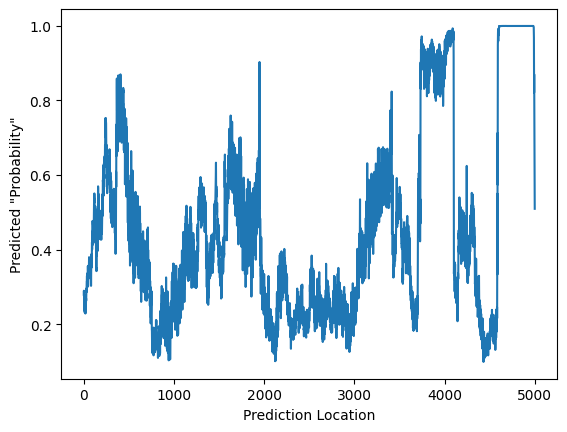

In [29]:
# Make predictions on subsequences of length 400
predictions = []
input_len = 400
n_predictions = 5000
input_tensor = torch.zeros((1, 1, 400)).to(device)
for i in tqdm(range(n_predictions)):
    # Could also batch these to speed up predictions
    input_tensor[:, :, :] = sequence_tensor[i:i+input_len]
    prediction = model(input_tensor).sigmoid().item()
    predictions.append(prediction)
    
# Plot predictions
plt.plot(predictions)
plt.xlabel('Prediction Location')
plt.ylabel('Predicted "Probability"')

## Load full validation dataset

In [34]:
batch_size = 256

#neg_fn = 'data/mesmlr/reprocessed-neg.eventalign.signal.csv'
#pos_fn = 'data/mesmlr/reprocessed-pos.eventalign.signal.csv'
neg_fn = 'data/addseq/reprocessed-unique.0.eventalign.signal.csv'
pos_fn = 'data/addseq/reprocessed-unique.500.eventalign.signal.csv'

min_val = 50 # Used to clip outliers
max_val = 130 # Used to clip outliers

seq_len = 400

print("Preparing unmodified...")
print("Loading csv...")
unmodified_sequences = load_csv(neg_fn,
                                min_val=min_val,
                                max_val=max_val,
                                max_sequences=None)
print("Creating sample map...")
unmodified_sample_map = create_sample_map(unmodified_sequences,
                                          seq_len=seq_len)

print("Creating splits...")
unmodified_train, unmodified_val, unmodified_test = create_splits(
        unmodified_sequences, unmodified_sample_map, seq_len=seq_len, shuffle=False)
print("Prepared.")

Preparing unmodified...
Loading csv...


87090426it [01:26, 1005700.64it/s]


Creating sample map...


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1318/1318 [01:29<00:00, 14.74it/s]


Creating splits...


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 86107601/86107601 [00:27<00:00, 3145178.24it/s]

Prepared.


In [40]:
print("Preparing modified...")
print("Loading csv...")
modified_sequences = load_csv(pos_fn,
                              min_val=min_val,
                              max_val=max_val,
                              max_sequences=None)
print("Creating sample map...")
modified_sample_map = create_sample_map(modified_sequences,
                                        seq_len=seq_len)
print("Creating splits...")
modified_train, modified_val, modified_test = create_splits(
        modified_sequences, modified_sample_map, seq_len=seq_len, shuffle=False)
print("Prepared.")

val_dataset = NanoporeDataset(unmodified_sequences,
                              unmodified_val,
                              modified_sequences,
                              modified_val,
                              device=device,
                              synthetic=False,
                              seq_len=seq_len)

val_dataloader = DataLoader(val_dataset,
                            batch_size=batch_size,
                            shuffle=False)

Preparing modified...
Loading csv...


89565238it [01:27, 1021078.24it/s]


Creating sample map...


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2390/2390 [01:15<00:00, 31.78it/s]


Creating splits...


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 88556920/88556920 [00:31<00:00, 2827735.20it/s]

Prepared.


## Make predictions on full validation dataset

In [49]:
val_dataloader = DataLoader(val_dataset,
                            batch_size=batch_size,
                            shuffle=False)

In [47]:
val_dataloader = DataLoader(val_dataset,
                            batch_size=512,
                            shuffle=False)

In [ ]:
model.to(device)

with torch.no_grad():
    seq_preds = {}
    dataloader_idx = 0
    for sample, label in tqdm(val_dataloader):
        sample.to(device)
        pred = model(sample).sigmoid()
        for i in range(len(pred)):
            seq_idx = val_dataset.get_seq_idx(dataloader_idx)
            dataloader_idx += 1
            seq_label = label[i].item()
            seq_id = (seq_label, seq_idx)
            if seq_id not in seq_preds:
                seq_preds[seq_id] = []
            seq_preds[seq_id].append(pred[i].item())

 15%|███████████████████                                                                                                         | 20512/133612 [1:17:00<7:06:20,  4.42it/s]

## Analyze predictions

In [22]:
# Compute summary performance statistics

correct = {0: 0, 1: 0}
total = {0: 0, 1: 0}

for seq_id in tqdm(seq_preds):
    label = seq_id[0]
    pred_arr = np.round(np.array(seq_preds[seq_id]))
    if label == 0:
        label_arr = np.zeros(len(pred_arr))
    else:
        label_arr = np.ones(len(pred_arr))
    correct_arr = (pred_arr == label_arr)
    correct[label] += np.sum(correct_arr)
    total[label] += len(pred_arr)

accuracy = (correct[0] + correct[1]) / float(total[0] + total[1])  

true_negatives = correct[0]
true_positives = correct[1]
false_negatives = total[1] - correct[1]
false_positives = total[0] - correct[0]

precision = true_positives / float(true_positives + false_positives)
recall = true_positives / float(true_positives + false_negatives)

print("True negatives:", true_negatives)
print("True positives:", true_positives)
print("False negatives:", false_negatives)
print("False positives:", false_positives)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

100%|███████████████████████████████████████████████████████████████████████████████████████████████| 740/740 [00:02<00:00, 345.34it/s]

True negatives: 12219485
True positives: 13810869
False negatives: 3789764
False positives: 4384488
Accuracy: 0.7610189691996452
Precision: 0.7590325927652862
Recall: 0.7846802441707637


100%|███████████████████████████████████████████████████████████████████████████████████████████████| 740/740 [00:03<00:00, 206.39it/s]


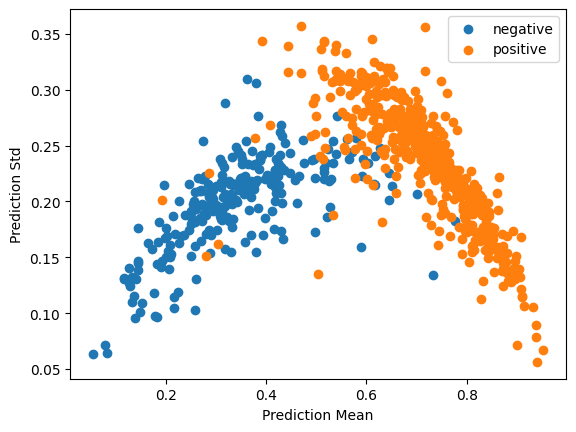

In [23]:
# Plot prediction mean and std for each validation sequence

seq_means = {0: [], 1: []}
seq_stds = {0: [], 1: []}
for seq_id in tqdm(seq_preds):
    label = seq_id[0]
    seq_means[label].append(np.mean(seq_preds[seq_id]))
    seq_stds[label].append(np.std(seq_preds[seq_id]))
plt.scatter(seq_means[0], seq_stds[0], label='negative')
plt.scatter(seq_means[1], seq_stds[1], label='positive')
plt.legend()
plt.xlabel('Prediction Mean')
plt.ylabel('Prediction Std')
plt.show()

100%|███████████████████████████████████████████████████████████████████████████████████████████████| 740/740 [00:01<00:00, 379.67it/s]


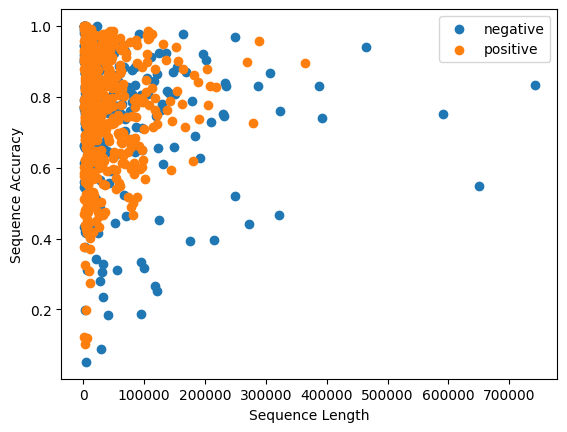

In [24]:
# Plot accuracy by sequence length for each sequence in validation set

seq_lens = {0: [], 1: []}
seq_accs = {0: [], 1: []}
for seq_id in tqdm(seq_preds):
    seq_len = len(seq_preds[seq_id])
    label = seq_id[0]
    if label == 0:
        label_arr = np.zeros(seq_len)
    else:
        label_arr = np.ones(seq_len)
    pred_arr = np.round(np.array(seq_preds[seq_id]))
    correct_arr = (pred_arr == label_arr)
    correct = np.sum(correct_arr)
    seq_acc = float(correct) / seq_len
    seq_lens[label].append(seq_len)
    seq_accs[label].append(seq_acc)
plt.scatter(seq_lens[0], seq_accs[0], label='negative')
plt.scatter(seq_lens[1], seq_accs[1], label='positive')
plt.legend()
plt.xlabel('Sequence Length')
plt.ylabel('Sequence Accuracy')
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████████████████| 740/740 [00:00<00:00, 5673.80it/s]


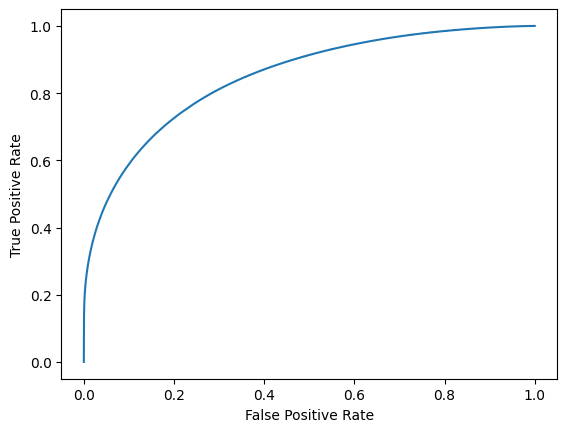

In [25]:
# Compute ROC curve
from sklearn.metrics import roc_curve

pred_list = []
label_list = []
for seq_id in tqdm(seq_preds):
    seq_len = len(seq_preds[seq_id])
    label = seq_id[0]
    preds = seq_preds[seq_id]
    if label == 0:
        labels = np.zeros(seq_len)
    else:
        labels = np.ones(seq_len)
    pred_list.append(preds)
    label_list.append(labels)
    
pred_cat = np.concatenate(pred_list)
label_cat = np.concatenate(label_list)

fpr, tpr, thresholds = roc_curve(label_cat, pred_cat)
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

## Plot training dynamics

       train_loss    val_loss   train_acc     val_acc
count  181.000000  181.000000  181.000000  181.000000
mean     0.007557    0.007646    0.759826    0.755095
std      0.000376    0.000330    0.016117    0.013713
min      0.007270    0.007393    0.664695    0.684612
25%      0.007345    0.007472    0.755791    0.754823
50%      0.007381    0.007500    0.767170    0.760287
75%      0.007682    0.007701    0.768872    0.761957
max      0.009547    0.009176    0.772696    0.766843


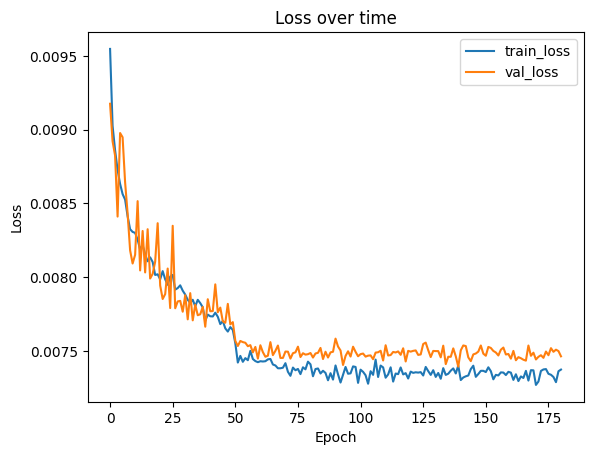

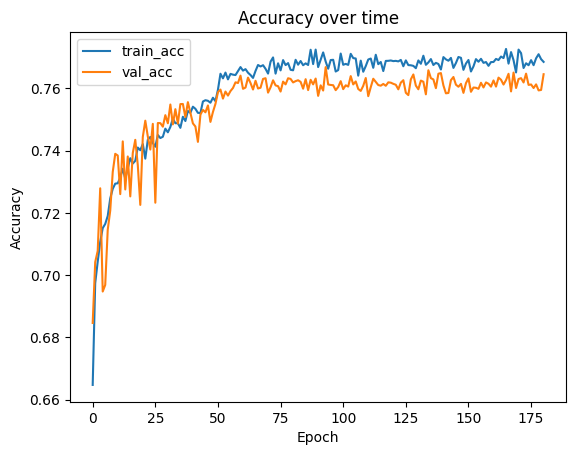

In [28]:
import pandas as pd

training_df = pd.read_csv('results/resnet1d_addseq.csv', index_col=0)

print(training_df.describe())

training_df[['train_loss', 'val_loss']].plot()
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.title("Loss over time")
plt.show()

training_df[['train_acc', 'val_acc']].plot()
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.title("Accuracy over time")
plt.show()